# This notebook does a full analysis of the 2-point data, comparing the effects of varying the minimum time and maximum time of the data and number of data samples

### It also compares what the results would look like with a the main file's (a12m310_a_avg.h5) 2-point function and that of the Feynman-Hellman file (a12m310_a_fh.h5)

In [1]:
import pickle
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from mpl_toolkits import mplot3d
import gvar as gv

In [2]:
import h5data_methods as h5_dm
import h5py
import lsqfit

In [3]:
# Constants

#Physical constants
hbarc = 197.3 # MeV fm
#a = 0.12

# Pion mass
mpi = 0.1885

# Plot constants
t_min_plt = 1
t_max_plt = 25

In [4]:
# This function's job is to add up the dE parameters in the input-parameters to the fit-functions into useable energies 
def Ei(n_selec, p):
    Ea = p['E0']
    for l in range(1, n_selec+1):
        Ea += p['dE{}'.format(l)]
        
    #print(Ea)
    return Ea

In [5]:
num_zs = 1 #Order number of the n's
# Log E: log of the energy.  
# P is point (in the context of )

# Define the 2-point fit function, for P-S and P-P
def C_2pt(t, p):
    
    z = np.array([])
    ztilde = np.array([])
    E = np.array([])
    for i in range(num_zs):
        z = np.append(z, p['Z{}'.format(i)])
        ztilde = np.append(ztilde, p['Ztilde{}'.format(i)])
        E = np.append(E, Ei(i, p))
        
    
    sum_pp = sum([z[i]*z[i]*np.exp(-E[i]*t) for i in range(num_zs)])
    sum_ps = sum([z[i]*ztilde[i]*np.exp(-E[i]*t) for i in range(num_zs)])
    
    return np.transpose(np.array([[sum_pp], [sum_ps]]), axes=[2,0,1])

## First, get all of the data, calculate effective mass and effective z-value, and do a comparison of the two data-sets

In [6]:
# Get the data, first the primary data-set
file = h5py.File("a12m310_a_avg.h5", "r")

data_original = gv.BufferDict()
data_original['proton_dn_pp'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton']['px0_py0_pz0']['spin_dn'])
data_original['proton_up_pp'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton']['px0_py0_pz0']['spin_up'])
data_original['proton_dn_np'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton_np']['px0_py0_pz0']['spin_dn'])
data_original['proton_up_np'] = np.array(file['gf1p0_w3p0_n30_M51p2_L58_a1p5']['spec']['ml0p0126']['proton_np']['px0_py0_pz0']['spin_up'])

data_original['proton'] = (data_original['proton_dn_pp'] + data_original['proton_up_pp'] + data_original['proton_dn_np'] + data_original['proton_up_np'])/4.

# Now, get the Feynman-Hellman dataset
file_fh = h5py.File("a12m310_a_fh.h5", "r")
data_fh = gv.BufferDict()
data_fh['proton_ss'] = np.array(file_fh['proton_ss'])/4.
data_fh['proton_ps'] = np.array(file_fh['proton_ps'])/4.
data_fh['proton'] = np.transpose(np.array([[data_fh['proton_ss']], [data_fh['proton_ps']]]), axes=[2,3,0,1])

# Average out both
avg_data_original = gv.BufferDict()
avg_data_original = gv.dataset.avg_data(data_original)
avg_data_fh = gv.BufferDict()
avg_data_fh = gv.dataset.avg_data(data_fh)

/Users/ivan/miniconda3/envs/thesis2020/lib/python3.8/site-packages/numpy/core/_asarray.py:83: ComplexWarning: Casting complex values to real discards the imaginary part
  return array(a, dtype, copy=False, order=order)


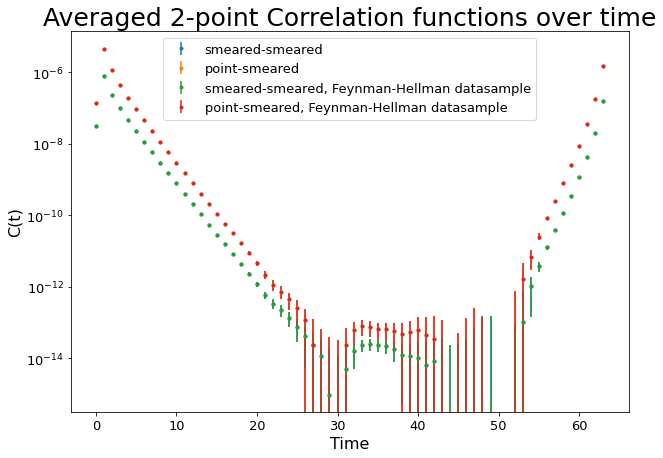

In [7]:
# Plot Correlation functions
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(len(avg_data_original['proton']))], [avg_data_original['proton'][i][0][0].mean for i in range(len(avg_data_original['proton']))], yerr=[avg_data_original['proton'][i][0][0].sdev for i in range(len(avg_data_original['proton']))], fmt='.', label="smeared-smeared")
ax.errorbar([i for i in range(len(avg_data_original['proton']))], [avg_data_original['proton'][i][1][0].mean for i in range(len(avg_data_original['proton']))], yerr=[avg_data_original['proton'][i][1][0].sdev for i in range(len(avg_data_original['proton']))], fmt='.', label="point-smeared")

ax.errorbar([i for i in range(len(avg_data_fh['proton']))], [avg_data_fh['proton'][i][0][0].mean for i in range(len(avg_data_fh['proton']))], yerr=[avg_data_fh['proton'][i][0][0].sdev for i in range(len(avg_data_fh['proton']))], fmt='.', label="smeared-smeared, Feynman-Hellman datasample")
ax.errorbar([i for i in range(len(avg_data_fh['proton']))], [avg_data_fh['proton'][i][1][0].mean for i in range(len(avg_data_fh['proton']))], yerr=[avg_data_fh['proton'][i][1][0].sdev for i in range(len(avg_data_fh['proton']))], fmt='.', label="point-smeared, Feynman-Hellman datasample")

plt.xlabel("Time", fontsize=16)
plt.ylabel("C(t)", fontsize=16)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.title("Averaged 2-point Correlation functions over time", fontsize=25)
plt.legend(fontsize=13)
plt.show()

In [8]:
tau = 1
# Effective mass data (same annihilation, different annihilation)
eff_mass = [[np.log(avg_data_original['proton'][t][0][0]/avg_data_original['proton'][t+tau][0][0])/tau for t in range(len(avg_data_original['proton'])-tau)],\
            [np.log(avg_data_original['proton'][t][1][0]/avg_data_original['proton'][t+tau][1][0])/tau for t in range(len(avg_data_original['proton'])-tau)]]

avg_data_original['eff_mass'] = np.array([np.log(avg_data_original['proton'][t]/avg_data_original['proton'][t+tau])/tau for t in range(len(avg_data_original['proton'])-tau)])
avg_data_fh['eff_mass'] = np.array([np.log(avg_data_fh['proton'][t]/avg_data_fh['proton'][t+tau])/tau for t in range(len(avg_data_fh['proton'])-tau)])

#zS_eff = np.array([np.sqrt(np.exp(eff_mass[0][t]*t)*avg_data_original['proton'][t][0][0]) for t in range(len(avg_data_original['proton'])-tau)])
avg_data_original['zs_eff'] = np.array([np.sqrt(np.exp(avg_data_original['eff_mass'][t][0][0]*t)*avg_data_original['proton'][t][0][0]) for t in range(len(avg_data_original['proton'])-tau)])
avg_data_fh['zs_eff'] = np.array([np.sqrt(np.exp(avg_data_fh['eff_mass'][t][0][0]*t)*avg_data_fh['proton'][t][0][0]) for t in range(len(avg_data_fh['proton'])-tau)])

#zP_eff = np.array([np.exp(eff_mass[1][t]*t)*avg_data_original['proton'][t][1][0]/zS_eff[t] for t in range(len(avg_data_original['proton'])-tau)])
avg_data_original['zp_eff'] = np.array([np.exp(avg_data_original['eff_mass'][t][1][0]*t)*avg_data_original['proton'][t][1][0]/avg_data_original['zs_eff'][t] for t in range(len(avg_data_original['proton'])-tau)])
avg_data_fh['zp_eff'] = np.array([np.exp(avg_data_fh['eff_mass'][t][1][0]*t)*avg_data_fh['proton'][t][1][0]/avg_data_fh['zs_eff'][t] for t in range(len(avg_data_fh['proton'])-tau)])

#log_eff_mass = np.log(eff_mass)

<ipython-input-8-5c46469d3407>:3: RuntimeWarning: invalid value encountered in log
  eff_mass = [[np.log(avg_data_original['proton'][t][0][0]/avg_data_original['proton'][t+tau][0][0])/tau for t in range(len(avg_data_original['proton'])-tau)],\
<ipython-input-8-5c46469d3407>:4: RuntimeWarning: invalid value encountered in log
  [np.log(avg_data_original['proton'][t][1][0]/avg_data_original['proton'][t+tau][1][0])/tau for t in range(len(avg_data_original['proton'])-tau)]]
<ipython-input-8-5c46469d3407>:6: RuntimeWarning: invalid value encountered in log
  avg_data_original['eff_mass'] = np.array([np.log(avg_data_original['proton'][t]/avg_data_original['proton'][t+tau])/tau for t in range(len(avg_data_original['proton'])-tau)])
<ipython-input-8-5c46469d3407>:7: RuntimeWarning: invalid value encountered in log
  avg_data_fh['eff_mass'] = np.array([np.log(avg_data_fh['proton'][t]/avg_data_fh['proton'][t+tau])/tau for t in range(len(avg_data_fh['proton'])-tau)])
<ipython-input-8-5c46469d3407

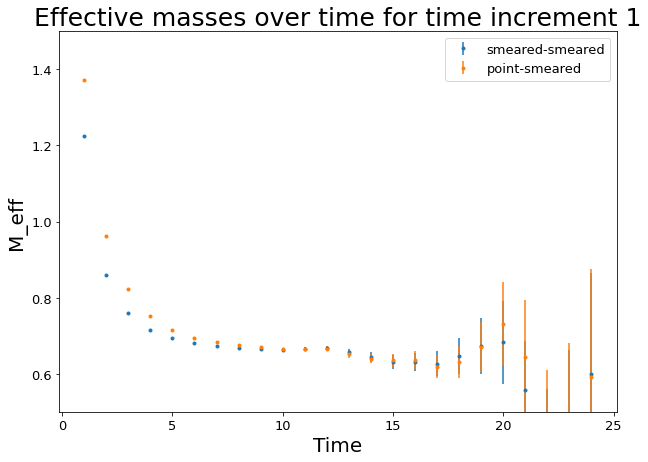

In [9]:
# Plot the effective masses
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['eff_mass'][i][0][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_original['eff_mass'][i][0][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="smeared-smeared")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['eff_mass'][i][1][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_original['eff_mass'][i][1][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="point-smeared")

#ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['eff_mass'][i][0][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_fh['eff_mass'][i][0][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="smeared-smeared, FH")
#ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['eff_mass'][i][1][0].mean for i in range(t_min_plt,t_max_plt)]), yerr=np.array([avg_data_fh['eff_mass'][i][1][0].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="point-smeared, FH")

plt.xlabel("Time", fontsize=20)
plt.ylabel("M_eff", fontsize=20)
plt.ylim(0.5, 1.5)
#plt.yticks(np.arange(0.6,0.8, 0.02))
plt.title("Effective masses over time for time increment {}".format(tau), fontsize=25)
plt.xticks(fontsize=13)
plt.yticks(fontsize=13)
plt.legend(fontsize=13)
plt.show()
fig.savefig('meff_raw.png')


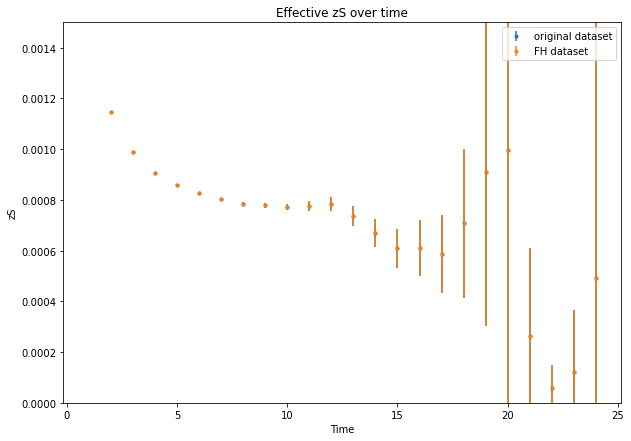

In [10]:
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zs_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zs_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="original dataset")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zs_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zs_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="FH dataset")

plt.xlabel("Time")
plt.ylabel("zS")
plt.title("Effective zS over time")
plt.ylim([0, 0.0015])
plt.legend()
plt.show()

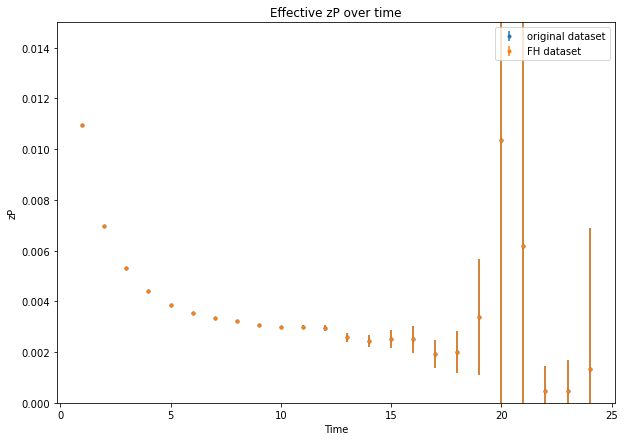

In [11]:
fig = plt.figure(figsize=(10,7))
ax = plt.axes()

ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zp_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_original['zp_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="original dataset")
ax.errorbar(np.array([i for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zp_eff'][i].mean for i in range(t_min_plt,t_max_plt)]), np.array([avg_data_fh['zp_eff'][i].sdev for i in range(t_min_plt,t_max_plt)]), fmt='.', label="FH dataset")

plt.xlabel("Time")
plt.ylabel("zP")
plt.title("Effective zP over time")
plt.ylim(0, 0.015)
plt.legend()
plt.show()

Looks like the Feynman-Hellman and the original datafile do indeed have the same data

## Set the priors for all sampled energy spacing and widths
### Then test the fits

In [12]:
# Define a-values, where a is such that the energy-increment at the nth excited state is 2*mpi/n^a
# Define b-values, where b is the error-bar of log(dE)

num_fitsamples = np.arange(1,9,1)
a = np.linspace(0,2,11)
a_select_indices = np.array([0, 5, 10])
b = np.linspace(0.3,1.3,6)


In [13]:
# Find up to 9 excited priors for each pair of a,b

num_zs = 10


#p=gv.BufferDict()
#p['E0'] = gv.gvar(0.67, 0.02)
#p['Z0'] = gv.gvar(0.0008, 0.0003)
#p['Ztilde0'] = gv.gvar(0.003, 0.003)

# Initialize the principal values of the excited energy-priors
dE0 = 2*mpi
#energyvals = np.array([[None]*(len(num_fitsamples) + 1)]*len(a))
#dEvals = np.array([[None]*len(num_fitsamples)]*len(a))



#for i in range(len(a)):
    #energyvals[i][0] = p['E0'].mean
    #for k in range(np.min(num_fitsamples), np.max(num_fitsamples)+1):
        #dEvals[i][k-1] = dE0/np.power(k, a[i])
        #energyvals[i][k] = energyvals[i][k-1] + dEvals[i][k-1]
        

priors = []
p_adj = gv.BufferDict()
for i in range(len(a)):
    priors.append([])
    
    for j in range(len(b)):
        #print("i = ", i, " j = ", j)
        priors[i].append(gv.BufferDict())
        #print(a[i])
        priors[i][j] = h5_dm.prior(num_zs, 2, b[j], a[i]) # Use the h5data_methods 
        
        #priors[i][j]['E0'] = p['E0']
        #priors[i][j]['Z0'] = p['Z0']
        #priors[i][j]['Ztilde0'] = p['Ztilde0']
        
        #priors[i][j]['Z1'] = gv.gvar(0.0008, 0.0004)
        #priors[i][j]['Ztilde1'] = gv.gvar(0, 0.005)
        #priors[i][j]['log(dE1)'] = gv.gvar(np.log(dEvals[i][0]), b[j])
        
        #for k in range(2, np.max(num_fitsamples)+1):
            #priors[i][j]['Z{}'.format(k)] = gv.gvar(0.0008, 0.0004)
            #priors[i][j]['Ztilde{}'.format(k)] = gv.gvar(0, 0.005)
            #priors[i][j]['log(dE{})'.format(k)] = gv.gvar(np.log(dEvals[i][k-1]), 0.7)
            

In [14]:
priors[5]

[BufferDict([('E0', 0.660(10)), ('Z0', 0.000800(80)), ('Ztilde0', 0.0030(10)), ('Z1', 0.00050(50)), ('Ztilde1', 0.0030(30)), ('Z2', 0.00050(50)), ('Ztilde2', 0.0030(30)), ('log(dE1)', -0.98(30)), ('log(dE2)', -1.67(30)), ('log(dE3)', -2.07(30)), ('Z3', 0.00050(50)), ('Ztilde3', 0.0030(30)), ('log(dE4)', -2.36(30)), ('Z4', 0.00050(50)), ('Ztilde4', 0.0030(30)), ('log(dE5)', -2.58(30)), ('Z5', 0.00050(50)), ('Ztilde5', 0.0030(30)), ('log(dE6)', -2.77(30)), ('Z6', 0.00050(50)), ('Ztilde6', 0.0030(30)), ('log(dE7)', -2.92(30)), ('Z7', 0.00050(50)), ('Ztilde7', 0.0030(30)), ('log(dE8)', -3.05(30)), ('Z8', 0.00050(50)), ('Ztilde8', 0.0030(30)), ('log(dE9)', -3.17(30)), ('Z9', 0.00050(50)), ('Ztilde9', 0.0030(30)), ('gA3_10', 0.0(1.0)), ('gV4_10', 0.0(1.0)), ('gA3_11', 0.0(1.0)), ('gV4_11', 1.00(20)), ('gA3_20', 0.0(1.0)), ('gV4_20', 0.0(1.0)), ('gA3_21', 0.0(1.0)), ('gV4_21', 0.0(1.0)), ('gA3_22', 0.0(1.0)), ('gV4_22', 1.00(20)), ('gA3_30', 0.0(1.0)), ('gV4_30', 0.0(1.0)), ('gA3_31', 0.0(1.0

In [15]:
num_zs = 9
aa = 1
bb = 3
fit_check = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, 22)]), np.array([avg_data_original['proton'][l] for l in range(2,22)])), prior=priors[a_select_indices[aa]][bb],fcn=C_2pt,debug=True)

print("a = ", a[a_select_indices[aa]], "; b = ", b[bb])
print("Q= ", fit_check.Q)
print(fit_check.format(pstyle='vv'))

a =  1.0 ; b =  0.9000000000000001
Q=  4.82840685694983e-09
Least Square Fit:
  chi2/dof [dof] = 2.9 [40]    Q = 4.8e-09    logGBF = 958.92

Parameters:
             E0        0.670109 +- 0.00277382             [           0.66 +- 0.01 ]  *
             Z0     0.00078933 +- 1.07856e-05             [        0.0008 +- 8e-05 ]  
        Ztilde0      0.00298068 +- 4.8493e-05             [         0.003 +- 0.001 ]  
             Z1      0.00037673 +- 7.4459e-05             [       0.0005 +- 0.0005 ]  
        Ztilde1      0.00414188 +- 0.00171315             [         0.003 +- 0.003 ]  
             Z2    -2.46034e-05 +- 0.00040402             [       0.0005 +- 0.0005 ]  *
        Ztilde2      0.00327568 +- 0.00299908             [         0.003 +- 0.003 ]  
       log(dE1)         -0.972194 +- 0.203193             [        -0.97551 +- 0.9 ]  
       log(dE2)          -1.66667 +- 0.680547             [        -1.66866 +- 0.9 ]  
       log(dE3)           -2.0728 +- 0.810525             [   

### Now, plot fit quality and E0 over tmin and number of excited states used

In [16]:
tmin = np.arange(1,10,1)

list_LogGBF_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a0 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

list_LogGBF_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a1 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

list_LogGBF_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_Q_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
list_E0_a2 = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

In [17]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[k], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[k],13)])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            list_LogGBF_a0[i][j][k] = fit_a0.logGBF
            list_Q_a0[i][j][k] = fit_a0.Q
            list_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a0[i][j][k])
            print("list Q: ", list_Q_a0[i][j][k])
            print("list E0: ", list_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            list_LogGBF_a1[i][j][k] = fit_a1.logGBF
            list_Q_a1[i][j][k] = fit_a1.Q
            list_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a1[i][j][k])
            print("list Q: ", list_Q_a1[i][j][k])
            print("list E0: ", list_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            list_LogGBF_a2[i][j][k] = fit_a2.logGBF
            list_Q_a2[i][j][k] = fit_a2.Q
            list_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmin[k])
            print("list logGBF: ", list_LogGBF_a2[i][j][k])
            print("list Q: ", list_Q_a2[i][j][k])
            print("list E0: ", list_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))
            #print(list_LogGBF_a0)
            #a = 0, b = 0.7, k = 5 fit


i =  0  j =  0  k =  0 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  1
list logGBF:  -266004.72028699506
list Q:  0.0
list E0:  0.7122(58)
Least Square Fit:
  chi2/dof [dof] = 2.2e+04 [24]    Q = 0    logGBF = -2.66e+05

Parameters:
             E0       0.712189 +- 0.00578362             [        0.66 +- 0.01 ]  *****
             Z0   2.02391e-05 +- 2.98725e-06             [     0.0008 +- 8e-05 ]  *****
        Ztilde0   -0.00678796 +- 0.000997579             [      0.003 +- 0.001 ]  *****
             Z1             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde1               0.003 +- 0.003             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)               3.84176 +- 0.3             [     -0.97551 +- 0.3 ]  *****
       log(dE2)              -0.97551 +- 0.3             [     -0.97


i =  0  j =  0  k =  1 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  2
list logGBF:  245.56246102668678
list Q:  7.233092121448527e-98
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 7.2e-98    logGBF = 245.56

Parameters:
             E0      0.667465 +- 0.00107538            [        0.66 +- 0.01 ]  
             Z0   0.000785557 +- 2.5137e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0    0.0030373 +- 1.21392e-05            [      0.003 +- 0.001 ]  
             Z1   0.00125249 +- 3.75981e-06            [    0.0005 +- 0.0005 ]  *
        Ztilde1   0.00917867 +- 4.27851e-05            [      0.003 +- 0.003 ]  **
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)     -0.128205 +- 0.00678118            [     -0.97551 +- 0.3 ]  **
       log(dE2)             -0.97551 +- 0.3            [     -0.97551 +- 0.3 ]  
   


i =  0  j =  0  k =  2 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  3
list logGBF:  424.10570912248295
list Q:  6.408712438041389e-11
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.5 [20]    Q = 6.4e-11    logGBF = 424.11

Parameters:
             E0       0.663176 +- 0.00137753             [        0.66 +- 0.01 ]  
             Z0   0.000769337 +- 3.63513e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00294263 +- 1.71245e-05             [      0.003 +- 0.001 ]  
             Z1       0.0010362 +- 8.024e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00736608 +- 8.76254e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.379687 +- 0.0142956             [     -0.97551 +- 0.3 ]  *
       log(dE2)              -0.97551 +- 0.3             [     -0.975


i =  0  j =  0  k =  3 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  4
list logGBF:  412.09453014010137
list Q:  0.042155548162982
list E0:  0.6622(17)
Least Square Fit:
  chi2/dof [dof] = 1.6 [18]    Q = 0.042    logGBF = 412.09

Parameters:
             E0        0.662166 +- 0.0017392             [        0.66 +- 0.01 ]  
             Z0   0.000763612 +- 5.19038e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00290255 +- 2.40115e-05             [      0.003 +- 0.001 ]  
             Z1   0.000890077 +- 1.62917e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00625022 +- 0.000164029             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.550344 +- 0.029441             [     -0.97551 +- 0.3 ]  *
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0


i =  0  j =  0  k =  4 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  5
list logGBF:  373.82882671741925
list Q:  0.3275355813706364
list E0:  0.6603(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.33    logGBF = 373.83

Parameters:
             E0        0.660309 +- 0.0023652             [        0.66 +- 0.01 ]  
             Z0    0.000755285 +- 8.0774e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00285832 +- 3.6406e-05             [      0.003 +- 0.001 ]  
             Z1   0.000786887 +- 2.82919e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00529159 +- 0.000276823             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.700848 +- 0.0560028             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3


i =  0  j =  0  k =  5 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  6
list logGBF:  331.5521598769469
list Q:  0.6591057317664281
list E0:  0.6575(34)
Least Square Fit:
  chi2/dof [dof] = 0.81 [14]    Q = 0.66    logGBF = 331.55

Parameters:
             E0       0.657525 +- 0.00343173             [        0.66 +- 0.01 ]  
             Z0   0.000741455 +- 1.36493e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00279283 +- 6.01737e-05             [      0.003 +- 0.001 ]  
             Z1   0.000681576 +- 4.44557e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00420342 +- 0.0003734             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.921374 +- 0.109954             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3


i =  0  j =  0  k =  6 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  7
list logGBF:  285.1439958316266
list Q:  0.5461864404337162
list E0:  0.6582(40)
Least Square Fit:
  chi2/dof [dof] = 0.9 [12]    Q = 0.55    logGBF = 285.14

Parameters:
             E0       0.658241 +- 0.00397956             [        0.66 +- 0.01 ]  
             Z0    0.00074385 +- 1.67647e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00279923 +- 7.2686e-05             [      0.003 +- 0.001 ]  
             Z1   0.000632534 +- 7.88691e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398243 +- 0.000613832             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.969519 +- 0.168405             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3 


i =  0  j =  0  k =  7 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  8
list logGBF:  240.78469596496805
list Q:  0.8543665614585589
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.55 [10]    Q = 0.85    logGBF = 240.78

Parameters:
             E0       0.662118 +- 0.00381859             [        0.66 +- 0.01 ]  
             Z0   0.000762997 +- 1.54956e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028729 +- 6.46626e-05             [      0.003 +- 0.001 ]  
             Z1   0.000550407 +- 0.000182148             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00521448 +- 0.0016081             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.814224 +- 0.193907             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.


i =  0  j =  0  k =  8 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmin =  9
list logGBF:  192.76568740193375
list Q:  0.9395065910091589
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.36 [8]    Q = 0.94    logGBF = 192.77

Parameters:
             E0       0.661023 +- 0.00514118             [        0.66 +- 0.01 ]  
             Z0    0.000756668 +- 2.3335e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285429 +- 9.31268e-05             [      0.003 +- 0.001 ]  
             Z1   0.000572353 +- 0.000250372             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00372264 +- 0.0012745             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.938265 +- 0.252177             [     -0.97551 +- 0.3 ]  
       log(dE2)              -0.97551 +- 0.3             [     -0.97551 +- 0.3


i =  0  j =  1  k =  0 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  1
list logGBF:  449.97555598552935
list Q:  5.468347696302065e-25
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 7.3 [24]    Q = 5.5e-25    logGBF = 449.98

Parameters:
             E0       0.668323 +- 0.00119411             [        0.66 +- 0.01 ]  
             Z0   0.000784586 +- 2.93061e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00300884 +- 1.40228e-05             [      0.003 +- 0.001 ]  
             Z1   0.000994881 +- 1.18673e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00748009 +- 8.25658e-05             [      0.003 +- 0.003 ]  *
             Z2    0.00242692 +- 2.64251e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2     0.0152928 +- 0.000157501             [      0.003 +- 0.003 ]  ****
       log(dE1)        -0.361268 +- 0.013543             [     -0.97551 +- 0.3 ]  **
       log(dE2)        0.620149 +- 0.0169414             [    


i =  0  j =  1  k =  1 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  2
list logGBF:  486.3614165894526
list Q:  0.057342252187946176
list E0:  0.6615(19)
Least Square Fit:
  chi2/dof [dof] = 1.5 [22]    Q = 0.057    logGBF = 486.36

Parameters:
             E0       0.661479 +- 0.00186804             [        0.66 +- 0.01 ]  
             Z0   0.000758732 +- 5.96968e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286864 +- 2.85355e-05             [      0.003 +- 0.001 ]  
             Z1   0.000692966 +- 4.18232e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00474757 +- 0.000310222             [      0.003 +- 0.003 ]  
             Z2     0.00132016 +- 1.8869e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00977996 +- 0.000198119             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.778471 +- 0.0668875             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.129611 +- 0.0485465             [     -0.97551 +


i =  0  j =  1  k =  2 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  3
list logGBF:  454.1377207237247
list Q:  0.3472907758389827
list E0:  0.6622(26)
Least Square Fit:
  chi2/dof [dof] = 1.1 [20]    Q = 0.35    logGBF = 454.14

Parameters:
             E0       0.662154 +- 0.00264005             [        0.66 +- 0.01 ]  
             Z0   0.000760304 +- 9.73029e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286966 +- 4.42462e-05             [      0.003 +- 0.001 ]  
             Z1    0.00052316 +- 0.000107279             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00362586 +- 0.000730134             [      0.003 +- 0.003 ]  
             Z2    0.00110032 +- 3.31784e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.00785953 +- 0.00034865             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.963708 +- 0.176466             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.515377 +- 0.108604             [     -0.97551 +- 0.


i =  0  j =  1  k =  3 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  4
list logGBF:  415.848751957678
list Q:  0.5365282489539935
list E0:  0.6605(34)
Least Square Fit:
  chi2/dof [dof] = 0.93 [18]    Q = 0.54    logGBF = 415.85

Parameters:
             E0       0.660524 +- 0.00340511             [        0.66 +- 0.01 ]  
             Z0   0.000753509 +- 1.39052e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028433 +- 6.05133e-05             [      0.003 +- 0.001 ]  
             Z1   0.000485192 +- 0.000145526             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00310432 +- 0.000998021             [      0.003 +- 0.003 ]  
             Z2   0.000922013 +- 7.13157e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00686408 +- 0.000643715             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.05349 +- 0.252943             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.747359 +- 0.199705             [     -0.97551 +- 0.3


i =  0  j =  1  k =  4 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  5
list logGBF:  374.11641822277784
list Q:  0.5392758667314823
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.93 [16]    Q = 0.54    logGBF = 374.12

Parameters:
             E0       0.659825 +- 0.00377598             [        0.66 +- 0.01 ]  
             Z0    0.00075134 +- 1.55773e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283511 +- 6.50674e-05             [      0.003 +- 0.001 ]  
             Z1   0.000521621 +- 0.000166596             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00332791 +- 0.00114889             [      0.003 +- 0.003 ]  
             Z2   0.000766067 +- 0.000179339             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00556145 +- 0.0010407             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994459 +- 0.238583             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.955654 +- 0.279809             [     -0.97551 +- 0.


i =  0  j =  1  k =  5 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  6
list logGBF:  331.62452793624124
list Q:  0.7440293496926005
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.74    logGBF = 331.62

Parameters:
             E0       0.659524 +- 0.00392775             [        0.66 +- 0.01 ]  
             Z0   0.000750472 +- 1.65524e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282397 +- 6.92139e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543709 +- 0.000151317             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00396652 +- 0.0010482             [      0.003 +- 0.003 ]  
             Z2   0.000750525 +- 0.000312994             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00290335 +- 0.00214804             [      0.003 +- 0.003 ]  
       log(dE1)        -0.962064 +- 0.188956             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.01562 +- 0.295332             [     -0.97551 +- 0.


i =  0  j =  1  k =  6 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  7
list logGBF:  285.4639346310954
list Q:  0.6257986706737764
list E0:  0.6597(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.46

Parameters:
             E0       0.659683 +- 0.00393589             [        0.66 +- 0.01 ]  
             Z0   0.000751305 +- 1.66132e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282367 +- 6.93931e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507683 +- 0.000168383             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0041018 +- 0.00118988             [      0.003 +- 0.003 ]  
             Z2   0.000867017 +- 0.000402276             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00229709 +- 0.00250982             [      0.003 +- 0.003 ]  
       log(dE1)        -0.977724 +- 0.195123             [     -0.97551 +- 0.3 ]  
       log(dE2)          -1.02304 +- 0.29394             [     -0.97551 +- 0.3


i =  0  j =  1  k =  7 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  8
list logGBF:  240.933976797441
list Q:  0.8690964422469131
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.93

Parameters:
             E0       0.662143 +- 0.00381131             [        0.66 +- 0.01 ]  
             Z0    0.000763172 +- 1.5472e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287351 +- 6.42218e-05             [      0.003 +- 0.001 ]  
             Z1   0.000514891 +- 0.000198017             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00497932 +- 0.00165265             [      0.003 +- 0.003 ]  
             Z2   0.000485361 +- 0.000495813             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369368 +- 0.00296878             [      0.003 +- 0.003 ]  
       log(dE1)        -0.834115 +- 0.201852             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.999174 +- 0.299327             [     -0.97551 +- 0.3 


i =  0  j =  1  k =  8 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmin =  9
list logGBF:  192.84241000485136
list Q:  0.9454939763477471
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.84

Parameters:
             E0       0.661018 +- 0.00511337             [        0.66 +- 0.01 ]  
             Z0   0.000756743 +- 2.31561e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285485 +- 9.21512e-05             [      0.003 +- 0.001 ]  
             Z1   0.000552529 +- 0.000257981             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00361074 +- 0.00130438             [      0.003 +- 0.003 ]  
             Z2   0.000517734 +- 0.000498594             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319688 +- 0.00298892             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945011 +- 0.252611             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986012 +- 0.299706             [     -0.97551 +- 0.3


i =  0  j =  2  k =  0 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  1
list logGBF:  477.52748175596855
list Q:  2.5844479719278564e-13
list E0:  0.6578(29)
Least Square Fit:
  chi2/dof [dof] = 4.7 [24]    Q = 2.6e-13    logGBF = 477.53

Parameters:
             E0        0.657755 +- 0.00287822             [        0.66 +- 0.01 ]  
             Z0     0.000744505 +- 1.1311e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00281382 +- 5.1235e-05             [      0.003 +- 0.001 ]  
             Z1    0.000666454 +- 7.52711e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00412108 +- 0.000682966             [      0.003 +- 0.003 ]  
             Z2   -0.000956799 +- 6.28237e-05             [    0.0005 +- 0.0005 ]  **
        Ztilde2    -0.00796192 +- 0.000315253             [      0.003 +- 0.003 ]  ***
       log(dE1)         -0.868181 +- 0.148065             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.453138 +- 0.109978             


i =  0  j =  2  k =  1 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  2
list logGBF:  489.8838595527974
list Q:  0.3030072665845118
list E0:  0.6605(28)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.3    logGBF = 489.88

Parameters:
             E0       0.660486 +- 0.00282228             [        0.66 +- 0.01 ]  
             Z0   0.000754561 +- 1.05958e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285017 +- 4.70786e-05             [      0.003 +- 0.001 ]  
             Z1   0.000661274 +- 5.81738e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00438064 +- 0.000521011             [      0.003 +- 0.003 ]  
             Z2   0.000492752 +- 0.000308788             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00419125 +- 0.00182056             [      0.003 +- 0.003 ]  
       log(dE1)        -0.836246 +- 0.106957             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.681406 +- 0.21995             [     -0.97551 +- 0.3 ]


i =  0  j =  2  k =  2 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  3
list logGBF:  455.8367611976723
list Q:  0.6325083990245347
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.87 [20]    Q = 0.63    logGBF = 455.84

Parameters:
             E0        0.66013 +- 0.00369198             [        0.66 +- 0.01 ]  
             Z0   0.000751264 +- 1.58268e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283291 +- 6.81215e-05             [      0.003 +- 0.001 ]  
             Z1    0.000525372 +- 0.00010582             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00325825 +- 0.000838188             [      0.003 +- 0.003 ]  
             Z2   0.000561449 +- 0.000301678             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0053022 +- 0.00156262             [      0.003 +- 0.003 ]  
       log(dE1)         -1.04423 +- 0.229835             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.844316 +- 0.227176             [     -0.97551 +- 0.3


i =  0  j =  2  k =  3 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  4
list logGBF:  416.57884769263205
list Q:  0.6542217365287228
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 0.84 [18]    Q = 0.65    logGBF = 416.58

Parameters:
             E0       0.660066 +- 0.00368455             [        0.66 +- 0.01 ]  
             Z0   0.000751449 +- 1.55454e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283318 +- 6.61056e-05             [      0.003 +- 0.001 ]  
             Z1     0.000479908 +- 0.0001474             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00305372 +- 0.000957065             [      0.003 +- 0.003 ]  
             Z2   0.000712514 +- 0.000238021             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00500529 +- 0.00145203             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07666 +- 0.250517             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.927266 +- 0.253154             [     -0.97551 +- 0.


i =  0  j =  2  k =  4 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  5
list logGBF:  374.36465684682054
list Q:  0.5829559610923675
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.58    logGBF = 374.36

Parameters:
             E0       0.659647 +- 0.00387271             [        0.66 +- 0.01 ]  
             Z0   0.000750261 +- 1.62223e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028295 +- 6.78806e-05             [      0.003 +- 0.001 ]  
             Z1   0.000515761 +- 0.000158102             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00326637 +- 0.00107764             [      0.003 +- 0.003 ]  
             Z2   0.000692544 +- 0.000225443             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00497244 +- 0.00128349             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02094 +- 0.242315             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.986169 +- 0.28083             [     -0.97551 +- 0.


i =  0  j =  2  k =  5 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  6
list logGBF:  331.6677086785395
list Q:  0.7482323861056045
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.67

Parameters:
             E0       0.659616 +- 0.00393298             [        0.66 +- 0.01 ]  
             Z0   0.000750785 +- 1.66198e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282481 +- 6.9539e-05             [      0.003 +- 0.001 ]  
             Z1   0.000535641 +- 0.000151942             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00391939 +- 0.00104669             [      0.003 +- 0.003 ]  
             Z2   0.000728145 +- 0.000320973             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00279403 +- 0.00215015             [      0.003 +- 0.003 ]  
       log(dE1)         -0.97179 +- 0.193798             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.01477 +- 0.293636             [     -0.97551 +- 0.3


i =  0  j =  2  k =  6 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  7
list logGBF:  285.4980485966613
list Q:  0.6289400644737233
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.5

Parameters:
             E0        0.65976 +- 0.00392972             [        0.66 +- 0.01 ]  
             Z0   0.000751663 +- 1.65887e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028249 +- 6.92048e-05             [      0.003 +- 0.001 ]  
             Z1    0.000499693 +- 0.00017245             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00407826 +- 0.00119929             [      0.003 +- 0.003 ]  
             Z2   0.000860945 +- 0.000402231             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00227777 +- 0.00249922             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98241 +- 0.197627             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.02458 +- 0.293065             [     -0.97551 +- 0.3 


i =  0  j =  2  k =  7 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  8
list logGBF:  240.94600238799578
list Q:  0.8700375192380109
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.95

Parameters:
             E0        0.662149 +- 0.0038088             [        0.66 +- 0.01 ]  
             Z0   0.000763206 +- 1.54589e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287362 +- 6.41396e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511996 +- 0.000199214             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00496549 +- 0.00165432             [      0.003 +- 0.003 ]  
             Z2   0.000484964 +- 0.000495732             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369698 +- 0.00296827             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835693 +- 0.202525             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.00077 +- 0.299196             [     -0.97551 +- 0.


i =  0  j =  2  k =  8 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmin =  9
list logGBF:  192.8471302756411
list Q:  0.9459155158938717
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.85

Parameters:
             E0       0.661018 +- 0.00511195             [        0.66 +- 0.01 ]  
             Z0   0.000756748 +- 2.31475e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285488 +- 9.21013e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551318 +- 0.000258311             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360407 +- 0.00130486             [      0.003 +- 0.003 ]  
             Z2     0.0005177 +- 0.000498582             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319697 +- 0.00298882             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945677 +- 0.252695             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986918 +- 0.299667             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  0 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  1
list logGBF:  -2240.5291432545587
list Q:  0.0
list E0:  0.6771(13)
Least Square Fit:
  chi2/dof [dof] = 2.3e+02 [24]    Q = 0    logGBF = -2240.5

Parameters:
             E0        0.677145 +- 0.00126811             [        0.66 +- 0.01 ]  *
             Z0    0.000824311 +- 3.70225e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0       0.0031162 +- 1.6078e-05             [      0.003 +- 0.001 ]  
             Z1     0.000124223 +- 6.0746e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00853003 +- 0.00261251             [      0.003 +- 0.003 ]  *
             Z2    1.52556e-05 +- 0.000214649             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00527549 +- 0.00299954             [      0.003 +- 0.003 ]  
       log(dE1)         -0.972353 +- 0.160945             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.972335 +- 0.250036             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  1 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  2
list logGBF:  491.5226898751191
list Q:  0.5250064779426125
list E0:  0.6602(31)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 491.52

Parameters:
             E0       0.660192 +- 0.00314513             [        0.66 +- 0.01 ]  
             Z0       0.000753 +- 1.2366e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284247 +- 5.40546e-05             [      0.003 +- 0.001 ]  
             Z1   0.000612566 +- 8.36174e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398182 +- 0.000705444             [      0.003 +- 0.003 ]  
             Z2   0.000524912 +- 0.000288774             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00433928 +- 0.0017005             [      0.003 +- 0.003 ]  
       log(dE1)        -0.896998 +- 0.144995             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.880737 +- 0.260664             [     -0.97551 +- 0.3


i =  0  j =  3  k =  2 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  3
list logGBF:  456.3264757417807
list Q:  0.7158369539913436
list E0:  0.6597(38)
Least Square Fit:
  chi2/dof [dof] = 0.8 [20]    Q = 0.72    logGBF = 456.33

Parameters:
             E0       0.659737 +- 0.00381643             [        0.66 +- 0.01 ]  
             Z0   0.000749597 +- 1.64764e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282617 +- 7.03639e-05             [      0.003 +- 0.001 ]  
             Z1   0.000519021 +- 0.000113162             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00317331 +- 0.000859141             [      0.003 +- 0.003 ]  
             Z2   0.000560749 +- 0.000282366             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00491503 +- 0.00156287             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06125 +- 0.237228             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.91894 +- 0.247467             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  3 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  4
list logGBF:  416.76234144792403
list Q:  0.6808988742909743
list E0:  0.6599(37)
Least Square Fit:
  chi2/dof [dof] = 0.82 [18]    Q = 0.68    logGBF = 416.76

Parameters:
             E0         0.659867 +- 0.003739             [        0.66 +- 0.01 ]  
             Z0   0.000750572 +- 1.58714e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282948 +- 6.73505e-05             [      0.003 +- 0.001 ]  
             Z1   0.000484269 +- 0.000145386             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00305721 +- 0.000951237             [      0.003 +- 0.003 ]  
             Z2   0.000682131 +- 0.000244801             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00480773 +- 0.00146502             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07815 +- 0.248844             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.959364 +- 0.262129             [     -0.97551 +- 0.


i =  0  j =  3  k =  4 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  5
list logGBF:  374.42313520387233
list Q:  0.5917375985057816
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 374.42

Parameters:
             E0       0.659594 +- 0.00389659             [        0.66 +- 0.01 ]  
             Z0   0.000749959 +- 1.63825e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282806 +- 6.85803e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516257 +- 0.000155303             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00325881 +- 0.00106188             [      0.003 +- 0.003 ]  
             Z2   0.000676153 +- 0.000231662             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00487788 +- 0.00131165             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02543 +- 0.242466             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.993214 +- 0.281184             [     -0.97551 +- 0.


i =  0  j =  3  k =  5 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  6
list logGBF:  331.673753547707
list Q:  0.7486797668573955
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.67

Parameters:
             E0       0.659627 +- 0.00393382             [        0.66 +- 0.01 ]  
             Z0   0.000750817 +- 1.66315e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282487 +- 6.96017e-05             [      0.003 +- 0.001 ]  
             Z1    0.00053492 +- 0.000151661             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00391402 +- 0.00104539             [      0.003 +- 0.003 ]  
             Z2   0.000724622 +- 0.000321961             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00277502 +- 0.00215008             [      0.003 +- 0.003 ]  
       log(dE1)        -0.973083 +- 0.194383             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.01434 +- 0.293273             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  6 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  7
list logGBF:  285.5009671935585
list Q:  0.6291864842490169
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.5

Parameters:
             E0        0.659768 +- 0.0039291             [        0.66 +- 0.01 ]  
             Z0   0.000751698 +- 1.65864e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282502 +- 6.91879e-05             [      0.003 +- 0.001 ]  
             Z1    0.00049898 +- 0.000172801             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00407618 +- 0.0012001             [      0.003 +- 0.003 ]  
             Z2     0.000860464 +- 0.0004022             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00227483 +- 0.00249802             [      0.003 +- 0.003 ]  
       log(dE1)        -0.982871 +- 0.197885             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.02464 +- 0.292956             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  7 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  8
list logGBF:  240.9467663579933
list Q:  0.8700927198165376
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.95

Parameters:
             E0        0.66215 +- 0.00380859             [        0.66 +- 0.01 ]  
             Z0   0.000763209 +- 1.54578e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287363 +- 6.41331e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511808 +- 0.000199296             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00496468 +- 0.00165442             [      0.003 +- 0.003 ]  
             Z2   0.000484934 +- 0.000495727             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369718 +- 0.00296824             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835795 +- 0.202571             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.00086 +- 0.299186             [     -0.97551 +- 0.3


i =  0  j =  3  k =  8 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmin =  9
list logGBF:  192.8473513898691
list Q:  0.9459376135346867
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.85

Parameters:
             E0       0.661018 +- 0.00511189             [        0.66 +- 0.01 ]  
             Z0   0.000756748 +- 2.31472e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285488 +- 9.20994e-05             [      0.003 +- 0.001 ]  
             Z1    0.00055126 +- 0.000258324             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360374 +- 0.00130486             [      0.003 +- 0.003 ]  
             Z2   0.000517699 +- 0.000498581             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319698 +- 0.00298882             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945716 +- 0.252701             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.98697 +- 0.299665             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  0 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  1
list logGBF:  118.33749037096842
list Q:  1.194476045133687e-159
list E0:  0.6652(37)
Least Square Fit:
  chi2/dof [dof] = 35 [24]    Q = 1.2e-159    logGBF = 118.34

Parameters:
             E0       0.665165 +- 0.00370688             [        0.66 +- 0.01 ]  
             Z0   0.000757426 +- 1.52905e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287143 +- 6.37497e-05             [      0.003 +- 0.001 ]  
             Z1    0.00065525 +- 1.50346e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00368045 +- 0.000373241             [      0.003 +- 0.003 ]  
             Z2   0.000146482 +- 9.07692e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0115957 +- 0.00298184             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.973919 +- 0.0976055             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.973456 +- 0.249765             [     -0.975


i =  0  j =  4  k =  1 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  2
list logGBF:  492.2793772803516
list Q:  0.638421762081406
list E0:  0.6601(34)
Least Square Fit:
  chi2/dof [dof] = 0.87 [22]    Q = 0.64    logGBF = 492.28

Parameters:
             E0       0.660057 +- 0.00335885             [        0.66 +- 0.01 ]  
             Z0   0.000752113 +- 1.36143e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283786 +- 5.88936e-05             [      0.003 +- 0.001 ]  
             Z1   0.000575165 +- 0.000100888             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00368815 +- 0.000823202             [      0.003 +- 0.003 ]  
             Z2   0.000555315 +- 0.000270641             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00452511 +- 0.00155809             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946472 +- 0.176566             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.949699 +- 0.27204             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  2 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  3
list logGBF:  456.529858118101
list Q:  0.7425965097133522
list E0:  0.6597(38)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 456.53

Parameters:
             E0       0.659669 +- 0.00383371             [        0.66 +- 0.01 ]  
             Z0   0.000749341 +- 1.65462e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282513 +- 7.04728e-05             [      0.003 +- 0.001 ]  
             Z1   0.000513861 +- 0.000117853             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00313774 +- 0.000875512             [      0.003 +- 0.003 ]  
             Z2   0.000572319 +- 0.000270206             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00483419 +- 0.00153444             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06705 +- 0.240561             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.942431 +- 0.253452             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  3 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  4
list logGBF:  416.81497622449024
list Q:  0.6871961733782526
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 416.81

Parameters:
             E0       0.659795 +- 0.00375136             [        0.66 +- 0.01 ]  
             Z0   0.000750258 +- 1.59466e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282825 +- 6.76601e-05             [      0.003 +- 0.001 ]  
             Z1   0.000486455 +- 0.000144411             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00305988 +- 0.000950497             [      0.003 +- 0.003 ]  
             Z2   0.000675099 +- 0.000245424             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00477764 +- 0.0014617             [      0.003 +- 0.003 ]  
       log(dE1)          -1.07781 +- 0.24825             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.966581 +- 0.264443             [     -0.97551 +- 0.


i =  0  j =  4  k =  4 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  5
list logGBF:  374.4351875172199
list Q:  0.5933343371558903
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 374.44

Parameters:
             E0       0.659582 +- 0.00390168             [        0.66 +- 0.01 ]  
             Z0   0.000749889 +- 1.64168e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282775 +- 6.8731e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051664 +- 0.000154595             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00325816 +- 0.00105885             [      0.003 +- 0.003 ]  
             Z2   0.000672668 +- 0.000232887             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00486255 +- 0.00131613             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0261 +- 0.242434             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.994491 +- 0.281265             [     -0.97551 +- 0.3


i =  0  j =  4  k =  5 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  6
list logGBF:  331.674489289338
list Q:  0.748730288313408
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.67

Parameters:
             E0       0.659628 +- 0.00393397             [        0.66 +- 0.01 ]  
             Z0    0.00075082 +- 1.66333e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282488 +- 6.96116e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534861 +- 0.000151597             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0039134 +- 0.00104515             [      0.003 +- 0.003 ]  
             Z2   0.000724121 +- 0.000322109             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00277239 +- 0.00215013             [      0.003 +- 0.003 ]  
       log(dE1)        -0.973241 +- 0.194452             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.01427 +- 0.293218             [     -0.97551 +- 0.3 ]


i =  0  j =  4  k =  6 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  7
list logGBF:  285.5012146590578
list Q:  0.6292080480499576
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.5

Parameters:
             E0       0.659769 +- 0.00392905             [        0.66 +- 0.01 ]  
             Z0   0.000751701 +- 1.65863e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282503 +- 6.91866e-05             [      0.003 +- 0.001 ]  
             Z1     0.00049892 +- 0.00017283             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.004076 +- 0.00120016             [      0.003 +- 0.003 ]  
             Z2   0.000860419 +- 0.000402199             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00227455 +- 0.00249791             [      0.003 +- 0.003 ]  
       log(dE1)        -0.982911 +- 0.197908             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.02465 +- 0.292945             [     -0.97551 +- 0.3 


i =  0  j =  4  k =  7 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  8
list logGBF:  240.94680960022094
list Q:  0.8700956672186925
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.95

Parameters:
             E0        0.66215 +- 0.00380858             [        0.66 +- 0.01 ]  
             Z0   0.000763209 +- 1.54577e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287363 +- 6.41327e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511797 +- 0.000199301             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00496463 +- 0.00165443             [      0.003 +- 0.003 ]  
             Z2   0.000484933 +- 0.000495727             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369719 +- 0.00296824             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835801 +- 0.202574             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.00087 +- 0.299185             [     -0.97551 +- 0.


i =  0  j =  4  k =  8 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmin =  9
list logGBF:  192.84736049346512
list Q:  0.9459385860274803
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.85

Parameters:
             E0       0.661018 +- 0.00511189             [        0.66 +- 0.01 ]  
             Z0   0.000756748 +- 2.31472e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285488 +- 9.20993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551257 +- 0.000258325             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360372 +- 0.00130486             [      0.003 +- 0.003 ]  
             Z2   0.000517699 +- 0.000498581             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319698 +- 0.00298882             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945718 +- 0.252701             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986972 +- 0.299665             [     -0.97551 +- 0.3


i =  0  j =  5  k =  0 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  1
list logGBF:  459.67785851401635
list Q:  1.6716685861460736e-19
list E0:  0.6523(38)
Least Square Fit:
  chi2/dof [dof] = 6.1 [24]    Q = 1.7e-19    logGBF = 459.68

Parameters:
             E0       0.652314 +- 0.00375503             [        0.66 +- 0.01 ]  
             Z0   0.000721236 +- 1.57247e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00272325 +- 6.63738e-05             [      0.003 +- 0.001 ]  
             Z1   0.000667643 +- 0.000108081             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00356401 +- 0.000817813             [      0.003 +- 0.003 ]  
             Z2   0.000610564 +- 0.000146169             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00542174 +- 0.00121534             [      0.003 +- 0.003 ]  
       log(dE1)        -0.973165 +- 0.186257             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.973894 +- 0.241675             [     -0.97551


i =  0  j =  5  k =  1 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  2
list logGBF:  492.6464467503289
list Q:  0.6905893707946426
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.83 [22]    Q = 0.69    logGBF = 492.65

Parameters:
             E0        0.66002 +- 0.00346234             [        0.66 +- 0.01 ]  
             Z0   0.000751764 +- 1.42459e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283587 +- 6.13076e-05             [      0.003 +- 0.001 ]  
             Z1   0.000554149 +- 0.000109944             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00353001 +- 0.000877495             [      0.003 +- 0.003 ]  
             Z2   0.000568192 +- 0.000263264             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00458901 +- 0.00149082             [      0.003 +- 0.003 ]  
       log(dE1)        -0.975378 +- 0.194761             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.976141 +- 0.274686             [     -0.97551 +- 0.3


i =  0  j =  5  k =  2 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  3
list logGBF:  456.6130310206772
list Q:  0.7517862359879525
list E0:  0.6597(38)
Least Square Fit:
  chi2/dof [dof] = 0.77 [20]    Q = 0.75    logGBF = 456.61

Parameters:
             E0       0.659662 +- 0.00383465             [        0.66 +- 0.01 ]  
             Z0   0.000749333 +- 1.65386e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028251 +- 7.03662e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511164 +- 0.000120155             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00312232 +- 0.000884082             [      0.003 +- 0.003 ]  
             Z2   0.000578869 +- 0.000264443             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00481761 +- 0.00151693             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06926 +- 0.242115             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.950557 +- 0.255536             [     -0.97551 +- 0.3


i =  0  j =  5  k =  3 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  4
list logGBF:  416.82942099238335
list Q:  0.6887416732133536
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 416.83

Parameters:
             E0       0.659773 +- 0.00375442             [        0.66 +- 0.01 ]  
             Z0   0.000750163 +- 1.59653e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282789 +- 6.77398e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487156 +- 0.000144113             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00306075 +- 0.000950435             [      0.003 +- 0.003 ]  
             Z2   0.000673379 +- 0.000245447             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00477198 +- 0.00146014             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07762 +- 0.248075             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.968369 +- 0.265076             [     -0.97551 +- 0.


i =  0  j =  5  k =  4 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  5
list logGBF:  374.4373956350246
list Q:  0.5936176996273277
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 374.44

Parameters:
             E0       0.659579 +- 0.00390268             [        0.66 +- 0.01 ]  
             Z0   0.000749875 +- 1.64235e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282768 +- 6.87604e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516733 +- 0.000154452             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.0032581 +- 0.0010583             [      0.003 +- 0.003 ]  
             Z2   0.000672014 +- 0.000233119             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00485997 +- 0.00131689             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02621 +- 0.242424             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.994723 +- 0.281283             [     -0.97551 +- 0.3


i =  0  j =  5  k =  5 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  6
list logGBF:  331.67457253811597
list Q:  0.748735853013446
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.67

Parameters:
             E0       0.659628 +- 0.00393399             [        0.66 +- 0.01 ]  
             Z0    0.00075082 +- 1.66335e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282488 +- 6.96129e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534857 +- 0.000151587             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00391333 +- 0.00104512             [      0.003 +- 0.003 ]  
             Z2   0.000724057 +- 0.000322129             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00277207 +- 0.00215014             [      0.003 +- 0.003 ]  
       log(dE1)          -0.97326 +- 0.19446             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.01426 +- 0.293211             [     -0.97551 +- 0.3


i =  0  j =  5  k =  6 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  7
list logGBF:  285.501234818728
list Q:  0.6292098882382502
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.5

Parameters:
             E0       0.659769 +- 0.00392905             [        0.66 +- 0.01 ]  
             Z0   0.000751701 +- 1.65863e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282503 +- 6.91865e-05             [      0.003 +- 0.001 ]  
             Z1   0.000498916 +- 0.000172832             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00407599 +- 0.00120017             [      0.003 +- 0.003 ]  
             Z2   0.000860415 +- 0.000402199             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00227453 +- 0.0024979             [      0.003 +- 0.003 ]  
       log(dE1)         -0.982915 +- 0.19791             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.02465 +- 0.292944             [     -0.97551 +- 0.3 ]


i =  0  j =  5  k =  7 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  8
list logGBF:  240.94681190773872
list Q:  0.8700958161319177
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.95

Parameters:
             E0        0.66215 +- 0.00380858             [        0.66 +- 0.01 ]  
             Z0   0.000763209 +- 1.54577e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287363 +- 6.41327e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511796 +- 0.000199301             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00496463 +- 0.00165443             [      0.003 +- 0.003 ]  
             Z2   0.000484932 +- 0.000495727             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369719 +- 0.00296824             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835801 +- 0.202574             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.00087 +- 0.299185             [     -0.97551 +- 0.


i =  0  j =  5  k =  8 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmin =  9
list logGBF:  192.84736084198784
list Q:  0.9459386248014191
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.85

Parameters:
             E0       0.661018 +- 0.00511189             [        0.66 +- 0.01 ]  
             Z0   0.000756748 +- 2.31472e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285488 +- 9.20993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551257 +- 0.000258325             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360372 +- 0.00130486             [      0.003 +- 0.003 ]  
             Z2   0.000517699 +- 0.000498581             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319698 +- 0.00298882             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945718 +- 0.252701             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986972 +- 0.299665             [     -0.97551 +- 0.3


i =  0  j =  6  k =  0 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  1
list logGBF:  509.5570731724316
list Q:  0.002162730452159344
list E0:  0.6615(29)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0022    logGBF = 509.56

Parameters:
             E0        0.66154 +- 0.00291897             [        0.66 +- 0.01 ]  
             Z0   0.000758781 +- 1.10993e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00286521 +- 4.818e-05             [      0.003 +- 0.001 ]  
             Z1   0.000488819 +- 0.000153069             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0034533 +- 0.000923686             [      0.003 +- 0.003 ]  
             Z2   0.000912514 +- 9.30832e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.0059663 +- 0.000885148             [      0.003 +- 0.003 ]  
       log(dE1)         -0.967009 +- 0.20068             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.822199 +- 0.222378             [     -0.97551 +- 0.


i =  0  j =  6  k =  1 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  2
list logGBF:  492.8299986177208
list Q:  0.7142862741439019
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [22]    Q = 0.71    logGBF = 492.83

Parameters:
             E0       0.660023 +- 0.00350628             [        0.66 +- 0.01 ]  
             Z0   0.000751676 +- 1.45237e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283521 +- 6.23606e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543492 +- 0.000114193             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00345391 +- 0.000900081             [      0.003 +- 0.003 ]  
             Z2     0.000573449 +- 0.0002606             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00460494 +- 0.00146352             [      0.003 +- 0.003 ]  
       log(dE1)        -0.989996 +- 0.203709             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.987009 +- 0.275149             [     -0.97551 +- 0.3


i =  0  j =  6  k =  2 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  3
list logGBF:  456.6449303447471
list Q:  0.7550167718331783
list E0:  0.6597(38)
Least Square Fit:
  chi2/dof [dof] = 0.77 [20]    Q = 0.76    logGBF = 456.64

Parameters:
             E0       0.659664 +- 0.00383384             [        0.66 +- 0.01 ]  
             Z0    0.00074935 +- 1.65287e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282516 +- 7.02953e-05             [      0.003 +- 0.001 ]  
             Z1   0.000509985 +- 0.000121137             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00311603 +- 0.000887843             [      0.003 +- 0.003 ]  
             Z2   0.000581746 +- 0.000262027             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00481434 +- 0.00150903             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07011 +- 0.242781             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.953421 +- 0.256286             [     -0.97551 +- 0.3


i =  0  j =  6  k =  3 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  4
list logGBF:  416.83309770089477
list Q:  0.6891200853130741
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 416.83

Parameters:
             E0       0.659767 +- 0.00375519             [        0.66 +- 0.01 ]  
             Z0   0.000750138 +- 1.59699e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028278 +- 6.77598e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487341 +- 0.000144038             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00306096 +- 0.000950449             [      0.003 +- 0.003 ]  
             Z2   0.000672972 +- 0.000245432             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00477078 +- 0.00145965             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07757 +- 0.248029             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.96882 +- 0.265244             [     -0.97551 +- 0.


i =  0  j =  6  k =  4 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  5
list logGBF:  374.43777355850773
list Q:  0.5936662940956745
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 374.44

Parameters:
             E0       0.659579 +- 0.00390285             [        0.66 +- 0.01 ]  
             Z0   0.000749872 +- 1.64247e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282767 +- 6.87656e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516751 +- 0.000154426             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00325809 +- 0.00105821             [      0.003 +- 0.003 ]  
             Z2   0.000671901 +- 0.000233159             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00485954 +- 0.00131702             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02623 +- 0.242421             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.994764 +- 0.281287             [     -0.97551 +- 0.


i =  0  j =  6  k =  5 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  6
list logGBF:  331.67458163661786
list Q:  0.7487364479402616
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.67

Parameters:
             E0       0.659628 +- 0.00393399             [        0.66 +- 0.01 ]  
             Z0    0.00075082 +- 1.66335e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282488 +- 6.96131e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534857 +- 0.000151585             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00391332 +- 0.00104512             [      0.003 +- 0.003 ]  
             Z2    0.00072405 +- 0.000322131             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00277203 +- 0.00215014             [      0.003 +- 0.003 ]  
       log(dE1)         -0.973262 +- 0.19446             [     -0.97551 +- 0.3 ]  
       log(dE2)          -1.01426 +- 0.29321             [     -0.97551 +- 0.


i =  0  j =  6  k =  6 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  7
list logGBF:  285.5012364010538
list Q:  0.6292100382231705
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.5

Parameters:
             E0       0.659769 +- 0.00392905             [        0.66 +- 0.01 ]  
             Z0   0.000751701 +- 1.65863e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282503 +- 6.91865e-05             [      0.003 +- 0.001 ]  
             Z1   0.000498915 +- 0.000172832             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00407599 +- 0.00120017             [      0.003 +- 0.003 ]  
             Z2   0.000860415 +- 0.000402199             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00227453 +- 0.0024979             [      0.003 +- 0.003 ]  
       log(dE1)         -0.982915 +- 0.19791             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.02465 +- 0.292944             [     -0.97551 +- 0.3 


i =  0  j =  6  k =  7 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  8
list logGBF:  240.94681202690634
list Q:  0.8700958234680379
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.95

Parameters:
             E0        0.66215 +- 0.00380858             [        0.66 +- 0.01 ]  
             Z0   0.000763209 +- 1.54577e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287363 +- 6.41327e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511796 +- 0.000199301             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00496463 +- 0.00165443             [      0.003 +- 0.003 ]  
             Z2   0.000484932 +- 0.000495727             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369719 +- 0.00296824             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835801 +- 0.202574             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.00087 +- 0.299185             [     -0.97551 +- 0.


i =  0  j =  6  k =  8 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmin =  9
list logGBF:  192.84736085474773
list Q:  0.9459386262580891
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.85

Parameters:
             E0       0.661018 +- 0.00511189             [        0.66 +- 0.01 ]  
             Z0   0.000756748 +- 2.31472e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285488 +- 9.20993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551257 +- 0.000258325             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360372 +- 0.00130486             [      0.003 +- 0.003 ]  
             Z2   0.000517699 +- 0.000498581             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319698 +- 0.00298882             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945718 +- 0.252701             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986972 +- 0.299665             [     -0.97551 +- 0.3


i =  0  j =  7  k =  0 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  1
list logGBF:  511.8918465838227
list Q:  0.007770461375526103
list E0:  0.6618(30)
Least Square Fit:
  chi2/dof [dof] = 1.8 [24]    Q = 0.0078    logGBF = 511.89

Parameters:
             E0       0.661845 +- 0.00297569             [        0.66 +- 0.01 ]  
             Z0    0.00076009 +- 1.13819e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287016 +- 4.88501e-05             [      0.003 +- 0.001 ]  
             Z1   0.000468602 +- 0.000161741             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0033976 +- 0.000933983             [      0.003 +- 0.003 ]  
             Z2   0.000899302 +- 0.000106026             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.0057249 +- 0.000949076             [      0.003 +- 0.003 ]  
       log(dE1)         -0.97411 +- 0.203938             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.870628 +- 0.228937             [     -0.97551 +- 


i =  0  j =  7  k =  1 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  2
list logGBF:  492.92246529160957
list Q:  0.7250632748716752
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 492.92

Parameters:
             E0         0.660036 +- 0.003524             [        0.66 +- 0.01 ]  
             Z0    0.00075168 +- 1.46399e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283507 +- 6.27998e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538171 +- 0.000116179             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0034181 +- 0.00090975             [      0.003 +- 0.003 ]  
             Z2    0.00057584 +- 0.000259628             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00460748 +- 0.00145247             [      0.003 +- 0.003 ]  
       log(dE1)        -0.997063 +- 0.207954             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.991668 +- 0.275153             [     -0.97551 +- 0.3


i =  0  j =  7  k =  2 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  3
list logGBF:  456.65649835513034
list Q:  0.7561518975367643
list E0:  0.6597(38)
Least Square Fit:
  chi2/dof [dof] = 0.77 [20]    Q = 0.76    logGBF = 456.66

Parameters:
             E0       0.659666 +- 0.00383335             [        0.66 +- 0.01 ]  
             Z0    0.00074936 +- 1.65239e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028252 +- 7.02644e-05             [      0.003 +- 0.001 ]  
             Z1    0.000509515 +- 0.00012152             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00311357 +- 0.000889315             [      0.003 +- 0.003 ]  
             Z2   0.000582862 +- 0.000261102             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00481359 +- 0.00150596             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07044 +- 0.243046             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.954438 +- 0.256554             [     -0.97551 +- 0.


i =  0  j =  7  k =  3 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  4
list logGBF:  416.8339865970545
list Q:  0.6892106458985705
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 416.83

Parameters:
             E0       0.659766 +- 0.00375537             [        0.66 +- 0.01 ]  
             Z0    0.000750131 +- 1.5971e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282777 +- 6.77646e-05             [      0.003 +- 0.001 ]  
             Z1   0.000487386 +- 0.000144021             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00306101 +- 0.000950458             [      0.003 +- 0.003 ]  
             Z2   0.000672878 +- 0.000245424             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00477051 +- 0.00145952             [      0.003 +- 0.003 ]  
       log(dE1)         -1.07756 +- 0.248018             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.96893 +- 0.265286             [     -0.97551 +- 0.3


i =  0  j =  7  k =  4 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  5
list logGBF:  374.4378355322823
list Q:  0.5936743307570013
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 374.44

Parameters:
             E0       0.659578 +- 0.00390289             [        0.66 +- 0.01 ]  
             Z0   0.000749872 +- 1.64249e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282767 +- 6.87665e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516754 +- 0.000154422             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00325809 +- 0.00105819             [      0.003 +- 0.003 ]  
             Z2   0.000671883 +- 0.000233166             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00485947 +- 0.00131704             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02623 +- 0.242421             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.994771 +- 0.281287             [     -0.97551 +- 0.3


i =  0  j =  7  k =  5 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  6
list logGBF:  331.6745826122674
list Q:  0.7487365104033427
list E0:  0.6596(39)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.67

Parameters:
             E0       0.659628 +- 0.00393399             [        0.66 +- 0.01 ]  
             Z0    0.00075082 +- 1.66335e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282488 +- 6.96131e-05             [      0.003 +- 0.001 ]  
             Z1   0.000534857 +- 0.000151585             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00391332 +- 0.00104512             [      0.003 +- 0.003 ]  
             Z2   0.000724049 +- 0.000322132             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00277202 +- 0.00215014             [      0.003 +- 0.003 ]  
       log(dE1)        -0.973262 +- 0.194461             [     -0.97551 +- 0.3 ]  
       log(dE2)          -1.01426 +- 0.29321             [     -0.97551 +- 0.3


i =  0  j =  7  k =  6 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  7
list logGBF:  285.50123652183
list Q:  0.6292100499923601
list E0:  0.6598(39)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.5

Parameters:
             E0       0.659769 +- 0.00392905             [        0.66 +- 0.01 ]  
             Z0   0.000751701 +- 1.65863e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282503 +- 6.91865e-05             [      0.003 +- 0.001 ]  
             Z1   0.000498915 +- 0.000172832             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00407599 +- 0.00120017             [      0.003 +- 0.003 ]  
             Z2   0.000860415 +- 0.000402199             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00227453 +- 0.0024979             [      0.003 +- 0.003 ]  
       log(dE1)         -0.982915 +- 0.19791             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.02465 +- 0.292944             [     -0.97551 +- 0.3 ] 


i =  0  j =  7  k =  7 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  8
list logGBF:  240.9468120329436
list Q:  0.8700958238259371
list E0:  0.6621(38)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.95

Parameters:
             E0        0.66215 +- 0.00380858             [        0.66 +- 0.01 ]  
             Z0   0.000763209 +- 1.54577e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287363 +- 6.41327e-05             [      0.003 +- 0.001 ]  
             Z1   0.000511796 +- 0.000199301             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00496463 +- 0.00165443             [      0.003 +- 0.003 ]  
             Z2   0.000484932 +- 0.000495727             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00369719 +- 0.00296824             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835801 +- 0.202574             [     -0.97551 +- 0.3 ]  
       log(dE2)         -1.00087 +- 0.299185             [     -0.97551 +- 0.3


i =  0  j =  7  k =  8 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmin =  9
list logGBF:  192.8473608552021
list Q:  0.9459386263108306
list E0:  0.6610(51)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.85

Parameters:
             E0       0.661018 +- 0.00511189             [        0.66 +- 0.01 ]  
             Z0   0.000756748 +- 2.31472e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285488 +- 9.20993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551257 +- 0.000258325             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360372 +- 0.00130486             [      0.003 +- 0.003 ]  
             Z2   0.000517699 +- 0.000498581             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319698 +- 0.00298882             [      0.003 +- 0.003 ]  
       log(dE1)        -0.945718 +- 0.252701             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986972 +- 0.299665             [     -0.97551 +- 0.3 


i =  1  j =  0  k =  0 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  1
list logGBF:  -265922.6077295991
list Q:  0.0
list E0:  0.7122(58)
Least Square Fit:
  chi2/dof [dof] = 2.2e+04 [24]    Q = 0    logGBF = -2.6592e+05

Parameters:
             E0       0.712188 +- 0.00578427             [        0.66 +- 0.01 ]  *****
             Z0   2.01868e-05 +- 2.97316e-06             [     0.0008 +- 8e-05 ]  *****
        Ztilde0   -0.00680497 +- 0.000997612             [      0.003 +- 0.001 ]  *****
             Z1             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde1               0.003 +- 0.003             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)               3.86227 +- 0.5             [     -0.97551 +- 0.5 ]  *****
       log(dE2)              -0.97551 +- 0.5             [     -0.9


i =  1  j =  0  k =  1 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  2
list logGBF:  247.60617650074363
list Q:  8.440467586072817e-97
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 8.4e-97    logGBF = 247.61

Parameters:
             E0        0.667486 +- 0.0010753             [        0.66 +- 0.01 ]  
             Z0   0.000785611 +- 2.51343e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303758 +- 1.21384e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125262 +- 3.76277e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00918019 +- 4.28151e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12787 +- 0.00678409             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.975


i =  1  j =  0  k =  2 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  3
list logGBF:  424.8617790874789
list Q:  1.7694149338469905e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.4 [20]    Q = 1.8e-10    logGBF = 424.86

Parameters:
             E0      0.663218 +- 0.00137705            [        0.66 +- 0.01 ]  
             Z0   0.00076948 +- 3.63334e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00294335 +- 1.7118e-05            [      0.003 +- 0.001 ]  
             Z1    0.0010366 +- 8.04154e-06            [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00737135 +- 8.7849e-05            [      0.003 +- 0.003 ]  *
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)        -0.378724 +- 0.01431            [     -0.97551 +- 0.5 ]  *
       log(dE2)             -0.97551 +- 0.5            [     -0.97551 +- 0.5 ]  
    


i =  1  j =  0  k =  3 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  4
list logGBF:  412.23967403334615
list Q:  0.05839781405872407
list E0:  0.6622(17)
Least Square Fit:
  chi2/dof [dof] = 1.6 [18]    Q = 0.058    logGBF = 412.24

Parameters:
             E0       0.662249 +- 0.00173727             [        0.66 +- 0.01 ]  
             Z0   0.000763931 +- 5.18222e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00290416 +- 2.39827e-05             [      0.003 +- 0.001 ]  
             Z1   0.000891289 +- 1.64126e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00626568 +- 0.000165581             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.547451 +- 0.0295428             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 


i =  1  j =  0  k =  4 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  5
list logGBF:  373.61799450452907
list Q:  0.36088949074801285
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.36    logGBF = 373.62

Parameters:
             E0        0.66047 +- 0.00236204             [        0.66 +- 0.01 ]  
             Z0   0.000755949 +- 8.06189e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286155 +- 3.63767e-05             [      0.003 +- 0.001 ]  
             Z1   0.000789338 +- 2.88165e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0053238 +- 0.000284171             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.694203 +- 0.0566173             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.


i =  1  j =  0  k =  5 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  6
list logGBF:  331.1057556290417
list Q:  0.6609075960566412
list E0:  0.6576(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [14]    Q = 0.66    logGBF = 331.11

Parameters:
             E0       0.657607 +- 0.00347601             [        0.66 +- 0.01 ]  
             Z0   0.000741858 +- 1.39052e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00279475 +- 6.15062e-05             [      0.003 +- 0.001 ]  
             Z1    0.000682924 +- 4.5743e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00421916 +- 0.000393937             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.916662 +- 0.114913             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5


i =  1  j =  0  k =  6 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  7
list logGBF:  284.748142296605
list Q:  0.5462131178598275
list E0:  0.6583(41)
Least Square Fit:
  chi2/dof [dof] = 0.9 [12]    Q = 0.55    logGBF = 284.75

Parameters:
             E0       0.658254 +- 0.00410707             [        0.66 +- 0.01 ]  
             Z0   0.000743924 +- 1.76089e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00279958 +- 7.71244e-05             [      0.003 +- 0.001 ]  
             Z1   0.000632967 +- 8.34193e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00398693 +- 0.00068578             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.968264 +- 0.188405             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5 ]


i =  1  j =  0  k =  7 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  8
list logGBF:  240.616622782941
list Q:  0.8719603013695505
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.53 [10]    Q = 0.87    logGBF = 240.62

Parameters:
             E0       0.662276 +- 0.00373976             [        0.66 +- 0.01 ]  
             Z0   0.000763898 +- 1.50675e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028782 +- 6.34887e-05             [      0.003 +- 0.001 ]  
             Z1   0.000574187 +- 0.000199776             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.0055828 +- 0.0019896             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.770428 +- 0.213247             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5 


i =  1  j =  0  k =  8 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmin =  9
list logGBF:  192.61246531535082
list Q:  0.9405102284213458
list E0:  0.6611(53)
Least Square Fit:
  chi2/dof [dof] = 0.36 [8]    Q = 0.94    logGBF = 192.61

Parameters:
             E0       0.661148 +- 0.00525141             [        0.66 +- 0.01 ]  
             Z0   0.000757398 +- 2.40843e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285773 +- 9.76331e-05             [      0.003 +- 0.001 ]  
             Z1   0.000585359 +- 0.000276185             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00385025 +- 0.00173906             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.912583 +- 0.331011             [     -0.97551 +- 0.5 ]  
       log(dE2)              -0.97551 +- 0.5             [     -0.97551 +- 0.5


i =  1  j =  1  k =  0 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  1
list logGBF:  459.3874935064046
list Q:  4.657083934696362e-21
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 6.4 [24]    Q = 4.7e-21    logGBF = 459.39

Parameters:
             E0      0.668281 +- 0.00119274            [        0.66 +- 0.01 ]  
             Z0   0.000784525 +- 2.9255e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0   0.00300884 +- 1.39993e-05            [      0.003 +- 0.001 ]  
             Z1   0.00099761 +- 1.18749e-05            [    0.0005 +- 0.0005 ]  
        Ztilde1   0.00749744 +- 8.26621e-05            [      0.003 +- 0.003 ]  *
             Z2   0.00243323 +- 2.70139e-05            [    0.0005 +- 0.0005 ]  ***
        Ztilde2    0.0153283 +- 0.000160934            [      0.003 +- 0.003 ]  ****
       log(dE1)      -0.358729 +- 0.0135134            [     -0.97551 +- 0.5 ]  *
       log(dE2)       0.624121 +- 0.0171411            [     -0.97551 +- 0.5 ]  


i =  1  j =  1  k =  1 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  2
list logGBF:  488.12618716205014
list Q:  0.1809432168468658
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [22]    Q = 0.18    logGBF = 488.13

Parameters:
             E0        0.66139 +- 0.00184942             [        0.66 +- 0.01 ]  
             Z0   0.000758641 +- 5.88243e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286929 +- 2.81713e-05             [      0.003 +- 0.001 ]  
             Z1   0.000706504 +- 4.22149e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00484032 +- 0.00031527             [      0.003 +- 0.003 ]  
             Z2    0.00132587 +- 2.11096e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00983935 +- 0.000216525             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.761449 +- 0.0659185             [     -0.97551 +- 0.5 ]  
       log(dE2)       -0.112254 +- 0.0520496             [     -0.97551 +- 


i =  1  j =  1  k =  2 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  3
list logGBF:  454.04787266533447
list Q:  0.442442410371908
list E0:  0.6618(26)
Least Square Fit:
  chi2/dof [dof] = 1 [20]    Q = 0.44    logGBF = 454.05

Parameters:
             E0       0.661771 +- 0.00263369             [        0.66 +- 0.01 ]  
             Z0    0.00075882 +- 9.77812e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286348 +- 4.52246e-05             [      0.003 +- 0.001 ]  
             Z1   0.000545219 +- 0.000114643             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.003739 +- 0.000804543             [      0.003 +- 0.003 ]  
             Z2    0.00110885 +- 3.90497e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00797224 +- 0.000406074             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.948248 +- 0.189058             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.478402 +- 0.12337             [     -0.97551 +- 0.5 


i =  1  j =  1  k =  3 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  4
list logGBF:  415.3364587709717
list Q:  0.5769110694704416
list E0:  0.6596(38)
Least Square Fit:
  chi2/dof [dof] = 0.9 [18]    Q = 0.58    logGBF = 415.34

Parameters:
             E0       0.659649 +- 0.00379291             [        0.66 +- 0.01 ]  
             Z0   0.000749061 +- 1.67106e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282214 +- 7.49752e-05             [      0.003 +- 0.001 ]  
             Z1   0.000485752 +- 0.000166269             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00301072 +- 0.00119819             [      0.003 +- 0.003 ]  
             Z2   0.000942188 +- 7.48888e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.0071357 +- 0.000813836             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.11464 +- 0.355174             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.671128 +- 0.211313             [     -0.97551 +- 0.5


i =  1  j =  1  k =  4 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  5
list logGBF:  373.7202782631801
list Q:  0.5400723281146687
list E0:  0.6597(40)
Least Square Fit:
  chi2/dof [dof] = 0.92 [16]    Q = 0.54    logGBF = 373.72

Parameters:
             E0        0.65971 +- 0.00400933             [        0.66 +- 0.01 ]  
             Z0     0.0007507 +- 1.71487e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.002832 +- 7.30885e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516391 +- 0.000209936             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00327316 +- 0.00151128             [      0.003 +- 0.003 ]  
             Z2   0.000775592 +- 0.000185813             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00565871 +- 0.00129887             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01119 +- 0.320726             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.933144 +- 0.414269             [     -0.97551 +- 0.5


i =  1  j =  1  k =  5 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  6
list logGBF:  331.2482279446565
list Q:  0.746195284527597
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.25

Parameters:
             E0       0.659651 +- 0.00407249             [        0.66 +- 0.01 ]  
             Z0   0.000751107 +- 1.74356e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282643 +- 7.34534e-05             [      0.003 +- 0.001 ]  
             Z1   0.000532874 +- 0.000180967             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00396832 +- 0.00126567             [      0.003 +- 0.003 ]  
             Z2   0.000746156 +- 0.000311726             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00288035 +- 0.0022613             [      0.003 +- 0.003 ]  
       log(dE1)        -0.961284 +- 0.222697             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.0725 +- 0.481877             [     -0.97551 +- 0.5 


i =  1  j =  1  k =  6 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  7
list logGBF:  285.10219597389266
list Q:  0.628941679081974
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.1

Parameters:
             E0        0.65978 +- 0.00405448             [        0.66 +- 0.01 ]  
             Z0    0.000751842 +- 1.7452e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282557 +- 7.36325e-05             [      0.003 +- 0.001 ]  
             Z1   0.000493372 +- 0.000202785             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00412481 +- 0.00146026             [      0.003 +- 0.003 ]  
             Z2   0.000860952 +- 0.000404166             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00232967 +- 0.00254593             [      0.003 +- 0.003 ]  
       log(dE1)        -0.978004 +- 0.232254             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.08141 +- 0.47434             [     -0.97551 +- 0.5 


i =  1  j =  1  k =  7 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  8
list logGBF:  240.74809587881964
list Q:  0.8832383698491985
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.75

Parameters:
             E0       0.662283 +- 0.00372859             [        0.66 +- 0.01 ]  
             Z0   0.000763987 +- 1.50175e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287845 +- 6.30252e-05             [      0.003 +- 0.001 ]  
             Z1   0.000539838 +- 0.000217546             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00535193 +- 0.0020471             [      0.003 +- 0.003 ]  
             Z2   0.000481399 +- 0.000496125             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00361937 +- 0.00297372             [      0.003 +- 0.003 ]  
       log(dE1)        -0.788189 +- 0.223526             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.02977 +- 0.497623             [     -0.97551 +- 0.


i =  1  j =  1  k =  8 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmin =  9
list logGBF:  192.67882562753246
list Q:  0.9462691736814677
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0        0.66112 +- 0.00522212             [        0.66 +- 0.01 ]  
             Z0   0.000757341 +- 2.38829e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285768 +- 9.64547e-05             [      0.003 +- 0.001 ]  
             Z1   0.000563651 +- 0.000284396             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00371921 +- 0.0017632             [      0.003 +- 0.003 ]  
             Z2   0.000517834 +- 0.000498661             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319453 +- 0.00298955             [      0.003 +- 0.003 ]  
       log(dE1)        -0.922567 +- 0.333072             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00423 +- 0.498843             [     -0.97551 +- 0.5


i =  1  j =  2  k =  0 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  1
list logGBF:  485.58530531065105
list Q:  5.003960264058447e-10
list E0:  0.6576(31)
Least Square Fit:
  chi2/dof [dof] = 3.9 [24]    Q = 5e-10    logGBF = 485.59

Parameters:
             E0        0.657586 +- 0.00307623             [        0.66 +- 0.01 ]  
             Z0    0.000743135 +- 1.25971e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00280503 +- 5.75389e-05             [      0.003 +- 0.001 ]  
             Z1    0.000640959 +- 7.77252e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00394529 +- 0.000709891             [      0.003 +- 0.003 ]  
             Z2   -0.000995676 +- 5.73503e-05             [    0.0005 +- 0.0005 ]  **
        Ztilde2    -0.00811341 +- 0.000308915             [      0.003 +- 0.003 ]  ***
       log(dE1)         -0.916592 +- 0.171476             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.434901 +- 0.0997699             [  


i =  1  j =  2  k =  1 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  2
list logGBF:  489.63955022916235
list Q:  0.37705767471121754
list E0:  0.6607(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.38    logGBF = 489.64

Parameters:
             E0       0.660716 +- 0.00270861             [        0.66 +- 0.01 ]  
             Z0   0.000755653 +- 1.00409e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285522 +- 4.52025e-05             [      0.003 +- 0.001 ]  
             Z1    0.00066914 +- 6.14671e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00448103 +- 0.000545495             [      0.003 +- 0.003 ]  
             Z2   0.000685896 +- 0.000293135             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00540903 +- 0.0019533             [      0.003 +- 0.003 ]  
       log(dE1)        -0.818581 +- 0.108313             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.503893 +- 0.251551             [     -0.97551 +- 0.


i =  1  j =  2  k =  2 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  3
list logGBF:  455.1866188925911
list Q:  0.6520634230679977
list E0:  0.6597(40)
Least Square Fit:
  chi2/dof [dof] = 0.85 [20]    Q = 0.65    logGBF = 455.19

Parameters:
             E0       0.659702 +- 0.00401208             [        0.66 +- 0.01 ]  
             Z0   0.000749137 +- 1.80834e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282278 +- 7.97079e-05             [      0.003 +- 0.001 ]  
             Z1    0.000524775 +- 0.00011589             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00322444 +- 0.000985062             [      0.003 +- 0.003 ]  
             Z2   0.000663532 +- 0.000296904             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00614011 +- 0.00173813             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.07084 +- 0.293162             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.71865 +- 0.236388             [     -0.97551 +- 0.


i =  1  j =  2  k =  3 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  4
list logGBF:  416.06956258166707
list Q:  0.6688145228592105
list E0:  0.6596(41)
Least Square Fit:
  chi2/dof [dof] = 0.83 [18]    Q = 0.67    logGBF = 416.07

Parameters:
             E0       0.659623 +- 0.00406263             [        0.66 +- 0.01 ]  
             Z0   0.000748976 +- 1.81902e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282108 +- 7.93673e-05             [      0.003 +- 0.001 ]  
             Z1     0.00046896 +- 0.00017756             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00292032 +- 0.0012112             [      0.003 +- 0.003 ]  
             Z2   0.000729747 +- 0.000245883             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0051965 +- 0.00171995             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13232 +- 0.359543             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.869049 +- 0.311592             [     -0.97551 +- 0.


i =  1  j =  2  k =  4 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  5
list logGBF:  373.95620501655094
list Q:  0.586672413957604
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.89 [16]    Q = 0.59    logGBF = 373.96

Parameters:
             E0       0.659545 +- 0.00416263             [        0.66 +- 0.01 ]  
             Z0   0.000749575 +- 1.82113e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282575 +- 7.76049e-05             [      0.003 +- 0.001 ]  
             Z1   0.000495834 +- 0.000202067             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00312077 +- 0.0014253             [      0.003 +- 0.003 ]  
             Z2   0.000691596 +- 0.000235658             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00490872 +- 0.00155129             [      0.003 +- 0.003 ]  
       log(dE1)         -1.05675 +- 0.338713             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999341 +- 0.420894             [     -0.97551 +- 0.5


i =  1  j =  2  k =  5 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  6
list logGBF:  331.28769083656744
list Q:  0.7502349274231814
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.29

Parameters:
             E0       0.659731 +- 0.00409569             [        0.66 +- 0.01 ]  
             Z0   0.000751344 +- 1.76203e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282683 +- 7.43261e-05             [      0.003 +- 0.001 ]  
             Z1   0.000523069 +- 0.000183307             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00390223 +- 0.00127547             [      0.003 +- 0.003 ]  
             Z2   0.000721665 +- 0.000322585             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00278179 +- 0.00225777             [      0.003 +- 0.003 ]  
       log(dE1)        -0.974764 +- 0.232996             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.07072 +- 0.475429             [     -0.97551 +- 0.


i =  1  j =  2  k =  6 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  7
list logGBF:  285.13930789837315
list Q:  0.6323468156141392
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.14

Parameters:
             E0        0.65986 +- 0.00405344             [        0.66 +- 0.01 ]  
             Z0   0.000752212 +- 1.74678e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282677 +- 7.35953e-05             [      0.003 +- 0.001 ]  
             Z1    0.00048329 +- 0.000210046             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00409072 +- 0.0014775             [      0.003 +- 0.003 ]  
             Z2   0.000852186 +- 0.000404663             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00231608 +- 0.00253055             [      0.003 +- 0.003 ]  
       log(dE1)        -0.984906 +- 0.237519             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.08452 +- 0.470455             [     -0.97551 +- 0.


i =  1  j =  2  k =  7 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  8
list logGBF:  240.75888202843387
list Q:  0.8839656198600141
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.76

Parameters:
             E0       0.662287 +- 0.00372596             [        0.66 +- 0.01 ]  
             Z0    0.00076401 +- 1.50039e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287852 +- 6.29458e-05             [      0.003 +- 0.001 ]  
             Z1   0.000536788 +- 0.000219296             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00533604 +- 0.00205054             [      0.003 +- 0.003 ]  
             Z2   0.000480976 +- 0.000496017             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00362488 +- 0.00297309             [      0.003 +- 0.003 ]  
       log(dE1)        -0.789775 +- 0.224535             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.03344 +- 0.497134             [     -0.97551 +- 0.


i =  1  j =  2  k =  8 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmin =  9
list logGBF:  192.6828480105523
list Q:  0.9466829732984748
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0       0.661117 +- 0.00522069             [        0.66 +- 0.01 ]  
             Z0   0.000757333 +- 2.38742e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285765 +- 9.63986e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562114 +- 0.000284832             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00370973 +- 0.00176326             [      0.003 +- 0.003 ]  
             Z2    0.00051787 +- 0.000498636             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319545 +- 0.00298935             [      0.003 +- 0.003 ]  
       log(dE1)         -0.92365 +- 0.333424             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00674 +- 0.498675             [     -0.97551 +- 0.5 


i =  1  j =  3  k =  0 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  1
list logGBF:  -2227.560987830185
list Q:  0.0
list E0:  0.6776(13)
Least Square Fit:
  chi2/dof [dof] = 2.3e+02 [24]    Q = 0    logGBF = -2227.6

Parameters:
             E0        0.677637 +- 0.00128405             [        0.66 +- 0.01 ]  *
             Z0    0.000825314 +- 3.75157e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00312024 +- 1.59087e-05             [      0.003 +- 0.001 ]  
             Z1    0.000122914 +- 6.44008e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00867063 +- 0.00265821             [      0.003 +- 0.003 ]  *
             Z2    1.36547e-05 +- 0.000238304             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00534183 +- 0.00299966             [      0.003 +- 0.003 ]  
       log(dE1)         -0.972224 +- 0.184653             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.972207 +- 0.411609             [     -0.97551 +- 0.5 ]


i =  1  j =  3  k =  1 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  2
list logGBF:  490.93564451430285
list Q:  0.5419972605990804
list E0:  0.6604(31)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 490.94

Parameters:
             E0        0.660375 +- 0.0030911             [        0.66 +- 0.01 ]  
             Z0   0.000753899 +- 1.21026e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00284662 +- 5.3623e-05             [      0.003 +- 0.001 ]  
             Z1   0.000623455 +- 9.25201e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00409472 +- 0.000789509             [      0.003 +- 0.003 ]  
             Z2   0.000578229 +- 0.000307001             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00464671 +- 0.00192927             [      0.003 +- 0.003 ]  
       log(dE1)         -0.87774 +- 0.153725             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.786325 +- 0.362979             [     -0.97551 +- 0.


i =  1  j =  3  k =  2 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  3
list logGBF:  455.7438074234469
list Q:  0.7270073851710916
list E0:  0.6593(42)
Least Square Fit:
  chi2/dof [dof] = 0.79 [20]    Q = 0.73    logGBF = 455.74

Parameters:
             E0        0.659347 +- 0.0042066             [        0.66 +- 0.01 ]  
             Z0   0.000747514 +- 1.92319e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281629 +- 8.38755e-05             [      0.003 +- 0.001 ]  
             Z1    0.000514012 +- 0.00012693             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0031015 +- 0.00104083             [      0.003 +- 0.003 ]  
             Z2   0.000595323 +- 0.000305283             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00528416 +- 0.00184763             [      0.003 +- 0.003 ]  
       log(dE1)         -1.09597 +- 0.315124             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.842245 +- 0.299832             [     -0.97551 +- 0.5


i =  1  j =  3  k =  3 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  4
list logGBF:  416.28836462853326
list Q:  0.6955438608096641
list E0:  0.6595(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.7    logGBF = 416.29

Parameters:
             E0       0.659533 +- 0.00414997             [        0.66 +- 0.01 ]  
             Z0   0.000748614 +- 1.86991e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281943 +- 8.09063e-05             [      0.003 +- 0.001 ]  
             Z1   0.000464825 +- 0.000181315             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00289213 +- 0.00122134             [      0.003 +- 0.003 ]  
             Z2   0.000673845 +- 0.000264031             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00469188 +- 0.00180947             [      0.003 +- 0.003 ]  
       log(dE1)          -1.13709 +- 0.35943             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.950483 +- 0.353772             [     -0.97551 +- 0.5


i =  1  j =  3  k =  4 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  5
list logGBF:  374.0132941665605
list Q:  0.59709049213214
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.6    logGBF = 374.01

Parameters:
             E0       0.659487 +- 0.00420645             [        0.66 +- 0.01 ]  
             Z0   0.000749209 +- 1.85177e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282389 +- 7.88959e-05             [      0.003 +- 0.001 ]  
             Z1    0.000492978 +- 0.00019801             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00309217 +- 0.00139888             [      0.003 +- 0.003 ]  
             Z2    0.00066913 +- 0.000245857             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0047425 +- 0.00159912             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06653 +- 0.341026             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.01909 +- 0.42446             [     -0.97551 +- 0.5 ] 


i =  1  j =  3  k =  5 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  6
list logGBF:  331.2918063422094
list Q:  0.7506385082701456
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.29

Parameters:
             E0        0.659739 +- 0.0040994             [        0.66 +- 0.01 ]  
             Z0    0.00075136 +- 1.76501e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282681 +- 7.44757e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522307 +- 0.000182893             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00389464 +- 0.00127474             [      0.003 +- 0.003 ]  
             Z2   0.000717764 +- 0.000324309             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00276313 +- 0.00225807             [      0.003 +- 0.003 ]  
       log(dE1)        -0.976547 +- 0.234298             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.06962 +- 0.474026             [     -0.97551 +- 0.5


i =  1  j =  3  k =  6 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  7
list logGBF:  285.1422858414335
list Q:  0.6326104219930544
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.14

Parameters:
             E0        0.659868 +- 0.0040536             [        0.66 +- 0.01 ]  
             Z0    0.000752248 +- 1.7471e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282688 +- 7.35986e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482393 +- 0.000210686             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00408756 +- 0.00147894             [      0.003 +- 0.003 ]  
             Z2   0.000851463 +- 0.000404729             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00231332 +- 0.00252895             [      0.003 +- 0.003 ]  
       log(dE1)        -0.985603 +- 0.238079             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.0846 +- 0.469962             [     -0.97551 +- 0.5


i =  1  j =  3  k =  7 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  8
list logGBF:  240.7595617214572
list Q:  0.8840072705880669
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.76

Parameters:
             E0       0.662287 +- 0.00372575             [        0.66 +- 0.01 ]  
             Z0   0.000764012 +- 1.50028e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287852 +- 6.29395e-05             [      0.003 +- 0.001 ]  
             Z1   0.000536589 +- 0.000219419             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00533508 +- 0.00205076             [      0.003 +- 0.003 ]  
             Z2   0.000480945 +- 0.000496011             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0036252 +- 0.00297305             [      0.003 +- 0.003 ]  
       log(dE1)        -0.789878 +- 0.224605             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.03365 +- 0.497097             [     -0.97551 +- 0.5


i =  1  j =  3  k =  8 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmin =  9
list logGBF:  192.68303343117407
list Q:  0.9467047337588014
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0       0.661117 +- 0.00522064             [        0.66 +- 0.01 ]  
             Z0    0.000757332 +- 2.3874e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285765 +- 9.63967e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562035 +- 0.000284851             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00370922 +- 0.00176323             [      0.003 +- 0.003 ]  
             Z2   0.000517873 +- 0.000498634             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319551 +- 0.00298934             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923715 +- 0.333447             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00688 +- 0.498667             [     -0.97551 +- 0.5


i =  1  j =  4  k =  0 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  1
list logGBF:  504.4786389779349
list Q:  0.0002626903698598541
list E0:  0.6608(34)
Least Square Fit:
  chi2/dof [dof] = 2.3 [24]    Q = 0.00026    logGBF = 504.48

Parameters:
             E0        0.660809 +- 0.0033553             [        0.66 +- 0.01 ]  
             Z0   0.000754826 +- 1.36809e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284514 +- 6.05739e-05             [      0.003 +- 0.001 ]  
             Z1   0.000449096 +- 0.000173099             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00302471 +- 0.00106115             [      0.003 +- 0.003 ]  
             Z2   0.000950986 +- 6.48811e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.0065405 +- 0.000781101             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.08977 +- 0.297804             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.750426 +- 0.207199             [     -0.97551 


i =  1  j =  4  k =  1 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  2
list logGBF:  491.67391650905216
list Q:  0.6416193173750048
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 0.87 [22]    Q = 0.64    logGBF = 491.67

Parameters:
             E0       0.660154 +- 0.00340213             [        0.66 +- 0.01 ]  
             Z0    0.00075263 +- 1.38954e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284032 +- 6.08757e-05             [      0.003 +- 0.001 ]  
             Z1    0.000584124 +- 0.00011709             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00377005 +- 0.000983654             [      0.003 +- 0.003 ]  
             Z2   0.000567418 +- 0.000299525             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00459024 +- 0.00183741             [      0.003 +- 0.003 ]  
       log(dE1)        -0.931335 +- 0.199107             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.91515 +- 0.399923             [     -0.97551 +- 0.


i =  1  j =  4  k =  2 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  3
list logGBF:  455.98466167857197
list Q:  0.7547055449174047
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 0.77 [20]    Q = 0.75    logGBF = 455.98

Parameters:
             E0       0.659271 +- 0.00425698             [        0.66 +- 0.01 ]  
             Z0   0.000747177 +- 1.95215e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281491 +- 8.47765e-05             [      0.003 +- 0.001 ]  
             Z1   0.000505479 +- 0.000135431             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0030376 +- 0.00107929             [      0.003 +- 0.003 ]  
             Z2   0.000582278 +- 0.000298175             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00496793 +- 0.00187126             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10778 +- 0.327067             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.899556 +- 0.326374             [     -0.97551 +- 0.


i =  1  j =  4  k =  3 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  4
list logGBF:  416.3536704001758
list Q:  0.7023319499521956
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 416.35

Parameters:
             E0       0.659475 +- 0.00417127             [        0.66 +- 0.01 ]  
             Z0    0.000748371 +- 1.8828e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028185 +- 8.13219e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465215 +- 0.000181989             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00288767 +- 0.00122731             [      0.003 +- 0.003 ]  
             Z2   0.000660813 +- 0.000266433             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00458876 +- 0.00181678             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13718 +- 0.358988             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.972259 +- 0.366013             [     -0.97551 +- 0.5 ]


i =  1  j =  4  k =  4 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  5
list logGBF:  374.0251517765111
list Q:  0.599046073428503
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 374.03

Parameters:
             E0        0.65947 +- 0.00421675             [        0.66 +- 0.01 ]  
             Z0     0.000749114 +- 1.859e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282344 +- 7.92016e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492875 +- 0.000196792             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00308778 +- 0.00139334             [      0.003 +- 0.003 ]  
             Z2   0.000664173 +- 0.000248121             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00471322 +- 0.00160726             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06819 +- 0.341283             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.02294 +- 0.425297             [     -0.97551 +- 0.5 ]


i =  1  j =  4  k =  5 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  6
list logGBF:  331.2921793421465
list Q:  0.7506815631333734
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.29

Parameters:
             E0        0.65974 +- 0.00409992             [        0.66 +- 0.01 ]  
             Z0   0.000751361 +- 1.76542e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282681 +- 7.44973e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522259 +- 0.000182779             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00389378 +- 0.0012745             [      0.003 +- 0.003 ]  
             Z2   0.000717209 +- 0.000324581             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00276049 +- 0.00225824             [      0.003 +- 0.003 ]  
       log(dE1)        -0.976762 +- 0.234451             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.06943 +- 0.473815             [     -0.97551 +- 0.5


i =  1  j =  4  k =  6 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  7
list logGBF:  285.14252822478153
list Q:  0.6326333724774058
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.14

Parameters:
             E0       0.659869 +- 0.00405363             [        0.66 +- 0.01 ]  
             Z0   0.000752251 +- 1.74714e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282689 +- 7.35992e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482319 +- 0.000210738             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00408729 +- 0.00147906             [      0.003 +- 0.003 ]  
             Z2   0.000851396 +- 0.000404739             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00231305 +- 0.00252881             [      0.003 +- 0.003 ]  
       log(dE1)        -0.985665 +- 0.238129             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.08461 +- 0.469914             [     -0.97551 +- 0.


i =  1  j =  4  k =  7 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  8
list logGBF:  240.7595998503842
list Q:  0.8840094341176792
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.76

Parameters:
             E0       0.662287 +- 0.00372573             [        0.66 +- 0.01 ]  
             Z0   0.000764012 +- 1.50027e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287853 +- 6.29391e-05             [      0.003 +- 0.001 ]  
             Z1   0.000536578 +- 0.000219426             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00533503 +- 0.00205077             [      0.003 +- 0.003 ]  
             Z2    0.000480943 +- 0.00049601             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00362522 +- 0.00297305             [      0.003 +- 0.003 ]  
       log(dE1)         -0.789884 +- 0.22461             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.03366 +- 0.497094             [     -0.97551 +- 0.5


i =  1  j =  4  k =  8 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmin =  9
list logGBF:  192.6830409763059
list Q:  0.9467056909777372
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0       0.661117 +- 0.00522064             [        0.66 +- 0.01 ]  
             Z0    0.000757332 +- 2.3874e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285765 +- 9.63967e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562031 +- 0.000284851             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037092 +- 0.00176323             [      0.003 +- 0.003 ]  
             Z2   0.000517873 +- 0.000498634             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319552 +- 0.00298934             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923718 +- 0.333448             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00689 +- 0.498666             [     -0.97551 +- 0.5 


i =  1  j =  5  k =  0 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  1
list logGBF:  507.1555578351845
list Q:  0.0012329661991180392
list E0:  0.6610(33)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0012    logGBF = 507.16

Parameters:
             E0       0.661041 +- 0.00332752             [        0.66 +- 0.01 ]  
             Z0   0.000755773 +- 1.35101e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284907 +- 5.98748e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443692 +- 0.000174327             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00300835 +- 0.00107352             [      0.003 +- 0.003 ]  
             Z2   0.000954731 +- 6.04278e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00658761 +- 0.000689431             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.09034 +- 0.301393             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.751429 +- 0.196768             [     -0.97551 +


i =  1  j =  5  k =  1 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  2
list logGBF:  492.0752321258716
list Q:  0.6944149333251479
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 0.83 [22]    Q = 0.69    logGBF = 492.08

Parameters:
             E0       0.660033 +- 0.00360285             [        0.66 +- 0.01 ]  
             Z0   0.000751855 +- 1.51153e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283636 +- 6.58085e-05             [      0.003 +- 0.001 ]  
             Z1     0.0005569 +- 0.000132789             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0035519 +- 0.00110047             [      0.003 +- 0.003 ]  
             Z2   0.000567388 +- 0.000293281             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00458176 +- 0.0017744             [      0.003 +- 0.003 ]  
       log(dE1)        -0.970744 +- 0.233698             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.974662 +- 0.411894             [     -0.97551 +- 0.5


i =  1  j =  5  k =  2 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  3
list logGBF:  456.0859396424596
list Q:  0.7649088592476201
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 0.76 [20]    Q = 0.76    logGBF = 456.09

Parameters:
             E0       0.659262 +- 0.00426901             [        0.66 +- 0.01 ]  
             Z0   0.000747144 +- 1.95873e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281474 +- 8.49197e-05             [      0.003 +- 0.001 ]  
             Z1    0.000500596 +- 0.00014016             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00300637 +- 0.0010999             [      0.003 +- 0.003 ]  
             Z2   0.000580915 +- 0.000292697             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00485676 +- 0.00187224             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11335 +- 0.333161             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.923098 +- 0.336906             [     -0.97551 +- 0.5


i =  1  j =  5  k =  3 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  4
list logGBF:  416.3721886146502
list Q:  0.7040167284340207
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 416.37

Parameters:
             E0       0.659453 +- 0.00417632             [        0.66 +- 0.01 ]  
             Z0   0.000748279 +- 1.88589e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281817 +- 8.14266e-05             [      0.003 +- 0.001 ]  
             Z1    0.00046566 +- 0.000182093             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00288738 +- 0.00122946             [      0.003 +- 0.003 ]  
             Z2   0.000657841 +- 0.000266686             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00456825 +- 0.00181703             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13692 +- 0.358784             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.977405 +- 0.369314             [     -0.97551 +- 0.5 ]


i =  1  j =  5  k =  4 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  5
list logGBF:  374.02741309469394
list Q:  0.5993953633281224
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 374.03

Parameters:
             E0       0.659467 +- 0.00421875             [        0.66 +- 0.01 ]  
             Z0    0.000749094 +- 1.8604e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282336 +- 7.92608e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492915 +- 0.000196529             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0030872 +- 0.00139233             [      0.003 +- 0.003 ]  
             Z2   0.000663207 +- 0.000248584             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00470802 +- 0.00160873             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06844 +- 0.341297             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.02364 +- 0.425474             [     -0.97551 +- 0.5


i =  1  j =  5  k =  5 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  6
list logGBF:  331.2922116169999
list Q:  0.7506860966465753
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.29

Parameters:
             E0        0.65974 +- 0.00409999             [        0.66 +- 0.01 ]  
             Z0   0.000751361 +- 1.76547e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0        0.0028268 +- 7.45e-05             [      0.003 +- 0.001 ]  
             Z1    0.000522258 +- 0.00018276             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00389368 +- 0.00127446             [      0.003 +- 0.003 ]  
             Z2   0.000717139 +- 0.000324617             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00276016 +- 0.00225827             [      0.003 +- 0.003 ]  
       log(dE1)        -0.976786 +- 0.234468             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.0694 +- 0.473788             [     -0.97551 +- 0.5


i =  1  j =  5  k =  6 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  7
list logGBF:  285.1425476410208
list Q:  0.6326353382261602
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.14

Parameters:
             E0       0.659869 +- 0.00405364             [        0.66 +- 0.01 ]  
             Z0   0.000752252 +- 1.74714e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282689 +- 7.35993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482313 +- 0.000210742             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00408726 +- 0.00147907             [      0.003 +- 0.003 ]  
             Z2     0.00085139 +- 0.00040474             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00231303 +- 0.0025288             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98567 +- 0.238134             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.08461 +- 0.46991             [     -0.97551 +- 0.5


i =  1  j =  5  k =  7 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  8
list logGBF:  240.75960186915748
list Q:  0.8840095406557917
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.76

Parameters:
             E0       0.662287 +- 0.00372573             [        0.66 +- 0.01 ]  
             Z0   0.000764012 +- 1.50027e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287853 +- 6.29391e-05             [      0.003 +- 0.001 ]  
             Z1   0.000536577 +- 0.000219427             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00533503 +- 0.00205077             [      0.003 +- 0.003 ]  
             Z2    0.000480943 +- 0.00049601             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00362522 +- 0.00297305             [      0.003 +- 0.003 ]  
       log(dE1)         -0.789884 +- 0.22461             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.03366 +- 0.497094             [     -0.97551 +- 0.


i =  1  j =  5  k =  8 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmin =  9
list logGBF:  192.68304126293003
list Q:  0.9467057291259964
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0       0.661117 +- 0.00522064             [        0.66 +- 0.01 ]  
             Z0    0.000757332 +- 2.3874e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285765 +- 9.63967e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562031 +- 0.000284851             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037092 +- 0.00176323             [      0.003 +- 0.003 ]  
             Z2   0.000517873 +- 0.000498634             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319552 +- 0.00298934             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923718 +- 0.333448             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00689 +- 0.498666             [     -0.97551 +- 0.5


i =  1  j =  6  k =  0 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  1
list logGBF:  509.5540341407817
list Q:  0.004356494389770322
list E0:  0.6615(34)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0044    logGBF = 509.55

Parameters:
             E0       0.661485 +- 0.00335026             [        0.66 +- 0.01 ]  
             Z0   0.000757977 +- 1.35168e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285848 +- 5.88259e-05             [      0.003 +- 0.001 ]  
             Z1   0.000438619 +- 0.000186962             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00308746 +- 0.00109178             [      0.003 +- 0.003 ]  
             Z2   0.000928605 +- 9.21912e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00616533 +- 0.000950063             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.06103 +- 0.284941             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.810613 +- 0.243196             [     -0.97551 +-


i =  1  j =  6  k =  1 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  2
list logGBF:  492.28887000765405
list Q:  0.7208208348409826
list E0:  0.6600(37)
Least Square Fit:
  chi2/dof [dof] = 0.81 [22]    Q = 0.72    logGBF = 492.29

Parameters:
             E0        0.65998 +- 0.00371225             [        0.66 +- 0.01 ]  
             Z0   0.000751465 +- 1.58093e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283428 +- 6.86207e-05             [      0.003 +- 0.001 ]  
             Z1   0.000540677 +- 0.000141482             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00342632 +- 0.00116032             [      0.003 +- 0.003 ]  
             Z2   0.000567421 +- 0.000290737             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00456554 +- 0.00174369             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995093 +- 0.255245             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00267 +- 0.415239             [     -0.97551 +- 0.


i =  1  j =  6  k =  2 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  3
list logGBF:  456.1257032701032
list Q:  0.768626645555544
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 0.76 [20]    Q = 0.77    logGBF = 456.13

Parameters:
             E0       0.659265 +- 0.00427161             [        0.66 +- 0.01 ]  
             Z0   0.000747157 +- 1.96004e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281478 +- 8.49232e-05             [      0.003 +- 0.001 ]  
             Z1   0.000498345 +- 0.000142331             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00299284 +- 0.00110928             [      0.003 +- 0.003 ]  
             Z2   0.000581245 +- 0.000290022             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00481827 +- 0.00187048             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11574 +- 0.335903             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.932097 +- 0.340905             [     -0.97551 +- 0.5 


i =  1  j =  6  k =  3 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  4
list logGBF:  416.37697449683515
list Q:  0.7044309159156559
list E0:  0.6594(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 416.38

Parameters:
             E0       0.659446 +- 0.00417768             [        0.66 +- 0.01 ]  
             Z0   0.000748254 +- 1.88671e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281808 +- 8.14533e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465765 +- 0.000182146             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00288721 +- 0.00123015             [      0.003 +- 0.003 ]  
             Z2    0.00065708 +- 0.000266714             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00456274 +- 0.00181699             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13686 +- 0.358742             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.978848 +- 0.370239             [     -0.97551 +- 0.5 


i =  1  j =  6  k =  4 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  5
list logGBF:  374.02780234129625
list Q:  0.5994556064021579
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 374.03

Parameters:
             E0       0.659466 +- 0.00421911             [        0.66 +- 0.01 ]  
             Z0   0.000749091 +- 1.86065e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282334 +- 7.92715e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492925 +- 0.000196481             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00308711 +- 0.00139215             [      0.003 +- 0.003 ]  
             Z2   0.000663037 +- 0.000248667             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00470713 +- 0.00160897             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06848 +- 0.341298             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.02376 +- 0.425507             [     -0.97551 +- 0.5


i =  1  j =  6  k =  5 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  6
list logGBF:  331.29221437420244
list Q:  0.7506865626437784
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.29

Parameters:
             E0            0.65974 +- 0.0041             [        0.66 +- 0.01 ]  
             Z0   0.000751361 +- 1.76548e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028268 +- 7.45003e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522258 +- 0.000182758             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00389367 +- 0.00127445             [      0.003 +- 0.003 ]  
             Z2    0.00071713 +- 0.000324622             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00276012 +- 0.00225827             [      0.003 +- 0.003 ]  
       log(dE1)         -0.976789 +- 0.23447             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.0694 +- 0.473785             [     -0.97551 +- 0.


i =  1  j =  6  k =  6 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  7
list logGBF:  285.14254915419724
list Q:  0.632635499217711
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.14

Parameters:
             E0       0.659869 +- 0.00405364             [        0.66 +- 0.01 ]  
             Z0   0.000752252 +- 1.74715e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282689 +- 7.35993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482312 +- 0.000210742             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00408726 +- 0.00147907             [      0.003 +- 0.003 ]  
             Z2     0.00085139 +- 0.00040474             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00231303 +- 0.0025288             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98567 +- 0.238134             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.08461 +- 0.46991             [     -0.97551 +- 0.5


i =  1  j =  6  k =  7 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  8
list logGBF:  240.7596019727554
list Q:  0.8840095457881572
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.76

Parameters:
             E0       0.662287 +- 0.00372573             [        0.66 +- 0.01 ]  
             Z0   0.000764012 +- 1.50027e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287853 +- 6.29391e-05             [      0.003 +- 0.001 ]  
             Z1   0.000536577 +- 0.000219427             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00533503 +- 0.00205077             [      0.003 +- 0.003 ]  
             Z2    0.000480943 +- 0.00049601             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00362522 +- 0.00297305             [      0.003 +- 0.003 ]  
       log(dE1)         -0.789884 +- 0.22461             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.03366 +- 0.497094             [     -0.97551 +- 0.5


i =  1  j =  6  k =  8 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmin =  9
list logGBF:  192.68304127336867
list Q:  0.9467057305587112
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0       0.661117 +- 0.00522064             [        0.66 +- 0.01 ]  
             Z0    0.000757332 +- 2.3874e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285765 +- 9.63967e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562031 +- 0.000284851             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037092 +- 0.00176323             [      0.003 +- 0.003 ]  
             Z2   0.000517873 +- 0.000498634             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319552 +- 0.00298934             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923718 +- 0.333448             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00689 +- 0.498666             [     -0.97551 +- 0.5


i =  1  j =  7  k =  0 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  1
list logGBF:  510.4905194184797
list Q:  0.006060862607486737
list E0:  0.6616(29)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0061    logGBF = 510.49

Parameters:
             E0        0.661628 +- 0.0028506             [        0.66 +- 0.01 ]  
             Z0   0.000759438 +- 1.07028e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287046 +- 4.72187e-05             [      0.003 +- 0.001 ]  
             Z1     0.00054372 +- 0.00017128             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00381684 +- 0.00108983             [      0.003 +- 0.003 ]  
             Z2    0.00090403 +- 0.000112453             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00596579 +- 0.00117822             [      0.003 +- 0.003 ]  
       log(dE1)        -0.894161 +- 0.203034             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.776696 +- 0.311048             [     -0.97551 +- 


i =  1  j =  7  k =  1 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  2
list logGBF:  492.4001672008819
list Q:  0.7335675645575748
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 492.4

Parameters:
             E0       0.659964 +- 0.00376635             [        0.66 +- 0.01 ]  
             Z0     0.0007513 +- 1.61644e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00283332 +- 7.0066e-05             [      0.003 +- 0.001 ]  
             Z1   0.000531768 +- 0.000145969             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00335991 +- 0.00118923             [      0.003 +- 0.003 ]  
             Z2   0.000567159 +- 0.000290102             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00454996 +- 0.00173082             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00857 +- 0.267166             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.01603 +- 0.415974             [     -0.97551 +- 0.5 ]


i =  1  j =  7  k =  2 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  3
list logGBF:  456.14033831448995
list Q:  0.7699608439492095
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 0.76 [20]    Q = 0.77    logGBF = 456.14

Parameters:
             E0       0.659267 +- 0.00427217             [        0.66 +- 0.01 ]  
             Z0    0.000747168 +- 1.9603e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281481 +- 8.49151e-05             [      0.003 +- 0.001 ]  
             Z1   0.000497426 +- 0.000143214             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00298746 +- 0.00111307             [      0.003 +- 0.003 ]  
             Z2   0.000581524 +- 0.000288922             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00480468 +- 0.00186949             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11669 +- 0.337019             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.935413 +- 0.342375             [     -0.97551 +- 0.


i =  1  j =  7  k =  3 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  4
list logGBF:  416.37814530400055
list Q:  0.7045303870918977
list E0:  0.6594(42)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.7    logGBF = 416.38

Parameters:
             E0       0.659445 +- 0.00417802             [        0.66 +- 0.01 ]  
             Z0    0.000748248 +- 1.8869e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281806 +- 8.14597e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465791 +- 0.000182163             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00288716 +- 0.00123034             [      0.003 +- 0.003 ]  
             Z2     0.0006569 +- 0.000266713             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00456141 +- 0.00181697             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13684 +- 0.358733             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.979207 +- 0.370474             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  4 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  5
list logGBF:  374.0278663771115
list Q:  0.5994656157765561
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 374.03

Parameters:
             E0       0.659466 +- 0.00421918             [        0.66 +- 0.01 ]  
             Z0    0.00074909 +- 1.86069e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282334 +- 7.92733e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492926 +- 0.000196473             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00308709 +- 0.00139212             [      0.003 +- 0.003 ]  
             Z2   0.000663009 +- 0.000248681             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00470698 +- 0.00160902             [      0.003 +- 0.003 ]  
       log(dE1)         -1.06849 +- 0.341298             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.02379 +- 0.425513             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  5 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  6
list logGBF:  331.29221460977317
list Q:  0.7506866099118632
list E0:  0.6597(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 331.29

Parameters:
             E0            0.65974 +- 0.0041             [        0.66 +- 0.01 ]  
             Z0   0.000751361 +- 1.76548e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028268 +- 7.45004e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522258 +- 0.000182757             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00389367 +- 0.00127445             [      0.003 +- 0.003 ]  
             Z2   0.000717129 +- 0.000324622             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00276011 +- 0.00225827             [      0.003 +- 0.003 ]  
       log(dE1)         -0.976789 +- 0.23447             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.06939 +- 0.473785             [     -0.97551 +- 0.


i =  1  j =  7  k =  6 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  7
list logGBF:  285.1425492693567
list Q:  0.6326355119042038
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 285.14

Parameters:
             E0       0.659869 +- 0.00405364             [        0.66 +- 0.01 ]  
             Z0   0.000752252 +- 1.74715e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282689 +- 7.35993e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482312 +- 0.000210742             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00408726 +- 0.00147907             [      0.003 +- 0.003 ]  
             Z2     0.00085139 +- 0.00040474             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00231303 +- 0.0025288             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98567 +- 0.238134             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.08461 +- 0.46991             [     -0.97551 +- 0.5


i =  1  j =  7  k =  7 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  8
list logGBF:  240.75960197797505
list Q:  0.8840095460336677
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.76

Parameters:
             E0       0.662287 +- 0.00372573             [        0.66 +- 0.01 ]  
             Z0   0.000764012 +- 1.50027e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287853 +- 6.29391e-05             [      0.003 +- 0.001 ]  
             Z1   0.000536577 +- 0.000219427             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00533503 +- 0.00205077             [      0.003 +- 0.003 ]  
             Z2    0.000480943 +- 0.00049601             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00362522 +- 0.00297305             [      0.003 +- 0.003 ]  
       log(dE1)         -0.789884 +- 0.22461             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.03366 +- 0.497094             [     -0.97551 +- 0.


i =  1  j =  7  k =  8 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmin =  9
list logGBF:  192.68304127373912
list Q:  0.9467057306106617
list E0:  0.6611(52)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.68

Parameters:
             E0       0.661117 +- 0.00522064             [        0.66 +- 0.01 ]  
             Z0    0.000757332 +- 2.3874e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285765 +- 9.63967e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562031 +- 0.000284851             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037092 +- 0.00176323             [      0.003 +- 0.003 ]  
             Z2   0.000517873 +- 0.000498634             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00319552 +- 0.00298934             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923718 +- 0.333448             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00689 +- 0.498666             [     -0.97551 +- 0.5


i =  2  j =  0  k =  0 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  1
list logGBF:  -265899.7413491887
list Q:  0.0
list E0:  0.7122(58)
Least Square Fit:
  chi2/dof [dof] = 2.2e+04 [24]    Q = 0    logGBF = -2.659e+05

Parameters:
             E0       0.712189 +- 0.00578383             [        0.66 +- 0.01 ]  *****
             Z0   2.02203e-05 +- 2.98217e-06             [     0.0008 +- 8e-05 ]  *****
        Ztilde0    -0.0067941 +- 0.000997591             [      0.003 +- 0.001 ]  *****
             Z1             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde1               0.003 +- 0.003             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)               3.86851 +- 0.7             [     -0.97551 +- 0.7 ]  *****
       log(dE2)              -0.97551 +- 0.7             [     -0.97


i =  2  j =  0  k =  1 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  2
list logGBF:  247.97386103184107
list Q:  1.6612079865007796e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 1.7e-96    logGBF = 247.97

Parameters:
             E0       0.667491 +- 0.00107528             [        0.66 +- 0.01 ]  
             Z0   0.000785626 +- 2.51335e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303766 +- 1.21381e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125266 +- 3.76359e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1     0.0091806 +- 4.28233e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.127778 +- 0.0067849             [     -0.97551 +- 0.7 ]  *
       log(dE2)              -0.97551 +- 0.7             [     -0.97


i =  2  j =  0  k =  2 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  3
list logGBF:  424.8750705648399
list Q:  2.3391934484317915e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.4 [20]    Q = 2.3e-10    logGBF = 424.88

Parameters:
             E0        0.66323 +- 0.00137691             [        0.66 +- 0.01 ]  
             Z0   0.000769519 +- 3.63284e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00294355 +- 1.71162e-05             [      0.003 +- 0.001 ]  
             Z1    0.00103671 +- 8.04639e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00737281 +- 8.79109e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.378458 +- 0.0143139             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.9755


i =  2  j =  0  k =  3 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  4
list logGBF:  412.0855030979504
list Q:  0.0637940763203098
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.064    logGBF = 412.09

Parameters:
             E0       0.662273 +- 0.00173673             [        0.66 +- 0.01 ]  
             Z0   0.000764019 +- 5.17995e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00290461 +- 2.39746e-05             [      0.003 +- 0.001 ]  
             Z1   0.000891627 +- 1.64465e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00626999 +- 0.000166015             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.546647 +- 0.0295711             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.


i =  2  j =  0  k =  4 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  5
list logGBF:  373.366713390731
list Q:  0.37070463867903874
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.37    logGBF = 373.37

Parameters:
             E0       0.660515 +- 0.00236113             [        0.66 +- 0.01 ]  
             Z0   0.000756137 +- 8.05735e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286246 +- 3.63677e-05             [      0.003 +- 0.001 ]  
             Z1   0.000790042 +- 2.89681e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00533303 +- 0.000286281             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.692317 +- 0.0567902             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7 


i =  2  j =  0  k =  5 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  6
list logGBF:  330.7883678753768
list Q:  0.6614602220035057
list E0:  0.6576(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [14]    Q = 0.66    logGBF = 330.79

Parameters:
             E0       0.657632 +- 0.00348942             [        0.66 +- 0.01 ]  
             Z0    0.000741981 +- 1.3982e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00279533 +- 6.19051e-05             [      0.003 +- 0.001 ]  
             Z1   0.000683341 +- 4.61445e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00422402 +- 0.000400215             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.915218 +- 0.116399             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7


i =  2  j =  0  k =  6 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  7
list logGBF:  284.4485321372892
list Q:  0.5462225474283273
list E0:  0.6583(42)
Least Square Fit:
  chi2/dof [dof] = 0.9 [12]    Q = 0.55    logGBF = 284.45

Parameters:
             E0       0.658259 +- 0.00415325             [        0.66 +- 0.01 ]  
             Z0   0.000743949 +- 1.79106e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0       0.00279971 +- 7.87e-05             [      0.003 +- 0.001 ]  
             Z1    0.00063312 +- 8.50546e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398853 +- 0.000710742             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.967822 +- 0.19529             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7 


i =  2  j =  0  k =  7 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  8
list logGBF:  240.39106348971302
list Q:  0.8782572031877206
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.52 [10]    Q = 0.88    logGBF = 240.39

Parameters:
             E0       0.662325 +- 0.00371129             [        0.66 +- 0.01 ]  
             Z0   0.000764181 +- 1.49115e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287989 +- 6.29969e-05             [      0.003 +- 0.001 ]  
             Z1   0.000582792 +- 0.000206165             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00571464 +- 0.00211875             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.755941 +- 0.218208             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.


i =  2  j =  0  k =  8 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmin =  9
list logGBF:  192.42300559313492
list Q:  0.9410712441432344
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.36 [8]    Q = 0.94    logGBF = 192.42

Parameters:
             E0       0.661217 +- 0.00531531             [        0.66 +- 0.01 ]  
             Z0     0.000757791 +- 2.449e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285958 +- 9.99913e-05             [      0.003 +- 0.001 ]  
             Z1   0.000592392 +- 0.000290415             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0039209 +- 0.00197977             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.89907 +- 0.365949             [     -0.97551 +- 0.7 ]  
       log(dE2)              -0.97551 +- 0.7             [     -0.97551 +- 0.7


i =  2  j =  1  k =  0 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  1
list logGBF:  461.59916519537023
list Q:  5.504259346480101e-20
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 6.2 [24]    Q = 5.5e-20    logGBF = 461.6

Parameters:
             E0       0.668269 +- 0.00119236             [        0.66 +- 0.01 ]  
             Z0   0.000784508 +- 2.92407e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00300884 +- 1.39927e-05             [      0.003 +- 0.001 ]  
             Z1    0.000998373 +- 1.1877e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00750229 +- 8.2689e-05             [      0.003 +- 0.003 ]  *
             Z2    0.00243502 +- 2.71818e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2     0.0153384 +- 0.000161913             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.358019 +- 0.0135052             [     -0.97551 +- 0.7 ]  
       log(dE2)        0.625239 +- 0.0171976             [     -0


i =  2  j =  1  k =  1 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  2
list logGBF:  488.24715200109495
list Q:  0.23977693606792544
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.24    logGBF = 488.25

Parameters:
             E0       0.661369 +- 0.00184351             [        0.66 +- 0.01 ]  
             Z0   0.000758637 +- 5.85429e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028696 +- 2.80502e-05             [      0.003 +- 0.001 ]  
             Z1   0.000710652 +- 4.23274e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00486918 +- 0.00031669             [      0.003 +- 0.003 ]  
             Z2    0.00132775 +- 2.18835e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00985828 +- 0.000222785             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.756174 +- 0.065588             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.106812 +- 0.0531957             [     -0.97551 +-


i =  2  j =  1  k =  2 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  3
list logGBF:  453.6691210527043
list Q:  0.4736097273779225
list E0:  0.6617(26)
Least Square Fit:
  chi2/dof [dof] = 0.99 [20]    Q = 0.47    logGBF = 453.67

Parameters:
             E0       0.661679 +- 0.00262212             [        0.66 +- 0.01 ]  
             Z0     0.000758509 +- 9.737e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00286239 +- 4.5246e-05             [      0.003 +- 0.001 ]  
             Z1   0.000553904 +- 0.000117327             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00379092 +- 0.000829565             [      0.003 +- 0.003 ]  
             Z2    0.00111212 +- 4.21472e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.0080104 +- 0.000433505             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.939223 +- 0.191375             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.465638 +- 0.130989             [     -0.97551 +- 0


i =  2  j =  1  k =  3 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  4
list logGBF:  414.8642424645476
list Q:  0.5938116009683216
list E0:  0.6593(40)
Least Square Fit:
  chi2/dof [dof] = 0.89 [18]    Q = 0.59    logGBF = 414.86

Parameters:
             E0       0.659295 +- 0.00400526             [        0.66 +- 0.01 ]  
             Z0     0.00074716 +- 1.8445e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281299 +- 8.39724e-05             [      0.003 +- 0.001 ]  
             Z1   0.000482394 +- 0.000178045             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00295254 +- 0.00130806             [      0.003 +- 0.003 ]  
             Z2   0.000949451 +- 7.58804e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.0072228 +- 0.000875774             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.14583 +- 0.419087             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.647813 +- 0.209613             [     -0.97551 +- 0.


i =  2  j =  1  k =  4 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  5
list logGBF:  373.33112138435
list Q:  0.540685788931963
list E0:  0.6596(42)
Least Square Fit:
  chi2/dof [dof] = 0.92 [16]    Q = 0.54    logGBF = 373.33

Parameters:
             E0       0.659621 +- 0.00416222             [        0.66 +- 0.01 ]  
             Z0   0.000750203 +- 1.81797e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282958 +- 7.82782e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512865 +- 0.000239107             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00323498 +- 0.00173069             [      0.003 +- 0.003 ]  
             Z2   0.000782683 +- 0.000190464             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00573158 +- 0.0014725             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02367 +- 0.371428             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.915953 +- 0.49972             [     -0.97551 +- 0.7 ] 


i =  2  j =  1  k =  5 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  6
list logGBF:  330.95109197753703
list Q:  0.7485018314090197
list E0:  0.6598(41)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 330.95

Parameters:
             E0       0.659757 +- 0.00414399             [        0.66 +- 0.01 ]  
             Z0    0.00075164 +- 1.78843e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282838 +- 7.53399e-05             [      0.003 +- 0.001 ]  
             Z1   0.000518889 +- 0.000212522             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00395474 +- 0.00140538             [      0.003 +- 0.003 ]  
             Z2   0.000741314 +- 0.000308328             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00287955 +- 0.00227119             [      0.003 +- 0.003 ]  
       log(dE1)        -0.963549 +- 0.240202             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.13677 +- 0.657857             [     -0.97551 +- 0.


i =  2  j =  1  k =  6 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  7
list logGBF:  284.80314891450394
list Q:  0.6318560166411005
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 284.8

Parameters:
             E0       0.659851 +- 0.00410108             [        0.66 +- 0.01 ]  
             Z0   0.000752252 +- 1.78129e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282706 +- 7.52833e-05             [      0.003 +- 0.001 ]  
             Z1   0.000480489 +- 0.000236269             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00414626 +- 0.00163533             [      0.003 +- 0.003 ]  
             Z2   0.000852887 +- 0.000404157             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235349 +- 0.00253755             [      0.003 +- 0.003 ]  
       log(dE1)        -0.978305 +- 0.248932             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.13574 +- 0.636297             [     -0.97551 +- 0.7


i =  2  j =  1  k =  7 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  8
list logGBF:  240.52229609948213
list Q:  0.8890512075817919
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.52

Parameters:
             E0       0.662328 +- 0.00369869             [        0.66 +- 0.01 ]  
             Z0   0.000764253 +- 1.48559e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288009 +- 6.25281e-05             [      0.003 +- 0.001 ]  
             Z1   0.000545688 +- 0.000228425             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00546196 +- 0.0021916             [      0.003 +- 0.003 ]  
             Z2   0.000480105 +- 0.000495488             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00364749 +- 0.00297078             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774189 +- 0.229947             [     -0.97551 +- 0.7 ]  
       log(dE2)           -1.08095 +- 0.6935             [     -0.97551 +- 0.7


i =  2  j =  1  k =  8 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmin =  9
list logGBF:  192.48673215923952
list Q:  0.9468288607602671
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661177 +- 0.00528427             [        0.66 +- 0.01 ]  
             Z0   0.000757676 +- 2.42747e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285928 +- 9.87199e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568967 +- 0.000299868             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00377594 +- 0.00200464             [      0.003 +- 0.003 ]  
             Z2    0.00051857 +- 0.000498573             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320104 +- 0.00298904             [      0.003 +- 0.003 ]  
       log(dE1)         -0.91041 +- 0.369476             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0322 +- 0.697037             [     -0.97551 +- 0.7


i =  2  j =  2  k =  0 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  1
list logGBF:  487.31859057336925
list Q:  4.009942023625923e-09
list E0:  0.6576(31)
Least Square Fit:
  chi2/dof [dof] = 3.6 [24]    Q = 4e-09    logGBF = 487.32

Parameters:
             E0       0.657555 +- 0.00313322             [        0.66 +- 0.01 ]  
             Z0   0.000742828 +- 1.29733e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280293 +- 5.94203e-05             [      0.003 +- 0.001 ]  
             Z1   0.000635282 +- 7.84608e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00390765 +- 0.000718392             [      0.003 +- 0.003 ]  
             Z2   -0.00100532 +- 5.64251e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2   -0.00815346 +- 0.000309457             [      0.003 +- 0.003 ]  ***
       log(dE1)        -0.928229 +- 0.178247             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.428944 +- 0.0975905             [     -0.97


i =  2  j =  2  k =  1 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  2
list logGBF:  489.36663439571913
list Q:  0.41359470109581503
list E0:  0.6609(26)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 489.37

Parameters:
             E0       0.660887 +- 0.00257064             [        0.66 +- 0.01 ]  
             Z0   0.000756495 +- 9.34936e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285936 +- 4.24139e-05             [      0.003 +- 0.001 ]  
             Z1    0.00068322 +- 5.84253e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00460927 +- 0.000514278             [      0.003 +- 0.003 ]  
             Z2   0.000816631 +- 0.000279069             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00632042 +- 0.00189353             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.797759 +- 0.100649             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.373835 +- 0.215552             [     -0.97551 +- 0.7


i =  2  j =  2  k =  2 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  3
list logGBF:  454.62764780012105
list Q:  0.6634666931753395
list E0:  0.6595(42)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.66    logGBF = 454.63

Parameters:
             E0       0.659524 +- 0.00415343             [        0.66 +- 0.01 ]  
             Z0   0.000748256 +- 1.91067e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281852 +- 8.50259e-05             [      0.003 +- 0.001 ]  
             Z1    0.000525937 +- 0.00012049             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00322233 +- 0.00104261             [      0.003 +- 0.003 ]  
             Z2   0.000703825 +- 0.000300379             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00648888 +- 0.00176023             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.07969 +- 0.319177             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.671054 +- 0.22697             [     -0.97551 +- 0


i =  2  j =  2  k =  3 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  4
list logGBF:  415.5925306391669
list Q:  0.6791112248236277
list E0:  0.6593(43)
Least Square Fit:
  chi2/dof [dof] = 0.82 [18]    Q = 0.68    logGBF = 415.59

Parameters:
             E0       0.659346 +- 0.00428715             [        0.66 +- 0.01 ]  
             Z0   0.000747398 +- 1.99334e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00281339 +- 8.839e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465004 +- 0.000192296             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00286041 +- 0.00134373             [      0.003 +- 0.003 ]  
             Z2    0.00073575 +- 0.000254359             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00527313 +- 0.00185726             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16374 +- 0.430672             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.833582 +- 0.321231             [     -0.97551 +- 0.7


i =  2  j =  2  k =  4 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  5
list logGBF:  373.57756446307764
list Q:  0.5904447945223152
list E0:  0.6595(44)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.58

Parameters:
             E0       0.659483 +- 0.00436646             [        0.66 +- 0.01 ]  
             Z0   0.000749114 +- 1.96437e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028231 +- 8.45611e-05             [      0.003 +- 0.001 ]  
             Z1   0.000481129 +- 0.000233498             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00301808 +- 0.00163818             [      0.003 +- 0.003 ]  
             Z2    0.00068439 +- 0.000249129             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00479146 +- 0.00178096             [      0.003 +- 0.003 ]  
       log(dE1)         -1.08426 +- 0.405941             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01166 +- 0.516776             [     -0.97551 +- 0.


i =  2  j =  2  k =  5 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  6
list logGBF:  330.98426801063573
list Q:  0.7524601390845815
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.98

Parameters:
             E0       0.659837 +- 0.00418065             [        0.66 +- 0.01 ]  
             Z0   0.000751863 +- 1.81518e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282863 +- 7.6584e-05             [      0.003 +- 0.001 ]  
             Z1   0.000508017 +- 0.000215597             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00387575 +- 0.00142457             [      0.003 +- 0.003 ]  
             Z2   0.000713959 +- 0.000323247             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00277608 +- 0.00227395             [      0.003 +- 0.003 ]  
       log(dE1)        -0.979644 +- 0.255065             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.13389 +- 0.643846             [     -0.97551 +- 0.


i =  2  j =  2  k =  6 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  7
list logGBF:  284.8403184524442
list Q:  0.6355048603551299
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.84

Parameters:
             E0       0.659938 +- 0.00410407             [        0.66 +- 0.01 ]  
             Z0   0.000752648 +- 1.78601e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028283 +- 7.53578e-05             [      0.003 +- 0.001 ]  
             Z1    0.000468591 +- 0.00024624             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410413 +- 0.00165832             [      0.003 +- 0.003 ]  
             Z2   0.000841335 +- 0.000405453             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00234063 +- 0.00252033             [      0.003 +- 0.003 ]  
       log(dE1)        -0.986873 +- 0.256438             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.14031 +- 0.626734             [     -0.97551 +- 0.7


i =  2  j =  2  k =  7 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  8
list logGBF:  240.53350948852352
list Q:  0.8897849755562055
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.53

Parameters:
             E0        0.662332 +- 0.0036959             [        0.66 +- 0.01 ]  
             Z0   0.000764275 +- 1.48422e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288016 +- 6.24483e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541986 +- 0.000231122             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00544162 +- 0.00219721             [      0.003 +- 0.003 ]  
             Z2    0.000479593 +- 0.00049529             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00365757 +- 0.00296967             [      0.003 +- 0.003 ]  
       log(dE1)        -0.776035 +- 0.231254             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0884 +- 0.692084             [     -0.97551 +- 0.7


i =  2  j =  2  k =  8 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmin =  9
list logGBF:  192.49071229551961
list Q:  0.9472593680072027
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661173 +- 0.00528275             [        0.66 +- 0.01 ]  
             Z0    0.000757662 +- 2.4266e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285922 +- 9.86617e-05             [      0.003 +- 0.001 ]  
             Z1   0.000567079 +- 0.000300511             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376388 +- 0.00200501             [      0.003 +- 0.003 ]  
             Z2     0.0005187 +- 0.000498526             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320308 +- 0.00298869             [      0.003 +- 0.003 ]  
       log(dE1)        -0.911757 +- 0.370105             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0373 +- 0.696568             [     -0.97551 +- 0.7


i =  2  j =  3  k =  0 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  1
list logGBF:  -2228.1888015366285
list Q:  0.0
list E0:  0.6776(13)
Least Square Fit:
  chi2/dof [dof] = 2.3e+02 [24]    Q = 0    logGBF = -2228.2

Parameters:
             E0        0.677637 +- 0.00129516             [        0.66 +- 0.01 ]  *
             Z0    0.000825314 +- 3.79007e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00312024 +- 1.59253e-05             [      0.003 +- 0.001 ]  
             Z1    0.000122914 +- 6.60844e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00867062 +- 0.00266594             [      0.003 +- 0.003 ]  *
             Z2    1.36547e-05 +- 0.000247744             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00534183 +- 0.00299967             [      0.003 +- 0.003 ]  
       log(dE1)         -0.972224 +- 0.193366             [     -0.97551 +- 0.7 ]  
       log(dE2)          -0.972207 +- 0.57325             [     -0.97551 +- 0.7 


i =  2  j =  3  k =  1 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  2
list logGBF:  490.4087729969424
list Q:  0.5526407963517557
list E0:  0.6605(30)
Least Square Fit:
  chi2/dof [dof] = 0.93 [22]    Q = 0.55    logGBF = 490.41

Parameters:
             E0       0.660485 +- 0.00299962             [        0.66 +- 0.01 ]  
             Z0   0.000754451 +- 1.16331e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028492 +- 5.19917e-05             [      0.003 +- 0.001 ]  
             Z1   0.000633345 +- 0.000100052             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00418748 +- 0.000838335             [      0.003 +- 0.003 ]  
             Z2   0.000623142 +- 0.000315206             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00492906 +- 0.00204716             [      0.003 +- 0.003 ]  
       log(dE1)          -0.86303 +- 0.15626             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.706294 +- 0.413027             [     -0.97551 +- 0.7


i =  2  j =  3  k =  2 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  3
list logGBF:  455.2125184673553
list Q:  0.7351050885801029
list E0:  0.6591(44)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 455.21

Parameters:
             E0       0.659148 +- 0.00440264             [        0.66 +- 0.01 ]  
             Z0   0.000746464 +- 2.06596e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281127 +- 9.10107e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051487 +- 0.000132551             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00309227 +- 0.00111555             [      0.003 +- 0.003 ]  
             Z2   0.000614353 +- 0.000319847             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00551769 +- 0.00195785             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10875 +- 0.350682             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.793093 +- 0.305096             [     -0.97551 +- 0.7


i =  2  j =  3  k =  3 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  4
list logGBF:  415.85819585157054
list Q:  0.7065850490176886
list E0:  0.6594(44)
Least Square Fit:
  chi2/dof [dof] = 0.8 [18]    Q = 0.71    logGBF = 415.86

Parameters:
             E0       0.659354 +- 0.00441207             [        0.66 +- 0.01 ]  
             Z0   0.000747491 +- 2.06164e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281353 +- 9.02706e-05             [      0.003 +- 0.001 ]  
             Z1   0.000454201 +- 0.000202534             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00280545 +- 0.00137444             [      0.003 +- 0.003 ]  
             Z2   0.000661519 +- 0.000280553             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00454612 +- 0.00203256             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17268 +- 0.436096             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.946937 +- 0.397634             [     -0.97551 +- 0.7


i =  2  j =  3  k =  4 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  5
list logGBF:  373.6418038582352
list Q:  0.6029763925901881
list E0:  0.6594(44)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 373.64

Parameters:
             E0        0.65943 +- 0.00443032             [        0.66 +- 0.01 ]  
             Z0   0.000748735 +- 2.01082e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282098 +- 8.64999e-05             [      0.003 +- 0.001 ]  
             Z1   0.000473979 +- 0.000229304             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00296617 +- 0.00160174             [      0.003 +- 0.003 ]  
             Z2   0.000653344 +- 0.000264065             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00452051 +- 0.00185752             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10028 +- 0.412012             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.04877 +- 0.529523             [     -0.97551 +- 0.7 


i =  2  j =  3  k =  5 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  6
list logGBF:  330.98526823029715
list Q:  0.7528150809153757
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.99

Parameters:
             E0       0.659845 +- 0.00418656             [        0.66 +- 0.01 ]  
             Z0   0.000751871 +- 1.81938e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282857 +- 7.67937e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507393 +- 0.000214733             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00386696 +- 0.0014241             [      0.003 +- 0.003 ]  
             Z2   0.000709614 +- 0.000325964             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00275561 +- 0.00227658             [      0.003 +- 0.003 ]  
       log(dE1)        -0.981735 +- 0.257015             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.13186 +- 0.640785             [     -0.97551 +- 0.


i =  2  j =  3  k =  6 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  7
list logGBF:  284.8428953851282
list Q:  0.6357823863180672
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.84

Parameters:
             E0       0.659947 +- 0.00410506             [        0.66 +- 0.01 ]  
             Z0   0.000752688 +- 1.78688e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282842 +- 7.53791e-05             [      0.003 +- 0.001 ]  
             Z1   0.000467532 +- 0.000247112             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410009 +- 0.00166021             [      0.003 +- 0.003 ]  
             Z2    0.00084037 +- 0.000405654             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00233749 +- 0.0025187             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987762 +- 0.257272             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.14034 +- 0.625498             [     -0.97551 +- 0.7


i =  2  j =  3  k =  7 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  8
list logGBF:  240.5342110182936
list Q:  0.8898269235478097
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.53

Parameters:
             E0       0.662332 +- 0.00369567             [        0.66 +- 0.01 ]  
             Z0   0.000764278 +- 1.48411e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00288016 +- 6.2442e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541742 +- 0.000231317             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00544038 +- 0.00219757             [      0.003 +- 0.003 ]  
             Z2   0.000479555 +- 0.000495278             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00365815 +- 0.00296961             [      0.003 +- 0.003 ]  
       log(dE1)        -0.776157 +- 0.231347             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.08884 +- 0.691975             [     -0.97551 +- 0.7 


i =  2  j =  3  k =  8 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmin =  9
list logGBF:  192.49089796335502
list Q:  0.9472822686042509
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661173 +- 0.00528271             [        0.66 +- 0.01 ]  
             Z0   0.000757661 +- 2.42659e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00285922 +- 9.866e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566978 +- 0.000300541             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.00376321 +- 0.002005             [      0.003 +- 0.003 ]  
             Z2   0.000518708 +- 0.000498523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320321 +- 0.00298867             [      0.003 +- 0.003 ]  
       log(dE1)         -0.91184 +- 0.370148             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0376 +- 0.696543             [     -0.97551 +- 0.7


i =  2  j =  4  k =  0 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  1
list logGBF:  504.8539090671418
list Q:  0.0006963817379440124
list E0:  0.6603(35)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.0007    logGBF = 504.85

Parameters:
             E0       0.660344 +- 0.00350667             [        0.66 +- 0.01 ]  
             Z0     0.0007522 +- 1.48753e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283231 +- 6.76278e-05             [      0.003 +- 0.001 ]  
             Z1   0.000441992 +- 0.000170181             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00288644 +- 0.00109333             [      0.003 +- 0.003 ]  
             Z2   0.000969732 +- 5.53392e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00683312 +- 0.000683027             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.14864 +- 0.356218             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.69752 +- 0.178047             [     -0.97551 +


i =  2  j =  4  k =  1 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  2
list logGBF:  491.1235397380326
list Q:  0.6449455887307858
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.64    logGBF = 491.12

Parameters:
             E0       0.660215 +- 0.00337539             [        0.66 +- 0.01 ]  
             Z0   0.000752962 +- 1.37661e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028419 +- 6.06988e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590919 +- 0.000131487             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383119 +- 0.00109708             [      0.003 +- 0.003 ]  
             Z2   0.000581203 +- 0.000315845             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00466961 +- 0.00198792             [      0.003 +- 0.003 ]  
       log(dE1)        -0.920603 +- 0.210779             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.883683 +- 0.491635             [     -0.97551 +- 0.7


i =  2  j =  4  k =  2 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  3
list logGBF:  455.4904702990794
list Q:  0.7639630339505145
list E0:  0.6591(45)
Least Square Fit:
  chi2/dof [dof] = 0.76 [20]    Q = 0.76    logGBF = 455.49

Parameters:
             E0       0.659051 +- 0.00449531             [        0.66 +- 0.01 ]  
             Z0   0.000745994 +- 2.12483e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280934 +- 9.31552e-05             [      0.003 +- 0.001 ]  
             Z1   0.000504598 +- 0.000143549             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00301085 +- 0.00117451             [      0.003 +- 0.003 ]  
             Z2   0.000584376 +- 0.000318278             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00504338 +- 0.00204181             [      0.003 +- 0.003 ]  
       log(dE1)         -1.12505 +- 0.371766             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.867967 +- 0.351291             [     -0.97551 +- 0.7


i =  2  j =  4  k =  3 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  4
list logGBF:  415.9449394540948
list Q:  0.7142504800422897
list E0:  0.6593(44)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.71    logGBF = 415.94

Parameters:
             E0       0.659323 +- 0.00444853             [        0.66 +- 0.01 ]  
             Z0    0.00074739 +- 2.08231e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281313 +- 9.08215e-05             [      0.003 +- 0.001 ]  
             Z1   0.000451464 +- 0.000206557             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00278838 +- 0.00139096             [      0.003 +- 0.003 ]  
             Z2   0.000640968 +- 0.000284642             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0043465 +- 0.00206216             [      0.003 +- 0.003 ]  
       log(dE1)          -1.17456 +- 0.43751             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.988148 +- 0.427566             [     -0.97551 +- 0.7


i =  2  j =  4  k =  4 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  5
list logGBF:  373.6554328281629
list Q:  0.6054654488493441
list E0:  0.6594(44)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.61    logGBF = 373.66

Parameters:
             E0        0.659412 +- 0.0044463             [        0.66 +- 0.01 ]  
             Z0   0.000748619 +- 2.02246e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282041 +- 8.69867e-05             [      0.003 +- 0.001 ]  
             Z1   0.000473209 +- 0.000227667             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00295756 +- 0.00159337             [      0.003 +- 0.003 ]  
             Z2   0.000645779 +- 0.000267822             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00446532 +- 0.00187229             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10317 +- 0.412746             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.05707 +- 0.532947             [     -0.97551 +- 0.7


i =  2  j =  4  k =  5 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  6
list logGBF:  330.9850483650044
list Q:  0.7528491278341676
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.99

Parameters:
             E0       0.659845 +- 0.00418736             [        0.66 +- 0.01 ]  
             Z0   0.000751869 +- 1.81995e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282855 +- 7.68232e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507388 +- 0.000214512             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00386601 +- 0.00142381             [      0.003 +- 0.003 ]  
             Z2      0.000709 +- 0.000326401             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00275267 +- 0.00227714             [      0.003 +- 0.003 ]  
       log(dE1)        -0.981979 +- 0.257242             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.1315 +- 0.640329             [     -0.97551 +- 0.7


i =  2  j =  4  k =  6 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  7
list logGBF:  284.8430845240789
list Q:  0.6358063794752191
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.84

Parameters:
             E0       0.659948 +- 0.00410517             [        0.66 +- 0.01 ]  
             Z0   0.000752692 +- 1.78697e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282843 +- 7.53815e-05             [      0.003 +- 0.001 ]  
             Z1    0.000467444 +- 0.00024718             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00409974 +- 0.00166036             [      0.003 +- 0.003 ]  
             Z2   0.000840281 +- 0.000405679             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00233718 +- 0.00251856             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987841 +- 0.257348             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.14034 +- 0.625378             [     -0.97551 +- 0.7


i =  2  j =  4  k =  7 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  8
list logGBF:  240.53424987712808
list Q:  0.8898290787061945
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.53

Parameters:
             E0       0.662332 +- 0.00369565             [        0.66 +- 0.01 ]  
             Z0    0.000764278 +- 1.4841e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288017 +- 6.24416e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541728 +- 0.000231329             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00544031 +- 0.00219759             [      0.003 +- 0.003 ]  
             Z2   0.000479552 +- 0.000495277             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00365818 +- 0.0029696             [      0.003 +- 0.003 ]  
       log(dE1)        -0.776164 +- 0.231352             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.08886 +- 0.691969             [     -0.97551 +- 0.7


i =  2  j =  4  k =  8 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmin =  9
list logGBF:  192.4909055653012
list Q:  0.9472832789411794
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661173 +- 0.00528271             [        0.66 +- 0.01 ]  
             Z0    0.00075766 +- 2.42659e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00285922 +- 9.866e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566973 +- 0.000300542             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.00376318 +- 0.002005             [      0.003 +- 0.003 ]  
             Z2   0.000518709 +- 0.000498523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320322 +- 0.00298867             [      0.003 +- 0.003 ]  
       log(dE1)         -0.911844 +- 0.37015             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03761 +- 0.696542             [     -0.97551 +- 0.7 


i =  2  j =  5  k =  0 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  1
list logGBF:  507.1474741078039
list Q:  0.002337580098634078
list E0:  0.6607(35)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0023    logGBF = 507.15

Parameters:
             E0        0.660707 +- 0.0035296             [        0.66 +- 0.01 ]  
             Z0   0.000753785 +- 1.49051e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283846 +- 6.72449e-05             [      0.003 +- 0.001 ]  
             Z1    0.00042818 +- 0.000175771             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00284538 +- 0.00110275             [      0.003 +- 0.003 ]  
             Z2   0.000965116 +- 5.83057e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00672939 +- 0.000693186             [      0.003 +- 0.003 ]  *
       log(dE1)          -1.15407 +- 0.36113             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.719288 +- 0.183035             [     -0.97551 +- 0


i =  2  j =  5  k =  1 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  2
list logGBF:  491.55527434501903
list Q:  0.698650210842348
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 491.56

Parameters:
             E0       0.660056 +- 0.00363479             [        0.66 +- 0.01 ]  
             Z0    0.000752005 +- 1.5321e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283714 +- 6.70232e-05             [      0.003 +- 0.001 ]  
             Z1   0.000560592 +- 0.000151055             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00358241 +- 0.00125314             [      0.003 +- 0.003 ]  
             Z2    0.000568146 +- 0.00031304             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00458263 +- 0.00194461             [      0.003 +- 0.003 ]  
       log(dE1)        -0.964373 +- 0.253669             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.970424 +- 0.517472             [     -0.97551 +- 0.7 


i =  2  j =  5  k =  2 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  3
list logGBF:  455.61461487622904
list Q:  0.7753731662079093
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 455.61

Parameters:
             E0       0.659038 +- 0.00452793             [        0.66 +- 0.01 ]  
             Z0   0.000745915 +- 2.14618e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280896 +- 9.38958e-05             [      0.003 +- 0.001 ]  
             Z1    0.00049766 +- 0.000150695             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0029641 +- 0.00120996             [      0.003 +- 0.003 ]  
             Z2   0.000575183 +- 0.000313823             [    0.0005 +- 0.0005 ]  
        Ztilde2       0.004835 +- 0.00207188             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13417 +- 0.384204             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.905998 +- 0.374411             [     -0.97551 +- 0.


i =  2  j =  5  k =  3 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  4
list logGBF:  415.9702205576403
list Q:  0.7162081362319576
list E0:  0.6593(45)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.72    logGBF = 415.97

Parameters:
             E0       0.659306 +- 0.00445838             [        0.66 +- 0.01 ]  
             Z0   0.000747327 +- 2.08791e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281292 +- 9.09685e-05             [      0.003 +- 0.001 ]  
             Z1     0.0004509 +- 0.000207873             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00278359 +- 0.00139724             [      0.003 +- 0.003 ]  
             Z2   0.000635712 +- 0.000285099             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0042957 +- 0.00206778             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1749 +- 0.437928             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00022 +- 0.436908             [     -0.97551 +- 0.7


i =  2  j =  5  k =  4 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  5
list logGBF:  373.6574585197691
list Q:  0.6059155144152402
list E0:  0.6594(45)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.61    logGBF = 373.66

Parameters:
             E0       0.659407 +- 0.00445038             [        0.66 +- 0.01 ]  
             Z0    0.00074859 +- 2.02543e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282027 +- 8.71098e-05             [      0.003 +- 0.001 ]  
             Z1   0.000472988 +- 0.000227324             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00295512 +- 0.00159172             [      0.003 +- 0.003 ]  
             Z2   0.000644267 +- 0.000268583             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00445464 +- 0.00187478             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10393 +- 0.413016             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.05886 +- 0.533652             [     -0.97551 +- 0.7


i =  2  j =  5  k =  5 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  6
list logGBF:  330.9849971674365
list Q:  0.7528523882507145
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.98

Parameters:
             E0       0.659845 +- 0.00418746             [        0.66 +- 0.01 ]  
             Z0   0.000751869 +- 1.82002e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282855 +- 7.68269e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507393 +- 0.000214477             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0038659 +- 0.00142376             [      0.003 +- 0.003 ]  
             Z2    0.000708922 +- 0.00032646             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0027523 +- 0.00227722             [      0.003 +- 0.003 ]  
       log(dE1)        -0.982006 +- 0.257268             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.13145 +- 0.64027             [     -0.97551 +- 0.7


i =  2  j =  5  k =  6 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  7
list logGBF:  284.84309903091327
list Q:  0.6358084448616557
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.84

Parameters:
             E0       0.659948 +- 0.00410518             [        0.66 +- 0.01 ]  
             Z0   0.000752692 +- 1.78697e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282843 +- 7.53817e-05             [      0.003 +- 0.001 ]  
             Z1   0.000467437 +- 0.000247186             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00409971 +- 0.00166037             [      0.003 +- 0.003 ]  
             Z2   0.000840274 +- 0.000405681             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00233715 +- 0.00251855             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987847 +- 0.257355             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.14034 +- 0.625368             [     -0.97551 +- 0.


i =  2  j =  5  k =  7 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  8
list logGBF:  240.53425190994346
list Q:  0.8898291834579032
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.53

Parameters:
             E0       0.662332 +- 0.00369565             [        0.66 +- 0.01 ]  
             Z0    0.000764278 +- 1.4841e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288017 +- 6.24416e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541727 +- 0.000231329             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00544031 +- 0.0021976             [      0.003 +- 0.003 ]  
             Z2   0.000479552 +- 0.000495277             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00365819 +- 0.0029696             [      0.003 +- 0.003 ]  
       log(dE1)        -0.776164 +- 0.231352             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.08886 +- 0.691968             [     -0.97551 +- 0.7


i =  2  j =  5  k =  8 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmin =  9
list logGBF:  192.4909058552207
list Q:  0.9472833192617641
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661173 +- 0.00528271             [        0.66 +- 0.01 ]  
             Z0    0.00075766 +- 2.42659e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00285922 +- 9.866e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566973 +- 0.000300542             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.00376318 +- 0.002005             [      0.003 +- 0.003 ]  
             Z2   0.000518709 +- 0.000498523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320322 +- 0.00298867             [      0.003 +- 0.003 ]  
       log(dE1)         -0.911844 +- 0.37015             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03761 +- 0.696541             [     -0.97551 +- 0.7 


i =  2  j =  6  k =  0 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  1
list logGBF:  506.71946092601945
list Q:  0.0007099124186724779
list E0:  0.6616(21)
Least Square Fit:
  chi2/dof [dof] = 2.2 [24]    Q = 0.00071    logGBF = 506.72

Parameters:
             E0       0.661607 +- 0.00214872             [        0.66 +- 0.01 ]  
             Z0   0.000761003 +- 7.11426e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288824 +- 3.22459e-05             [      0.003 +- 0.001 ]  
             Z1   0.000751641 +- 0.000110243             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0052131 +- 0.000774105             [      0.003 +- 0.003 ]  
             Z2   0.000833647 +- 0.000173465             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00558994 +- 0.00187738             [      0.003 +- 0.003 ]  
       log(dE1)        -0.663777 +- 0.100116             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.537581 +- 0.461969             [     -0.97551 


i =  2  j =  6  k =  1 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  2
list logGBF:  491.80473404728946
list Q:  0.7278787713988699
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 491.8

Parameters:
             E0       0.659973 +- 0.00379663             [        0.66 +- 0.01 ]  
             Z0   0.000751443 +- 1.63366e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00283425 +- 7.1174e-05             [      0.003 +- 0.001 ]  
             Z1   0.000540414 +- 0.000163013             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00342219 +- 0.00134178             [      0.003 +- 0.003 ]  
             Z2     0.000561696 +- 0.0003118             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00452199 +- 0.00192239             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994839 +- 0.284224             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0159 +- 0.526212             [     -0.97551 +- 0.7 


i =  2  j =  6  k =  2 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  3
list logGBF:  455.6651296701959
list Q:  0.7797273447931554
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 455.67

Parameters:
             E0       0.659041 +- 0.00453874             [        0.66 +- 0.01 ]  
             Z0    0.00074592 +- 2.15358e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280894 +- 9.41433e-05             [      0.003 +- 0.001 ]  
             Z1   0.000494067 +- 0.000154364             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0029415 +- 0.00122744             [      0.003 +- 0.003 ]  
             Z2   0.000572556 +- 0.000311043             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00475167 +- 0.00208177             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13859 +- 0.390382             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.922507 +- 0.384397             [     -0.97551 +- 0.7


i =  2  j =  6  k =  3 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  4
list logGBF:  415.97690344584225
list Q:  0.7166942543751065
list E0:  0.6593(45)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.72    logGBF = 415.98

Parameters:
             E0       0.659301 +- 0.00446082             [        0.66 +- 0.01 ]  
             Z0   0.000747307 +- 2.08926e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281285 +- 9.10024e-05             [      0.003 +- 0.001 ]  
             Z1   0.000450791 +- 0.000208256             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00278243 +- 0.00139917             [      0.003 +- 0.003 ]  
             Z2    0.000634444 +- 0.00028511             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00428333 +- 0.00206903             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17494 +- 0.438036             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00336 +- 0.439474             [     -0.97551 +- 0.


i =  2  j =  6  k =  4 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  5
list logGBF:  373.65790931334016
list Q:  0.6059937746325212
list E0:  0.6594(45)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.61    logGBF = 373.66

Parameters:
             E0       0.659406 +- 0.00445098             [        0.66 +- 0.01 ]  
             Z0   0.000748585 +- 2.02586e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282025 +- 8.71277e-05             [      0.003 +- 0.001 ]  
             Z1   0.000472988 +- 0.000227251             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00295493 +- 0.00159145             [      0.003 +- 0.003 ]  
             Z2      0.000644 +- 0.000268726             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00445294 +- 0.00187523             [      0.003 +- 0.003 ]  
       log(dE1)           -1.104 +- 0.413022             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.05913 +- 0.533787             [     -0.97551 +- 0.


i =  2  j =  6  k =  5 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  6
list logGBF:  330.9849895442424
list Q:  0.7528526933064513
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.98

Parameters:
             E0       0.659845 +- 0.00418747             [        0.66 +- 0.01 ]  
             Z0   0.000751869 +- 1.82002e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282855 +- 7.68273e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507394 +- 0.000214473             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00386589 +- 0.00142375             [      0.003 +- 0.003 ]  
             Z2   0.000708912 +- 0.000326467             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00275226 +- 0.00227723             [      0.003 +- 0.003 ]  
       log(dE1)         -0.982009 +- 0.25727             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.13144 +- 0.640264             [     -0.97551 +- 0.7


i =  2  j =  6  k =  6 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  7
list logGBF:  284.8431001420318
list Q:  0.6358086151028393
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.84

Parameters:
             E0       0.659948 +- 0.00410519             [        0.66 +- 0.01 ]  
             Z0   0.000752692 +- 1.78698e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282843 +- 7.53818e-05             [      0.003 +- 0.001 ]  
             Z1   0.000467436 +- 0.000247186             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0040997 +- 0.00166037             [      0.003 +- 0.003 ]  
             Z2   0.000840273 +- 0.000405681             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00233715 +- 0.00251855             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987848 +- 0.257355             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.14034 +- 0.625367             [     -0.97551 +- 0.7


i =  2  j =  6  k =  7 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  8
list logGBF:  240.53425201320283
list Q:  0.8898291884397427
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.53

Parameters:
             E0       0.662332 +- 0.00369565             [        0.66 +- 0.01 ]  
             Z0    0.000764278 +- 1.4841e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288017 +- 6.24416e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541727 +- 0.000231329             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00544031 +- 0.0021976             [      0.003 +- 0.003 ]  
             Z2   0.000479552 +- 0.000495277             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00365819 +- 0.0029696             [      0.003 +- 0.003 ]  
       log(dE1)        -0.776164 +- 0.231352             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.08886 +- 0.691968             [     -0.97551 +- 0.7


i =  2  j =  6  k =  8 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmin =  9
list logGBF:  192.49090586580985
list Q:  0.9472833207775833
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661173 +- 0.00528271             [        0.66 +- 0.01 ]  
             Z0    0.00075766 +- 2.42659e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00285922 +- 9.866e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566973 +- 0.000300542             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.00376318 +- 0.002005             [      0.003 +- 0.003 ]  
             Z2   0.000518709 +- 0.000498523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320322 +- 0.00298867             [      0.003 +- 0.003 ]  
       log(dE1)         -0.911844 +- 0.37015             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03761 +- 0.696541             [     -0.97551 +- 0.7


i =  2  j =  7  k =  0 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  1
list logGBF:  510.7078639922586
list Q:  0.013118094020848172
list E0:  0.6614(35)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.013    logGBF = 510.71

Parameters:
             E0       0.661384 +- 0.00352001             [        0.66 +- 0.01 ]  
             Z0    0.00075731 +- 1.45419e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285424 +- 6.37423e-05             [      0.003 +- 0.001 ]  
             Z1   0.000427634 +- 0.000196968             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00299558 +- 0.00116419             [      0.003 +- 0.003 ]  
             Z2   0.000927699 +- 0.000106207             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0061629 +- 0.00111312             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.09385 +- 0.327441             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.80008 +- 0.253604             [     -0.97551 +- 


i =  2  j =  7  k =  1 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  2
list logGBF:  491.9425395460398
list Q:  0.7429834225503853
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 491.94

Parameters:
             E0       0.659935 +- 0.00388863             [        0.66 +- 0.01 ]  
             Z0    0.00075115 +- 1.69358e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283267 +- 7.36412e-05             [      0.003 +- 0.001 ]  
             Z1   0.000528134 +- 0.000169823             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00332783 +- 0.00138905             [      0.003 +- 0.003 ]  
             Z2    0.00055792 +- 0.000311951             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00447874 +- 0.00191358             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01387 +- 0.303621             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03952 +- 0.528731             [     -0.97551 +- 0.7


i =  2  j =  7  k =  2 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  3
list logGBF:  455.68408438830875
list Q:  0.7813356013211844
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 455.68

Parameters:
             E0       0.659044 +- 0.00454236             [        0.66 +- 0.01 ]  
             Z0    0.00074593 +- 2.15617e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280897 +- 9.42288e-05             [      0.003 +- 0.001 ]  
             Z1    0.000492506 +- 0.00015596             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00293194 +- 0.0012349             [      0.003 +- 0.003 ]  
             Z2   0.000571774 +- 0.000309788             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00472006 +- 0.0020851             [      0.003 +- 0.003 ]  
       log(dE1)         -1.14047 +- 0.393049             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.929006 +- 0.388314             [     -0.97551 +- 0.


i =  2  j =  7  k =  3 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  4
list logGBF:  415.9785583885237
list Q:  0.7168118249235638
list E0:  0.6593(45)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.72    logGBF = 415.98

Parameters:
             E0       0.659299 +- 0.00446144             [        0.66 +- 0.01 ]  
             Z0   0.000747301 +- 2.08959e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281283 +- 9.10103e-05             [      0.003 +- 0.001 ]  
             Z1    0.00045076 +- 0.000208362             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00278211 +- 0.00139971             [      0.003 +- 0.003 ]  
             Z2   0.000634137 +- 0.000285098             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00428024 +- 0.00206934             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17494 +- 0.438069             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00417 +- 0.440143             [     -0.97551 +- 0.7


i =  2  j =  7  k =  4 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  5
list logGBF:  373.6579837989451
list Q:  0.6060068660936282
list E0:  0.6594(45)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.61    logGBF = 373.66

Parameters:
             E0       0.659406 +- 0.00445108             [        0.66 +- 0.01 ]  
             Z0   0.000748584 +- 2.02593e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282024 +- 8.71308e-05             [      0.003 +- 0.001 ]  
             Z1   0.000472989 +- 0.000227238             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0029549 +- 0.00159141             [      0.003 +- 0.003 ]  
             Z2   0.000643955 +- 0.000268751             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00445266 +- 0.0018753             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10401 +- 0.413023             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.05918 +- 0.533811             [     -0.97551 +- 0.7


i =  2  j =  7  k =  5 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  6
list logGBF:  330.9849885687807
list Q:  0.7528527214789749
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.98

Parameters:
             E0       0.659845 +- 0.00418747             [        0.66 +- 0.01 ]  
             Z0   0.000751869 +- 1.82002e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282855 +- 7.68274e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507394 +- 0.000214472             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00386589 +- 0.00142375             [      0.003 +- 0.003 ]  
             Z2   0.000708911 +- 0.000326468             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00275225 +- 0.00227724             [      0.003 +- 0.003 ]  
       log(dE1)        -0.982009 +- 0.257271             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.13144 +- 0.640263             [     -0.97551 +- 0.7


i =  2  j =  7  k =  6 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  7
list logGBF:  284.843100226028
list Q:  0.6358086285880102
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.84

Parameters:
             E0       0.659948 +- 0.00410519             [        0.66 +- 0.01 ]  
             Z0   0.000752692 +- 1.78698e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282843 +- 7.53818e-05             [      0.003 +- 0.001 ]  
             Z1   0.000467436 +- 0.000247186             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0040997 +- 0.00166037             [      0.003 +- 0.003 ]  
             Z2   0.000840273 +- 0.000405681             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00233715 +- 0.00251855             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987848 +- 0.257355             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.14034 +- 0.625367             [     -0.97551 +- 0.7 


i =  2  j =  7  k =  7 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  8
list logGBF:  240.5342520183708
list Q:  0.8898291886758848
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.53

Parameters:
             E0       0.662332 +- 0.00369565             [        0.66 +- 0.01 ]  
             Z0    0.000764278 +- 1.4841e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288017 +- 6.24416e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541727 +- 0.000231329             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00544031 +- 0.0021976             [      0.003 +- 0.003 ]  
             Z2   0.000479552 +- 0.000495277             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00365819 +- 0.0029696             [      0.003 +- 0.003 ]  
       log(dE1)        -0.776164 +- 0.231352             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.08886 +- 0.691968             [     -0.97551 +- 0.7 


i =  2  j =  7  k =  8 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmin =  9
list logGBF:  192.49090586618598
list Q:  0.9472833208325148
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.49

Parameters:
             E0       0.661173 +- 0.00528271             [        0.66 +- 0.01 ]  
             Z0    0.00075766 +- 2.42659e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00285922 +- 9.866e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566973 +- 0.000300542             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.00376318 +- 0.002005             [      0.003 +- 0.003 ]  
             Z2   0.000518709 +- 0.000498523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00320322 +- 0.00298867             [      0.003 +- 0.003 ]  
       log(dE1)         -0.911844 +- 0.37015             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03761 +- 0.696541             [     -0.97551 +- 0.7


i =  3  j =  0  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  1
list logGBF:  -265890.31528546574
list Q:  0.0
list E0:  0.7122(58)
Least Square Fit:
  chi2/dof [dof] = 2.2e+04 [24]    Q = 0    logGBF = -2.6589e+05

Parameters:
             E0       0.712155 +- 0.00578385             [        0.66 +- 0.01 ]  *****
             Z0   2.02105e-05 +- 2.98006e-06             [     0.0008 +- 8e-05 ]  *****
        Ztilde0   -0.00679596 +- 0.000997595             [      0.003 +- 0.001 ]  *****
             Z1             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde1          0.00300003 +- 0.003             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)               3.87388 +- 0.9             [     -0.97551 +- 0.9 ]  *****
       log(dE2)              -0.97551 +- 0.9       


i =  3  j =  0  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  2
list logGBF:  248.01236761157452
list Q:  2.1950521456486612e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 2.2e-96    logGBF = 248.01

Parameters:
             E0       0.667493 +- 0.00107527             [        0.66 +- 0.01 ]  
             Z0   0.000785632 +- 2.51332e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00303769 +- 1.2138e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125267 +- 3.76392e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00918077 +- 4.28267e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12774 +- 0.00678523             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9          


i =  3  j =  0  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  3
list logGBF:  424.76778252965937
list Q:  2.6237390541421743e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 2.6e-10    logGBF = 424.77

Parameters:
             E0       0.663235 +- 0.00137686             [        0.66 +- 0.01 ]  
             Z0   0.000769536 +- 3.63264e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00294363 +- 1.71154e-05             [      0.003 +- 0.001 ]  
             Z1     0.00103675 +- 8.0484e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00737341 +- 8.79364e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.378349 +- 0.0143156             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9          


i =  3  j =  0  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  4
list logGBF:  411.9094094339128
list Q:  0.06614447127505656
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.066    logGBF = 411.91

Parameters:
             E0       0.662282 +- 0.00173651             [        0.66 +- 0.01 ]  
             Z0   0.000764056 +- 5.17901e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00290479 +- 2.39713e-05             [      0.003 +- 0.001 ]  
             Z1   0.000891767 +- 1.64605e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00627178 +- 0.000166194             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.546315 +- 0.0295828             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [   


i =  3  j =  0  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  5
list logGBF:  373.15078665168255
list Q:  0.3748248865782149
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.37    logGBF = 373.15

Parameters:
             E0       0.660534 +- 0.00236074             [        0.66 +- 0.01 ]  
             Z0   0.000756215 +- 8.05545e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286283 +- 3.63638e-05             [      0.003 +- 0.001 ]  
             Z1   0.000790335 +- 2.90314e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00533688 +- 0.000287161             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.691533 +- 0.0568618             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     


i =  3  j =  0  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  6
list logGBF:  330.54509186917187
list Q:  0.6616955579789958
list E0:  0.6576(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [14]    Q = 0.66    logGBF = 330.55

Parameters:
             E0       0.657643 +- 0.00349511             [        0.66 +- 0.01 ]  
             Z0   0.000742033 +- 1.40144e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00279558 +- 6.20737e-05             [      0.003 +- 0.001 ]  
             Z1   0.000683519 +- 4.63164e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00422609 +- 0.000402886             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.914603 +- 0.117027             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [    


i =  3  j =  0  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  7
list logGBF:  284.2131996184272
list Q:  0.5462267710553295
list E0:  0.6583(42)
Least Square Fit:
  chi2/dof [dof] = 0.9 [12]    Q = 0.55    logGBF = 284.21

Parameters:
             E0       0.658261 +- 0.00417413             [        0.66 +- 0.01 ]  
             Z0   0.000743961 +- 1.80464e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00279977 +- 7.94074e-05             [      0.003 +- 0.001 ]  
             Z1    0.000633188 +- 8.5792e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398924 +- 0.000721867             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.967623 +- 0.19835             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     -


i =  3  j =  0  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  8
list logGBF:  240.18746961782816
list Q:  0.8810599710897795
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.19

Parameters:
             E0       0.662346 +- 0.00369861             [        0.66 +- 0.01 ]  
             Z0   0.000764301 +- 1.48418e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028806 +- 6.27678e-05             [      0.003 +- 0.001 ]  
             Z1   0.000586626 +- 0.000208999             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00577311 +- 0.00217461             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.749694 +- 0.220118             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [    


i =  3  j =  0  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  1  excited states, tmin =  9
list logGBF:  192.24136956856884
list Q:  0.9413759041111649
list E0:  0.6613(53)
Least Square Fit:
  chi2/dof [dof] = 0.36 [8]    Q = 0.94    logGBF = 192.24

Parameters:
             E0       0.661253 +- 0.00534963             [        0.66 +- 0.01 ]  
             Z0   0.000757998 +- 2.47008e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286055 +- 0.000101199             [      0.003 +- 0.001 ]  
             Z1   0.000596106 +- 0.000297945             [    0.0005 +- 0.0005 ]  
        Ztilde1       0.00395869 +- 0.002105             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.892034 +- 0.382753             [     -0.97551 +- 0.9 ]  
       log(dE2)              -0.97551 +- 0.9             [     


i =  3  j =  1  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  1
list logGBF:  462.28490295700726
list Q:  1.515575154043808e-19
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 6.1 [24]    Q = 1.5e-19    logGBF = 462.28

Parameters:
             E0        0.668264 +- 0.0011922             [        0.66 +- 0.01 ]  
             Z0   0.000784501 +- 2.92348e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00300884 +- 1.399e-05             [      0.003 +- 0.001 ]  
             Z1   0.000998688 +- 1.18779e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0075043 +- 8.27001e-05             [      0.003 +- 0.003 ]  *
             Z2    0.00243577 +- 2.72516e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2      0.0153425 +- 0.00016232             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.357726 +- 0.0135018             [     -0.97551 +- 0.9 ]  
       log(dE2)         0.625702 +- 0.017221     


i =  3  j =  1  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  2
list logGBF:  488.0749310495889
list Q:  0.26778885142248576
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.27    logGBF = 488.07

Parameters:
             E0       0.661361 +- 0.00184096             [        0.66 +- 0.01 ]  
             Z0   0.000758638 +- 5.84213e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286975 +- 2.79974e-05             [      0.003 +- 0.001 ]  
             Z1    0.00071242 +- 4.23742e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00488154 +- 0.000317278             [      0.003 +- 0.003 ]  
             Z2    0.00132857 +- 2.22269e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.00986647 +- 0.00022555             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.753919 +- 0.0654432             [     -0.97551 +- 0.9 ]  
       log(dE2)       -0.104473 +- 0.0536946             [  


i =  3  j =  1  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  3
list logGBF:  453.294058202958
list Q:  0.4871651948058484
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.98 [20]    Q = 0.49    logGBF = 453.29

Parameters:
             E0        0.661644 +- 0.0026152             [        0.66 +- 0.01 ]  
             Z0   0.000758403 +- 9.70722e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286207 +- 4.51914e-05             [      0.003 +- 0.001 ]  
             Z1   0.000558041 +- 0.000118521             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00381673 +- 0.000840414             [      0.003 +- 0.003 ]  
             Z2    0.00111368 +- 4.37962e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00802773 +- 0.000447673             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.934529 +- 0.191993             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.459769 +- 0.134939             [    


i =  3  j =  1  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  4
list logGBF:  414.45918510577064
list Q:  0.6018307324768396
list E0:  0.6591(41)
Least Square Fit:
  chi2/dof [dof] = 0.88 [18]    Q = 0.6    logGBF = 414.46

Parameters:
             E0       0.659123 +- 0.00413415             [        0.66 +- 0.01 ]  
             Z0   0.000746203 +- 1.95546e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00280835 +- 8.9738e-05             [      0.003 +- 0.001 ]  
             Z1   0.000479654 +- 0.000185001             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00291738 +- 0.0013724             [      0.003 +- 0.003 ]  
             Z2   0.000952587 +- 7.60008e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00725703 +- 0.000902517             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.16344 +- 0.459357             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.638316 +- 0.206926             [    


i =  3  j =  1  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  5
list logGBF:  372.9750358223116
list Q:  0.5410980707539279
list E0:  0.6596(43)
Least Square Fit:
  chi2/dof [dof] = 0.92 [16]    Q = 0.54    logGBF = 372.98

Parameters:
             E0       0.659561 +- 0.00425804             [        0.66 +- 0.01 ]  
             Z0   0.000749867 +- 1.88311e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282795 +- 8.15379e-05             [      0.003 +- 0.001 ]  
             Z1   0.000510527 +- 0.000258355             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00320988 +- 0.00187032             [      0.003 +- 0.003 ]  
             Z2   0.000787351 +- 0.000193677             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0057791 +- 0.00158585             [      0.003 +- 0.003 ]  
       log(dE1)         -1.03208 +- 0.404357             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.90487 +- 0.551019             [     


i =  3  j =  1  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  6
list logGBF:  330.71263432310707
list Q:  0.750658971961312
list E0:  0.6598(42)
Least Square Fit:
  chi2/dof [dof] = 0.73 [14]    Q = 0.75    logGBF = 330.71

Parameters:
             E0       0.659836 +- 0.00417928             [        0.66 +- 0.01 ]  
             Z0   0.000752055 +- 1.81309e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282988 +- 7.62656e-05             [      0.003 +- 0.001 ]  
             Z1   0.000505194 +- 0.000243811             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00394013 +- 0.00150987             [      0.003 +- 0.003 ]  
             Z2   0.000736634 +- 0.000304402             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00288122 +- 0.00225547             [      0.003 +- 0.003 ]  
       log(dE1)        -0.966184 +- 0.250892             [     -0.97551 +- 0.9 ]  
       log(dE2)           -1.19817 +- 0.8223             [     


i =  3  j =  1  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  7
list logGBF:  284.5471195068376
list Q:  0.6341637740243229
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.82 [12]    Q = 0.63    logGBF = 284.55

Parameters:
             E0       0.659894 +- 0.00411554             [        0.66 +- 0.01 ]  
             Z0   0.000752509 +- 1.79601e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.002828 +- 7.59148e-05             [      0.003 +- 0.001 ]  
             Z1   0.000470499 +- 0.000266137             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00416214 +- 0.00175907             [      0.003 +- 0.003 ]  
             Z2   0.000844936 +- 0.000405077             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00236885 +- 0.00252055             [      0.003 +- 0.003 ]  
       log(dE1)        -0.978759 +- 0.257804             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17941 +- 0.778203             [     


i =  3  j =  1  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  8
list logGBF:  240.32474603670258
list Q:  0.8923312393614381
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.32

Parameters:
             E0        0.662346 +- 0.0036853             [        0.66 +- 0.01 ]  
             Z0   0.000764367 +- 1.47883e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288082 +- 6.23051e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543303 +- 0.000238744             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00547018 +- 0.00226955             [      0.003 +- 0.003 ]  
             Z2   0.000479634 +- 0.000493955             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00372964 +- 0.00296247             [      0.003 +- 0.003 ]  
       log(dE1)        -0.770296 +- 0.233877             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.15957 +- 0.884874             [     


i =  3  j =  1  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  2  excited states, tmin =  9
list logGBF:  192.30489373875614
list Q:  0.9472826676987103
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.3

Parameters:
             E0       0.661206 +- 0.00531554             [        0.66 +- 0.01 ]  
             Z0   0.000757854 +- 2.44655e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286015 +- 9.98228e-05             [      0.003 +- 0.001 ]  
             Z1    0.00057047 +- 0.000309127             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00379866 +- 0.0021336             [      0.003 +- 0.003 ]  
             Z2   0.000519874 +- 0.000498339             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00321471 +- 0.0029875             [      0.003 +- 0.003 ]  
       log(dE1)         -0.90421 +- 0.387365             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.07106 +- 0.893681             [     -


i =  3  j =  2  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  1
list logGBF:  487.70626035272096
list Q:  9.415046252548387e-09
list E0:  0.6575(32)
Least Square Fit:
  chi2/dof [dof] = 3.5 [24]    Q = 9.4e-09    logGBF = 487.71

Parameters:
             E0       0.657544 +- 0.00315708             [        0.66 +- 0.01 ]  
             Z0   0.000742712 +- 1.31315e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280211 +- 6.02158e-05             [      0.003 +- 0.001 ]  
             Z1   0.000633104 +- 7.87878e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00389344 +- 0.000722177             [      0.003 +- 0.003 ]  
             Z2    -0.0010092 +- 5.61131e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2    -0.00816986 +- 0.00030999             [      0.003 +- 0.003 ]  ***
       log(dE1)        -0.932789 +- 0.181094             [     -0.97551 +- 0.9 ]  
       log(dE2)       -0.426392 +- 0.0967841       


i =  3  j =  2  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  2
list logGBF:  489.08232401453716
list Q:  0.433600229334939
list E0:  0.6610(25)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.43    logGBF = 489.08

Parameters:
             E0       0.660965 +- 0.00250444             [        0.66 +- 0.01 ]  
             Z0   0.000756889 +- 9.01987e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286137 +- 4.10477e-05             [      0.003 +- 0.001 ]  
             Z1   0.000690549 +- 5.72918e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00467346 +- 0.000500953             [      0.003 +- 0.003 ]  
             Z2   0.000871564 +- 0.000272968             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00670523 +- 0.00183689             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.787192 +- 0.0969209             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.322157 +- 0.204117             [     -0


i =  3  j =  2  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  3
list logGBF:  454.1573848213994
list Q:  0.6692676019645952
list E0:  0.6594(42)
Least Square Fit:
  chi2/dof [dof] = 0.84 [20]    Q = 0.67    logGBF = 454.16

Parameters:
             E0        0.65945 +- 0.00422419             [        0.66 +- 0.01 ]  
             Z0   0.000747887 +- 1.96181e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00281672 +- 8.7667e-05             [      0.003 +- 0.001 ]  
             Z1    0.00052656 +- 0.000123483             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0032226 +- 0.00107534             [      0.003 +- 0.003 ]  
             Z2   0.000718583 +- 0.000311769             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00662615 +- 0.00176747             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.08318 +- 0.332334             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.652688 +- 0.224163             [    


i =  3  j =  2  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  4
list logGBF:  415.1851332266891
list Q:  0.6864051896230904
list E0:  0.6592(44)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 415.19

Parameters:
             E0       0.659187 +- 0.00441627             [        0.66 +- 0.01 ]  
             Z0   0.000746475 +- 2.10287e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280888 +- 9.42057e-05             [      0.003 +- 0.001 ]  
             Z1   0.000463394 +- 0.000199794             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00283199 +- 0.00141591             [      0.003 +- 0.003 ]  
             Z2   0.000734436 +- 0.000262685             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00527239 +- 0.0019352             [      0.003 +- 0.003 ]  
       log(dE1)         -1.18122 +- 0.474865             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.813651 +- 0.322371             [     


i =  3  j =  2  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  5
list logGBF:  373.2334935652952
list Q:  0.5940361777438369
list E0:  0.6594(45)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.59    logGBF = 373.23

Parameters:
             E0       0.659442 +- 0.00451064             [        0.66 +- 0.01 ]  
             Z0   0.000748787 +- 2.06812e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282117 +- 8.96235e-05             [      0.003 +- 0.001 ]  
             Z1    0.00047111 +- 0.000254557             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0029496 +- 0.00176929             [      0.003 +- 0.003 ]  
             Z2    0.000675807 +- 0.00026171             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00467182 +- 0.00195777             [      0.003 +- 0.003 ]  
       log(dE1)         -1.10445 +- 0.453878             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.01859 +- 0.578958             [     


i =  3  j =  2  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  6
list logGBF:  330.73790371286987
list Q:  0.7545772449573408
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.74

Parameters:
             E0       0.659922 +- 0.00422726             [        0.66 +- 0.01 ]  
             Z0    0.00075229 +- 1.84652e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283009 +- 7.77919e-05             [      0.003 +- 0.001 ]  
             Z1   0.000493318 +- 0.000246898             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00384954 +- 0.00153739             [      0.003 +- 0.003 ]  
             Z2   0.000706147 +- 0.000323899             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00276904 +- 0.00226818             [      0.003 +- 0.003 ]  
       log(dE1)        -0.984623 +- 0.269964             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.1947 +- 0.799353             [    


i =  3  j =  2  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  7
list logGBF:  284.58208029685926
list Q:  0.6380475619417085
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.58

Parameters:
             E0       0.659988 +- 0.00412115             [        0.66 +- 0.01 ]  
             Z0   0.000752939 +- 1.80281e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282933 +- 7.60556e-05             [      0.003 +- 0.001 ]  
             Z1   0.000456869 +- 0.000278096             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00411257 +- 0.00178595             [      0.003 +- 0.003 ]  
             Z2   0.000830494 +- 0.000407254             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235533 +- 0.00250272             [      0.003 +- 0.003 ]  
       log(dE1)        -0.988824 +- 0.267284             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.18548 +- 0.760594             [    


i =  3  j =  2  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  8
list logGBF:  240.33722322603853
list Q:  0.8931720847186317
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.34

Parameters:
             E0       0.662349 +- 0.00368221             [        0.66 +- 0.01 ]  
             Z0   0.000764392 +- 1.47747e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288089 +- 6.22236e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538263 +- 0.000243083             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00544061 +- 0.00227859             [      0.003 +- 0.003 ]  
             Z2    0.000478985 +- 0.00049354             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00374796 +- 0.00296028             [      0.003 +- 0.003 ]  
       log(dE1)         -0.772729 +- 0.23565             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17341 +- 0.881362             [     


i =  3  j =  2  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  3  excited states, tmin =  9
list logGBF:  192.30900824158303
list Q:  0.9477512933097877
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.31

Parameters:
             E0       0.661201 +- 0.00531367             [        0.66 +- 0.01 ]  
             Z0   0.000757834 +- 2.44551e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286007 +- 9.97555e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568104 +- 0.000310079             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378343 +- 0.00213464             [      0.003 +- 0.003 ]  
             Z2   0.000520134 +- 0.000498252             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00321837 +- 0.00298688             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905799 +- 0.388251             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08001 +- 0.892594             [     


i =  3  j =  3  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  1
list logGBF:  -2228.671975872163
list Q:  0.0
list E0:  0.6776(13)
Least Square Fit:
  chi2/dof [dof] = 2.3e+02 [24]    Q = 0    logGBF = -2228.7

Parameters:
             E0         0.677637 +- 0.0013005             [        0.66 +- 0.01 ]  *
             Z0    0.000825314 +- 3.80852e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00312024 +- 1.59349e-05             [      0.003 +- 0.001 ]  
             Z1    0.000122914 +- 6.68757e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00867062 +- 0.00266969             [      0.003 +- 0.003 ]  *
             Z2    1.36547e-05 +- 0.000252122             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00534183 +- 0.00299967             [      0.003 +- 0.003 ]  
       log(dE1)         -0.972224 +- 0.197355             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.972207 +- 0.735026             [     -0


i =  3  j =  3  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  2
list logGBF:  489.95799384332327
list Q:  0.5596252855544182
list E0:  0.6606(29)
Least Square Fit:
  chi2/dof [dof] = 0.93 [22]    Q = 0.56    logGBF = 489.96

Parameters:
             E0       0.660578 +- 0.00290587             [        0.66 +- 0.01 ]  
             Z0   0.000754929 +- 1.11441e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285151 +- 5.01209e-05             [      0.003 +- 0.001 ]  
             Z1   0.000643759 +- 0.000102668             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00427918 +- 0.000847861             [      0.003 +- 0.003 ]  
             Z2    0.00065743 +- 0.000318776             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00515609 +- 0.00210261             [      0.003 +- 0.003 ]  
       log(dE1)        -0.848537 +- 0.153847             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.637452 +- 0.425475             [    


i =  3  j =  3  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  3
list logGBF:  454.7630826557461
list Q:  0.7406822902139474
list E0:  0.6591(45)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 454.76

Parameters:
             E0       0.659059 +- 0.00449462             [        0.66 +- 0.01 ]  
             Z0   0.000746005 +- 2.13371e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280904 +- 9.44529e-05             [      0.003 +- 0.001 ]  
             Z1   0.000516572 +- 0.000135323             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00309834 +- 0.00115194             [      0.003 +- 0.003 ]  
             Z2   0.000618596 +- 0.000333553             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00561455 +- 0.00200539             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11253 +- 0.366601             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.768464 +- 0.307237             [     


i =  3  j =  3  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  4
list logGBF:  415.4820945725635
list Q:  0.7152144286456484
list E0:  0.6592(46)
Least Square Fit:
  chi2/dof [dof] = 0.79 [18]    Q = 0.72    logGBF = 415.48

Parameters:
             E0       0.659247 +- 0.00457172             [        0.66 +- 0.01 ]  
             Z0   0.000746804 +- 2.18546e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280989 +- 9.64979e-05             [      0.003 +- 0.001 ]  
             Z1    0.000449054 +- 0.00021431             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00276217 +- 0.00146274             [      0.003 +- 0.003 ]  
             Z2   0.000650214 +- 0.000292546             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00442496 +- 0.00216324             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19343 +- 0.486577             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.942179 +- 0.421427             [     


i =  3  j =  3  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  5
list logGBF:  373.3102622112917
list Q:  0.6088666659823412
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.61    logGBF = 373.31

Parameters:
             E0       0.659405 +- 0.00459589             [        0.66 +- 0.01 ]  
             Z0   0.000748444 +- 2.13188e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281896 +- 9.22803e-05             [      0.003 +- 0.001 ]  
             Z1   0.000458862 +- 0.000251622             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00287263 +- 0.00172383             [      0.003 +- 0.003 ]  
             Z2   0.000635923 +- 0.000280146             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00428538 +- 0.00206174             [      0.003 +- 0.003 ]  
       log(dE1)         -1.12741 +- 0.464952             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.0754 +- 0.607551             [     


i =  3  j =  3  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  6
list logGBF:  330.7347228426968
list Q:  0.7548810445480307
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.73

Parameters:
             E0        0.65993 +- 0.00423526             [        0.66 +- 0.01 ]  
             Z0   0.000752294 +- 1.85179e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0       0.00283 +- 7.80518e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492903 +- 0.000245335             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383987 +- 0.00153716             [      0.003 +- 0.003 ]  
             Z2   0.000701378 +- 0.000327725             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00274631 +- 0.00227392             [      0.003 +- 0.003 ]  
       log(dE1)        -0.986963 +- 0.272578             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.19167 +- 0.794418             [     


i =  3  j =  3  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  7
list logGBF:  284.58385499091355
list Q:  0.6383394443262567
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.58

Parameters:
             E0       0.659998 +- 0.00412298             [        0.66 +- 0.01 ]  
             Z0    0.000752984 +- 1.8042e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282946 +- 7.60925e-05             [      0.003 +- 0.001 ]  
             Z1   0.000455641 +- 0.000279124             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410765 +- 0.00178813             [      0.003 +- 0.003 ]  
             Z2    0.00082927 +- 0.000407608             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235162 +- 0.00250127             [      0.003 +- 0.003 ]  
       log(dE1)        -0.989902 +- 0.268397             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.18545 +- 0.75827             [    


i =  3  j =  3  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  8
list logGBF:  240.33799572207184
list Q:  0.8932207310853616
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.34

Parameters:
             E0        0.66235 +- 0.00368195             [        0.66 +- 0.01 ]  
             Z0   0.000764395 +- 1.47736e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028809 +- 6.22172e-05             [      0.003 +- 0.001 ]  
             Z1   0.000537922 +- 0.000243408             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00543876 +- 0.00227919             [      0.003 +- 0.003 ]  
             Z2   0.000478933 +- 0.000493514             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00374903 +- 0.00296015             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772894 +- 0.235779             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17423 +- 0.881085             [     


i =  3  j =  3  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  4  excited states, tmin =  9
list logGBF:  192.3092029088866
list Q:  0.947776731452033
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.31

Parameters:
             E0         0.6612 +- 0.00531362             [        0.66 +- 0.01 ]  
             Z0   0.000757833 +- 2.44549e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286007 +- 9.97536e-05             [      0.003 +- 0.001 ]  
             Z1   0.000567971 +- 0.000310129             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378254 +- 0.00213466             [      0.003 +- 0.003 ]  
             Z2    0.00052015 +- 0.000498247             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0032186 +- 0.00298684             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905901 +- 0.388311             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08056 +- 0.892532             [     -0


i =  3  j =  4  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  1
list logGBF:  504.65120016583796
list Q:  0.0010859468908474097
list E0:  0.6602(36)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0011    logGBF = 504.65

Parameters:
             E0       0.660169 +- 0.00358896             [        0.66 +- 0.01 ]  
             Z0   0.000751142 +- 1.55613e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282686 +- 7.16196e-05             [      0.003 +- 0.001 ]  
             Z1   0.000437451 +- 0.000170803             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00282799 +- 0.00111313             [      0.003 +- 0.003 ]  
             Z2   0.000975511 +- 5.42574e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00691202 +- 0.000666043             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.17603 +- 0.388201             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.680231 +- 0.170128             


i =  3  j =  4  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  2
list logGBF:  490.6377187815392
list Q:  0.6480914107050695
list E0:  0.6603(33)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.65    logGBF = 490.64

Parameters:
             E0       0.660257 +- 0.00334186             [        0.66 +- 0.01 ]  
             Z0   0.000753195 +- 1.35986e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284301 +- 6.02263e-05             [      0.003 +- 0.001 ]  
             Z1   0.000595714 +- 0.000145197             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00387457 +- 0.00119704             [      0.003 +- 0.003 ]  
             Z2    0.000593126 +- 0.00032363             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00473613 +- 0.00206738             [      0.003 +- 0.003 ]  
       log(dE1)         -0.913021 +- 0.22087             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.86075 +- 0.561112             [     


i =  3  j =  4  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  3
list logGBF:  455.0664608415075
list Q:  0.7711932215049581
list E0:  0.6589(46)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.77    logGBF = 455.07

Parameters:
             E0       0.658936 +- 0.00462018             [        0.66 +- 0.01 ]  
             Z0   0.000745382 +- 2.21603e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280647 +- 9.76185e-05             [      0.003 +- 0.001 ]  
             Z1   0.000506025 +- 0.000147411             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00301038 +- 0.00122205             [      0.003 +- 0.003 ]  
             Z2   0.000579486 +- 0.000334304             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00505709 +- 0.00212793             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13121 +- 0.393246             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.849427 +- 0.36456             [     


i =  3  j =  4  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  4
list logGBF:  415.5918636494672
list Q:  0.7239938607912981
list E0:  0.6593(46)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.72    logGBF = 415.59

Parameters:
             E0       0.659254 +- 0.00463052             [        0.66 +- 0.01 ]  
             Z0   0.000746885 +- 2.21754e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281015 +- 9.73119e-05             [      0.003 +- 0.001 ]  
             Z1   0.000442319 +- 0.000222513             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00272894 +- 0.00149094             [      0.003 +- 0.003 ]  
             Z2   0.000622157 +- 0.000297726             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00412329 +- 0.00221801             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19831 +- 0.491662             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.00501 +- 0.473891             [     


i =  3  j =  4  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  5
list logGBF:  373.3270109955389
list Q:  0.6120526546852048
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.61    logGBF = 373.33

Parameters:
             E0       0.659386 +- 0.00461808             [        0.66 +- 0.01 ]  
             Z0   0.000748315 +- 2.14854e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281827 +- 9.29726e-05             [      0.003 +- 0.001 ]  
             Z1   0.000457188 +- 0.000249823             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00285922 +- 0.00171223             [      0.003 +- 0.003 ]  
             Z2   0.000625336 +- 0.000285127             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00419804 +- 0.0020834             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13181 +- 0.466255             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08975 +- 0.616371             [     


i =  3  j =  4  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  6
list logGBF:  330.7336872188912
list Q:  0.7549051932161833
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.73

Parameters:
             E0       0.659931 +- 0.00423632             [        0.66 +- 0.01 ]  
             Z0   0.000752292 +- 1.85247e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282998 +- 7.80879e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492955 +- 0.000244963             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383888 +- 0.00153681             [      0.003 +- 0.003 ]  
             Z2   0.000700713 +- 0.000328346             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00274305 +- 0.00227499             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987225 +- 0.272881             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.19113 +- 0.793696             [     


i =  3  j =  4  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  7
list logGBF:  284.5839456648211
list Q:  0.6383644685927798
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.58

Parameters:
             E0       0.659999 +- 0.00412318             [        0.66 +- 0.01 ]  
             Z0   0.000752988 +- 1.80434e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282948 +- 7.60966e-05             [      0.003 +- 0.001 ]  
             Z1    0.00045554 +- 0.000279202             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00410722 +- 0.0017883             [      0.003 +- 0.003 ]  
             Z2   0.000829159 +- 0.000407649             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235124 +- 0.00250116             [      0.003 +- 0.003 ]  
       log(dE1)          -0.989998 +- 0.2685             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.18543 +- 0.758046             [     


i =  3  j =  4  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  8
list logGBF:  240.33803763660632
list Q:  0.8932232201555196
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.34

Parameters:
             E0        0.66235 +- 0.00368194             [        0.66 +- 0.01 ]  
             Z0   0.000764395 +- 1.47735e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028809 +- 6.22168e-05             [      0.003 +- 0.001 ]  
             Z1   0.000537903 +- 0.000243427             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00543866 +- 0.00227923             [      0.003 +- 0.003 ]  
             Z2   0.000478929 +- 0.000493513             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00374909 +- 0.00296015             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772903 +- 0.235786             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17427 +- 0.881067             [     


i =  3  j =  4  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  5  excited states, tmin =  9
list logGBF:  192.30921094352428
list Q:  0.947777860679864
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.31

Parameters:
             E0         0.6612 +- 0.00531362             [        0.66 +- 0.01 ]  
             Z0   0.000757833 +- 2.44549e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286007 +- 9.97536e-05             [      0.003 +- 0.001 ]  
             Z1   0.000567965 +- 0.000310131             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037825 +- 0.00213466             [      0.003 +- 0.003 ]  
             Z2   0.000520151 +- 0.000498247             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00321861 +- 0.00298684             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905906 +- 0.388314             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08058 +- 0.892529             [     -


i =  3  j =  5  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  1
list logGBF:  504.7050934432141
list Q:  0.0004078537830193298
list E0:  0.6600(23)
Least Square Fit:
  chi2/dof [dof] = 2.3 [24]    Q = 0.00041    logGBF = 504.71

Parameters:
             E0       0.659994 +- 0.00226805             [        0.66 +- 0.01 ]  
             Z0   0.000754599 +- 8.00909e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00285921 +- 3.7443e-05             [      0.003 +- 0.001 ]  
             Z1   0.000745382 +- 0.000100519             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00495574 +- 0.000823604             [      0.003 +- 0.003 ]  
             Z2    0.00095191 +- 0.000170036             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0074418 +- 0.00157681             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.716563 +- 0.123474             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.360962 +- 0.344553             


i =  3  j =  5  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  2
list logGBF:  491.09048996943443
list Q:  0.7027352324719499
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 491.09

Parameters:
             E0        0.660081 +- 0.0036321             [        0.66 +- 0.01 ]  
             Z0    0.00075216 +- 1.53184e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00283792 +- 6.7203e-05             [      0.003 +- 0.001 ]  
             Z1   0.000564093 +- 0.000166704             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00361199 +- 0.00137557             [      0.003 +- 0.003 ]  
             Z2   0.000570787 +- 0.000324183             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00459434 +- 0.0020428             [      0.003 +- 0.003 ]  
       log(dE1)        -0.958244 +- 0.267187             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.964762 +- 0.601266             [     


i =  3  j =  5  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  3
list logGBF:  455.2108944244517
list Q:  0.7839765229420598
list E0:  0.6589(47)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.78    logGBF = 455.21

Parameters:
             E0       0.658911 +- 0.00467512             [        0.66 +- 0.01 ]  
             Z0   0.000745233 +- 2.25361e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280579 +- 9.90476e-05             [      0.003 +- 0.001 ]  
             Z1   0.000497705 +- 0.000156471             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00295234 +- 0.00127063             [      0.003 +- 0.003 ]  
             Z2   0.000564831 +- 0.000330084             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00477547 +- 0.0021839             [      0.003 +- 0.003 ]  
       log(dE1)         -1.14316 +- 0.411455             [     -0.97551 +- 0.9 ]  
       log(dE2)         -0.897543 +- 0.39898             [     


i =  3  j =  5  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  4
list logGBF:  415.62588008078586
list Q:  0.726333982679672
list E0:  0.6592(46)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.73    logGBF = 415.63

Parameters:
             E0       0.659246 +- 0.00464723             [        0.66 +- 0.01 ]  
             Z0   0.000746871 +- 2.22663e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281011 +- 9.75229e-05             [      0.003 +- 0.001 ]  
             Z1   0.000440342 +- 0.000225601             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00271833 +- 0.0015025             [      0.003 +- 0.003 ]  
             Z2   0.000614543 +- 0.000298053             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00403834 +- 0.00223046             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19957 +- 0.493272             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.02591 +- 0.492591             [     


i =  3  j =  5  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  5
list logGBF:  373.3290843592156
list Q:  0.6126399697422529
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.61    logGBF = 373.33

Parameters:
             E0        0.65938 +- 0.00462486             [        0.66 +- 0.01 ]  
             Z0   0.000748276 +- 2.15363e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281807 +- 9.31842e-05             [      0.003 +- 0.001 ]  
             Z1   0.000456618 +- 0.000249444             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0028546 +- 0.00170971             [      0.003 +- 0.003 ]  
             Z2   0.000622889 +- 0.000286301             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0041777 +- 0.00208775             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13322 +- 0.466917             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.09329 +- 0.618367             [     


i =  3  j =  5  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  6
list logGBF:  330.7335204535848
list Q:  0.7549070404023923
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.73

Parameters:
             E0       0.659931 +- 0.00423645             [        0.66 +- 0.01 ]  
             Z0   0.000752291 +- 1.85255e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282998 +- 7.80924e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492969 +- 0.000244906             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383878 +- 0.00153675             [      0.003 +- 0.003 ]  
             Z2    0.00070063 +- 0.000328431             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00274264 +- 0.00227515             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987253 +- 0.272915             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.19105 +- 0.793605             [     


i =  3  j =  5  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  7
list logGBF:  284.5839512360313
list Q:  0.6383666342480103
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.58

Parameters:
             E0        0.659999 +- 0.0041232             [        0.66 +- 0.01 ]  
             Z0   0.000752988 +- 1.80435e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282948 +- 7.60969e-05             [      0.003 +- 0.001 ]  
             Z1   0.000455532 +- 0.000279208             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410718 +- 0.00178831             [      0.003 +- 0.003 ]  
             Z2    0.00082915 +- 0.000407653             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235121 +- 0.00250115             [      0.003 +- 0.003 ]  
       log(dE1)        -0.990006 +- 0.268509             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.18543 +- 0.758026             [     


i =  3  j =  5  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  8
list logGBF:  240.33803978533098
list Q:  0.8932233400488487
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.34

Parameters:
             E0        0.66235 +- 0.00368193             [        0.66 +- 0.01 ]  
             Z0   0.000764395 +- 1.47735e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028809 +- 6.22168e-05             [      0.003 +- 0.001 ]  
             Z1   0.000537902 +- 0.000243428             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00543866 +- 0.00227923             [      0.003 +- 0.003 ]  
             Z2   0.000478929 +- 0.000493513             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00374909 +- 0.00296015             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772903 +- 0.235787             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17427 +- 0.881066             [     


i =  3  j =  5  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  6  excited states, tmin =  9
list logGBF:  192.3092112515962
list Q:  0.9477779058822352
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.31

Parameters:
             E0         0.6612 +- 0.00531362             [        0.66 +- 0.01 ]  
             Z0   0.000757833 +- 2.44549e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286007 +- 9.97536e-05             [      0.003 +- 0.001 ]  
             Z1   0.000567965 +- 0.000310131             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037825 +- 0.00213466             [      0.003 +- 0.003 ]  
             Z2   0.000520151 +- 0.000498247             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00321861 +- 0.00298684             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905906 +- 0.388314             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08058 +- 0.892529             [     -


i =  3  j =  6  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  1
list logGBF:  503.2091229333121
list Q:  0.00011341415646872233
list E0:  0.6605(20)
Least Square Fit:
  chi2/dof [dof] = 2.4 [24]    Q = 0.00011    logGBF = 503.21

Parameters:
             E0       0.660463 +- 0.00202435             [        0.66 +- 0.01 ]  
             Z0   0.000757313 +- 6.66611e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287537 +- 3.10516e-05             [      0.003 +- 0.001 ]  
             Z1   0.000825054 +- 6.50005e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00557575 +- 0.000562478             [      0.003 +- 0.003 ]  
             Z2   0.000933841 +- 0.000239892             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00757179 +- 0.00197695             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.623149 +- 0.0779489             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.192839 +- 0.320316            


i =  3  j =  6  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  2
list logGBF:  491.3719412667416
list Q:  0.7344563147142762
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 491.37

Parameters:
             E0       0.659981 +- 0.00382564             [        0.66 +- 0.01 ]  
             Z0   0.000751511 +- 1.65193e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283465 +- 7.20988e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541697 +- 0.000180171             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00343197 +- 0.00147908             [      0.003 +- 0.003 ]  
             Z2   0.000558254 +- 0.000324876             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00449288 +- 0.00203417             [      0.003 +- 0.003 ]  
       log(dE1)         -0.991737 +- 0.30205             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.02415 +- 0.616346             [     -


i =  3  j =  6  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  3
list logGBF:  455.2725691444262
list Q:  0.7890916250919984
list E0:  0.6589(47)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 455.27

Parameters:
             E0       0.658912 +- 0.00469697             [        0.66 +- 0.01 ]  
             Z0     0.00074522 +- 2.2693e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280568 +- 9.96457e-05             [      0.003 +- 0.001 ]  
             Z1    0.00049278 +- 0.000161758             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00292061 +- 0.00129746             [      0.003 +- 0.003 ]  
             Z2     0.00055974 +- 0.00032684             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00464885 +- 0.00220672             [      0.003 +- 0.003 ]  
       log(dE1)         -1.14969 +- 0.421668             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.921309 +- 0.416122             [     


i =  3  j =  6  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  4
list logGBF:  415.6350079835303
list Q:  0.7269241336174077
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.73    logGBF = 415.64

Parameters:
             E0       0.659242 +- 0.00465166             [        0.66 +- 0.01 ]  
             Z0   0.000746862 +- 2.22898e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281008 +- 9.75734e-05             [      0.003 +- 0.001 ]  
             Z1   0.000439803 +- 0.000226564             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0027153 +- 0.00150621             [      0.003 +- 0.003 ]  
             Z2   0.000612628 +- 0.000297932             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00401607 +- 0.00223355             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19988 +- 0.493757             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.0318 +- 0.498095             [     


i =  3  j =  6  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  5
list logGBF:  373.32962171228246
list Q:  0.612743164090022
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.61    logGBF = 373.33

Parameters:
             E0       0.659379 +- 0.00462575             [        0.66 +- 0.01 ]  
             Z0    0.00074827 +- 2.15429e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281804 +- 9.32115e-05             [      0.003 +- 0.001 ]  
             Z1   0.000456607 +- 0.000249346             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0028543 +- 0.00170935             [      0.003 +- 0.003 ]  
             Z2   0.000622489 +- 0.000286509             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00417488 +- 0.00208842             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13333 +- 0.466923             [     -0.97551 +- 0.9 ]  
       log(dE2)          -1.0938 +- 0.618735             [     


i =  3  j =  6  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  6
list logGBF:  330.73349843750435
list Q:  0.7549071659895992
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.73

Parameters:
             E0       0.659931 +- 0.00423646             [        0.66 +- 0.01 ]  
             Z0   0.000752291 +- 1.85256e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282998 +- 7.8093e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492971 +- 0.000244898             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383877 +- 0.00153674             [      0.003 +- 0.003 ]  
             Z2    0.00070062 +- 0.000328442             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00274259 +- 0.00227516             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987256 +- 0.272918             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.19104 +- 0.793595             [    


i =  3  j =  6  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  7
list logGBF:  284.58395161813115
list Q:  0.6383668140081558
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.58

Parameters:
             E0        0.659999 +- 0.0041232             [        0.66 +- 0.01 ]  
             Z0   0.000752988 +- 1.80436e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282948 +- 7.6097e-05             [      0.003 +- 0.001 ]  
             Z1   0.000455531 +- 0.000279208             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410718 +- 0.00178831             [      0.003 +- 0.003 ]  
             Z2   0.000829149 +- 0.000407654             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235121 +- 0.00250115             [      0.003 +- 0.003 ]  
       log(dE1)        -0.990007 +- 0.268509             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.18543 +- 0.758025             [    


i =  3  j =  6  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  8
list logGBF:  240.33803989256222
list Q:  0.8932233456915307
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.34

Parameters:
             E0        0.66235 +- 0.00368193             [        0.66 +- 0.01 ]  
             Z0   0.000764395 +- 1.47735e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028809 +- 6.22168e-05             [      0.003 +- 0.001 ]  
             Z1   0.000537902 +- 0.000243428             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00543866 +- 0.00227923             [      0.003 +- 0.003 ]  
             Z2   0.000478929 +- 0.000493513             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00374909 +- 0.00296015             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772904 +- 0.235787             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17427 +- 0.881066             [     


i =  3  j =  6  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  7  excited states, tmin =  9
list logGBF:  192.3092112628884
list Q:  0.9477779075846026
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.31

Parameters:
             E0         0.6612 +- 0.00531362             [        0.66 +- 0.01 ]  
             Z0   0.000757833 +- 2.44549e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286007 +- 9.97536e-05             [      0.003 +- 0.001 ]  
             Z1   0.000567965 +- 0.000310131             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037825 +- 0.00213466             [      0.003 +- 0.003 ]  
             Z2   0.000520151 +- 0.000498247             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00321861 +- 0.00298684             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905906 +- 0.388314             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08058 +- 0.892529             [     -


i =  3  j =  7  k =  0 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  1
list logGBF:  502.29363530760133
list Q:  7.810942552959529e-05
list E0:  0.6588(23)
Least Square Fit:
  chi2/dof [dof] = 2.5 [24]    Q = 7.8e-05    logGBF = 502.29

Parameters:
             E0       0.658757 +- 0.00227027             [        0.66 +- 0.01 ]  
             Z0   0.000750006 +- 7.95517e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283769 +- 3.69555e-05             [      0.003 +- 0.001 ]  
             Z1    0.00076889 +- 6.65666e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00505601 +- 0.000573354             [      0.003 +- 0.003 ]  
             Z2   0.000975327 +- 0.000189992             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00761675 +- 0.00170917             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.722284 +- 0.0944869             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.237577 +- 0.253643            


i =  3  j =  7  k =  1 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  2
list logGBF:  491.53764668373987
list Q:  0.7519428258609087
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.75    logGBF = 491.54

Parameters:
             E0       0.659928 +- 0.00394924             [        0.66 +- 0.01 ]  
             Z0   0.000751123 +- 1.73171e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283261 +- 7.53843e-05             [      0.003 +- 0.001 ]  
             Z1   0.000526612 +- 0.000188583             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0033145 +- 0.00153888             [      0.003 +- 0.003 ]  
             Z2   0.000550508 +- 0.000326157             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00441773 +- 0.00203365             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01511 +- 0.326999             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.05818 +- 0.621586             [    


i =  3  j =  7  k =  2 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  3
list logGBF:  455.296239843951
list Q:  0.7910452879265846
list E0:  0.6589(47)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 455.3

Parameters:
             E0       0.658916 +- 0.00470514             [        0.66 +- 0.01 ]  
             Z0   0.000745229 +- 2.27544e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280568 +- 9.98817e-05             [      0.003 +- 0.001 ]  
             Z1    0.000490437 +- 0.00016428             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00290606 +- 0.00130985             [      0.003 +- 0.003 ]  
             Z2   0.000558024 +- 0.000325204             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00459699 +- 0.00221547             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15272 +- 0.426453             [     -0.97551 +- 0.9 ]  
       log(dE2)        -0.931465 +- 0.423461             [     -0


i =  3  j =  7  k =  3 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  4
list logGBF:  415.63728587270737
list Q:  0.7270682570775984
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.73    logGBF = 415.64

Parameters:
             E0       0.659241 +- 0.00465276             [        0.66 +- 0.01 ]  
             Z0    0.00074686 +- 2.22954e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281007 +- 9.75843e-05             [      0.003 +- 0.001 ]  
             Z1   0.000439664 +- 0.000226831             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00271452 +- 0.00150725             [      0.003 +- 0.003 ]  
             Z2   0.000612163 +- 0.000297874             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00401046 +- 0.00223434             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19996 +- 0.493887             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.03331 +- 0.499553             [    


i =  3  j =  7  k =  4 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  5
list logGBF:  373.329710568291
list Q:  0.6127605687521653
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.61    logGBF = 373.33

Parameters:
             E0       0.659379 +- 0.00462591             [        0.66 +- 0.01 ]  
             Z0   0.000748269 +- 2.15441e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281804 +- 9.32162e-05             [      0.003 +- 0.001 ]  
             Z1   0.000456605 +- 0.000249329             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00285425 +- 0.00170929             [      0.003 +- 0.003 ]  
             Z2    0.00062242 +- 0.000286545             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0041744 +- 0.00208853             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13335 +- 0.466924             [     -0.97551 +- 0.9 ]  
       log(dE2)           -1.09389 +- 0.6188             [     -


i =  3  j =  7  k =  5 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  6
list logGBF:  330.7334957822107
list Q:  0.7549071728105582
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.73

Parameters:
             E0       0.659931 +- 0.00423646             [        0.66 +- 0.01 ]  
             Z0   0.000752291 +- 1.85256e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282998 +- 7.8093e-05             [      0.003 +- 0.001 ]  
             Z1   0.000492972 +- 0.000244898             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383876 +- 0.00153674             [      0.003 +- 0.003 ]  
             Z2   0.000700619 +- 0.000328443             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00274258 +- 0.00227517             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987256 +- 0.272919             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.19104 +- 0.793594             [     


i =  3  j =  7  k =  6 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  7
list logGBF:  284.58395164563984
list Q:  0.6383668283301034
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.58

Parameters:
             E0        0.659999 +- 0.0041232             [        0.66 +- 0.01 ]  
             Z0   0.000752988 +- 1.80436e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282948 +- 7.6097e-05             [      0.003 +- 0.001 ]  
             Z1   0.000455531 +- 0.000279208             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410718 +- 0.00178831             [      0.003 +- 0.003 ]  
             Z2   0.000829149 +- 0.000407654             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235121 +- 0.00250115             [      0.003 +- 0.003 ]  
       log(dE1)        -0.990007 +- 0.268509             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.18543 +- 0.758025             [    


i =  3  j =  7  k =  7 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  8
list logGBF:  240.33803989784846
list Q:  0.8932233459559821
list E0:  0.6623(37)
Least Square Fit:
  chi2/dof [dof] = 0.5 [10]    Q = 0.89    logGBF = 240.34

Parameters:
             E0        0.66235 +- 0.00368193             [        0.66 +- 0.01 ]  
             Z0   0.000764395 +- 1.47735e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028809 +- 6.22168e-05             [      0.003 +- 0.001 ]  
             Z1   0.000537902 +- 0.000243428             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00543866 +- 0.00227923             [      0.003 +- 0.003 ]  
             Z2   0.000478929 +- 0.000493513             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00374909 +- 0.00296015             [      0.003 +- 0.003 ]  
       log(dE1)        -0.772904 +- 0.235787             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.17427 +- 0.881066             [     


i =  3  j =  7  k =  8 

Fit for a =  0.0 , b =  0.9000000000000001 ,  8  excited states, tmin =  9
list logGBF:  192.3092112632889
list Q:  0.9477779076463249
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.31

Parameters:
             E0         0.6612 +- 0.00531362             [        0.66 +- 0.01 ]  
             Z0   0.000757833 +- 2.44549e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286007 +- 9.97536e-05             [      0.003 +- 0.001 ]  
             Z1   0.000567965 +- 0.000310131             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037825 +- 0.00213466             [      0.003 +- 0.003 ]  
             Z2   0.000520151 +- 0.000498247             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00321861 +- 0.00298684             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905906 +- 0.388314             [     -0.97551 +- 0.9 ]  
       log(dE2)         -1.08058 +- 0.892529             [     -


i =  4  j =  0  k =  0 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  1
list logGBF:  -265885.5178664225
list Q:  0.0
list E0:  0.7121(58)
Least Square Fit:
  chi2/dof [dof] = 2.2e+04 [24]    Q = 0    logGBF = -2.6589e+05

Parameters:
             E0       0.712124 +- 0.00578378             [        0.66 +- 0.01 ]  *****
             Z0   2.02081e-05 +- 2.97991e-06             [     0.0008 +- 8e-05 ]  *****
        Ztilde0   -0.00679551 +- 0.000997596             [      0.003 +- 0.001 ]  *****
             Z1             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde1          0.00300005 +- 0.003             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)               3.87416 +- 1.1             [     -0.97551 +- 1.1 ]  ****
       log(dE2)              -0.97551 +- 1.1             [     -0.97


i =  4  j =  0  k =  1 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  2
list logGBF:  247.9584137394204
list Q:  2.5275950482942743e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 2.5e-96    logGBF = 247.96

Parameters:
             E0      0.667495 +- 0.00107527            [        0.66 +- 0.01 ]  
             Z0   0.000785635 +- 2.5133e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303771 +- 1.2138e-05            [      0.003 +- 0.001 ]  
             Z1   0.00125268 +- 3.76409e-06            [    0.0005 +- 0.0005 ]  *
        Ztilde1   0.00918086 +- 4.28285e-05            [      0.003 +- 0.003 ]  **
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)     -0.127721 +- 0.00678539            [     -0.97551 +- 1.1 ]  
       log(dE2)             -0.97551 +- 1.1            [     -0.97551 +- 1.1 ]  
     


i =  4  j =  0  k =  2 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  3
list logGBF:  424.6400379364827
list Q:  2.780664091462925e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 2.8e-10    logGBF = 424.64

Parameters:
             E0       0.663237 +- 0.00137683             [        0.66 +- 0.01 ]  
             Z0   0.000769544 +- 3.63253e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00294367 +- 1.7115e-05             [      0.003 +- 0.001 ]  
             Z1    0.00103677 +- 8.04941e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00737372 +- 8.79493e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.378293 +- 0.0143164             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551


i =  4  j =  0  k =  3 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  4
list logGBF:  411.7468598795887
list Q:  0.06736413762772128
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.067    logGBF = 411.75

Parameters:
             E0        0.662287 +- 0.0017364             [        0.66 +- 0.01 ]  
             Z0   0.000764074 +- 5.17853e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00290489 +- 2.39696e-05             [      0.003 +- 0.001 ]  
             Z1   0.000891838 +- 1.64676e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00627268 +- 0.000166285             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.546147 +- 0.0295887             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1


i =  4  j =  0  k =  4 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  5
list logGBF:  372.9681030785289
list Q:  0.3769287463808912
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.38    logGBF = 372.97

Parameters:
             E0       0.660543 +- 0.00236055             [        0.66 +- 0.01 ]  
             Z0   0.000756254 +- 8.05448e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286303 +- 3.63619e-05             [      0.003 +- 0.001 ]  
             Z1   0.000790484 +- 2.90637e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00533884 +- 0.000287609             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.691135 +- 0.0568981             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1 


i =  4  j =  0  k =  5 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  6
list logGBF:  330.34853263169265
list Q:  0.6618165145061039
list E0:  0.6576(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [14]    Q = 0.66    logGBF = 330.35

Parameters:
             E0      0.657648 +- 0.00349802            [        0.66 +- 0.01 ]  
             Z0    0.00074206 +- 1.4031e-05            [     0.0008 +- 8e-05 ]  
        Ztilde0   0.00279571 +- 6.21601e-05            [      0.003 +- 0.001 ]  
             Z1    0.00068361 +- 4.6405e-05            [    0.0005 +- 0.0005 ]  
        Ztilde1   0.00422716 +- 0.000404259            [      0.003 +- 0.003 ]  
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)       -0.914288 +- 0.117348            [     -0.97551 +- 1.1 ]  
       log(dE2)             -0.97551 +- 1.1            [     -0.97551 +- 1.1 ]  
       log(d


i =  4  j =  0  k =  6 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  7
list logGBF:  284.0208144765531
list Q:  0.546228993142037
list E0:  0.6583(42)
Least Square Fit:
  chi2/dof [dof] = 0.9 [12]    Q = 0.55    logGBF = 284.02

Parameters:
             E0       0.658262 +- 0.00418516             [        0.66 +- 0.01 ]  
             Z0    0.000743967 +- 1.8118e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0       0.0027998 +- 7.978e-05             [      0.003 +- 0.001 ]  
             Z1   0.000633225 +- 8.61813e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398962 +- 0.000727708             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.967519 +- 0.199954             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1 ]


i =  4  j =  0  k =  7 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  8
list logGBF:  240.01140166144248
list Q:  0.882527325911184
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 240.01

Parameters:
             E0       0.662357 +- 0.00369199             [        0.66 +- 0.01 ]  
             Z0   0.000764362 +- 1.48054e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288097 +- 6.26459e-05             [      0.003 +- 0.001 ]  
             Z1   0.000588634 +- 0.000210477             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00580363 +- 0.00220342             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)         -0.746475 +- 0.22105             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1


i =  4  j =  0  k =  8 

Fit for a =  0.0 , b =  1.1 ,  1  excited states, tmin =  9
list logGBF:  192.07822606569982
list Q:  0.9415518668610711
list E0:  0.6613(54)
Least Square Fit:
  chi2/dof [dof] = 0.36 [8]    Q = 0.94    logGBF = 192.08

Parameters:
             E0       0.661274 +- 0.00536916             [        0.66 +- 0.01 ]  
             Z0   0.000758115 +- 2.48186e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00286109 +- 0.00010187             [      0.003 +- 0.001 ]  
             Z1    0.000598212 +- 0.00030221             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00398027 +- 0.00217552             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.888073 +- 0.391825             [     -0.97551 +- 1.1 ]  
       log(dE2)              -0.97551 +- 1.1             [     -0.97551 +- 1.1


i =  4  j =  1  k =  0 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  1
list logGBF:  462.48539717289117
list Q:  2.528644006466767e-19
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 6.1 [24]    Q = 2.5e-19    logGBF = 462.49

Parameters:
             E0       0.668262 +- 0.00119212             [        0.66 +- 0.01 ]  
             Z0   0.000784498 +- 2.92318e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00300884 +- 1.39886e-05             [      0.003 +- 0.001 ]  
             Z1   0.000998848 +- 1.18784e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00750532 +- 8.27058e-05             [      0.003 +- 0.003 ]  *
             Z2     0.00243614 +- 2.7287e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2     0.0153447 +- 0.000162527             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.357577 +- 0.0135001             [     -0.97551 +- 1.1 ]  
       log(dE2)         0.625937 +- 0.017233             [     -


i =  4  j =  1  k =  1 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  2
list logGBF:  487.8416972416861
list Q:  0.2828328775056367
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.28    logGBF = 487.84

Parameters:
             E0       0.661357 +- 0.00183965             [        0.66 +- 0.01 ]  
             Z0    0.00075864 +- 5.83584e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00286983 +- 2.797e-05             [      0.003 +- 0.001 ]  
             Z1   0.000713329 +- 4.23981e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00488791 +- 0.000317576             [      0.003 +- 0.003 ]  
             Z2    0.00132899 +- 2.24067e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00987072 +- 0.000226995             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.752759 +- 0.0653678             [     -0.97551 +- 1.1 ]  
       log(dE2)       -0.103265 +- 0.0539535             [     -0.97551 +- 1


i =  4  j =  1  k =  2 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  3
list logGBF:  452.9589638183148
list Q:  0.4942013075000419
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.97 [20]    Q = 0.49    logGBF = 452.96

Parameters:
             E0       0.661628 +- 0.00261111             [        0.66 +- 0.01 ]  
             Z0   0.000758355 +- 9.68859e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286194 +- 4.51458e-05             [      0.003 +- 0.001 ]  
             Z1   0.000560288 +- 0.000119145             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00383101 +- 0.000846019             [      0.003 +- 0.003 ]  
             Z2    0.00111454 +- 4.47412e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00803696 +- 0.000455688             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.931892 +- 0.19221             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.456622 +- 0.137166             [     -0.97551 +- 1


i =  4  j =  1  k =  3 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  4
list logGBF:  414.11226829315837
list Q:  0.6061765659778773
list E0:  0.6590(42)
Least Square Fit:
  chi2/dof [dof] = 0.88 [18]    Q = 0.61    logGBF = 414.11

Parameters:
             E0       0.659028 +- 0.00421678             [        0.66 +- 0.01 ]  
             Z0   0.000745658 +- 2.02843e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280569 +- 9.35311e-05             [      0.003 +- 0.001 ]  
             Z1   0.000477745 +- 0.000189329             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00289536 +- 0.00141233             [      0.003 +- 0.003 ]  
             Z2   0.000954192 +- 7.59185e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00727325 +- 0.000916166             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.17419 +- 0.485491             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.63358 +- 0.204767             [     -0.97551 +- 1


i =  4  j =  1  k =  4 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  5
list logGBF:  372.6569398645768
list Q:  0.5413689385761097
list E0:  0.6595(43)
Least Square Fit:
  chi2/dof [dof] = 0.92 [16]    Q = 0.54    logGBF = 372.66

Parameters:
             E0       0.659522 +- 0.00431906             [        0.66 +- 0.01 ]  
             Z0   0.000749647 +- 1.92496e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282688 +- 8.3628e-05             [      0.003 +- 0.001 ]  
             Z1   0.000508954 +- 0.000271082             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00319333 +- 0.00196158             [      0.003 +- 0.003 ]  
             Z2   0.000790374 +- 0.000195839             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00580948 +- 0.00165942             [      0.003 +- 0.003 ]  
       log(dE1)         -1.03766 +- 0.426318             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.897896 +- 0.582285             [     -0.97551 +- 1.1


i =  4  j =  1  k =  5 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  6
list logGBF:  330.5115430709772
list Q:  0.7525225167160996
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.51

Parameters:
             E0       0.659892 +- 0.00419236             [        0.66 +- 0.01 ]  
             Z0   0.000752354 +- 1.82525e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283095 +- 7.66728e-05             [      0.003 +- 0.001 ]  
             Z1   0.000493294 +- 0.000272962             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00392896 +- 0.00158984             [      0.003 +- 0.003 ]  
             Z2   0.000732485 +- 0.000300728             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00288086 +- 0.00223688             [      0.003 +- 0.003 ]  
       log(dE1)        -0.968347 +- 0.257418             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.2519 +- 0.973732             [     -0.97551 +- 1.1


i =  4  j =  1  k =  6 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  7
list logGBF:  284.3200142756291
list Q:  0.6358935848105323
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.32

Parameters:
             E0       0.659918 +- 0.00411625             [        0.66 +- 0.01 ]  
             Z0   0.000752662 +- 1.80103e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282856 +- 7.61225e-05             [      0.003 +- 0.001 ]  
             Z1    0.00046313 +- 0.000291579             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00417314 +- 0.00184949             [      0.003 +- 0.003 ]  
             Z2   0.000838098 +- 0.000407125             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0023784 +- 0.00250468             [      0.003 +- 0.003 ]  
       log(dE1)        -0.979247 +- 0.263027             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.21281 +- 0.900433             [     -0.97551 +- 1.1


i =  4  j =  1  k =  7 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  8
list logGBF:  240.15922024424677
list Q:  0.8949353881416038
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.89    logGBF = 240.16

Parameters:
             E0       0.662353 +- 0.00367751             [        0.66 +- 0.01 ]  
             Z0   0.000764426 +- 1.47549e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288124 +- 6.21901e-05             [      0.003 +- 0.001 ]  
             Z1   0.000535053 +- 0.000251654             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00541484 +- 0.00233229             [      0.003 +- 0.003 ]  
             Z2   0.000480109 +- 0.000490988             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00386066 +- 0.00294706             [      0.003 +- 0.003 ]  
       log(dE1)        -0.771004 +- 0.237747             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.27031 +- 1.06909             [     -0.97551 +- 1.


i =  4  j =  1  k =  8 

Fit for a =  0.0 , b =  1.1 ,  2  excited states, tmin =  9
list logGBF:  192.1423222619861
list Q:  0.947720987830507
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.14

Parameters:
             E0        0.66122 +- 0.00533006             [        0.66 +- 0.01 ]  
             Z0   0.000757952 +- 2.45518e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286066 +- 0.000100342             [      0.003 +- 0.001 ]  
             Z1   0.000569626 +- 0.000315687             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00380148 +- 0.00220978             [      0.003 +- 0.003 ]  
             Z2   0.000521694 +- 0.000497935             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00323465 +- 0.00298485             [      0.003 +- 0.003 ]  
       log(dE1)        -0.900914 +- 0.397401             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.12154 +- 1.08796             [     -0.97551 +- 1.1 ]


i =  4  j =  2  k =  0 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  1
list logGBF:  487.68504705618386
list Q:  1.4490677494541811e-08
list E0:  0.6575(32)
Least Square Fit:
  chi2/dof [dof] = 3.5 [24]    Q = 1.4e-08    logGBF = 487.69

Parameters:
             E0       0.657539 +- 0.00316923             [        0.66 +- 0.01 ]  
             Z0   0.000742656 +- 1.32121e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280171 +- 6.06228e-05             [      0.003 +- 0.001 ]  
             Z1     0.000632036 +- 7.896e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00388654 +- 0.000724166             [      0.003 +- 0.003 ]  
             Z2   -0.00101114 +- 5.59708e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2   -0.00817815 +- 0.000310335             [      0.003 +- 0.003 ]  ***
       log(dE1)        -0.935042 +- 0.182548             [     -0.97551 +- 1.1 ]  
       log(dE2)       -0.425076 +- 0.0963976             [     -0


i =  4  j =  2  k =  1 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  2
list logGBF:  488.80836653484863
list Q:  0.4451479807806557
list E0:  0.6610(25)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 488.81

Parameters:
             E0       0.661007 +- 0.00246721             [        0.66 +- 0.01 ]  
             Z0   0.000757101 +- 8.83709e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286248 +- 4.02864e-05             [      0.003 +- 0.001 ]  
             Z1   0.000694702 +- 5.71946e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00470926 +- 0.000497063             [      0.003 +- 0.003 ]  
             Z2   0.000895868 +- 0.000272093             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00687626 +- 0.00181029             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.781303 +- 0.0952034             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.296585 +- 0.205824             [     -0.97551 +- 1.1 


i =  4  j =  2  k =  2 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  3
list logGBF:  453.7522911958904
list Q:  0.6724657127496726
list E0:  0.6594(43)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 453.75

Parameters:
             E0        0.659415 +- 0.0042641             [        0.66 +- 0.01 ]  
             Z0   0.000747714 +- 1.99053e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281586 +- 8.91476e-05             [      0.003 +- 0.001 ]  
             Z1    0.00052694 +- 0.000125827             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00322357 +- 0.00109837             [      0.003 +- 0.003 ]  
             Z2   0.000725105 +- 0.000325484             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00669172 +- 0.00177448             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.08472 +- 0.340294             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.643792 +- 0.224569             [     -0.97551 +- 1.


i =  4  j =  2  k =  3 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  4
list logGBF:  414.83863628959733
list Q:  0.691830012016181
list E0:  0.6591(45)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.69    logGBF = 414.84

Parameters:
             E0       0.659087 +- 0.00448928             [        0.66 +- 0.01 ]  
             Z0   0.000745898 +- 2.17028e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280607 +- 9.79022e-05             [      0.003 +- 0.001 ]  
             Z1    0.000463196 +- 0.00020363             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00281989 +- 0.00145679             [      0.003 +- 0.003 ]  
             Z2   0.000731247 +- 0.000269915             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00525342 +- 0.00198402             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19094 +- 0.501908             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.799362 +- 0.323841             [     -0.97551 +- 1.1


i =  4  j =  2  k =  4 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  5
list logGBF:  372.9228316067205
list Q:  0.5972254599058701
list E0:  0.6594(46)
Least Square Fit:
  chi2/dof [dof] = 0.88 [16]    Q = 0.6    logGBF = 372.92

Parameters:
             E0       0.659408 +- 0.00461134             [        0.66 +- 0.01 ]  
             Z0   0.000748528 +- 2.14227e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281969 +- 9.32969e-05             [      0.003 +- 0.001 ]  
             Z1   0.000465247 +- 0.000268037             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00290822 +- 0.00185188             [      0.003 +- 0.003 ]  
             Z2   0.000668787 +- 0.000271699             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00458218 +- 0.00208275             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11828 +- 0.487909             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.01819 +- 0.618544             [     -0.97551 +- 1.1 


i =  4  j =  2  k =  5 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  6
list logGBF:  330.52833088747553
list Q:  0.7564386913913239
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.53

Parameters:
             E0       0.659986 +- 0.00425058             [        0.66 +- 0.01 ]  
             Z0   0.000752618 +- 1.86464e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283121 +- 7.84365e-05             [      0.003 +- 0.001 ]  
             Z1   0.000480249 +- 0.000275758             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00382683 +- 0.00162551             [      0.003 +- 0.003 ]  
             Z2   0.000698761 +- 0.000325049             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00275969 +- 0.00226093             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98906 +- 0.280531             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.24874 +- 0.942034             [     -0.97551 +- 1.


i =  4  j =  2  k =  6 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  7
list logGBF:  284.3514903986741
list Q:  0.6400256418337535
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.35

Parameters:
             E0       0.660021 +- 0.00412374             [        0.66 +- 0.01 ]  
             Z0   0.000753132 +- 1.80931e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283001 +- 7.63041e-05             [      0.003 +- 0.001 ]  
             Z1   0.000447624 +- 0.000304973             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00411586 +- 0.00187955             [      0.003 +- 0.003 ]  
             Z2   0.000820463 +- 0.000410164             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00236411 +- 0.00248683             [      0.003 +- 0.003 ]  
       log(dE1)        -0.990828 +- 0.274449             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.22078 +- 0.872976             [     -0.97551 +- 1.1


i =  4  j =  2  k =  7 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  8
list logGBF:  240.17370742638008
list Q:  0.8959767718704862
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.17

Parameters:
             E0       0.662357 +- 0.00367365             [        0.66 +- 0.01 ]  
             Z0   0.000764457 +- 1.47399e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288135 +- 6.21021e-05             [      0.003 +- 0.001 ]  
             Z1   0.000527795 +- 0.000258508             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00536961 +- 0.00234663             [      0.003 +- 0.003 ]  
             Z2   0.000479273 +- 0.000490125             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00388939 +- 0.00294295             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774358 +- 0.240229             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.29268 +- 1.06165             [     -0.97551 +- 1.1


i =  4  j =  2  k =  8 

Fit for a =  0.0 , b =  1.1 ,  3  excited states, tmin =  9
list logGBF:  192.14659411996584
list Q:  0.9482488602420898
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.15

Parameters:
             E0        0.661214 +- 0.0053274             [        0.66 +- 0.01 ]  
             Z0   0.000757929 +- 2.45372e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286057 +- 0.000100255             [      0.003 +- 0.001 ]  
             Z1   0.000566589 +- 0.000317089             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378199 +- 0.00221179             [      0.003 +- 0.003 ]  
             Z2   0.000522119 +- 0.000497778             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00324046 +- 0.00298377             [      0.003 +- 0.003 ]  
       log(dE1)        -0.902757 +- 0.398563             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.13583 +- 1.08572             [     -0.97551 +- 1.1


i =  4  j =  3  k =  0 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  1
list logGBF:  -2229.063601501223
list Q:  0.0
list E0:  0.6776(13)
Least Square Fit:
  chi2/dof [dof] = 2.3e+02 [24]    Q = 0    logGBF = -2229.1

Parameters:
             E0        0.677637 +- 0.00130352             [        0.66 +- 0.01 ]  *
             Z0    0.000825314 +- 3.81895e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00312024 +- 1.5942e-05             [      0.003 +- 0.001 ]  
             Z1    0.000122914 +- 6.73144e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00867062 +- 0.00267184             [      0.003 +- 0.003 ]  *
             Z2    1.36547e-05 +- 0.000254518             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00534183 +- 0.00299967             [      0.003 +- 0.003 ]  
       log(dE1)         -0.972224 +- 0.199502             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.972207 +- 0.896787             [     -0.97551 +- 1.1 ]


i =  4  j =  3  k =  1 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  2
list logGBF:  489.57772176239143
list Q:  0.5645660041974747
list E0:  0.6607(28)
Least Square Fit:
  chi2/dof [dof] = 0.92 [22]    Q = 0.56    logGBF = 489.58

Parameters:
             E0       0.660656 +- 0.00282496             [        0.66 +- 0.01 ]  
             Z0   0.000755338 +- 1.07176e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285355 +- 4.84099e-05             [      0.003 +- 0.001 ]  
             Z1   0.000653399 +- 0.000101625             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00436165 +- 0.000832314             [      0.003 +- 0.003 ]  
             Z2    0.00068358 +- 0.000319987             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00533546 +- 0.0021202             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835455 +- 0.148648             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.580406 +- 0.421412             [     -0.97551 +- 1.


i =  4  j =  3  k =  2 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  3
list logGBF:  454.3809488117766
list Q:  0.7446381126415649
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.78 [20]    Q = 0.74    logGBF = 454.38

Parameters:
             E0       0.659024 +- 0.00453578             [        0.66 +- 0.01 ]  
             Z0   0.000745825 +- 2.16461e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280812 +- 9.60808e-05             [      0.003 +- 0.001 ]  
             Z1   0.000518273 +- 0.000137057             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0031087 +- 0.00117386             [      0.003 +- 0.003 ]  
             Z2   0.000617311 +- 0.000346611             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00565457 +- 0.00203311             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11277 +- 0.374071             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.754195 +- 0.312259             [     -0.97551 +- 1.1


i =  4  j =  3  k =  3 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  4
list logGBF:  415.1535337151562
list Q:  0.7222189917317376
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.72    logGBF = 415.15

Parameters:
             E0       0.659171 +- 0.00466478             [        0.66 +- 0.01 ]  
             Z0   0.000746325 +- 2.26248e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280743 +- 0.000100536             [      0.003 +- 0.001 ]  
             Z1   0.000447618 +- 0.000220446             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00274505 +- 0.00151437             [      0.003 +- 0.003 ]  
             Z2   0.000641324 +- 0.000301416             [    0.0005 +- 0.0005 ]  
        Ztilde2         0.004342 +- 0.002241             [      0.003 +- 0.003 ]  
       log(dE1)         -1.20475 +- 0.518196             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.933671 +- 0.436837             [     -0.97551 +- 1.1


i =  4  j =  3  k =  4 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  5
list logGBF:  373.0128739604751
list Q:  0.6143142432514355
list E0:  0.6594(47)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.61    logGBF = 373.01

Parameters:
             E0        0.65939 +- 0.00471975             [        0.66 +- 0.01 ]  
             Z0   0.000748238 +- 2.22483e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281744 +- 9.67523e-05             [      0.003 +- 0.001 ]  
             Z1   0.000447951 +- 0.000267191             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00280741 +- 0.00179859             [      0.003 +- 0.003 ]  
             Z2   0.000621786 +- 0.000291857             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00409527 +- 0.00220853             [      0.003 +- 0.003 ]  
       log(dE1)         -1.14818 +- 0.504685             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.09271 +- 0.666656             [     -0.97551 +- 1.1


i =  4  j =  3  k =  5 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  6
list logGBF:  330.52016417980633
list Q:  0.7566926527919662
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.52

Parameters:
             E0       0.659995 +- 0.00426071             [        0.66 +- 0.01 ]  
             Z0    0.00075262 +- 1.87096e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028311 +- 7.87432e-05             [      0.003 +- 0.001 ]  
             Z1   0.000480048 +- 0.000273382             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00381642 +- 0.00162571             [      0.003 +- 0.003 ]  
             Z2   0.000693634 +- 0.000329995             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00273486 +- 0.00227001             [      0.003 +- 0.003 ]  
       log(dE1)        -0.991618 +- 0.283846             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.24482 +- 0.93552             [     -0.97551 +- 1.


i =  4  j =  3  k =  6 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  7
list logGBF:  284.35212473121834
list Q:  0.6403356005566927
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.35

Parameters:
             E0       0.660032 +- 0.00412651             [        0.66 +- 0.01 ]  
             Z0   0.000753184 +- 1.81124e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283017 +- 7.63566e-05             [      0.003 +- 0.001 ]  
             Z1   0.000446192 +- 0.000306095             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410994 +- 0.00188202             [      0.003 +- 0.003 ]  
             Z2   0.000818928 +- 0.000410678             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00235974 +- 0.0024857             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992121 +- 0.275879             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.22068 +- 0.869263             [     -0.97551 +- 1.


i =  4  j =  3  k =  7 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  8
list logGBF:  240.17458465540835
list Q:  0.896038330799704
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.17

Parameters:
             E0       0.662357 +- 0.00367334             [        0.66 +- 0.01 ]  
             Z0   0.000764461 +- 1.47387e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288136 +- 6.20953e-05             [      0.003 +- 0.001 ]  
             Z1   0.000527286 +- 0.000259046             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00536671 +- 0.00234759             [      0.003 +- 0.003 ]  
             Z2   0.000479194 +- 0.000490072             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00389108 +- 0.0029427             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774594 +- 0.240415             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.29402 +- 1.06104             [     -0.97551 +- 1.1 


i =  4  j =  3  k =  8 

Fit for a =  0.0 , b =  1.1 ,  4  excited states, tmin =  9
list logGBF:  192.14679734645597
list Q:  0.9482783712219307
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.15

Parameters:
             E0       0.661213 +- 0.00532731             [        0.66 +- 0.01 ]  
             Z0   0.000757927 +- 2.45368e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286057 +- 0.000100252             [      0.003 +- 0.001 ]  
             Z1   0.000566408 +- 0.000317168             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378079 +- 0.00221188             [      0.003 +- 0.003 ]  
             Z2   0.000522147 +- 0.000497768             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00324083 +- 0.0029837             [      0.003 +- 0.003 ]  
       log(dE1)        -0.902881 +- 0.398646             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.13672 +- 1.08559             [     -0.97551 +- 1.1


i =  4  j =  4  k =  0 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  1
list logGBF:  504.28870421277963
list Q:  0.0013763638005500187
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0014    logGBF = 504.29

Parameters:
             E0       0.660098 +- 0.00363954             [        0.66 +- 0.01 ]  
             Z0    0.000750669 +- 1.5979e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282429 +- 7.4018e-05             [      0.003 +- 0.001 ]  
             Z1   0.000434264 +- 0.000172187             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00279584 +- 0.00112819             [      0.003 +- 0.003 ]  
             Z2   0.000977876 +- 5.44742e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00694034 +- 0.000665083             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.19105 +- 0.407962             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.67313 +- 0.167652             [     -0.97551 


i =  4  j =  4  k =  1 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  2
list logGBF:  490.20633568250395
list Q:  0.6509314052466046
list E0:  0.6603(33)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.65    logGBF = 490.21

Parameters:
             E0       0.660286 +- 0.00331675             [        0.66 +- 0.01 ]  
             Z0    0.000753356 +- 1.3477e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284379 +- 5.98812e-05             [      0.003 +- 0.001 ]  
             Z1   0.000598642 +- 0.000158183             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00390184 +- 0.00128948             [      0.003 +- 0.003 ]  
             Z2   0.000602372 +- 0.000326689             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00478402 +- 0.00210906             [      0.003 +- 0.003 ]  
       log(dE1)          -0.9081 +- 0.230866             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.847084 +- 0.617958             [     -0.97551 +- 1.


i =  4  j =  4  k =  2 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  3
list logGBF:  454.70304647051165
list Q:  0.7769583672791509
list E0:  0.6589(47)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 454.7

Parameters:
             E0        0.658875 +- 0.0046825             [        0.66 +- 0.01 ]  
             Z0   0.000745071 +- 2.26162e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280501 +- 9.98945e-05             [      0.003 +- 0.001 ]  
             Z1    0.00050817 +- 0.000149384             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00302004 +- 0.00124814             [      0.003 +- 0.003 ]  
             Z2   0.000572192 +- 0.000348015             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00504705 +- 0.00217698             [      0.003 +- 0.003 ]  
       log(dE1)         -1.13234 +- 0.403085             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.836998 +- 0.376483             [     -0.97551 +- 1.1


i =  4  j =  4  k =  3 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  4
list logGBF:  415.28376914232916
list Q:  0.7321892187679399
list E0:  0.6592(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.73    logGBF = 415.28

Parameters:
             E0       0.659218 +- 0.00474992             [        0.66 +- 0.01 ]  
             Z0     0.0007466 +- 2.30834e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280836 +- 0.000101728             [      0.003 +- 0.001 ]  
             Z1    0.000436774 +- 0.00023291             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00269541 +- 0.00155426             [      0.003 +- 0.003 ]  
             Z2   0.000606588 +- 0.000307064             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00394529 +- 0.00231872             [      0.003 +- 0.003 ]  
       log(dE1)         -1.21306 +- 0.528038             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.01756 +- 0.513736             [     -0.97551 +- 1.


i =  4  j =  4  k =  4 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  5
list logGBF:  373.0331655344521
list Q:  0.6183413355223919
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.62    logGBF = 373.03

Parameters:
             E0        0.659376 +- 0.0047518             [        0.66 +- 0.01 ]  
             Z0   0.000748116 +- 2.24944e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281667 +- 9.77601e-05             [      0.003 +- 0.001 ]  
             Z1   0.000444072 +- 0.000266123             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00278332 +- 0.00178337             [      0.003 +- 0.003 ]  
             Z2   0.000607396 +- 0.000297716             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00396009 +- 0.00223768             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1556 +- 0.507687             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.11741 +- 0.685388             [     -0.97551 +- 1.1


i =  4  j =  4  k =  5 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  6
list logGBF:  330.51812505701355
list Q:  0.7567067751826115
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.52

Parameters:
             E0       0.659995 +- 0.00426204             [        0.66 +- 0.01 ]  
             Z0   0.000752617 +- 1.87177e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283107 +- 7.87858e-05             [      0.003 +- 0.001 ]  
             Z1    0.000480163 +- 0.00027284             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00381543 +- 0.00162533             [      0.003 +- 0.003 ]  
             Z2   0.000692939 +- 0.000330799             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00273134 +- 0.00227161             [      0.003 +- 0.003 ]  
       log(dE1)        -0.991889 +- 0.284228             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.24409 +- 0.934605             [     -0.97551 +- 1.


i =  4  j =  4  k =  6 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  7
list logGBF:  284.3520730077381
list Q:  0.6403619088367345
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.35

Parameters:
             E0       0.660033 +- 0.00412683             [        0.66 +- 0.01 ]  
             Z0   0.000753189 +- 1.81145e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283018 +- 7.63624e-05             [      0.003 +- 0.001 ]  
             Z1   0.000446075 +- 0.000306175             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410943 +- 0.00188221             [      0.003 +- 0.003 ]  
             Z2   0.000818791 +- 0.000410737             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235928 +- 0.00248562             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992236 +- 0.276012             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.22065 +- 0.868905             [     -0.97551 +- 1.1


i =  4  j =  4  k =  7 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  8
list logGBF:  240.1746305325351
list Q:  0.8960414748572733
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.17

Parameters:
             E0       0.662357 +- 0.00367332             [        0.66 +- 0.01 ]  
             Z0   0.000764461 +- 1.47386e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288136 +- 6.20949e-05             [      0.003 +- 0.001 ]  
             Z1   0.000527258 +- 0.000259078             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00536656 +- 0.00234764             [      0.003 +- 0.003 ]  
             Z2   0.000479189 +- 0.000490069             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00389117 +- 0.00294269             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774607 +- 0.240426             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.29408 +- 1.061             [     -0.97551 +- 1.1 


i =  4  j =  4  k =  8 

Fit for a =  0.0 , b =  1.1 ,  5  excited states, tmin =  9
list logGBF:  192.14680577338646
list Q:  0.9482796935184872
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.15

Parameters:
             E0       0.661213 +- 0.00532731             [        0.66 +- 0.01 ]  
             Z0   0.000757927 +- 2.45368e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286057 +- 0.000100252             [      0.003 +- 0.001 ]  
             Z1     0.0005664 +- 0.000317172             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378074 +- 0.00221188             [      0.003 +- 0.003 ]  
             Z2   0.000522148 +- 0.000497767             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00324085 +- 0.0029837             [      0.003 +- 0.003 ]  
       log(dE1)         -0.902887 +- 0.39865             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.13677 +- 1.08558             [     -0.97551 +- 1.1


i =  4  j =  5  k =  0 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  1
list logGBF:  506.3469929149783
list Q:  0.0036349702911103823
list E0:  0.6597(33)
Least Square Fit:
  chi2/dof [dof] = 1.9 [24]    Q = 0.0036    logGBF = 506.35

Parameters:
             E0       0.659681 +- 0.00328327             [        0.66 +- 0.01 ]  
             Z0   0.000749636 +- 1.40537e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282385 +- 6.59745e-05             [      0.003 +- 0.001 ]  
             Z1    0.000489144 +- 0.00016642             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00311042 +- 0.00117509             [      0.003 +- 0.003 ]  
             Z2   0.000984271 +- 5.00141e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00716305 +- 0.000607188             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.09617 +- 0.351022             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.634335 +- 0.162122             [     -0.97551 +


i =  4  j =  5  k =  1 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  2
list logGBF:  490.672312701379
list Q:  0.7064567935656614
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.71    logGBF = 490.67

Parameters:
             E0       0.660103 +- 0.00362236             [        0.66 +- 0.01 ]  
             Z0   0.000752293 +- 1.52717e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028386 +- 6.71235e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566634 +- 0.000180864             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00363418 +- 0.00148256             [      0.003 +- 0.003 ]  
             Z2   0.000574492 +- 0.000329578             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00461038 +- 0.00209719             [      0.003 +- 0.003 ]  
       log(dE1)        -0.953432 +- 0.278409             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.961076 +- 0.670994             [     -0.97551 +- 1.1 


i =  4  j =  5  k =  2 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  3
list logGBF:  454.8636845434714
list Q:  0.7911570709671524
list E0:  0.6588(48)
Least Square Fit:
  chi2/dof [dof] = 0.74 [20]    Q = 0.79    logGBF = 454.86

Parameters:
             E0       0.658836 +- 0.00475694             [        0.66 +- 0.01 ]  
             Z0   0.000744843 +- 2.31311e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00280399 +- 0.00010192             [      0.003 +- 0.001 ]  
             Z1   0.000499116 +- 0.000159743             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00295489 +- 0.00130634             [      0.003 +- 0.003 ]  
             Z2   0.000553654 +- 0.000343406             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00471189 +- 0.00225202             [      0.003 +- 0.003 ]  
       log(dE1)         -1.14618 +- 0.425443             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.891904 +- 0.419992             [     -0.97551 +- 1.1


i =  4  j =  5  k =  3 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  4
list logGBF:  415.32669177993887
list Q:  0.7349869144313634
list E0:  0.6592(48)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.73    logGBF = 415.33

Parameters:
             E0       0.659222 +- 0.00477652             [        0.66 +- 0.01 ]  
             Z0    0.00074665 +- 2.32281e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00280853 +- 0.00010207             [      0.003 +- 0.001 ]  
             Z1    0.00043293 +- 0.000238217             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00267727 +- 0.00157169             [      0.003 +- 0.003 ]  
             Z2   0.000596762 +- 0.000306918             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00382458 +- 0.00233825             [      0.003 +- 0.003 ]  
       log(dE1)          -1.21573 +- 0.53153             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.04893 +- 0.544968             [     -0.97551 +- 1.


i =  4  j =  5  k =  4 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  5
list logGBF:  373.03677453252607
list Q:  0.6191070211311491
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.62    logGBF = 373.04

Parameters:
             E0        0.65937 +- 0.00475882             [        0.66 +- 0.01 ]  
             Z0   0.000748078 +- 2.25477e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281648 +- 9.79774e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443625 +- 0.000265663             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00277967 +- 0.00178056             [      0.003 +- 0.003 ]  
             Z2   0.000604222 +- 0.000299119             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00393396 +- 0.00224299             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15676 +- 0.507951             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.12252 +- 0.689744             [     -0.97551 +- 1.


i =  4  j =  5  k =  5 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  6
list logGBF:  330.5178150105187
list Q:  0.7567071798317281
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.52

Parameters:
             E0       0.659995 +- 0.00426221             [        0.66 +- 0.01 ]  
             Z0   0.000752617 +- 1.87187e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283107 +- 7.87912e-05             [      0.003 +- 0.001 ]  
             Z1   0.000480187 +- 0.000272758             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00381533 +- 0.00162526             [      0.003 +- 0.003 ]  
             Z2   0.000692853 +- 0.000330909             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0027309 +- 0.00227183             [      0.003 +- 0.003 ]  
       log(dE1)         -0.991917 +- 0.28427             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.24399 +- 0.934493             [     -0.97551 +- 1.1


i =  4  j =  5  k =  6 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  7
list logGBF:  284.3520655425366
list Q:  0.6403641972810952
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.35

Parameters:
             E0       0.660034 +- 0.00412686             [        0.66 +- 0.01 ]  
             Z0   0.000753189 +- 1.81147e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283018 +- 7.63629e-05             [      0.003 +- 0.001 ]  
             Z1   0.000446065 +- 0.000306181             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410938 +- 0.00188223             [      0.003 +- 0.003 ]  
             Z2   0.000818779 +- 0.000410742             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235925 +- 0.00248562             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992246 +- 0.276024             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.22065 +- 0.868874             [     -0.97551 +- 1.1


i =  4  j =  5  k =  7 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  8
list logGBF:  240.1746327994003
list Q:  0.8960416247996631
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.17

Parameters:
             E0       0.662357 +- 0.00367331             [        0.66 +- 0.01 ]  
             Z0   0.000764461 +- 1.47386e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288136 +- 6.20949e-05             [      0.003 +- 0.001 ]  
             Z1    0.000527256 +- 0.00025908             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00536655 +- 0.00234765             [      0.003 +- 0.003 ]  
             Z2   0.000479189 +- 0.000490069             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00389117 +- 0.00294269             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774608 +- 0.240426             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.29409 +- 1.061             [     -0.97551 +- 1.1 


i =  4  j =  5  k =  8 

Fit for a =  0.0 , b =  1.1 ,  6  excited states, tmin =  9
list logGBF:  192.1468060977507
list Q:  0.9482797466903224
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.15

Parameters:
             E0       0.661213 +- 0.00532731             [        0.66 +- 0.01 ]  
             Z0   0.000757927 +- 2.45368e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286057 +- 0.000100252             [      0.003 +- 0.001 ]  
             Z1   0.000566399 +- 0.000317172             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378073 +- 0.00221188             [      0.003 +- 0.003 ]  
             Z2   0.000522148 +- 0.000497767             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00324085 +- 0.0029837             [      0.003 +- 0.003 ]  
       log(dE1)         -0.902887 +- 0.39865             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.13677 +- 1.08558             [     -0.97551 +- 1.1 


i =  4  j =  6  k =  0 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  1
list logGBF:  499.69491225082936
list Q:  1.0669840501467784e-05
list E0:  0.6609(18)
Least Square Fit:
  chi2/dof [dof] = 2.7 [24]    Q = 1.1e-05    logGBF = 499.69

Parameters:
             E0       0.660886 +- 0.00182189             [        0.66 +- 0.01 ]  
             Z0   0.000759499 +- 5.61483e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288823 +- 2.60336e-05             [      0.003 +- 0.001 ]  
             Z1   0.000882758 +- 3.75223e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00603368 +- 0.000331791             [      0.003 +- 0.003 ]  *
             Z2   0.000750687 +- 0.000361535             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00605437 +- 0.00248232             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.55982 +- 0.047169             [     -0.97551 +- 1.1 ]  
       log(dE2)       0.00405868 +- 0.226207             [     -0.975


i =  4  j =  6  k =  1 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  2
list logGBF:  490.9797392751467
list Q:  0.7401978704128516
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 490.98

Parameters:
             E0       0.659996 +- 0.00383002             [        0.66 +- 0.01 ]  
             Z0   0.000751612 +- 1.65486e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283519 +- 7.23053e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543547 +- 0.000194229             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00344707 +- 0.00158842             [      0.003 +- 0.003 ]  
             Z2   0.000557232 +- 0.000332546             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00448032 +- 0.00210359             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98769 +- 0.313973             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.02838 +- 0.691073             [     -0.97551 +- 1.1


i =  4  j =  6  k =  2 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  3
list logGBF:  454.93538253052344
list Q:  0.797099380929641
list E0:  0.6588(48)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.94

Parameters:
             E0       0.658834 +- 0.00479065             [        0.66 +- 0.01 ]  
             Z0   0.000744805 +- 2.33766e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280376 +- 0.000102897             [      0.003 +- 0.001 ]  
             Z1    0.000493009 +- 0.00016659             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0029149 +- 0.00134252             [      0.003 +- 0.003 ]  
             Z2   0.000546591 +- 0.000339324             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00454557 +- 0.00228693             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15466 +- 0.439571             [     -0.97551 +- 1.1 ]  
       log(dE2)         -0.92236 +- 0.444636             [     -0.97551 +- 1.1 


i =  4  j =  6  k =  3 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  4
list logGBF:  415.3394264775491
list Q:  0.7357073018702749
list E0:  0.6592(48)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.74    logGBF = 415.34

Parameters:
             E0       0.659226 +- 0.00478506             [        0.66 +- 0.01 ]  
             Z0   0.000746684 +- 2.32724e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280866 +- 0.000102156             [      0.003 +- 0.001 ]  
             Z1   0.000431314 +- 0.000240348             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00267012 +- 0.00157808             [      0.003 +- 0.003 ]  
             Z2   0.000593626 +- 0.000306504             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00378182 +- 0.00234402             [      0.003 +- 0.003 ]  
       log(dE1)         -1.21675 +- 0.532835             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.06067 +- 0.55673             [     -0.97551 +- 1.1


i =  4  j =  6  k =  4 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  5
list logGBF:  373.0373719163372
list Q:  0.6192428835847897
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.62    logGBF = 373.04

Parameters:
             E0       0.659369 +- 0.00476005             [        0.66 +- 0.01 ]  
             Z0    0.00074807 +- 2.25569e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00281644 +- 9.8015e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443619 +- 0.000265535             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00277934 +- 0.00178007             [      0.003 +- 0.003 ]  
             Z2   0.000603646 +- 0.000299403             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00392976 +- 0.00224393             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15689 +- 0.507926             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.12331 +- 0.690512             [     -0.97551 +- 1.1


i =  4  j =  6  k =  5 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  6
list logGBF:  330.5177751035898
list Q:  0.75670712154894
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.52

Parameters:
             E0       0.659995 +- 0.00426222             [        0.66 +- 0.01 ]  
             Z0   0.000752616 +- 1.87188e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283107 +- 7.87918e-05             [      0.003 +- 0.001 ]  
             Z1   0.000480191 +- 0.000272747             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00381532 +- 0.00162525             [      0.003 +- 0.003 ]  
             Z2   0.000692843 +- 0.000330922             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00273085 +- 0.00227186             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99192 +- 0.284275             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.24398 +- 0.93448             [     -0.97551 +- 1.1 ]


i =  4  j =  6  k =  6 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  7
list logGBF:  284.3520648546566
list Q:  0.6403643886110384
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.35

Parameters:
             E0       0.660034 +- 0.00412686             [        0.66 +- 0.01 ]  
             Z0   0.000753189 +- 1.81147e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283018 +- 7.63629e-05             [      0.003 +- 0.001 ]  
             Z1   0.000446064 +- 0.000306181             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410938 +- 0.00188223             [      0.003 +- 0.003 ]  
             Z2   0.000818778 +- 0.000410743             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235924 +- 0.00248562             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992246 +- 0.276024             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.22064 +- 0.868872             [     -0.97551 +- 1.1


i =  4  j =  6  k =  7 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  8
list logGBF:  240.17463290874923
list Q:  0.8960416317653859
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.17

Parameters:
             E0       0.662357 +- 0.00367331             [        0.66 +- 0.01 ]  
             Z0   0.000764461 +- 1.47386e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288136 +- 6.20949e-05             [      0.003 +- 0.001 ]  
             Z1    0.000527256 +- 0.00025908             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00536655 +- 0.00234765             [      0.003 +- 0.003 ]  
             Z2   0.000479189 +- 0.000490069             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00389117 +- 0.00294269             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774608 +- 0.240426             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.29409 +- 1.061             [     -0.97551 +- 1.1


i =  4  j =  6  k =  8 

Fit for a =  0.0 , b =  1.1 ,  7  excited states, tmin =  9
list logGBF:  192.14680610967264
list Q:  0.9482797486985033
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.15

Parameters:
             E0       0.661213 +- 0.00532731             [        0.66 +- 0.01 ]  
             Z0   0.000757927 +- 2.45368e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286057 +- 0.000100252             [      0.003 +- 0.001 ]  
             Z1   0.000566399 +- 0.000317172             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378073 +- 0.00221188             [      0.003 +- 0.003 ]  
             Z2   0.000522148 +- 0.000497767             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00324085 +- 0.0029837             [      0.003 +- 0.003 ]  
       log(dE1)         -0.902887 +- 0.39865             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.13677 +- 1.08558             [     -0.97551 +- 1.1


i =  4  j =  7  k =  0 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  1
list logGBF:  509.5813043750536
list Q:  0.01710623603030917
list E0:  0.6608(37)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.017    logGBF = 509.58

Parameters:
             E0       0.660848 +- 0.00366276             [        0.66 +- 0.01 ]  
             Z0   0.000754318 +- 1.57146e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283979 +- 7.10781e-05             [      0.003 +- 0.001 ]  
             Z1   0.000421544 +- 0.000189894             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00282705 +- 0.00118665             [      0.003 +- 0.003 ]  
             Z2   0.000960644 +- 7.78269e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00664711 +- 0.000920205             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.16257 +- 0.396036             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.725384 +- 0.211615             [     -0.97551 +- 1


i =  4  j =  7  k =  1 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  2
list logGBF:  491.17140715089164
list Q:  0.7598327801494754
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.78 [22]    Q = 0.76    logGBF = 491.17

Parameters:
             E0       0.659933 +- 0.00397446             [        0.66 +- 0.01 ]  
             Z0    0.000751164 +- 1.7474e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283286 +- 7.61109e-05             [      0.003 +- 0.001 ]  
             Z1     0.00052663 +- 0.00020324             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00331442 +- 0.00165309             [      0.003 +- 0.003 ]  
             Z2   0.000545714 +- 0.000335237             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00437617 +- 0.00211412             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01376 +- 0.341905             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.07056 +- 0.699089             [     -0.97551 +- 1.


i =  4  j =  7  k =  2 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  3
list logGBF:  454.96350594988854
list Q:  0.799451348967806
list E0:  0.6588(48)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.96

Parameters:
             E0       0.658839 +- 0.00480449             [        0.66 +- 0.01 ]  
             Z0    0.00074481 +- 2.34821e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280373 +- 0.000103324             [      0.003 +- 0.001 ]  
             Z1   0.000489806 +- 0.000170194             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00289483 +- 0.0013608             [      0.003 +- 0.003 ]  
             Z2   0.000544053 +- 0.000337091             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00447238 +- 0.00230154             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15895 +- 0.446838             [     -0.97551 +- 1.1 ]  
       log(dE2)        -0.936526 +- 0.456184             [     -0.97551 +- 1.1 


i =  4  j =  7  k =  3 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  4
list logGBF:  415.3424134736296
list Q:  0.7358851885815296
list E0:  0.6592(48)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.74    logGBF = 415.34

Parameters:
             E0       0.659226 +- 0.00478701             [        0.66 +- 0.01 ]  
             Z0   0.000746687 +- 2.32824e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280867 +- 0.000102175             [      0.003 +- 0.001 ]  
             Z1   0.000430966 +- 0.000240883             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00266849 +- 0.0015798             [      0.003 +- 0.003 ]  
             Z2    0.000592963 +- 0.00030634             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00377251 +- 0.00234541             [      0.003 +- 0.003 ]  
       log(dE1)         -1.21697 +- 0.533154             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.06337 +- 0.55959             [     -0.97551 +- 1.1


i =  4  j =  7  k =  4 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  5
list logGBF:  373.03746859330107
list Q:  0.6192660038163699
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.62    logGBF = 373.04

Parameters:
             E0       0.659369 +- 0.00476028             [        0.66 +- 0.01 ]  
             Z0   0.000748068 +- 2.25587e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281643 +- 9.80221e-05             [      0.003 +- 0.001 ]  
             Z1   0.000443612 +- 0.000265517             [    0.0005 +- 0.0005 ]  
        Ztilde1        0.00277925 +- 0.00178             [      0.003 +- 0.003 ]  
             Z2   0.000603543 +- 0.000299452             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00392897 +- 0.00224409             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15692 +- 0.507927             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.12348 +- 0.690661             [     -0.97551 +- 1.


i =  4  j =  7  k =  5 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  6
list logGBF:  330.51777035810903
list Q:  0.7567071064417952
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.52

Parameters:
             E0       0.659995 +- 0.00426223             [        0.66 +- 0.01 ]  
             Z0   0.000752616 +- 1.87188e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283107 +- 7.87919e-05             [      0.003 +- 0.001 ]  
             Z1   0.000480191 +- 0.000272746             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00381532 +- 0.00162525             [      0.003 +- 0.003 ]  
             Z2   0.000692842 +- 0.000330924             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00273084 +- 0.00227186             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99192 +- 0.284275             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.24398 +- 0.934478             [     -0.97551 +- 1.


i =  4  j =  7  k =  6 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  7
list logGBF:  284.3520647988769
list Q:  0.6403644039474896
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.35

Parameters:
             E0       0.660034 +- 0.00412686             [        0.66 +- 0.01 ]  
             Z0   0.000753189 +- 1.81147e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283018 +- 7.63629e-05             [      0.003 +- 0.001 ]  
             Z1   0.000446064 +- 0.000306181             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410938 +- 0.00188223             [      0.003 +- 0.003 ]  
             Z2   0.000818778 +- 0.000410743             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00235924 +- 0.00248562             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992246 +- 0.276024             [     -0.97551 +- 1.1 ]  
       log(dE2)         -1.22064 +- 0.868872             [     -0.97551 +- 1.1


i =  4  j =  7  k =  7 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  8
list logGBF:  240.17463291398855
list Q:  0.8960416320876642
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.17

Parameters:
             E0       0.662357 +- 0.00367331             [        0.66 +- 0.01 ]  
             Z0   0.000764461 +- 1.47386e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288136 +- 6.20949e-05             [      0.003 +- 0.001 ]  
             Z1    0.000527256 +- 0.00025908             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00536655 +- 0.00234765             [      0.003 +- 0.003 ]  
             Z2   0.000479189 +- 0.000490069             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00389117 +- 0.00294269             [      0.003 +- 0.003 ]  
       log(dE1)        -0.774608 +- 0.240426             [     -0.97551 +- 1.1 ]  
       log(dE2)            -1.29409 +- 1.061             [     -0.97551 +- 1.1


i =  4  j =  7  k =  8 

Fit for a =  0.0 , b =  1.1 ,  8  excited states, tmin =  9
list logGBF:  192.14680611009595
list Q:  0.9482797487712996
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192.15

Parameters:
             E0       0.661213 +- 0.00532731             [        0.66 +- 0.01 ]  
             Z0   0.000757927 +- 2.45368e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286057 +- 0.000100252             [      0.003 +- 0.001 ]  
             Z1   0.000566399 +- 0.000317172             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00378073 +- 0.00221188             [      0.003 +- 0.003 ]  
             Z2   0.000522148 +- 0.000497767             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00324085 +- 0.0029837             [      0.003 +- 0.003 ]  
       log(dE1)         -0.902887 +- 0.39865             [     -0.97551 +- 1.1 ]  
       log(dE2)          -1.13677 +- 1.08558             [     -0.97551 +- 1.1


i =  5  j =  0  k =  0 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  1
list logGBF:  -265882.75702401187
list Q:  0.0
list E0:  0.7122(58)
Least Square Fit:
  chi2/dof [dof] = 2.2e+04 [24]    Q = 0    logGBF = -2.6588e+05

Parameters:
             E0       0.712194 +- 0.00578391             [        0.66 +- 0.01 ]  *****
             Z0    2.02105e-05 +- 2.9794e-06             [     0.0008 +- 8e-05 ]  *****
        Ztilde0   -0.00679762 +- 0.000997597             [      0.003 +- 0.001 ]  *****
             Z1             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde1               0.003 +- 0.003             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)               3.87411 +- 1.3             [     -0.97551 +- 1.3 ]  ***
       log(dE2)              -0.97551 +- 1.3             [     -0.97


i =  5  j =  0  k =  1 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  2
list logGBF:  247.87574654892137
list Q:  2.7412157974086385e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 2.7e-96    logGBF = 247.88

Parameters:
             E0       0.667495 +- 0.00107527             [        0.66 +- 0.01 ]  
             Z0   0.000785637 +- 2.51329e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00303772 +- 1.2138e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125268 +- 3.76419e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00918091 +- 4.28294e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.127709 +- 0.00678549             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.975


i =  5  j =  0  k =  2 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  3
list logGBF:  424.51493329507537
list Q:  2.8751183461575525e-10
list E0:  0.6632(14)
Least Square Fit:
  chi2/dof [dof] = 4.3 [20]    Q = 2.9e-10    logGBF = 424.51

Parameters:
             E0       0.663239 +- 0.00137681             [        0.66 +- 0.01 ]  
             Z0   0.000769549 +- 3.63247e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0029437 +- 1.71148e-05             [      0.003 +- 0.001 ]  
             Z1    0.00103679 +- 8.04999e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00737389 +- 8.79567e-05             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.378261 +- 0.0143169             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.975


i =  5  j =  0  k =  3 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  4
list logGBF:  411.6017446635683
list Q:  0.06807488089732663
list E0:  0.6623(17)
Least Square Fit:
  chi2/dof [dof] = 1.5 [18]    Q = 0.068    logGBF = 411.6

Parameters:
             E0        0.66229 +- 0.00173634             [        0.66 +- 0.01 ]  
             Z0   0.000764085 +- 5.17826e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00290494 +- 2.39687e-05             [      0.003 +- 0.001 ]  
             Z1   0.000891879 +- 1.64717e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0062732 +- 0.000166337             [      0.003 +- 0.003 ]  *
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.54605 +- 0.0295921             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.


i =  5  j =  0  k =  4 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  5
list logGBF:  372.81141690788064
list Q:  0.37814434057188945
list E0:  0.6605(24)
Least Square Fit:
  chi2/dof [dof] = 1.1 [16]    Q = 0.38    logGBF = 372.81

Parameters:
             E0       0.660549 +- 0.00236043             [        0.66 +- 0.01 ]  
             Z0   0.000756277 +- 8.05392e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286314 +- 3.63607e-05             [      0.003 +- 0.001 ]  
             Z1   0.000790571 +- 2.90823e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00533997 +- 0.000287867             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.690906 +- 0.0569191             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.


i =  5  j =  0  k =  5 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  6
list logGBF:  330.1838563558528
list Q:  0.661886649646807
list E0:  0.6577(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [14]    Q = 0.66    logGBF = 330.18

Parameters:
             E0       0.657651 +- 0.00349971             [        0.66 +- 0.01 ]  
             Z0   0.000742075 +- 1.40406e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00279578 +- 6.221e-05             [      0.003 +- 0.001 ]  
             Z1   0.000683663 +- 4.64564e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00422778 +- 0.000405055             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.914105 +- 0.117534             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3 


i =  5  j =  0  k =  6 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  7
list logGBF:  283.85858763690595
list Q:  0.5462302979801363
list E0:  0.6583(42)
Least Square Fit:
  chi2/dof [dof] = 0.9 [12]    Q = 0.55    logGBF = 283.86

Parameters:
             E0       0.658262 +- 0.00419166             [        0.66 +- 0.01 ]  
             Z0     0.000743971 +- 1.816e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00279981 +- 7.9999e-05             [      0.003 +- 0.001 ]  
             Z1   0.000633246 +- 8.64103e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398984 +- 0.000731134             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.967458 +- 0.200895             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3


i =  5  j =  0  k =  7 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  8
list logGBF:  239.8586414847527
list Q:  0.8833862454598236
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.51 [10]    Q = 0.88    logGBF = 239.86

Parameters:
             E0        0.662363 +- 0.0036881             [        0.66 +- 0.01 ]  
             Z0    0.000764397 +- 1.4784e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288118 +- 6.25736e-05             [      0.003 +- 0.001 ]  
             Z1   0.000589809 +- 0.000211342             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00582149 +- 0.00222016             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.744604 +- 0.221572             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3


i =  5  j =  0  k =  8 

Fit for a =  0.0 , b =  1.3 ,  1  excited states, tmin =  9
list logGBF:  191.9334640457501
list Q:  0.9416606467122953
list E0:  0.6613(54)
Least Square Fit:
  chi2/dof [dof] = 0.36 [8]    Q = 0.94    logGBF = 191.93

Parameters:
             E0       0.661287 +- 0.00538109             [        0.66 +- 0.01 ]  
             Z0   0.000758186 +- 2.48898e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286143 +- 0.000102274             [      0.003 +- 0.001 ]  
             Z1   0.000599499 +- 0.000304812             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00399352 +- 0.00221844             [      0.003 +- 0.003 ]  
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)        -0.885662 +- 0.397212             [     -0.97551 +- 1.3 ]  
       log(dE2)              -0.97551 +- 1.3             [     -0.97551 +- 1.3 


i =  5  j =  1  k =  0 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  1
list logGBF:  462.4975209083153
list Q:  3.393422254726401e-19
list E0:  0.6683(12)
Least Square Fit:
  chi2/dof [dof] = 6 [24]    Q = 3.4e-19    logGBF = 462.5

Parameters:
             E0        0.66826 +- 0.00119207             [        0.66 +- 0.01 ]  
             Z0   0.000784496 +- 2.92301e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00300884 +- 1.39878e-05             [      0.003 +- 0.001 ]  
             Z1    0.00099894 +- 1.18787e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0075059 +- 8.2709e-05             [      0.003 +- 0.003 ]  *
             Z2    0.00243636 +- 2.73075e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2     0.0153459 +- 0.000162647             [      0.003 +- 0.003 ]  ****
       log(dE1)       -0.357491 +- 0.0134991             [     -0.97551 +- 1.3 ]  
       log(dE2)        0.626072 +- 0.0172398             [     -0.97


i =  5  j =  1  k =  1 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  2
list logGBF:  487.60454132369597
list Q:  0.2917488285507835
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.29    logGBF = 487.6

Parameters:
             E0       0.661355 +- 0.00183889             [        0.66 +- 0.01 ]  
             Z0   0.000758641 +- 5.83218e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00286987 +- 2.7954e-05             [      0.003 +- 0.001 ]  
             Z1   0.000713856 +- 4.24118e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00489161 +- 0.000317748             [      0.003 +- 0.003 ]  
             Z2     0.00132924 +- 2.2512e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.00987318 +- 0.00022784             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.752085 +- 0.0653238             [     -0.97551 +- 1.3 ]  
       log(dE2)       -0.102563 +- 0.0541045             [     -0.97551 +- 1


i =  5  j =  1  k =  2 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  3
list logGBF:  452.6635079104014
list Q:  0.4983032910156475
list E0:  0.6616(26)
Least Square Fit:
  chi2/dof [dof] = 0.97 [20]    Q = 0.5    logGBF = 452.66

Parameters:
             E0       0.661618 +- 0.00260856             [        0.66 +- 0.01 ]  
             Z0    0.00075833 +- 9.67667e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286189 +- 4.51135e-05             [      0.003 +- 0.001 ]  
             Z1   0.000561632 +- 0.000119509             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00383963 +- 0.000849275             [      0.003 +- 0.003 ]  
             Z2    0.00111505 +- 4.53236e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00804243 +- 0.000460593             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.930288 +- 0.192302             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.454751 +- 0.138526             [     -0.97551 +- 1.


i =  5  j =  1  k =  3 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  4
list logGBF:  413.81146655452494
list Q:  0.6087744971384336
list E0:  0.6590(43)
Least Square Fit:
  chi2/dof [dof] = 0.88 [18]    Q = 0.61    logGBF = 413.81

Parameters:
             E0        0.65897 +- 0.00427205             [        0.66 +- 0.01 ]  
             Z0    0.00074532 +- 2.07795e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280403 +- 9.61044e-05             [      0.003 +- 0.001 ]  
             Z1   0.000476428 +- 0.000192158             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00288092 +- 0.00143842             [      0.003 +- 0.003 ]  
             Z2   0.000955117 +- 7.58057e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00728205 +- 0.000924019             [      0.003 +- 0.003 ]  *
       log(dE1)          -1.18115 +- 0.50306             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.630886 +- 0.203183             [     -0.97551 +- 1


i =  5  j =  1  k =  4 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  5
list logGBF:  372.37387351025876
list Q:  0.5415502882731962
list E0:  0.6595(44)
Least Square Fit:
  chi2/dof [dof] = 0.92 [16]    Q = 0.54    logGBF = 372.37

Parameters:
             E0       0.659496 +- 0.00435935             [        0.66 +- 0.01 ]  
             Z0   0.000749499 +- 1.95281e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282616 +- 8.5018e-05             [      0.003 +- 0.001 ]  
             Z1   0.000507878 +- 0.000279672             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00318215 +- 0.00202296             [      0.003 +- 0.003 ]  
             Z2   0.000792378 +- 0.000197305             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00582946 +- 0.00170825             [      0.003 +- 0.003 ]  
       log(dE1)         -1.04144 +- 0.441351             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.89336 +- 0.602137             [     -0.97551 +- 1.


i =  5  j =  1  k =  5 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  6
list logGBF:  330.3340842299203
list Q:  0.7540647894625961
list E0:  0.6599(42)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.75    logGBF = 330.33

Parameters:
             E0       0.659928 +- 0.00419194             [        0.66 +- 0.01 ]  
             Z0   0.000752561 +- 1.82935e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028317 +- 7.67757e-05             [      0.003 +- 0.001 ]  
             Z1   0.000483556 +- 0.000299049             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00392171 +- 0.00165189             [      0.003 +- 0.003 ]  
             Z2   0.000728968 +- 0.000297627             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00287837 +- 0.00222168             [      0.003 +- 0.003 ]  
       log(dE1)          -0.9699 +- 0.261277             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.29679 +- 1.11086             [     -0.97551 +- 1.3


i =  5  j =  1  k =  6 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  7
list logGBF:  284.1141108159699
list Q:  0.6371753109884277
list E0:  0.6599(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.11

Parameters:
             E0       0.659932 +- 0.00411159             [        0.66 +- 0.01 ]  
             Z0   0.000752754 +- 1.80171e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282891 +- 7.61514e-05             [      0.003 +- 0.001 ]  
             Z1   0.000457721 +- 0.000312855             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00418074 +- 0.00191737             [      0.003 +- 0.003 ]  
             Z2   0.000832533 +- 0.000409865             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00238439 +- 0.0024918             [      0.003 +- 0.003 ]  
       log(dE1)        -0.979693 +- 0.266333             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.23818 +- 1.00451             [     -0.97551 +- 1.3


i =  5  j =  1  k =  7 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  8
list logGBF:  240.02050412846953
list Q:  0.8975183492037891
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.02

Parameters:
             E0       0.662356 +- 0.00367034             [        0.66 +- 0.01 ]  
             Z0   0.000764465 +- 1.47264e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288158 +- 6.20929e-05             [      0.003 +- 0.001 ]  
             Z1   0.000522725 +- 0.000267099             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00531538 +- 0.00239359             [      0.003 +- 0.003 ]  
             Z2    0.000481602 +- 0.00048617             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00401887 +- 0.00292438             [      0.003 +- 0.003 ]  
       log(dE1)        -0.773626 +- 0.242008             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.40287 +- 1.24595             [     -0.97551 +- 1.3


i =  5  j =  1  k =  8 

Fit for a =  0.0 , b =  1.3 ,  2  excited states, tmin =  9
list logGBF:  191.99836282455044
list Q:  0.9481906219234069
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.35 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0        0.661226 +- 0.0053345             [        0.66 +- 0.01 ]  
             Z0   0.000758011 +- 2.45763e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286101 +- 0.000100534             [      0.003 +- 0.001 ]  
             Z1   0.000567183 +- 0.000321242             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00379172 +- 0.00226031             [      0.003 +- 0.003 ]  
             Z2   0.000523949 +- 0.000497315             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00325995 +- 0.0029809             [      0.003 +- 0.003 ]  
       log(dE1)        -0.898941 +- 0.403856             [     -0.97551 +- 1.3 ]  
       log(dE2)            -1.18319 +- 1.279             [     -0.97551 +- 1.3 ] 


i =  5  j =  2  k =  0 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  1
list logGBF:  487.51880731523073
list Q:  1.8563784820302563e-08
list E0:  0.6575(32)
Least Square Fit:
  chi2/dof [dof] = 3.5 [24]    Q = 1.9e-08    logGBF = 487.52

Parameters:
             E0       0.657536 +- 0.00317627             [        0.66 +- 0.01 ]  
             Z0   0.000742624 +- 1.32589e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280148 +- 6.08589e-05             [      0.003 +- 0.001 ]  
             Z1    0.000631432 +- 7.9061e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00388265 +- 0.000725334             [      0.003 +- 0.003 ]  
             Z2   -0.00101225 +- 5.58932e-05             [    0.0005 +- 0.0005 ]  ***
        Ztilde2   -0.00818291 +- 0.000310552             [      0.003 +- 0.003 ]  ***
       log(dE1)        -0.936325 +- 0.183391             [     -0.97551 +- 1.3 ]  
       log(dE2)       -0.424316 +- 0.0961807             [     -0


i =  5  j =  2  k =  1 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  2
list logGBF:  488.55674663508967
list Q:  0.45236523967845743
list E0:  0.6610(24)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.45    logGBF = 488.56

Parameters:
             E0       0.661034 +- 0.00244146             [        0.66 +- 0.01 ]  
             Z0    0.00075724 +- 8.71249e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028632 +- 3.97685e-05             [      0.003 +- 0.001 ]  
             Z1   0.000697481 +- 5.74267e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00473302 +- 0.000496509             [      0.003 +- 0.003 ]  
             Z2    0.000908277 +- 0.00027339             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00696458 +- 0.00179853             [      0.003 +- 0.003 ]  *
       log(dE1)       -0.777413 +- 0.0942696             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.280602 +- 0.212922             [     -0.97551 +- 1.3


i =  5  j =  2  k =  2 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  3
list logGBF:  453.39555594919705
list Q:  0.6743892626309345
list E0:  0.6594(43)
Least Square Fit:
  chi2/dof [dof] = 0.83 [20]    Q = 0.67    logGBF = 453.4

Parameters:
             E0       0.659397 +- 0.00428925             [        0.66 +- 0.01 ]  
             Z0   0.000747626 +- 2.00849e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281542 +- 9.00721e-05             [      0.003 +- 0.001 ]  
             Z1    0.000527201 +- 0.00012781             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0032247 +- 0.00111652             [      0.003 +- 0.003 ]  
             Z2   0.000728415 +- 0.000339267             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00672775 +- 0.0017817             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.08543 +- 0.345771             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.638781 +- 0.226388             [     -0.97551 +- 1.


i =  5  j =  2  k =  3 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  4
list logGBF:  414.5398562666052
list Q:  0.6960358371036433
list E0:  0.6590(45)
Least Square Fit:
  chi2/dof [dof] = 0.81 [18]    Q = 0.7    logGBF = 414.54

Parameters:
             E0        0.65902 +- 0.00452925             [        0.66 +- 0.01 ]  
             Z0    0.00074551 +- 2.21127e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280421 +- 0.000100249             [      0.003 +- 0.001 ]  
             Z1    0.00046379 +- 0.000205507             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0028164 +- 0.00148046             [      0.003 +- 0.003 ]  
             Z2   0.000727961 +- 0.000276047             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00523458 +- 0.00201675             [      0.003 +- 0.003 ]  
       log(dE1)         -1.19628 +- 0.518407             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.787487 +- 0.327181             [     -0.97551 +- 1.3 


i =  5  j =  2  k =  4 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  5
list logGBF:  372.64156551563576
list Q:  0.5999492760053045
list E0:  0.6594(47)
Least Square Fit:
  chi2/dof [dof] = 0.87 [16]    Q = 0.6    logGBF = 372.64

Parameters:
             E0         0.659378 +- 0.004683             [        0.66 +- 0.01 ]  
             Z0   0.000748307 +- 2.19633e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281847 +- 9.60189e-05             [      0.003 +- 0.001 ]  
             Z1   0.000461878 +- 0.000276605             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00288241 +- 0.0019057             [      0.003 +- 0.003 ]  
             Z2   0.000663487 +- 0.000279388             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00451984 +- 0.00216823             [      0.003 +- 0.003 ]  
       log(dE1)         -1.12809 +- 0.512699             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.0132 +- 0.644148             [     -0.97551 +- 1.3


i =  5  j =  2  k =  5 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  6
list logGBF:  330.3421412328202
list Q:  0.7580146225371709
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.34

Parameters:
             E0       0.660033 +- 0.00425957             [        0.66 +- 0.01 ]  
             Z0   0.000752862 +- 1.87425e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283203 +- 7.87497e-05             [      0.003 +- 0.001 ]  
             Z1   0.000469121 +- 0.000301523             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00380784 +- 0.00169561             [      0.003 +- 0.003 ]  
             Z2   0.000691923 +- 0.000326948             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00274876 +- 0.00225751             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992856 +- 0.288294             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.29485 +- 1.07168             [     -0.97551 +- 1.3


i =  5  j =  2  k =  6 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  7
list logGBF:  284.1415009666112
list Q:  0.6415917371479134
list E0:  0.6600(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.14

Parameters:
             E0       0.660045 +- 0.00412086             [        0.66 +- 0.01 ]  
             Z0   0.000753275 +- 1.81128e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283051 +- 7.63653e-05             [      0.003 +- 0.001 ]  
             Z1   0.000439987 +- 0.000327363             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00411465 +- 0.0019507             [      0.003 +- 0.003 ]  
             Z2   0.000811068 +- 0.000413756             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00236977 +- 0.0024742             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99297 +- 0.279842             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24859 +- 0.965876             [     -0.97551 +- 1.3


i =  5  j =  2  k =  7 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  8
list logGBF:  240.03741493679792
list Q:  0.8988349032895075
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.04

Parameters:
             E0        0.66236 +- 0.00366492             [        0.66 +- 0.01 ]  
             Z0    0.000764504 +- 1.4706e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288174 +- 6.19858e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051285 +- 0.000276753             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00525181 +- 0.00241338             [      0.003 +- 0.003 ]  
             Z2   0.000480222 +- 0.000484702             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0040526 +- 0.00291833             [      0.003 +- 0.003 ]  
       log(dE1)        -0.777917 +- 0.245336             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.43195 +- 1.23323             [     -0.97551 +- 1.3


i =  5  j =  2  k =  8 

Fit for a =  0.0 , b =  1.3 ,  3  excited states, tmin =  9
list logGBF:  192.00275396798054
list Q:  0.9487995506946251
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0       0.661218 +- 0.00533044             [        0.66 +- 0.01 ]  
             Z0   0.000757984 +- 2.45537e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286092 +- 0.000100412             [      0.003 +- 0.001 ]  
             Z1   0.000563267 +- 0.000323254             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376678 +- 0.00226364             [      0.003 +- 0.003 ]  
             Z2   0.000524536 +- 0.000497041             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00326817 +- 0.00297914             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901012 +- 0.405365             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.20405 +- 1.27488             [     -0.97551 +- 1.3 ] 


i =  5  j =  3  k =  0 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  1
list logGBF:  -2229.3924939023336
list Q:  0.0
list E0:  0.6776(13)
Least Square Fit:
  chi2/dof [dof] = 2.3e+02 [24]    Q = 0    logGBF = -2229.4

Parameters:
             E0        0.677637 +- 0.00130548             [        0.66 +- 0.01 ]  *
             Z0    0.000825314 +- 3.82571e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00312024 +- 1.59482e-05             [      0.003 +- 0.001 ]  
             Z1    0.000122914 +- 6.75913e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00867062 +- 0.00267326             [      0.003 +- 0.003 ]  *
             Z2    1.36547e-05 +- 0.000256008             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00534183 +- 0.00299967             [      0.003 +- 0.003 ]  
       log(dE1)         -0.972224 +- 0.200802             [     -0.97551 +- 1.3 ]  
       log(dE2)          -0.972207 +- 1.05841             [     -0.97551 +- 1.3 


i =  5  j =  3  k =  1 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  2
list logGBF:  489.2540413100102
list Q:  0.5682528734305445
list E0:  0.6607(28)
Least Square Fit:
  chi2/dof [dof] = 0.92 [22]    Q = 0.57    logGBF = 489.25

Parameters:
             E0       0.660717 +- 0.00276436             [        0.66 +- 0.01 ]  
             Z0   0.000755654 +- 1.03977e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285514 +- 4.70969e-05             [      0.003 +- 0.001 ]  
             Z1   0.000661036 +- 9.99989e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00442613 +- 0.000814839             [      0.003 +- 0.003 ]  
             Z2    0.00070226 +- 0.000320516             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00546588 +- 0.00212084             [      0.003 +- 0.003 ]  
       log(dE1)          -0.8252 +- 0.143902             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.537688 +- 0.417652             [     -0.97551 +- 1.3


i =  5  j =  3  k =  2 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  3
list logGBF:  454.04861062365444
list Q:  0.7475496152191123
list E0:  0.6590(46)
Least Square Fit:
  chi2/dof [dof] = 0.77 [20]    Q = 0.75    logGBF = 454.05

Parameters:
             E0       0.659015 +- 0.00455229             [        0.66 +- 0.01 ]  
             Z0   0.000745777 +- 2.17766e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280783 +- 9.68273e-05             [      0.003 +- 0.001 ]  
             Z1     0.00051979 +- 0.00013834             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00311982 +- 0.0011894             [      0.003 +- 0.003 ]  
             Z2   0.000614468 +- 0.000358596             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00567256 +- 0.00205261             [      0.003 +- 0.003 ]  
       log(dE1)         -1.11162 +- 0.377763             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.744535 +- 0.319668             [     -0.97551 +- 1.


i =  5  j =  3  k =  3 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  4
list logGBF:  414.86421745712045
list Q:  0.7280454269359993
list E0:  0.6591(47)
Least Square Fit:
  chi2/dof [dof] = 0.78 [18]    Q = 0.73    logGBF = 414.86

Parameters:
             E0       0.659113 +- 0.00471857             [        0.66 +- 0.01 ]  
             Z0    0.00074597 +- 2.31044e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280565 +- 0.000103166             [      0.003 +- 0.001 ]  
             Z1   0.000447904 +- 0.000223509             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00274045 +- 0.00154451             [      0.003 +- 0.003 ]  
             Z2   0.000634032 +- 0.000308416             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0042819 +- 0.00229025             [      0.003 +- 0.003 ]  
       log(dE1)           -1.211 +- 0.537728             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.923807 +- 0.449611             [     -0.97551 +- 1.


i =  5  j =  3  k =  4 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  5
list logGBF:  372.74575667963995
list Q:  0.6191653061547133
list E0:  0.6594(48)
Least Square Fit:
  chi2/dof [dof] = 0.86 [16]    Q = 0.62    logGBF = 372.75

Parameters:
             E0       0.659382 +- 0.00480988             [        0.66 +- 0.01 ]  
             Z0   0.000748101 +- 2.29387e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281636 +- 0.000100117             [      0.003 +- 0.001 ]  
             Z1   0.000440713 +- 0.000277996             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00276574 +- 0.00184583             [      0.003 +- 0.003 ]  
             Z2   0.000610141 +- 0.000300597             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00394304 +- 0.00231373             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16288 +- 0.533642             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.1031 +- 0.714322             [     -0.97551 +- 1.


i =  5  j =  3  k =  5 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  6
list logGBF:  330.3283351304067
list Q:  0.7582214929194093
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.33

Parameters:
             E0       0.660042 +- 0.00427183             [        0.66 +- 0.01 ]  
             Z0   0.000752864 +- 1.88162e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283191 +- 7.91012e-05             [      0.003 +- 0.001 ]  
             Z1    0.00046913 +- 0.000298328             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00379684 +- 0.00169637             [      0.003 +- 0.003 ]  
             Z2   0.000686544 +- 0.000332943             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00272222 +- 0.00226982             [      0.003 +- 0.003 ]  
       log(dE1)          -0.9956 +- 0.292319             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.29015 +- 1.06428             [     -0.97551 +- 1.3


i =  5  j =  3  k =  6 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  7
list logGBF:  284.1406651764467
list Q:  0.6419263072504686
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.14

Parameters:
             E0       0.660059 +- 0.00412478             [        0.66 +- 0.01 ]  
             Z0   0.000753337 +- 1.81387e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028307 +- 7.64356e-05             [      0.003 +- 0.001 ]  
             Z1   0.000438281 +- 0.000328536             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410747 +- 0.00195357             [      0.003 +- 0.003 ]  
             Z2   0.000809116 +- 0.000414437             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00236465 +- 0.00247351             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994529 +- 0.281656             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24844 +- 0.960505             [     -0.97551 +- 1.3


i =  5  j =  3  k =  7 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  8
list logGBF:  240.03838944383165
list Q:  0.898914883580453
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.04

Parameters:
             E0        0.662361 +- 0.0036645             [        0.66 +- 0.01 ]  
             Z0   0.000764509 +- 1.47046e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288176 +- 6.19782e-05             [      0.003 +- 0.001 ]  
             Z1    0.00051212 +- 0.000277566             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00524754 +- 0.00241473             [      0.003 +- 0.003 ]  
             Z2   0.000480069 +- 0.000484612             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00405457 +- 0.00291797             [      0.003 +- 0.003 ]  
       log(dE1)        -0.778238 +- 0.245598             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.43373 +- 1.23212             [     -0.97551 +- 1.3 


i =  5  j =  3  k =  8 

Fit for a =  0.0 , b =  1.3 ,  4  excited states, tmin =  9
list logGBF:  192.00296018699274
list Q:  0.9488349475272401
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0       0.661218 +- 0.00533026             [        0.66 +- 0.01 ]  
             Z0   0.000757982 +- 2.45529e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286091 +- 0.000100407             [      0.003 +- 0.001 ]  
             Z1   0.000563017 +- 0.000323377             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376515 +- 0.00226382             [      0.003 +- 0.003 ]  
             Z2   0.000524575 +- 0.000497022             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00326873 +- 0.00297902             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901161 +- 0.405477             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.20543 +- 1.27462             [     -0.97551 +- 1.3 ] 


i =  5  j =  4  k =  0 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  1
list logGBF:  503.88535789106095
list Q:  0.0015859539766909586
list E0:  0.6601(37)
Least Square Fit:
  chi2/dof [dof] = 2.1 [24]    Q = 0.0016    logGBF = 503.89

Parameters:
             E0       0.660063 +- 0.00367187             [        0.66 +- 0.01 ]  
             Z0   0.000750418 +- 1.62456e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282287 +- 7.55462e-05             [      0.003 +- 0.001 ]  
             Z1   0.000432092 +- 0.000173404             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00277611 +- 0.00113906             [      0.003 +- 0.003 ]  
             Z2   0.000979076 +- 5.48407e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00695322 +- 0.000666739             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.20022 +- 0.420937             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.66952 +- 0.166691             [     -0.97551 


i =  5  j =  4  k =  1 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  2
list logGBF:  489.8180550176847
list Q:  0.6534517993765064
list E0:  0.6603(33)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.65    logGBF = 489.82

Parameters:
             E0       0.660306 +- 0.00330157             [        0.66 +- 0.01 ]  
             Z0   0.000753462 +- 1.34091e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028443 +- 5.97218e-05             [      0.003 +- 0.001 ]  
             Z1   0.000600003 +- 0.000170396             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00391582 +- 0.0013758             [      0.003 +- 0.003 ]  
             Z2   0.000609648 +- 0.000327144             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00481837 +- 0.0021304             [      0.003 +- 0.003 ]  
       log(dE1)         -0.90535 +- 0.240882             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.840625 +- 0.666529             [     -0.97551 +- 1.3


i =  5  j =  4  k =  2 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  3
list logGBF:  454.3861582432547
list Q:  0.7816093931766461
list E0:  0.6588(47)
Least Square Fit:
  chi2/dof [dof] = 0.75 [20]    Q = 0.78    logGBF = 454.39

Parameters:
             E0       0.658844 +- 0.00471091             [        0.66 +- 0.01 ]  
             Z0    0.00074492 +- 2.28254e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280429 +- 0.000100991             [      0.003 +- 0.001 ]  
             Z1   0.000510459 +- 0.000150449             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0030335 +- 0.00126372             [      0.003 +- 0.003 ]  
             Z2   0.000564859 +- 0.000359987             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00503306 +- 0.00220748             [      0.003 +- 0.003 ]  
       log(dE1)          -1.1312 +- 0.407151             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.827122 +- 0.388792             [     -0.97551 +- 1.3


i =  5  j =  4  k =  3 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  4
list logGBF:  415.00980493262597
list Q:  0.7391612509040406
list E0:  0.6592(48)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.74    logGBF = 415.01

Parameters:
             E0       0.659193 +- 0.00482647             [        0.66 +- 0.01 ]  
             Z0   0.000746402 +- 2.36801e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280713 +- 0.000104703             [      0.003 +- 0.001 ]  
             Z1   0.000434167 +- 0.000239448             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0026799 +- 0.00159502             [      0.003 +- 0.003 ]  
             Z2    0.000594466 +- 0.00031406             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00381516 +- 0.00238548             [      0.003 +- 0.003 ]  
       log(dE1)         -1.22162 +- 0.551604             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.02371 +- 0.548465             [     -0.97551 +- 1.


i =  5  j =  4  k =  4 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  5
list logGBF:  372.7696490509682
list Q:  0.6241394786713033
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [16]    Q = 0.62    logGBF = 372.77

Parameters:
             E0        0.659376 +- 0.0048544             [        0.66 +- 0.01 ]  
             Z0   0.000747999 +- 2.32872e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281553 +- 0.000101534             [      0.003 +- 0.001 ]  
             Z1    0.000433945 +- 0.00027835             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00272857 +- 0.0018263             [      0.003 +- 0.003 ]  
             Z2   0.000592203 +- 0.000306658             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00375714 +- 0.00234983             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17415 +- 0.539109             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.14002 +- 0.746998             [     -0.97551 +- 1.3


i =  5  j =  4  k =  5 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  6
list logGBF:  330.3251208470039
list Q:  0.7582258121407002
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.33

Parameters:
             E0       0.660043 +- 0.00427346             [        0.66 +- 0.01 ]  
             Z0    0.00075286 +- 1.88257e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283188 +- 7.91507e-05             [      0.003 +- 0.001 ]  
             Z1   0.000469316 +- 0.000297615             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00379589 +- 0.00169594             [      0.003 +- 0.003 ]  
             Z2   0.000685848 +- 0.000333912             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00271857 +- 0.00227192             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995872 +- 0.292777             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.28925 +- 1.06331             [     -0.97551 +- 1.3


i =  5  j =  4  k =  6 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  7
list logGBF:  284.1404204577707
list Q:  0.6419543361559608
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.14

Parameters:
             E0        0.66006 +- 0.00412524             [        0.66 +- 0.01 ]  
             Z0   0.000753342 +- 1.81415e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283072 +- 7.64434e-05             [      0.003 +- 0.001 ]  
             Z1   0.000438143 +- 0.000328612             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410684 +- 0.00195379             [      0.003 +- 0.003 ]  
             Z2   0.000808947 +- 0.000414515             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0023641 +- 0.00247349             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994668 +- 0.281826             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.24839 +- 0.95999             [     -0.97551 +- 1.3


i =  5  j =  4  k =  7 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  8
list logGBF:  240.0384369096947
list Q:  0.8989189596660513
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.04

Parameters:
             E0       0.662361 +- 0.00366447             [        0.66 +- 0.01 ]  
             Z0    0.00076451 +- 1.47045e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288176 +- 6.19777e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512078 +- 0.000277615             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00524731 +- 0.00241481             [      0.003 +- 0.003 ]  
             Z2    0.00048006 +- 0.000484608             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00405467 +- 0.00291795             [      0.003 +- 0.003 ]  
       log(dE1)        -0.778257 +- 0.245613             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.43381 +- 1.23205             [     -0.97551 +- 1.3 


i =  5  j =  4  k =  8 

Fit for a =  0.0 , b =  1.3 ,  5  excited states, tmin =  9
list logGBF:  192.0029687160175
list Q:  0.94883655357557
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0       0.661218 +- 0.00533026             [        0.66 +- 0.01 ]  
             Z0   0.000757982 +- 2.45529e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286091 +- 0.000100407             [      0.003 +- 0.001 ]  
             Z1   0.000563006 +- 0.000323383             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376507 +- 0.00226383             [      0.003 +- 0.003 ]  
             Z2   0.000524577 +- 0.000497021             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00326876 +- 0.00297901             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901168 +- 0.405482             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.2055 +- 1.27461             [     -0.97551 +- 1.3 ]  
 


i =  5  j =  5  k =  0 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  1
list logGBF:  505.86979449142325
list Q:  0.002890160460979256
list E0:  0.6595(28)
Least Square Fit:
  chi2/dof [dof] = 2 [24]    Q = 0.0029    logGBF = 505.87

Parameters:
             E0       0.659538 +- 0.00281952             [        0.66 +- 0.01 ]  
             Z0   0.000750675 +- 1.12341e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283424 +- 5.27685e-05             [      0.003 +- 0.001 ]  
             Z1   0.000591326 +- 0.000160697             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00380694 +- 0.00119869             [      0.003 +- 0.003 ]  
             Z2   0.000979567 +- 7.75263e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2    0.00734879 +- 0.000910707             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.925894 +- 0.250851             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.556601 +- 0.257987             [     -0.97551 +- 


i =  5  j =  5  k =  1 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  2
list logGBF:  490.29221013223713
list Q:  0.7097716451201831
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.71    logGBF = 490.29

Parameters:
             E0       0.660121 +- 0.00361398             [        0.66 +- 0.01 ]  
             Z0   0.000752398 +- 1.52309e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283914 +- 6.70291e-05             [      0.003 +- 0.001 ]  
             Z1   0.000568073 +- 0.000193921             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00364775 +- 0.00157905             [      0.003 +- 0.003 ]  
             Z2   0.000578901 +- 0.000331412             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00462885 +- 0.00212595             [      0.003 +- 0.003 ]  
       log(dE1)        -0.950158 +- 0.288656             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.959763 +- 0.730288             [     -0.97551 +- 1.


i =  5  j =  5  k =  2 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  3
list logGBF:  454.55946417256445
list Q:  0.7971695971993247
list E0:  0.6588(48)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.56

Parameters:
             E0        0.658789 +- 0.0048011             [        0.66 +- 0.01 ]  
             Z0   0.000744611 +- 2.34494e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280294 +- 0.000103482             [      0.003 +- 0.001 ]  
             Z1   0.000501137 +- 0.000161583             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0029643 +- 0.00132818             [      0.003 +- 0.003 ]  
             Z2   0.000543255 +- 0.000354752             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00465754 +- 0.00229585             [      0.003 +- 0.003 ]  
       log(dE1)           -1.14622 +- 0.4321             [     -0.97551 +- 1.3 ]  
       log(dE2)         -0.88658 +- 0.439562             [     -0.97551 +- 1.3


i =  5  j =  5  k =  3 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  4
list logGBF:  415.06227702789886
list Q:  0.7424530343162943
list E0:  0.6592(49)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.74    logGBF = 415.06

Parameters:
             E0       0.659219 +- 0.00486847             [        0.66 +- 0.01 ]  
             Z0    0.00074657 +- 2.39119e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.0028077 +- 0.00010528             [      0.003 +- 0.001 ]  
             Z1   0.000427323 +- 0.000247889             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00265018 +- 0.00161951             [      0.003 +- 0.003 ]  
             Z2   0.000581758 +- 0.000313136             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00364407 +- 0.00241298             [      0.003 +- 0.003 ]  
       log(dE1)         -1.22664 +- 0.558072             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.07037 +- 0.598392             [     -0.97551 +- 1.


i =  5  j =  5  k =  4 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  5
list logGBF:  372.77355210283827
list Q:  0.6251259398043347
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [16]    Q = 0.63    logGBF = 372.77

Parameters:
             E0        0.65937 +- 0.00486386             [        0.66 +- 0.01 ]  
             Z0     0.000747955 +- 2.336e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281529 +- 0.000101828             [      0.003 +- 0.001 ]  
             Z1   0.000433211 +- 0.000277982             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00272352 +- 0.00182266             [      0.003 +- 0.003 ]  
             Z2   0.000588037 +- 0.000308265             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00372095 +- 0.00235646             [      0.003 +- 0.003 ]  
       log(dE1)          -1.17577 +- 0.53942             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.1478 +- 0.754995             [     -0.97551 +- 1.


i =  5  j =  5  k =  5 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  6
list logGBF:  330.3246442887112
list Q:  0.7582247984690498
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.32

Parameters:
             E0       0.660043 +- 0.00427365             [        0.66 +- 0.01 ]  
             Z0   0.000752859 +- 1.88268e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283188 +- 7.91568e-05             [      0.003 +- 0.001 ]  
             Z1    0.00046935 +- 0.000297509             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00379581 +- 0.00169587             [      0.003 +- 0.003 ]  
             Z2   0.000685763 +- 0.000334044             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00271811 +- 0.0022722             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995898 +- 0.292827             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.28913 +- 1.0632             [     -0.97551 +- 1.3


i =  5  j =  5  k =  6 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  7
list logGBF:  284.14039500324776
list Q:  0.6419567854180894
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.14

Parameters:
             E0        0.66006 +- 0.00412528             [        0.66 +- 0.01 ]  
             Z0   0.000753343 +- 1.81418e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283072 +- 7.64441e-05             [      0.003 +- 0.001 ]  
             Z1   0.000438132 +- 0.000328617             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410679 +- 0.00195381             [      0.003 +- 0.003 ]  
             Z2   0.000808932 +- 0.000414523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00236406 +- 0.00247349             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99468 +- 0.281841             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24839 +- 0.959946             [     -0.97551 +- 1.


i =  5  j =  5  k =  7 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  8
list logGBF:  240.03843908579316
list Q:  0.898919151432403
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.04

Parameters:
             E0       0.662361 +- 0.00366447             [        0.66 +- 0.01 ]  
             Z0    0.00076451 +- 1.47045e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288176 +- 6.19777e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512076 +- 0.000277618             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0052473 +- 0.00241481             [      0.003 +- 0.003 ]  
             Z2   0.000480059 +- 0.000484608             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00405467 +- 0.00291795             [      0.003 +- 0.003 ]  
       log(dE1)        -0.778257 +- 0.245614             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.43382 +- 1.23205             [     -0.97551 +- 1.3 


i =  5  j =  5  k =  8 

Fit for a =  0.0 , b =  1.3 ,  6  excited states, tmin =  9
list logGBF:  192.00296904463764
list Q:  0.9488366185432704
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0       0.661218 +- 0.00533026             [        0.66 +- 0.01 ]  
             Z0   0.000757982 +- 2.45529e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286091 +- 0.000100407             [      0.003 +- 0.001 ]  
             Z1   0.000563005 +- 0.000323383             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376507 +- 0.00226383             [      0.003 +- 0.003 ]  
             Z2   0.000524578 +- 0.000497021             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00326876 +- 0.00297901             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901169 +- 0.405482             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.2055 +- 1.27461             [     -0.97551 +- 1.3 ] 


i =  5  j =  6  k =  0 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  1
list logGBF:  499.68035136377284
list Q:  1.647047618461855e-05
list E0:  0.6608(19)
Least Square Fit:
  chi2/dof [dof] = 2.7 [24]    Q = 1.6e-05    logGBF = 499.68

Parameters:
             E0       0.660767 +- 0.00187963             [        0.66 +- 0.01 ]  
             Z0    0.000758915 +- 5.9072e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288484 +- 2.74311e-05             [      0.003 +- 0.001 ]  
             Z1    0.00086895 +- 4.46039e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0059225 +- 0.000394342             [      0.003 +- 0.003 ]  
             Z2    0.000732703 +- 0.00036784             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00583226 +- 0.00251429             [      0.003 +- 0.003 ]  
       log(dE1)       -0.575131 +- 0.0551866             [     -0.97551 +- 1.3 ]  
       log(dE2)       -0.0453413 +- 0.254098             [     -0.97551 


i =  5  j =  6  k =  1 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  2
list logGBF:  490.6202282598827
list Q:  0.7450863648622141
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.75    logGBF = 490.62

Parameters:
             E0       0.660012 +- 0.00382468             [        0.66 +- 0.01 ]  
             Z0    0.000751716 +- 1.6517e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283574 +- 7.22205e-05             [      0.003 +- 0.001 ]  
             Z1    0.00054534 +- 0.000206137             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00346219 +- 0.00167919             [      0.003 +- 0.003 ]  
             Z2    0.00055803 +- 0.000336753             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00447994 +- 0.00214628             [      0.003 +- 0.003 ]  
       log(dE1)        -0.983751 +- 0.322748             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.03043 +- 0.753886             [     -0.97551 +- 1.3


i =  5  j =  6  k =  2 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  3
list logGBF:  454.6395516124278
list Q:  0.8039490072316722
list E0:  0.6588(48)
Least Square Fit:
  chi2/dof [dof] = 0.73 [20]    Q = 0.8    logGBF = 454.64

Parameters:
             E0       0.658783 +- 0.00484546             [        0.66 +- 0.01 ]  
             Z0   0.000744544 +- 2.37727e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280258 +- 0.000104793             [      0.003 +- 0.001 ]  
             Z1   0.000494174 +- 0.000169728             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00291806 +- 0.0013725             [      0.003 +- 0.003 ]  
             Z2   0.000534697 +- 0.000349638             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00445816 +- 0.00234109             [      0.003 +- 0.003 ]  
       log(dE1)         -1.15615 +- 0.449408             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.922517 +- 0.471188             [     -0.97551 +- 1.3 


i =  5  j =  6  k =  3 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  4
list logGBF:  415.07824609867686
list Q:  0.7433210313214432
list E0:  0.6592(49)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.74    logGBF = 415.08

Parameters:
             E0        0.65923 +- 0.00488091             [        0.66 +- 0.01 ]  
             Z0    0.000746642 +- 2.3977e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280796 +- 0.000105406             [      0.003 +- 0.001 ]  
             Z1   0.000424723 +- 0.000251267             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00263956 +- 0.00162873             [      0.003 +- 0.003 ]  
             Z2   0.000577924 +- 0.000312201             [    0.0005 +- 0.0005 ]  
        Ztilde2       0.00358649 +- 0.002421             [      0.003 +- 0.003 ]  
       log(dE1)         -1.22824 +- 0.560179             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.08764 +- 0.617659             [     -0.97551 +- 1.


i =  5  j =  6  k =  4 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  5
list logGBF:  372.77415239860744
list Q:  0.6253028519249468
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [16]    Q = 0.63    logGBF = 372.77

Parameters:
             E0       0.659369 +- 0.00486573             [        0.66 +- 0.01 ]  
             Z0   0.000747945 +- 2.33743e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281524 +- 0.000101884             [      0.003 +- 0.001 ]  
             Z1    0.00043311 +- 0.000277897             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0027227 +- 0.00182208             [      0.003 +- 0.003 ]  
             Z2   0.000587212 +- 0.000308598             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00371409 +- 0.00235766             [      0.003 +- 0.003 ]  
       log(dE1)          -1.17603 +- 0.53943             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.14934 +- 0.756651             [     -0.97551 +- 1.


i =  5  j =  6  k =  5 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  6
list logGBF:  330.3245835284104
list Q:  0.7582245588083973
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.32

Parameters:
             E0       0.660043 +- 0.00427367             [        0.66 +- 0.01 ]  
             Z0   0.000752859 +- 1.88269e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283187 +- 7.91575e-05             [      0.003 +- 0.001 ]  
             Z1   0.000469355 +- 0.000297495             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037958 +- 0.00169585             [      0.003 +- 0.003 ]  
             Z2    0.000685753 +- 0.00033406             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00271806 +- 0.00227223             [      0.003 +- 0.003 ]  
       log(dE1)          -0.9959 +- 0.292832             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.28911 +- 1.06319             [     -0.97551 +- 1.3


i =  5  j =  6  k =  6 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  7
list logGBF:  284.1403928245529
list Q:  0.6419569917506711
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.14

Parameters:
             E0        0.66006 +- 0.00412528             [        0.66 +- 0.01 ]  
             Z0   0.000753343 +- 1.81418e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283072 +- 7.64441e-05             [      0.003 +- 0.001 ]  
             Z1   0.000438131 +- 0.000328617             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410679 +- 0.00195381             [      0.003 +- 0.003 ]  
             Z2   0.000808931 +- 0.000414523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00236405 +- 0.00247349             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994681 +- 0.281842             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24839 +- 0.959942             [     -0.97551 +- 1.3


i =  5  j =  6  k =  7 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  8
list logGBF:  240.03843918305074
list Q:  0.8989191601774379
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.04

Parameters:
             E0       0.662361 +- 0.00366447             [        0.66 +- 0.01 ]  
             Z0    0.00076451 +- 1.47045e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288176 +- 6.19777e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512076 +- 0.000277618             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0052473 +- 0.00241481             [      0.003 +- 0.003 ]  
             Z2   0.000480059 +- 0.000484608             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00405467 +- 0.00291795             [      0.003 +- 0.003 ]  
       log(dE1)        -0.778258 +- 0.245614             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.43382 +- 1.23205             [     -0.97551 +- 1.3


i =  5  j =  6  k =  8 

Fit for a =  0.0 , b =  1.3 ,  7  excited states, tmin =  9
list logGBF:  192.0029690567266
list Q:  0.948836621005299
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0       0.661218 +- 0.00533026             [        0.66 +- 0.01 ]  
             Z0   0.000757982 +- 2.45529e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286091 +- 0.000100407             [      0.003 +- 0.001 ]  
             Z1   0.000563005 +- 0.000323383             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376507 +- 0.00226383             [      0.003 +- 0.003 ]  
             Z2   0.000524578 +- 0.000497021             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00326876 +- 0.00297901             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901169 +- 0.405483             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.2055 +- 1.27461             [     -0.97551 +- 1.3 ]  



i =  5  j =  7  k =  0 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  1
list logGBF:  509.1587080537979
list Q:  0.018571587086966965
list E0:  0.6608(37)
Least Square Fit:
  chi2/dof [dof] = 1.7 [24]    Q = 0.019    logGBF = 509.16

Parameters:
             E0       0.660814 +- 0.00370661             [        0.66 +- 0.01 ]  
             Z0   0.000754112 +- 1.60164e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283867 +- 7.26226e-05             [      0.003 +- 0.001 ]  
             Z1   0.000420015 +- 0.000191755             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00281133 +- 0.0012001             [      0.003 +- 0.003 ]  
             Z2      0.0009619 +- 8.0722e-05             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.0066609 +- 0.000967587             [      0.003 +- 0.003 ]  *
       log(dE1)         -1.16935 +- 0.407467             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.722025 +- 0.216338             [     -0.97551 +- 


i =  5  j =  7  k =  1 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  2
list logGBF:  490.83413201850266
list Q:  0.7665283489102649
list E0:  0.6599(40)
Least Square Fit:
  chi2/dof [dof] = 0.77 [22]    Q = 0.77    logGBF = 490.83

Parameters:
             E0       0.659943 +- 0.00398104             [        0.66 +- 0.01 ]  
             Z0   0.000751235 +- 1.75125e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283325 +- 7.63077e-05             [      0.003 +- 0.001 ]  
             Z1   0.000527407 +- 0.000214984             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00332092 +- 0.00174302             [      0.003 +- 0.003 ]  
             Z2   0.000543108 +- 0.000341001             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00435129 +- 0.0021685             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01124 +- 0.351698             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.07845 +- 0.764574             [     -0.97551 +- 1.


i =  5  j =  7  k =  2 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  3
list logGBF:  454.6710934309712
list Q:  0.8067285855841303
list E0:  0.6588(49)
Least Square Fit:
  chi2/dof [dof] = 0.72 [20]    Q = 0.81    logGBF = 454.67

Parameters:
             E0       0.658787 +- 0.00486617             [        0.66 +- 0.01 ]  
             Z0    0.00074454 +- 2.39312e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280249 +- 0.000105449             [      0.003 +- 0.001 ]  
             Z1   0.000490035 +- 0.000174521             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00289186 +- 0.00139725             [      0.003 +- 0.003 ]  
             Z2   0.000531441 +- 0.000346599             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00436261 +- 0.00236178             [      0.003 +- 0.003 ]  
       log(dE1)         -1.16189 +- 0.459418             [     -0.97551 +- 1.3 ]  
       log(dE2)        -0.940991 +- 0.487628             [     -0.97551 +- 1.3


i =  5  j =  7  k =  3 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  4
list logGBF:  415.08195386214067
list Q:  0.7435381392140574
list E0:  0.6592(49)
Least Square Fit:
  chi2/dof [dof] = 0.77 [18]    Q = 0.74    logGBF = 415.08

Parameters:
             E0       0.659232 +- 0.00488435             [        0.66 +- 0.01 ]  
             Z0   0.000746658 +- 2.39956e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00280801 +- 0.000105445             [      0.003 +- 0.001 ]  
             Z1   0.000423998 +- 0.000252231             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00263649 +- 0.00163134             [      0.003 +- 0.003 ]  
             Z2   0.000577034 +- 0.000311845             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00357204 +- 0.00242306             [      0.003 +- 0.003 ]  
       log(dE1)         -1.22873 +- 0.560842             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.09222 +- 0.622923             [     -0.97551 +- 1.


i =  5  j =  7  k =  4 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  5
list logGBF:  372.77424329043316
list Q:  0.625333232486422
list E0:  0.6594(49)
Least Square Fit:
  chi2/dof [dof] = 0.85 [16]    Q = 0.63    logGBF = 372.77

Parameters:
             E0       0.659368 +- 0.00486607             [        0.66 +- 0.01 ]  
             Z0   0.000747943 +- 2.33768e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281523 +- 0.000101894             [      0.003 +- 0.001 ]  
             Z1   0.000433095 +- 0.000277881             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00272256 +- 0.00182199             [      0.003 +- 0.003 ]  
             Z2   0.000587067 +- 0.000308658             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00371289 +- 0.00235787             [      0.003 +- 0.003 ]  
       log(dE1)         -1.17607 +- 0.539428             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.14962 +- 0.75695             [     -0.97551 +- 1.3


i =  5  j =  7  k =  5 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  6
list logGBF:  330.32457634344877
list Q:  0.758224522019857
list E0:  0.6600(43)
Least Square Fit:
  chi2/dof [dof] = 0.72 [14]    Q = 0.76    logGBF = 330.32

Parameters:
             E0       0.660043 +- 0.00427368             [        0.66 +- 0.01 ]  
             Z0   0.000752859 +- 1.88269e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283187 +- 7.91576e-05             [      0.003 +- 0.001 ]  
             Z1   0.000469355 +- 0.000297494             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0037958 +- 0.00169585             [      0.003 +- 0.003 ]  
             Z2   0.000685752 +- 0.000334062             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00271805 +- 0.00227223             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995901 +- 0.292832             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.28911 +- 1.06319             [     -0.97551 +- 1.3


i =  5  j =  7  k =  6 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  7
list logGBF:  284.1403926519831
list Q:  0.6419570083976776
list E0:  0.6601(41)
Least Square Fit:
  chi2/dof [dof] = 0.81 [12]    Q = 0.64    logGBF = 284.14

Parameters:
             E0        0.66006 +- 0.00412528             [        0.66 +- 0.01 ]  
             Z0   0.000753343 +- 1.81418e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283072 +- 7.64441e-05             [      0.003 +- 0.001 ]  
             Z1   0.000438131 +- 0.000328617             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00410678 +- 0.00195381             [      0.003 +- 0.003 ]  
             Z2    0.00080893 +- 0.000414523             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00236405 +- 0.00247349             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994681 +- 0.281842             [     -0.97551 +- 1.3 ]  
       log(dE2)         -1.24839 +- 0.959942             [     -0.97551 +- 1.3


i =  5  j =  7  k =  7 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  8
list logGBF:  240.03843918738448
list Q:  0.8989191605740107
list E0:  0.6624(37)
Least Square Fit:
  chi2/dof [dof] = 0.49 [10]    Q = 0.9    logGBF = 240.04

Parameters:
             E0       0.662361 +- 0.00366447             [        0.66 +- 0.01 ]  
             Z0    0.00076451 +- 1.47045e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00288176 +- 6.19777e-05             [      0.003 +- 0.001 ]  
             Z1   0.000512076 +- 0.000277618             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0052473 +- 0.00241481             [      0.003 +- 0.003 ]  
             Z2   0.000480059 +- 0.000484608             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00405467 +- 0.00291795             [      0.003 +- 0.003 ]  
       log(dE1)        -0.778258 +- 0.245614             [     -0.97551 +- 1.3 ]  
       log(dE2)          -1.43382 +- 1.23205             [     -0.97551 +- 1.3


i =  5  j =  7  k =  8 

Fit for a =  0.0 , b =  1.3 ,  8  excited states, tmin =  9
list logGBF:  192.00296905715808
list Q:  0.9488366210949507
list E0:  0.6612(53)
Least Square Fit:
  chi2/dof [dof] = 0.34 [8]    Q = 0.95    logGBF = 192

Parameters:
             E0       0.661218 +- 0.00533026             [        0.66 +- 0.01 ]  
             Z0   0.000757982 +- 2.45529e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286091 +- 0.000100407             [      0.003 +- 0.001 ]  
             Z1   0.000563005 +- 0.000323383             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00376507 +- 0.00226383             [      0.003 +- 0.003 ]  
             Z2   0.000524578 +- 0.000497021             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00326876 +- 0.00297901             [      0.003 +- 0.003 ]  
       log(dE1)        -0.901169 +- 0.405483             [     -0.97551 +- 1.3 ]  
       log(dE2)           -1.2055 +- 1.27461             [     -0.97551 +- 1.3 ] 

#### Now that all of the fits have been generated, store them in their files

In [18]:
# Write the list_LogGBF to a file
F_logGBF_tmin_a0 = open("logGBF_tmin_a0_data.csv","w")
F_Q_tmin_a0 = open("Q_tmin_a0_data.csv","w")
F_E0_tmin_a0 = open("E0_tmin_a0_data.csv","w")
F_E0_tmin_err_a0 = open("E0error_tmin_a0_data.csv","w")

F_logGBF_tmin_a1 = open("logGBF_tmin_a1_data.csv","w")
F_Q_tmin_a1 = open("Q_tmin_a1_data.csv","w")
F_E0_tmin_a1 = open("E0_tmin_a1_data.csv","w")
F_E0_tmin_err_a1 = open("E0error_tmin_a1_data.csv","w")

F_logGBF_tmin_a2 = open("logGBF_tmin_a2_data.csv","w")
F_Q_tmin_a2 = open("Q_tmin_a2_data.csv","w")
F_E0_tmin_a2 = open("E0_tmin_a2_data.csv","w")
F_E0_tmin_err_a2 = open("E0error_tmin_a2_data.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmin_a0.write("{}".format(list_LogGBF_a0[i][j][0]))
        F_Q_tmin_a0.write("{}".format(list_Q_a0[i][j][0]))
        F_E0_tmin_a0.write("{}".format(list_E0_a0[i][j][0].mean))
        F_E0_tmin_err_a0.write("{}".format(list_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmin_a1.write("{}".format(list_LogGBF_a1[i][j][0]))
        F_Q_tmin_a1.write("{}".format(list_Q_a1[i][j][0]))
        F_E0_tmin_a1.write("{}".format(list_E0_a1[i][j][0].mean))
        F_E0_tmin_err_a1.write("{}".format(list_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmin_a2.write("{}".format(list_LogGBF_a2[i][j][0]))
        F_Q_tmin_a2.write("{}".format(list_Q_a2[i][j][0]))
        F_E0_tmin_a2.write("{}".format(list_E0_a2[i][j][0].mean))
        F_E0_tmin_err_a2.write("{}".format(list_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmin)):
            F_logGBF_tmin_a0.write(", {}".format(list_LogGBF_a0[i][j][k]))
            F_Q_tmin_a0.write(", {}".format(list_Q_a0[i][j][k]))
            F_E0_tmin_a0.write(", {}".format(list_E0_a0[i][j][k].mean))
            F_E0_tmin_err_a0.write(", {}".format(list_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmin_a1.write(", {}".format(list_LogGBF_a1[i][j][k]))
            F_Q_tmin_a1.write(", {}".format(list_Q_a1[i][j][k]))
            F_E0_tmin_a1.write(", {}".format(list_E0_a1[i][j][k].mean))
            F_E0_tmin_err_a1.write(", {}".format(list_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmin_a2.write(", {}".format(list_LogGBF_a2[i][j][k]))
            F_Q_tmin_a2.write(", {}".format(list_Q_a2[i][j][k]))
            F_E0_tmin_a2.write(", {}".format(list_E0_a2[i][j][k].mean))
            F_E0_tmin_err_a2.write(", {}".format(list_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmin_a0.write("; ")
        F_Q_tmin_a0.write("; ")
        F_E0_tmin_a0.write("; ")
        F_E0_tmin_err_a0.write("; ")
        
        F_logGBF_tmin_a1.write("; ")
        F_Q_tmin_a1.write("; ")
        F_E0_tmin_a1.write("; ")
        F_E0_tmin_err_a1.write("; ")
        
        F_logGBF_tmin_a2.write("; ")
        F_Q_tmin_a2.write("; ")
        F_E0_tmin_a2.write("; ")
        F_E0_tmin_err_a2.write("; ")
        
    F_logGBF_tmin_a0.write("\n")
    F_Q_tmin_a0.write("\n")
    F_E0_tmin_a0.write("\n")
    F_E0_tmin_err_a0.write("\n")
    
    F_logGBF_tmin_a1.write("\n")
    F_Q_tmin_a1.write("\n")
    F_E0_tmin_a1.write("\n")
    F_E0_tmin_err_a1.write("\n")
    
    F_logGBF_tmin_a2.write("\n")
    F_Q_tmin_a2.write("\n")
    F_E0_tmin_a2.write("\n")
    F_E0_tmin_err_a2.write("\n")
    

F_logGBF_tmin_a0.close()
F_Q_tmin_a0.close()
F_E0_tmin_a0.close()
F_E0_tmin_err_a0.close()

F_logGBF_tmin_a1.close()
F_Q_tmin_a1.close()
F_E0_tmin_a1.close()
F_E0_tmin_err_a1.close()

F_logGBF_tmin_a2.close()
F_Q_tmin_a2.close()
F_E0_tmin_a2.close()
F_E0_tmin_err_a2.close()

In [19]:
tmin = np.arange(1,10,1)
# Readout test
read_F_logGBF_tmin_a0 = open("logGBF_tmin_a0_data.csv","r")
read_F_Q_tmin_a0 = open("Q_tmin_a0_data.csv","r")
read_F_E0_tmin_a0 = open("E0_tmin_a0_data.csv","r")
read_F_E0_tmin_err_a0 = open("E0error_tmin_a0_data.csv","r")

read_F_logGBF_tmin_a1 = open("logGBF_tmin_a1_data.csv","r")
read_F_Q_tmin_a1 = open("Q_tmin_a1_data.csv","r")
read_F_E0_tmin_a1 = open("E0_tmin_a1_data.csv","r")
read_F_E0_tmin_err_a1 = open("E0error_tmin_a1_data.csv","r")

read_F_logGBF_tmin_a2 = open("logGBF_tmin_a2_data.csv","r")
read_F_Q_tmin_a2 = open("Q_tmin_a2_data.csv","r")
read_F_E0_tmin_a2 = open("E0_tmin_a2_data.csv","r")
read_F_E0_tmin_err_a2 = open("E0error_tmin_a2_data.csv","r")

logGBF_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

logGBF_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
Q_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_mean_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_err_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))


E0_tmin_a0_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_a1_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))
E0_tmin_a2_readout = np.array([[[None]*len(tmin)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmin_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmin_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmin_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmin_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_mean_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmin_err_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmin_err_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmin_err_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmin)):
            E0_tmin_a0_readout[i][j][k] = gv.gvar(E0_tmin_mean_a0_readout[i][j][k], E0_tmin_err_a0_readout[i][j][k])
            E0_tmin_a1_readout[i][j][k] = gv.gvar(E0_tmin_mean_a1_readout[i][j][k], E0_tmin_err_a1_readout[i][j][k])
            E0_tmin_a2_readout[i][j][k] = gv.gvar(E0_tmin_mean_a2_readout[i][j][k], E0_tmin_err_a2_readout[i][j][k])

### Calculate Bayes factors and reorganize data for graphing

In [20]:
# Find the max Bayes factor b-values
#logGBF_tmin_a0_readout_tp = np.transpose(logGBF_tmin_a0_readout)
#b_max_BF_a0 = np.array([[np.where(logGBF_tmin_a0_readout_tp[i][j] == np.amax(logGBF_tmin_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])

#logGBF_tmin_a1_readout_tp = np.transpose(logGBF_tmin_a1_readout)
#b_max_BF_a1 = np.array([[np.where(logGBF_tmin_a1_readout_tp[i][j] == np.amax(logGBF_tmin_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])

#logGBF_tmin_a2_readout_tp = np.transpose(logGBF_tmin_a2_readout)
#b_max_BF_a2 = np.array([[np.where(logGBF_tmin_a2_readout_tp[i][j] == np.amax(logGBF_tmin_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])

logGBF_tmin_a0_readout_tp = np.transpose(logGBF_tmin_a0_readout, axes=(0,2,1))
logGBF_tmin_a1_readout_tp = np.transpose(logGBF_tmin_a1_readout, axes=(0,2,1))
logGBF_tmin_a2_readout_tp = np.transpose(logGBF_tmin_a2_readout, axes=(0,2,1))

print(np.shape(logGBF_tmin_a0_readout))
print(np.shape(logGBF_tmin_a0_readout_tp))

print(logGBF_tmin_a0_readout)

(6, 8, 9)
(6, 9, 8)
[[[-266004.72028699506 245.56246102668678 424.10570912248295
   412.09453014010137 373.82882671741925 331.5521598769469
   285.1439958316266 240.78469596496805 192.76568740193375]
  [449.97555598552935 486.3614165894526 454.1377207237247
   415.848751957678 374.11641822277784 331.62452793624124
   285.4639346310954 240.933976797441 192.84241000485136]
  [477.52748175596855 489.8838595527974 455.8367611976723
   416.57884769263205 374.36465684682054 331.6677086785395
   285.4980485966613 240.94600238799578 192.8471302756411]
  [-2240.5291432545587 491.5226898751191 456.3264757417807
   416.76234144792403 374.42313520387233 331.673753547707
   285.5009671935585 240.9467663579933 192.8473513898691]
  [118.33749037096842 492.2793772803516 456.529858118101
   416.81497622449024 374.4351875172199 331.674489289338
   285.5012146590578 240.94680960022094 192.84736049346512]
  [459.67785851401635 492.6464467503289 456.6130310206772
   416.82942099238335 374.4373956350246 331

In [21]:
#log_GBF_max_a0 = np.array([np.max(logGBF_tmin_a0_readout_tp[i]) for i in range(len(logGBF_tmin_a0_readout_tp))])

#log_GBF_max_a1 = np.array([np.max(logGBF_tmin_a1_readout_tp[i]) for i in range(len(logGBF_tmin_a1_readout_tp))])

#log_GBF_max_a2 = np.array([np.max(logGBF_tmin_a2_readout_tp[i]) for i in range(len(logGBF_tmin_a2_readout_tp))])

log_GBF_max_a0 = np.array([np.max(logGBF_tmin_a0_readout_tp[2][i]) for i in range(len(logGBF_tmin_a0_readout_tp[2]))])

log_GBF_max_a1 = np.array([np.max(logGBF_tmin_a1_readout_tp[2][i]) for i in range(len(logGBF_tmin_a1_readout_tp[2]))])

log_GBF_max_a2 = np.array([np.max(logGBF_tmin_a2_readout_tp[2][i]) for i in range(len(logGBF_tmin_a2_readout_tp[2]))])

log_GBF_max = np.array([np.max(np.array([log_GBF_max_a0[i], log_GBF_max_a1[i], log_GBF_max_a2[i]])) for i in range(len(log_GBF_max_a0))])

print(np.shape(log_GBF_max))


(9,)


In [22]:
# Possible choices: b_max_BF_a<n>[i][j], 0, 1, 2, 3, 4, 5
#choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmin_a0_readout_tp[0]))] for i in range(len(logGBF_tmin_a0_readout_tp))])
#choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmin_a1_readout_tp[0]))] for i in range(len(logGBF_tmin_a1_readout_tp))])
#choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmin_a2_readout_tp[0]))] for i in range(len(logGBF_tmin_a2_readout_tp))])

choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmin_a0_readout[0]))] for i in range(len(logGBF_tmin_a0_readout[0][0]))])
choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmin_a1_readout[0]))] for i in range(len(logGBF_tmin_a1_readout[0][0]))])
choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmin_a2_readout[0]))] for i in range(len(logGBF_tmin_a2_readout[0][0]))])
# Find the Bayes factors and make arrays with just the max Bayes factor locations

logGBF_tmin_bmax_a0 = np.array([[logGBF_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(logGBF_tmin_a0_readout[0][0]))] for j in range(len(logGBF_tmin_a0_readout[0]))])
BF_tmin_bmax_a0 = np.exp(np.array([[logGBF_tmin_bmax_a0[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a0[0])) ] for i in range(len(logGBF_tmin_bmax_a0)) ])) 
Q_tmin_bmax_a0 = np.array([[Q_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(Q_tmin_a0_readout[0][0]))] for j in range(len(Q_tmin_a0_readout[0]))])
E0_tmin_bmax_a0 = np.array([[E0_tmin_a0_readout[choice_b_a0[i][j]][j][i] for i in range(len(E0_tmin_a0_readout[0][0]))] for j in range(len(E0_tmin_a0_readout[0]))])


logGBF_tmin_bmax_a1 = np.array([[logGBF_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(logGBF_tmin_a1_readout[0][0]))] for j in range(len(logGBF_tmin_a1_readout[0]))])
BF_tmin_bmax_a1 = np.exp(np.array([[logGBF_tmin_bmax_a1[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a1[0])) ] for i in range(len(logGBF_tmin_bmax_a1)) ])) 
Q_tmin_bmax_a1 = np.array([[Q_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(Q_tmin_a1_readout[0][0]))] for j in range(len(Q_tmin_a1_readout[0]))])
E0_tmin_bmax_a1 = np.array([[E0_tmin_a1_readout[choice_b_a1[i][j]][j][i] for i in range(len(E0_tmin_a1_readout[0][0]))] for j in range(len(E0_tmin_a1_readout[0]))])


logGBF_tmin_bmax_a2 = np.array([[logGBF_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(logGBF_tmin_a2_readout[0][0]))] for j in range(len(logGBF_tmin_a2_readout[0]))])
BF_tmin_bmax_a2 = np.exp(np.array([[logGBF_tmin_bmax_a2[i][j] - log_GBF_max[j] for j in range(len(logGBF_tmin_bmax_a2[0])) ] for i in range(len(logGBF_tmin_bmax_a2)) ])) 
Q_tmin_bmax_a2 = np.array([[Q_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(Q_tmin_a2_readout[0][0]))] for j in range(len(Q_tmin_a2_readout[0]))])
E0_tmin_bmax_a2 = np.array([[E0_tmin_a2_readout[choice_b_a2[i][j]][j][i] for i in range(len(E0_tmin_a2_readout[0][0]))] for j in range(len(E0_tmin_a2_readout[0]))])


In [23]:
tmin_samp_line = np.linspace(0.9,9.5,100)
Q_01_line = np.linspace(0.1,0.1,100)
Q_09_line = np.linspace(0.9,0.9,100)


## Create plots of E0 and fit quality for tmin: dE const, dE scales as 1/n, dE scales as 1/n^2

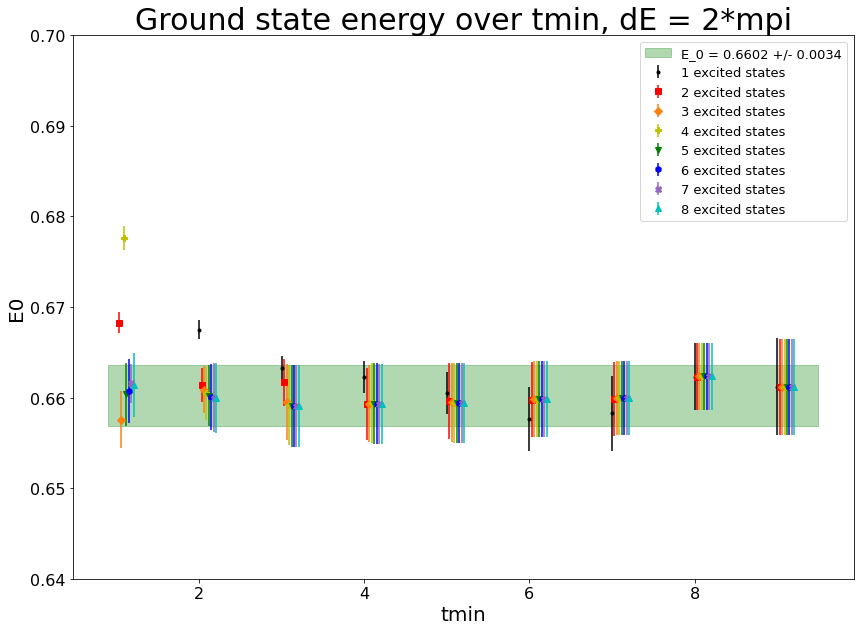

<Figure size 432x288 with 0 Axes>

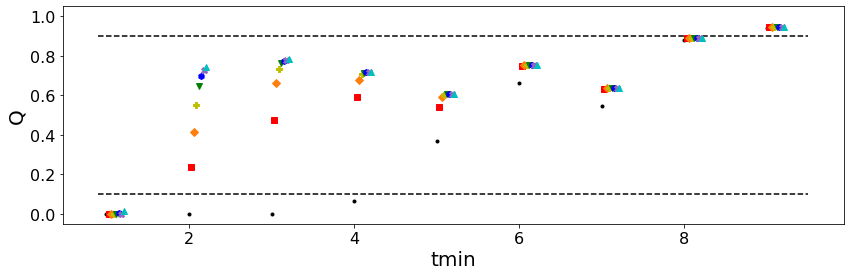

<Figure size 432x288 with 0 Axes>

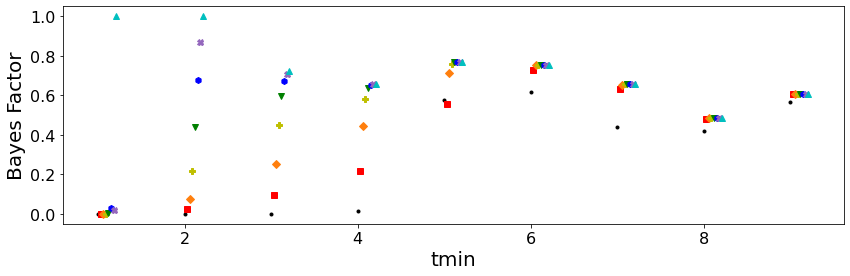

<Figure size 432x288 with 0 Axes>

In [24]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_a0)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a0[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a0[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))
plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[4][1].mean + E0_tmin_bmax_a0[4][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[4][1].mean - E0_tmin_bmax_a0[4][1].sdev  for i in tmin_samp_line], color="green",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[4][1].mean, E0_tmin_bmax_a0[4][1].sdev))
plt.title("Ground state energy over tmin, dE = 2*mpi", fontsize = 30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dEconst_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_a0)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dEconst_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a0)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a0[i][k] for k in range(len(tmin))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dEconst_tmin_comparison.png")
plt.show()

plt.clf()

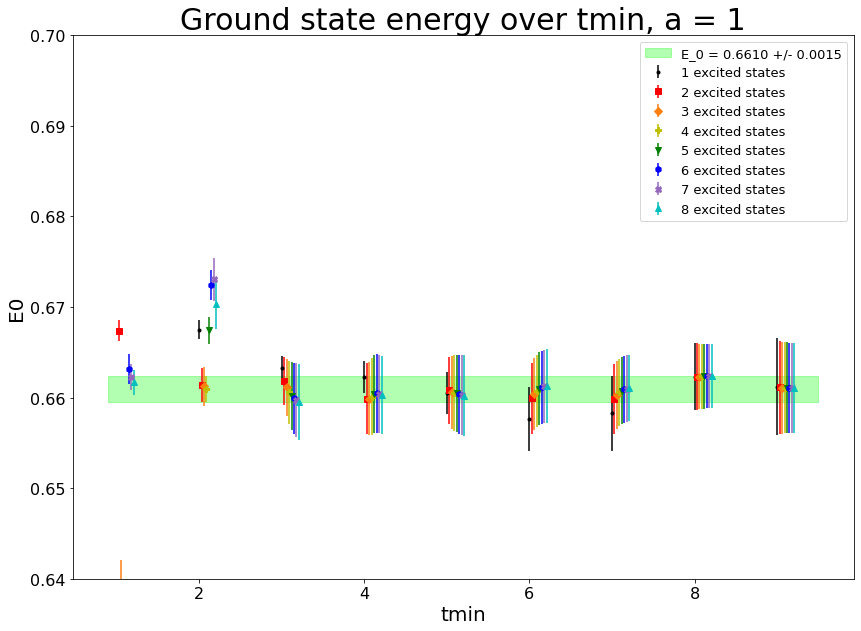

<Figure size 432x288 with 0 Axes>

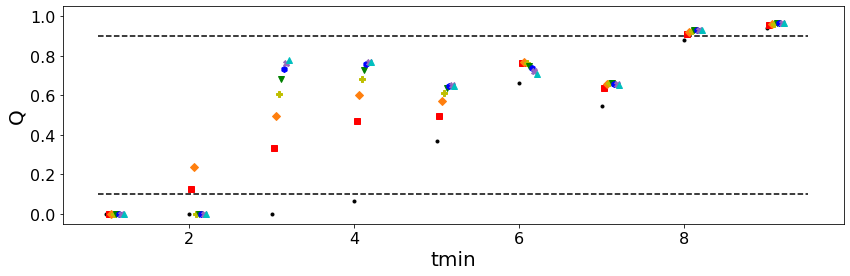

<Figure size 432x288 with 0 Axes>

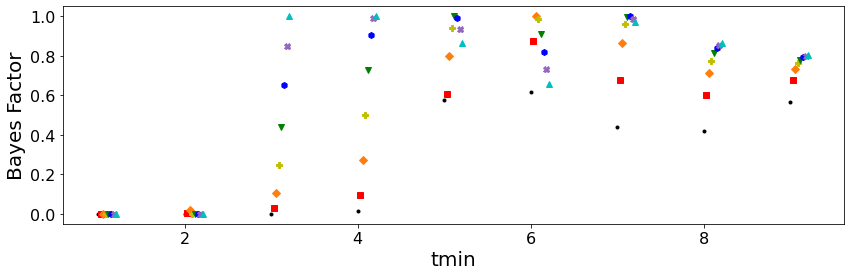

<Figure size 432x288 with 0 Axes>

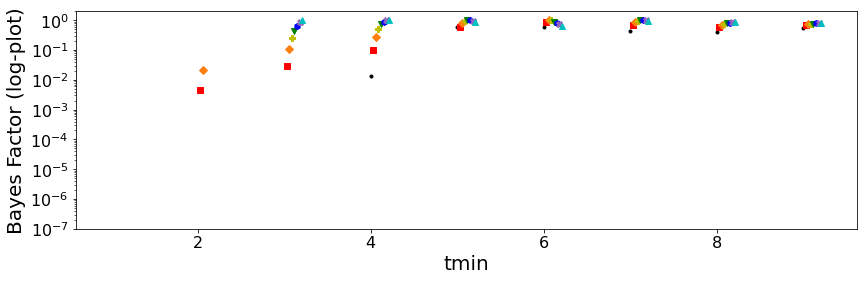

In [25]:
# Make a plot of E0 values vs tmin for a=1 , with a Q-plot and a Bayes factor plot right below, 
a1_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a1_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_a1)):
       
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a1[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a1[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a1[3][1].mean + E0_tmin_bmax_a1[3][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a1[3][1].mean - E0_tmin_bmax_a1[3][1].sdev  for i in tmin_samp_line], color="lime",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a1[3][1].mean, E0_tmin_bmax_a1[3][1].sdev))
plt.title("Ground state energy over tmin, a = 1", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dE1overn_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_a1)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a1)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a1[i][k] for k in range(len(tmin))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a1_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a1)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a1[i][k] for k in range(len(tmin))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.show()



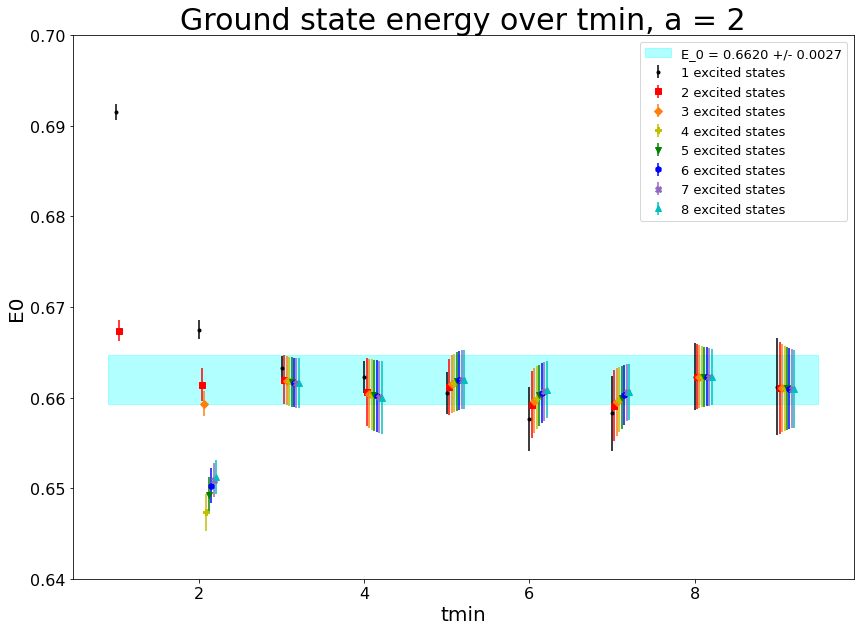

<Figure size 432x288 with 0 Axes>

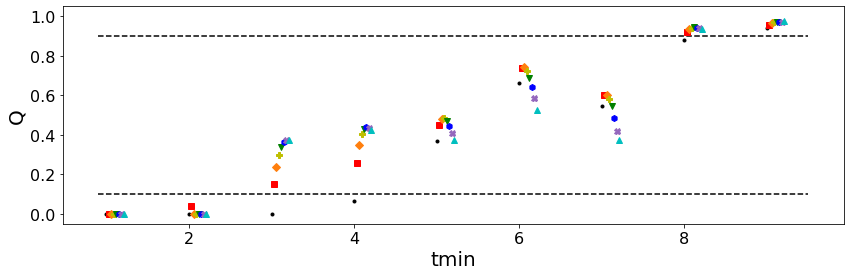

<Figure size 432x288 with 0 Axes>

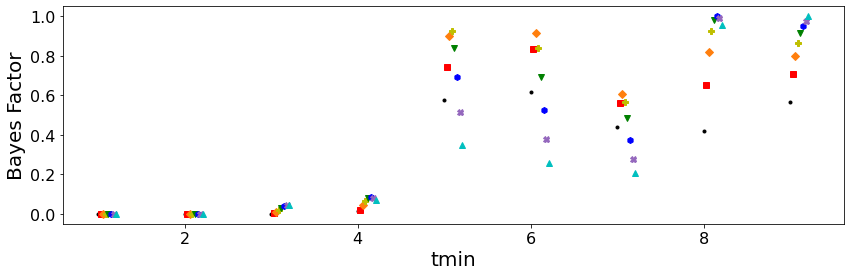

<Figure size 432x288 with 0 Axes>

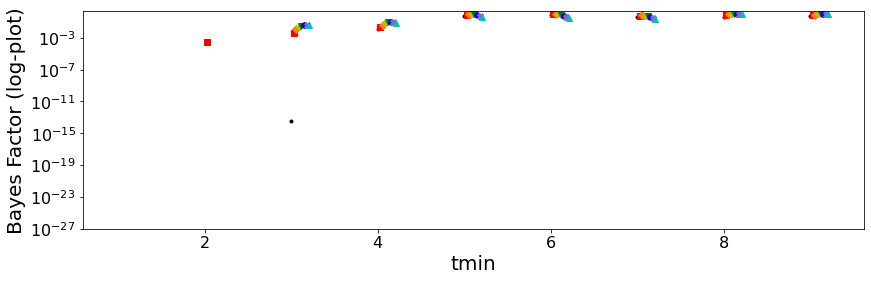

In [26]:
# Make a plot of E0 values vs tmin for a=2 , with a Q-plot and a Bayes factor plot right below, 
a2_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a2_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmin_bmax_a2)):
    E0_tmin_bmax_a2[i]
    plt.errorbar(tmin+ i*0.03, [E0_tmin_bmax_a2[i][k].mean for k in range(len(tmin))], yerr = [E0_tmin_bmax_a2[i][k].sdev for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a2[1][2].mean + E0_tmin_bmax_a2[1][2].sdev for i in tmin_samp_line], [E0_tmin_bmax_a2[1][2].mean - E0_tmin_bmax_a2[1][2].sdev  for i in tmin_samp_line], color="cyan",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a2[1][2].mean, E0_tmin_bmax_a2[1][2].sdev))
plt.title("Ground state energy over tmin, a = 2", fontsize=30)
plt.xlabel("tmin", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dE1overn^2_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmin_bmax_a2)):
        
    plt.errorbar(tmin+ i*0.03, [Q_tmin_bmax_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a2_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmin_samp_line, Q_01_line, "k--")
plt.plot(tmin_samp_line, Q_09_line, "k--")
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn^2_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a2)):
        
    plt.errorbar(tmin+ i*0.03, [BF_tmin_bmax_a2[i][k] for k in range(len(tmin))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn^2_tmin_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmin_bmax_a2)):
        
    plt.semilogy(tmin+ i*0.03, [BF_tmin_bmax_a2[i][k] for k in range(len(tmin))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmin", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-27, 2)
plt.show()


### The optimal fit from the old prior's tmin plot

Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.24    logGBF = 488.25

Parameters:
             E0       0.661369 +- 0.00184351             [        0.66 +- 0.01 ]  
             Z0   0.000758637 +- 5.85429e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028696 +- 2.80502e-05             [      0.003 +- 0.001 ]  
             Z1   0.000710652 +- 4.23274e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00486918 +- 0.00031669             [      0.003 +- 0.003 ]  
             Z2    0.00132775 +- 2.18835e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00985828 +- 0.000222785             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.756174 +- 0.065588             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.106812 +- 0.0531957             [     -0.97551 +- 0.7 ]  *
       log(dE3)              -0.97551 +- 0.7             [     -0.97551 +- 0.7 ]  
             Z3             0.0005 +- 0.0005             [    0.0005 +- 0.00

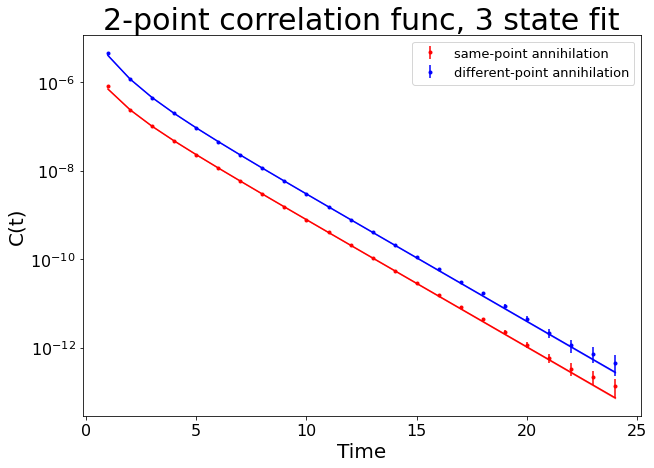

E0 =  0.6613690392247196 +/- 0.0018435079251463704


In [27]:
num_zs = 3

fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(tmin[1], 13)]), np.array([avg_data_original['proton'][l] for l in range(tmin[1],13)])), prior=priors[a_select_indices[0]][2],fcn=C_2pt,debug=True)
print(fit_a0.format(pstyle='vv'))
y_sample = C_2pt(np.array([i for i in range(0,25)]), fit_a0.p)

# Plot
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.semilogy()
ax.errorbar([i for i in range(1,25)], [avg_data_original['proton'][i][0][0].mean for i in range(1,25)], yerr=[avg_data_original['proton'][i][0][0].sdev for i in range(1,25)], fmt='.', label="same-point annihilation", color='red')
ax.errorbar([i for i in range(1,25)], [avg_data_original['proton'][i][1][0].mean for i in range(1,25)], yerr=[avg_data_original['proton'][i][1][0].sdev for i in range(1,25)], fmt='.', label="different-point annihilation", color='blue')
ax.errorbar([i for i in range(1,25)],[y_sample[i][0][0].mean for i in range(1,25)],ls='-',color="red")
ax.fill_between([i for i in range(1,25)],[y_sample[i][0][0].mean + y_sample[i][0][0].sdev for i in range(1,25)], [y_sample[i][0][0].mean - y_sample[i][0][0].sdev for i in range(1,25)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,25)],[y_sample[i][1][0].mean for i in range(1,25)],ls='-',color="blue")
ax.fill_between([i for i in range(1,25)],[y_sample[i][1][0].mean + y_sample[i][1][0].sdev for i in range(1,25)], [y_sample[i][1][0].mean - y_sample[i][1][0].sdev for i in range(1,25)], color="blue",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("C(t)", fontsize = 20)
plt.title("2-point correlation func, 3 state fit", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
plt.savefig('optimalfit_2ptcorrelation_numzs3.png')
plt.show()


print("E0 = ", fit_a0.p['E0'].mean, "+/-", fit_a0.p['E0'].sdev)

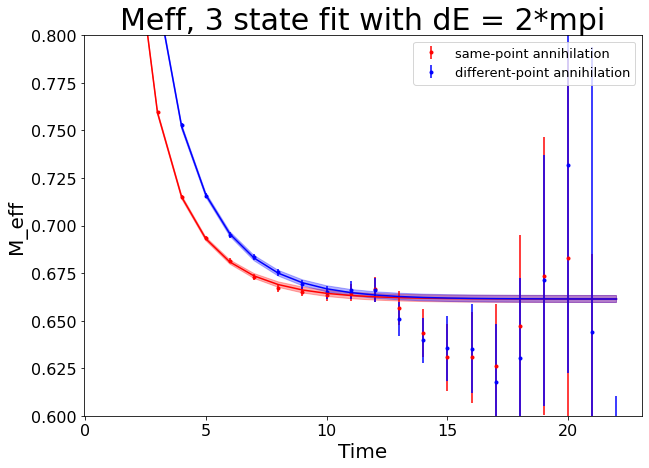

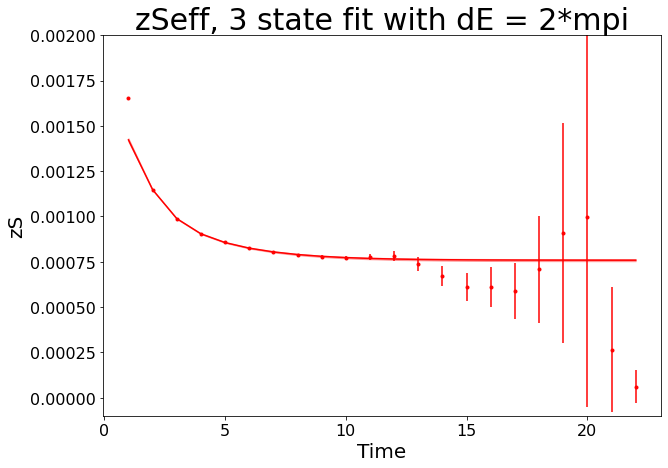

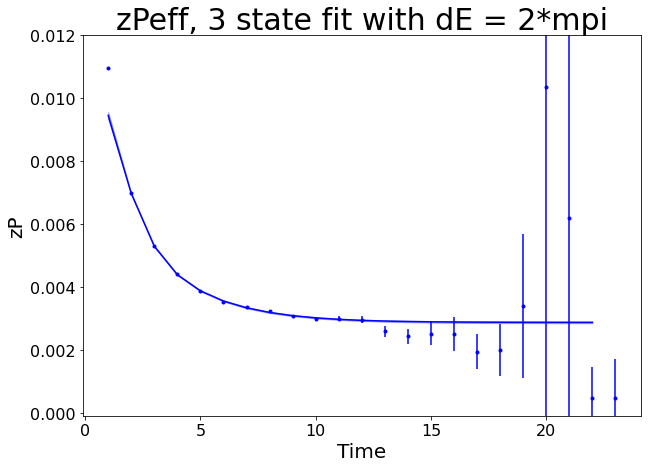

In [28]:
model_eff_mass = np.array([np.log(y_sample[i]/y_sample[i+1]) for i in range(0,24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar([i for i in range(1,23)], [eff_mass[0][i].mean for i in range(1,23)], yerr=[eff_mass[0][i].sdev for i in range(1,23)], fmt='.', label="same-point annihilation", color="red")
ax.errorbar([i for i in range(1,23)], [eff_mass[1][i].mean for i in range(1,23)], yerr=[eff_mass[1][i].sdev for i in range(1,23)], fmt='.', label="different-point annihilation", color="blue")

ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][0][0].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][0][0].mean + model_eff_mass[i][0][0].sdev for i in range(1,23)], [model_eff_mass[i][0][0].mean - model_eff_mass[i][0][0].sdev for i in range(1,23)], color="red",alpha=0.3)
ax.errorbar([i for i in range(1,23)],[model_eff_mass[i][1][0].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_eff_mass[i][1][0].mean + model_eff_mass[i][1][0].sdev for i in range(1,23)], [model_eff_mass[i][1][0].mean - model_eff_mass[i][1][0].sdev for i in range(1,23)], color="blue",alpha=0.3)

plt.xlabel("Time", fontsize = 20)
plt.ylabel("M_eff", fontsize = 20)
plt.ylim(0.6, 0.8)
plt.title("Meff, 3 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.legend(fontsize=13)
plt.savefig('optimalfit_2pteffmass_numzs3.png')
plt.show()


# Plot effective zSS
model_zS_eff = np.array([np.sqrt(np.exp(model_eff_mass[t][0][0]*t)*y_sample[t][0][0]) for t in range(0, 24)])

y_sample
fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 23)]), np.array([avg_data_original['zs_eff'][i].mean for i in range(1, 23)]), np.array([avg_data_original['zs_eff'][i].sdev for i in range(1, 23)]), fmt='.', color = 'red')

ax.errorbar([i for i in range(1,23)],[model_zS_eff[i].mean for i in range(1,23)],ls='-',color="red")
ax.fill_between([i for i in range(1,23)],[model_zS_eff[i].mean + model_zS_eff[i].sdev for i in range(1,23)], [model_zS_eff[i].mean - model_zS_eff[i].sdev for i in range(1,23)], color="red",alpha=0.3)

plt.xlabel("Time", fontsize = 20)
plt.ylabel("zS", fontsize = 20)
plt.ylim(-0.0001, 0.002)
plt.title("zSeff, 3 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('optimalfit_2pteffzs_numzs3.png')
plt.show()


model_zP_eff = np.array([np.exp(model_eff_mass[t][1][0]*t)*y_sample[t][1][0]/model_zS_eff[t] for t in range(0, 24)])

fig = plt.figure(figsize=(10,7))
ax = plt.axes()
ax.errorbar(np.array([i for i in range(1, 24)]), np.array([avg_data_original['zp_eff'][i].mean for i in range(1, 24)]), np.array([avg_data_original['zp_eff'][i].sdev for i in range(1, 24)]), fmt='.', color="blue")

ax.errorbar([i for i in range(1,23)],[model_zP_eff[i].mean for i in range(1,23)],ls='-',color="blue")
ax.fill_between([i for i in range(1,23)],[model_zP_eff[i].mean + model_zP_eff[i].sdev for i in range(1,23)], [model_zP_eff[i].mean - model_zP_eff[i].sdev for i in range(1,23)], color="blue",alpha=0.3)
plt.xlabel("Time", fontsize = 20)
plt.ylabel("zP", fontsize = 20)
plt.ylim(-0.0001, 0.012)
plt.title("zPeff, 3 state fit with dE = 2*mpi", fontsize = 30)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.savefig('optimalfit_2pteffzp_numzs3.png')
plt.show()


## Now, do the same with tmax 

In [29]:
# Test to see if tmax affects the fit at all
tmax = np.array([13, 15, 18, 20, 22, 25])

list_tmax_LogGBF_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a0 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

list_tmax_LogGBF_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a1 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

list_tmax_LogGBF_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_Q_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
list_tmax_E0_a2 = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

In [30]:
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmax)):
            num_zs = j + np.min(num_fitsamples) + 1
            fit_a0 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([avg_data_original['proton'][l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[0]][i],fcn=C_2pt,debug=True)
            fit_a1 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([avg_data_original['proton'][l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[1]][i],fcn=C_2pt,debug=True)
            fit_a2 = lsqfit.nonlinear_fit(data=(np.array([l for l in range(2, tmax[k])]), np.array([avg_data_original['proton'][l] for l in range(2, tmax[k])])), prior=priors[a_select_indices[2]][i],fcn=C_2pt,debug=True)
            
            print("\ni = ", i, " j = ", j, " k = ", k, "\n")
            
            list_tmax_LogGBF_a0[i][j][k] = fit_a0.logGBF
            list_tmax_Q_a0[i][j][k] = fit_a0.Q
            list_tmax_E0_a0[i][j][k] = fit_a0.p['E0']
            
            print("Fit for a = ", a[a_select_indices[0]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmax = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a0[i][j][k])
            print("list Q: ", list_tmax_Q_a0[i][j][k])
            print("list E0: ", list_tmax_E0_a0[i][j][k])
            print(fit_a0.format(pstyle='vv'))
            
            list_tmax_LogGBF_a1[i][j][k] = fit_a1.logGBF
            list_tmax_Q_a1[i][j][k] = fit_a1.Q
            list_tmax_E0_a1[i][j][k] = fit_a1.p['E0']
            
            print("Fit for a = ", a[a_select_indices[1]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a1[i][j][k])
            print("list Q: ", list_tmax_Q_a1[i][j][k])
            print("list E0: ", list_tmax_E0_a1[i][j][k])
            print(fit_a1.format(pstyle='vv'))
            
            list_tmax_LogGBF_a2[i][j][k] = fit_a2.logGBF
            list_tmax_Q_a2[i][j][k] = fit_a2.Q
            list_tmax_E0_a2[i][j][k] = fit_a2.p['E0']
            
            print("Fit for a = ", a[a_select_indices[2]], ", b = ", b[i], ", ", j + np.min(num_fitsamples), " excited states, tmin = ", tmax[k])
            print("list logGBF: ", list_tmax_LogGBF_a2[i][j][k])
            print("list Q: ", list_tmax_Q_a2[i][j][k])
            print("list E0: ", list_tmax_E0_a2[i][j][k])
            print(fit_a2.format(pstyle='vv'))


i =  0  j =  0  k =  0 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  13
list logGBF:  245.56246102668678
list Q:  7.233092121448527e-98
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 7.2e-98    logGBF = 245.56

Parameters:
             E0      0.667465 +- 0.00107538            [        0.66 +- 0.01 ]  
             Z0   0.000785557 +- 2.5137e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0    0.0030373 +- 1.21392e-05            [      0.003 +- 0.001 ]  
             Z1   0.00125249 +- 3.75981e-06            [    0.0005 +- 0.0005 ]  *
        Ztilde1   0.00917867 +- 4.27851e-05            [      0.003 +- 0.003 ]  **
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)     -0.128205 +- 0.00678118            [     -0.97551 +- 0.3 ]  **
       log(dE2)             -0.97551 +- 0.3            [     -0.97551 +- 0.3 ]  
  


i =  0  j =  0  k =  1 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  15
list logGBF:  351.8922179842713
list Q:  9.327602441245414e-97
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 21 [26]    Q = 9.3e-97    logGBF = 351.89

Parameters:
             E0       0.667445 +- 0.00107388             [        0.66 +- 0.01 ]  
             Z0   0.000785233 +- 2.51058e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303565 +- 1.21036e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125228 +- 3.74333e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1     0.0091698 +- 4.24788e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12947 +- 0.00673085             [     -0.97551 +- 0.3 ]  **
       log(dE2)              -0.97551 +- 0.3             [     -0.97


i =  0  j =  0  k =  2 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  18
list logGBF:  518.6356574137196
list Q:  3.1072322376518753e-94
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 3.1e-94    logGBF = 518.64

Parameters:
             E0       0.667418 +- 0.00107226             [        0.66 +- 0.01 ]  
             Z0   0.000785221 +- 2.50749e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303519 +- 1.20869e-05             [      0.003 +- 0.001 ]  
             Z1     0.0012522 +- 3.74735e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00916931 +- 4.24958e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128715 +- 0.00673175             [     -0.97551 +- 0.3 ]  **
       log(dE2)              -0.97551 +- 0.3             [     -0.9


i =  0  j =  0  k =  3 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  20
list logGBF:  632.0258852928041
list Q:  4.9135352787764855e-93
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 4.9e-93    logGBF = 632.03

Parameters:
             E0       0.667266 +- 0.00106794             [        0.66 +- 0.01 ]  
             Z0   0.000784843 +- 2.49609e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303378 +- 1.20518e-05             [      0.003 +- 0.001 ]  
             Z1      0.00125287 +- 3.732e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00917027 +- 4.22635e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128357 +- 0.00669565             [     -0.97551 +- 0.3 ]  **
       log(dE2)              -0.97551 +- 0.3             [     -0.9


i =  0  j =  0  k =  4 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  22
list logGBF:  748.7000373825653
list Q:  1.7741042380990458e-91
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.8e-91    logGBF = 748.7

Parameters:
             E0       0.667314 +- 0.00106702             [        0.66 +- 0.01 ]  
             Z0   0.000784902 +- 2.49431e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303397 +- 1.20348e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125258 +- 3.72032e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00916936 +- 4.21254e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128905 +- 0.00668356             [     -0.97551 +- 0.3 ]  **
       log(dE2)              -0.97551 +- 0.3             [     -0.97


i =  0  j =  0  k =  5 

Fit for a =  0.0 , b =  0.3 ,  1  excited states, tmax =  25
list logGBF:  925.5411626273773
list Q:  2.732795411032982e-90
list E0:  0.6672(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 2.7e-90    logGBF = 925.54

Parameters:
             E0       0.667224 +- 0.00106211             [        0.66 +- 0.01 ]  
             Z0   0.000784761 +- 2.48812e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303351 +- 1.19862e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125175 +- 3.69325e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1      0.00916523 +- 4.193e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12984 +- 0.00664742             [     -0.97551 +- 0.3 ]  **
       log(dE2)              -0.97551 +- 0.3             [     -0.97


i =  0  j =  1  k =  0 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  13
list logGBF:  486.3614165894526
list Q:  0.057342252187946176
list E0:  0.6615(19)
Least Square Fit:
  chi2/dof [dof] = 1.5 [22]    Q = 0.057    logGBF = 486.36

Parameters:
             E0       0.661479 +- 0.00186804             [        0.66 +- 0.01 ]  
             Z0   0.000758732 +- 5.96968e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286864 +- 2.85355e-05             [      0.003 +- 0.001 ]  
             Z1   0.000692966 +- 4.18232e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00474757 +- 0.000310222             [      0.003 +- 0.003 ]  
             Z2     0.00132016 +- 1.8869e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00977996 +- 0.000198119             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.778471 +- 0.0668875             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.129611 +- 0.0485465             [     -0.97551 


i =  0  j =  1  k =  1 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  15
list logGBF:  591.5126143127284
list Q:  0.01693875698172091
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1.7 [26]    Q = 0.017    logGBF = 591.51

Parameters:
             E0       0.661727 +- 0.00184315             [        0.66 +- 0.01 ]  
             Z0   0.000759534 +- 5.84234e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00287391 +- 2.7847e-05             [      0.003 +- 0.001 ]  
             Z1   0.000698359 +- 4.24593e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00479374 +- 0.000314661             [      0.003 +- 0.003 ]  
             Z2    0.00132029 +- 1.94823e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00977445 +- 0.000203186             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.765083 +- 0.0660466             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.128213 +- 0.0502664             [     -0.97551 +


i =  0  j =  1  k =  2 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  18
list logGBF:  760.6032509533259
list Q:  0.059648700825783954
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1.4 [32]    Q = 0.06    logGBF = 760.6

Parameters:
             E0       0.661703 +- 0.00183532             [        0.66 +- 0.01 ]  
             Z0   0.000759476 +- 5.82086e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.0028736 +- 2.7739e-05             [      0.003 +- 0.001 ]  
             Z1   0.000699174 +- 4.22018e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00479935 +- 0.000313324             [      0.003 +- 0.003 ]  
             Z2    0.00132084 +- 1.96461e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00977983 +- 0.000204237             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.763571 +- 0.065556             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.126626 +- 0.0503793             [     -0.97551 +-


i =  0  j =  1  k =  3 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  20
list logGBF:  875.2402246771574
list Q:  0.07413795445469647
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.4 [36]    Q = 0.074    logGBF = 875.24

Parameters:
             E0        0.661593 +- 0.0018224             [        0.66 +- 0.01 ]  
             Z0   0.000759206 +- 5.77223e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287327 +- 2.75078e-05             [      0.003 +- 0.001 ]  
             Z1   0.000702632 +- 4.22949e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0048217 +- 0.000314308             [      0.003 +- 0.003 ]  
             Z2    0.00132103 +- 1.98867e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00977511 +- 0.000205836             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.75835 +- 0.0650932             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.124999 +- 0.0510456             [     -0.97551 +


i =  0  j =  1  k =  4 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  22
list logGBF:  992.8014332720089
list Q:  0.11414380459310086
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [40]    Q = 0.11    logGBF = 992.8

Parameters:
             E0       0.661627 +- 0.00182789             [        0.66 +- 0.01 ]  
             Z0   0.000759138 +- 5.79593e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287256 +- 2.76058e-05             [      0.003 +- 0.001 ]  
             Z1    0.00069893 +- 4.21138e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00479561 +- 0.000312077             [      0.003 +- 0.003 ]  
             Z2     0.0013197 +- 1.93435e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00976002 +- 0.000201056             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.763936 +- 0.0652513             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.128822 +- 0.0501137             [     -0.97551 +- 


i =  0  j =  1  k =  5 

Fit for a =  0.0 , b =  0.3 ,  2  excited states, tmax =  25
list logGBF:  1172.69696668248
list Q:  0.15328511549173382
list E0:  0.6618(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [46]    Q = 0.15    logGBF = 1172.7

Parameters:
             E0        0.661775 +- 0.0018027             [        0.66 +- 0.01 ]  
             Z0    0.00075977 +- 5.69722e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287558 +- 2.71125e-05             [      0.003 +- 0.001 ]  
             Z1   0.000700667 +- 4.21672e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00482122 +- 0.000311907             [      0.003 +- 0.003 ]  
             Z2     0.00132019 +- 1.9669e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00975274 +- 0.000202973             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.758825 +- 0.0644764             [     -0.97551 +- 0.3 ]  
       log(dE2)       -0.127345 +- 0.0507974             [     -0.97551 +- 


i =  0  j =  2  k =  0 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  13
list logGBF:  489.8838595527974
list Q:  0.3030072665845118
list E0:  0.6605(28)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.3    logGBF = 489.88

Parameters:
             E0       0.660486 +- 0.00282228             [        0.66 +- 0.01 ]  
             Z0   0.000754561 +- 1.05958e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285017 +- 4.70786e-05             [      0.003 +- 0.001 ]  
             Z1   0.000661274 +- 5.81738e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00438064 +- 0.000521011             [      0.003 +- 0.003 ]  
             Z2   0.000492752 +- 0.000308788             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00419125 +- 0.00182056             [      0.003 +- 0.003 ]  
       log(dE1)        -0.836246 +- 0.106957             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.681406 +- 0.21995             [     -0.97551 +- 0.3 


i =  0  j =  2  k =  1 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  15
list logGBF:  595.1529268390502
list Q:  0.11416737460287907
list E0:  0.6604(28)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.11    logGBF = 595.15

Parameters:
             E0       0.660424 +- 0.00280995             [        0.66 +- 0.01 ]  
             Z0   0.000754134 +- 1.05408e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285034 +- 4.67308e-05             [      0.003 +- 0.001 ]  
             Z1    0.000666067 +- 5.8861e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0043755 +- 0.000527411             [      0.003 +- 0.003 ]  
             Z2   0.000479231 +- 0.000320373             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00434092 +- 0.00175275             [      0.003 +- 0.003 ]  
       log(dE1)         -0.83156 +- 0.107515             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.682751 +- 0.22099             [     -0.97551 +- 0.


i =  0  j =  2  k =  2 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  18
list logGBF:  764.2954294084034
list Q:  0.26610300379518304
list E0:  0.6602(28)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.27    logGBF = 764.3

Parameters:
             E0        0.660238 +- 0.0028164             [        0.66 +- 0.01 ]  
             Z0   0.000753426 +- 1.05911e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284727 +- 4.69276e-05             [      0.003 +- 0.001 ]  
             Z1   0.000666248 +- 5.87253e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00435526 +- 0.000525087             [      0.003 +- 0.003 ]  
             Z2    0.00047349 +- 0.000324734             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00440626 +- 0.00171348             [      0.003 +- 0.003 ]  
       log(dE1)        -0.835249 +- 0.107865             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.683064 +- 0.221447             [     -0.97551 +- 0.3


i =  0  j =  2  k =  3 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  20
list logGBF:  878.9599986970832
list Q:  0.2938431252179259
list E0:  0.6601(28)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.29    logGBF = 878.96

Parameters:
             E0         0.6601 +- 0.00280129             [        0.66 +- 0.01 ]  
             Z0   0.000753066 +- 1.05132e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028466 +- 4.65817e-05             [      0.003 +- 0.001 ]  
             Z1   0.000669798 +- 5.88043e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00437406 +- 0.000526567             [      0.003 +- 0.003 ]  
             Z2   0.000470637 +- 0.000327026             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00442053 +- 0.00170599             [      0.003 +- 0.003 ]  
       log(dE1)        -0.830074 +- 0.107177             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.682799 +- 0.221795             [     -0.97551 +- 0.3


i =  0  j =  2  k =  4 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  22
list logGBF:  996.5281072525987
list Q:  0.37980512536228744
list E0:  0.6600(28)
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.38    logGBF = 996.53

Parameters:
             E0       0.660006 +- 0.00283842             [        0.66 +- 0.01 ]  
             Z0   0.000752447 +- 1.07115e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00284348 +- 4.7418e-05             [      0.003 +- 0.001 ]  
             Z1      0.00066468 +- 5.894e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00432218 +- 0.000525208             [      0.003 +- 0.003 ]  
             Z2   0.000473546 +- 0.000326339             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00448651 +- 0.00167185             [      0.003 +- 0.003 ]  
       log(dE1)        -0.841575 +- 0.109118             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.685023 +- 0.22182             [     -0.97551 +- 0.


i =  0  j =  2  k =  5 

Fit for a =  0.0 , b =  0.3 ,  3  excited states, tmax =  25
list logGBF:  1176.5285338046565
list Q:  0.4444629435794929
list E0:  0.6599(28)
Least Square Fit:
  chi2/dof [dof] = 1 [46]    Q = 0.44    logGBF = 1176.5

Parameters:
             E0       0.659917 +- 0.00284364             [        0.66 +- 0.01 ]  
             Z0   0.000752109 +- 1.07851e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284236 +- 4.76902e-05             [      0.003 +- 0.001 ]  
             Z1   0.000665048 +- 5.92623e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00430372 +- 0.000528645             [      0.003 +- 0.003 ]  
             Z2     0.00046546 +- 0.00033353             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00459724 +- 0.00161078             [      0.003 +- 0.003 ]  
       log(dE1)         -0.84463 +- 0.110292             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.687336 +- 0.222916             [     -0.97551 +- 0.3 


i =  0  j =  3  k =  0 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  13
list logGBF:  491.5226898751191
list Q:  0.5250064779426125
list E0:  0.6602(31)
Least Square Fit:
  chi2/dof [dof] = 0.95 [22]    Q = 0.53    logGBF = 491.52

Parameters:
             E0       0.660192 +- 0.00314513             [        0.66 +- 0.01 ]  
             Z0       0.000753 +- 1.2366e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284247 +- 5.40546e-05             [      0.003 +- 0.001 ]  
             Z1   0.000612566 +- 8.36174e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00398182 +- 0.000705444             [      0.003 +- 0.003 ]  
             Z2   0.000524912 +- 0.000288774             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00433928 +- 0.0017005             [      0.003 +- 0.003 ]  
       log(dE1)        -0.896998 +- 0.144995             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.880737 +- 0.260664             [     -0.97551 +- 0.


i =  0  j =  3  k =  1 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  15
list logGBF:  596.7758359188208
list Q:  0.23195444396506695
list E0:  0.6601(31)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.23    logGBF = 596.78

Parameters:
             E0       0.660071 +- 0.00313317             [        0.66 +- 0.01 ]  
             Z0    0.00075235 +- 1.23081e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028419 +- 5.36694e-05             [      0.003 +- 0.001 ]  
             Z1   0.000618465 +- 8.39288e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00397557 +- 0.000709512             [      0.003 +- 0.003 ]  
             Z2   0.000515036 +- 0.000293961             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00442834 +- 0.00169164             [      0.003 +- 0.003 ]  
       log(dE1)        -0.892116 +- 0.145229             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.880896 +- 0.260677             [     -0.97551 +- 0.


i =  0  j =  3  k =  2 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  18
list logGBF:  765.9143006876751
list Q:  0.4412366259420711
list E0:  0.6598(31)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.44    logGBF = 765.91

Parameters:
             E0         0.659846 +- 0.003148             [        0.66 +- 0.01 ]  
             Z0   0.000751464 +- 1.24125e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028381 +- 5.40765e-05             [      0.003 +- 0.001 ]  
             Z1   0.000618485 +- 8.37108e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00394893 +- 0.000706409             [      0.003 +- 0.003 ]  
             Z2   0.000510859 +- 0.000295255             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00447222 +- 0.0016783             [      0.003 +- 0.003 ]  
       log(dE1)         -0.897645 +- 0.14623             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.880821 +- 0.260685             [     -0.97551 +- 0.3 ]


i =  0  j =  3  k =  3 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  20
list logGBF:  880.5801399996462
list Q:  0.4659511726813388
list E0:  0.6597(31)
Least Square Fit:
  chi2/dof [dof] = 1 [36]    Q = 0.47    logGBF = 880.58

Parameters:
             E0       0.659706 +- 0.00312994             [        0.66 +- 0.01 ]  
             Z0   0.000751113 +- 1.23096e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283753 +- 5.36288e-05             [      0.003 +- 0.001 ]  
             Z1   0.000622442 +- 8.37703e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00397035 +- 0.000708419             [      0.003 +- 0.003 ]  
             Z2   0.000508986 +- 0.000296357             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00447805 +- 0.00168207             [      0.003 +- 0.003 ]  
       log(dE1)         -0.89131 +- 0.145031             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.881369 +- 0.260914             [     -0.97551 +- 0.3 ]


i =  0  j =  3  k =  4 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  22
list logGBF:  998.1395479436347
list Q:  0.5571111889073934
list E0:  0.6596(32)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.56    logGBF = 998.14

Parameters:
             E0       0.659592 +- 0.00318106             [        0.66 +- 0.01 ]  
             Z0   0.000750372 +- 1.26006e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283385 +- 5.48208e-05             [      0.003 +- 0.001 ]  
             Z1    0.00061629 +- 8.39556e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00390954 +- 0.000705939             [      0.003 +- 0.003 ]  
             Z2   0.000512407 +- 0.000294032             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00452459 +- 0.00165815             [      0.003 +- 0.003 ]  
       log(dE1)        -0.905989 +- 0.148458             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.880646 +- 0.260518             [     -0.97551 +- 0.


i =  0  j =  3  k =  5 

Fit for a =  0.0 , b =  0.3 ,  4  excited states, tmax =  25
list logGBF:  1178.1301589051204
list Q:  0.6151276649143212
list E0:  0.6594(32)
Least Square Fit:
  chi2/dof [dof] = 0.93 [46]    Q = 0.62    logGBF = 1178.1

Parameters:
             E0       0.659446 +- 0.00320508             [        0.66 +- 0.01 ]  
             Z0   0.000749777 +- 1.27779e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283169 +- 5.55023e-05             [      0.003 +- 0.001 ]  
             Z1   0.000616367 +- 8.41989e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00388093 +- 0.000708778             [      0.003 +- 0.003 ]  
             Z2   0.000506998 +- 0.000295969             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00459973 +- 0.00164136             [      0.003 +- 0.003 ]  
       log(dE1)        -0.911577 +- 0.150697             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.881965 +- 0.260616             [     -0.97551 +- 0


i =  0  j =  4  k =  0 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  13
list logGBF:  492.2793772803516
list Q:  0.638421762081406
list E0:  0.6601(34)
Least Square Fit:
  chi2/dof [dof] = 0.87 [22]    Q = 0.64    logGBF = 492.28

Parameters:
             E0       0.660057 +- 0.00335885             [        0.66 +- 0.01 ]  
             Z0   0.000752113 +- 1.36143e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283786 +- 5.88936e-05             [      0.003 +- 0.001 ]  
             Z1   0.000575165 +- 0.000100888             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00368815 +- 0.000823202             [      0.003 +- 0.003 ]  
             Z2   0.000555315 +- 0.000270641             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00452511 +- 0.00155809             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946472 +- 0.176566             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.949699 +- 0.27204             [     -0.97551 +- 0.3


i =  0  j =  4  k =  1 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  15
list logGBF:  597.5344036626557
list Q:  0.30818608057845603
list E0:  0.6599(33)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.31    logGBF = 597.53

Parameters:
             E0        0.65991 +- 0.00334166             [        0.66 +- 0.01 ]  
             Z0   0.000751369 +- 1.35274e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283707 +- 5.83717e-05             [      0.003 +- 0.001 ]  
             Z1   0.000582465 +- 0.000100732             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00368759 +- 0.00082541             [      0.003 +- 0.003 ]  
             Z2   0.000544801 +- 0.000275427             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00459228 +- 0.00156219             [      0.003 +- 0.003 ]  
       log(dE1)        -0.940108 +- 0.176082             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.949528 +- 0.271691             [     -0.97551 +- 0.


i =  0  j =  4  k =  2 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  18
list logGBF:  766.6738614043938
list Q:  0.534145093976115
list E0:  0.6597(34)
Least Square Fit:
  chi2/dof [dof] = 0.96 [32]    Q = 0.53    logGBF = 766.67

Parameters:
             E0       0.659667 +- 0.00335985             [        0.66 +- 0.01 ]  
             Z0   0.000750394 +- 1.36608e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283292 +- 5.88878e-05             [      0.003 +- 0.001 ]  
             Z1   0.000582661 +- 0.000100266             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00366007 +- 0.000820277             [      0.003 +- 0.003 ]  
             Z2   0.000540485 +- 0.000276186             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00462515 +- 0.00155241             [      0.003 +- 0.003 ]  
       log(dE1)        -0.946539 +- 0.177379             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.948872 +- 0.271411             [     -0.97551 +- 0.3


i =  0  j =  4  k =  3 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  20
list logGBF:  881.3418452680938
list Q:  0.5545643724699012
list E0:  0.6595(33)
Least Square Fit:
  chi2/dof [dof] = 0.95 [36]    Q = 0.55    logGBF = 881.34

Parameters:
             E0       0.659524 +- 0.00334104             [        0.66 +- 0.01 ]  
             Z0   0.000750041 +- 1.35484e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283238 +- 5.84023e-05             [      0.003 +- 0.001 ]  
             Z1   0.000586598 +- 0.000100464             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00368071 +- 0.000824282             [      0.003 +- 0.003 ]  
             Z2   0.000539337 +- 0.000276927             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00463438 +- 0.00155644             [      0.003 +- 0.003 ]  
       log(dE1)        -0.939645 +- 0.176048             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.950108 +- 0.271683             [     -0.97551 +- 0.


i =  0  j =  4  k =  4 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  22
list logGBF:  998.8991766035643
list Q:  0.6412734560653539
list E0:  0.6594(34)
Least Square Fit:
  chi2/dof [dof] = 0.91 [40]    Q = 0.64    logGBF = 998.9

Parameters:
             E0       0.659412 +- 0.00339398             [        0.66 +- 0.01 ]  
             Z0    0.00074929 +- 1.38623e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282865 +- 5.96728e-05             [      0.003 +- 0.001 ]  
             Z1   0.000580859 +- 0.000100223             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00362442 +- 0.00081665             [      0.003 +- 0.003 ]  
             Z2   0.000541005 +- 0.000275224             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00465848 +- 0.00153887             [      0.003 +- 0.003 ]  
       log(dE1)        -0.955074 +- 0.179688             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.947106 +- 0.270833             [     -0.97551 +- 0.3


i =  0  j =  4  k =  5 

Fit for a =  0.0 , b =  0.3 ,  5  excited states, tmax =  25
list logGBF:  1178.8871604465937
list Q:  0.691868414192219
list E0:  0.6592(34)
Least Square Fit:
  chi2/dof [dof] = 0.89 [46]    Q = 0.69    logGBF = 1178.9

Parameters:
             E0       0.659246 +- 0.00342445             [        0.66 +- 0.01 ]  
             Z0   0.000748596 +- 1.40816e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028261 +- 6.05133e-05             [      0.003 +- 0.001 ]  
             Z1   0.000581037 +- 0.000100185             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00359424 +- 0.00081662             [      0.003 +- 0.003 ]  
             Z2   0.000536243 +- 0.000276067             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0047182 +- 0.00152619             [      0.003 +- 0.003 ]  
       log(dE1)        -0.961719 +- 0.182306             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.94723 +- 0.270427             [     -0.97551 +- 0.


i =  0  j =  5  k =  0 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  13
list logGBF:  492.6464467503289
list Q:  0.6905893707946426
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.83 [22]    Q = 0.69    logGBF = 492.65

Parameters:
             E0        0.66002 +- 0.00346234             [        0.66 +- 0.01 ]  
             Z0   0.000751764 +- 1.42459e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283587 +- 6.13076e-05             [      0.003 +- 0.001 ]  
             Z1   0.000554149 +- 0.000109944             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00353001 +- 0.000877495             [      0.003 +- 0.003 ]  
             Z2   0.000568192 +- 0.000263264             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00458901 +- 0.00149082             [      0.003 +- 0.003 ]  
       log(dE1)        -0.975378 +- 0.194761             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.976141 +- 0.274686             [     -0.97551 +- 0.


i =  0  j =  5  k =  1 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  15
list logGBF:  597.9065258221478
list Q:  0.34887960300232623
list E0:  0.6599(34)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.35    logGBF = 597.91

Parameters:
             E0       0.659859 +- 0.00344154             [        0.66 +- 0.01 ]  
             Z0   0.000750964 +- 1.41398e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283495 +- 6.07021e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562439 +- 0.000109461             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00353371 +- 0.000878963             [      0.003 +- 0.003 ]  
             Z2   0.000556873 +- 0.000268322             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00464871 +- 0.00150053             [      0.003 +- 0.003 ]  
       log(dE1)        -0.967859 +- 0.193769             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.97584 +- 0.274252             [     -0.97551 +- 0.


i =  0  j =  5  k =  2 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  18
list logGBF:  767.0475782608244
list Q:  0.5790309381739901
list E0:  0.6596(35)
Least Square Fit:
  chi2/dof [dof] = 0.93 [32]    Q = 0.58    logGBF = 767.05

Parameters:
             E0       0.659607 +- 0.00346001             [        0.66 +- 0.01 ]  
             Z0   0.000749948 +- 1.42808e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283065 +- 6.12473e-05             [      0.003 +- 0.001 ]  
             Z1    0.000562942 +- 0.00010875             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00350755 +- 0.000871895             [      0.003 +- 0.003 ]  
             Z2   0.000552138 +- 0.000269132             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00467468 +- 0.00149332             [      0.003 +- 0.003 ]  
       log(dE1)        -0.974505 +- 0.195016             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.974837 +- 0.273841             [     -0.97551 +- 0.


i =  0  j =  5  k =  3 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  20
list logGBF:  881.7173333884328
list Q:  0.596995161740135
list E0:  0.6595(34)
Least Square Fit:
  chi2/dof [dof] = 0.93 [36]    Q = 0.6    logGBF = 881.72

Parameters:
             E0       0.659462 +- 0.00344162             [        0.66 +- 0.01 ]  
             Z0   0.000749586 +- 1.41689e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028301 +- 6.07629e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566719 +- 0.000109099             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00352639 +- 0.0008776             [      0.003 +- 0.003 ]  
             Z2   0.000551415 +- 0.000269668             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00468742 +- 0.0014962             [      0.003 +- 0.003 ]  
       log(dE1)        -0.967521 +- 0.193794             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.976482 +- 0.274137             [     -0.97551 +- 0.3 


i =  0  j =  5  k =  4 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  22
list logGBF:  999.2743712834862
list Q:  0.6799822801735736
list E0:  0.6594(35)
Least Square Fit:
  chi2/dof [dof] = 0.88 [40]    Q = 0.68    logGBF = 999.27

Parameters:
             E0       0.659355 +- 0.00349209             [        0.66 +- 0.01 ]  
             Z0   0.000748855 +- 1.44741e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282645 +- 6.19962e-05             [      0.003 +- 0.001 ]  
             Z1   0.000561712 +- 0.000108407             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00347687 +- 0.000865606             [      0.003 +- 0.003 ]  
             Z2   0.000551663 +- 0.000268707             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00469729 +- 0.00148485             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98258 +- 0.196989             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.972341 +- 0.273096             [     -0.97551 +- 0.


i =  0  j =  5  k =  5 

Fit for a =  0.0 , b =  0.3 ,  6  excited states, tmax =  25
list logGBF:  1179.2616403859047
list Q:  0.7263525819317782
list E0:  0.6592(35)
Least Square Fit:
  chi2/dof [dof] = 0.87 [46]    Q = 0.73    logGBF = 1179.3

Parameters:
             E0        0.659183 +- 0.0035231             [        0.66 +- 0.01 ]  
             Z0   0.000748129 +- 1.47002e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282379 +- 6.28604e-05             [      0.003 +- 0.001 ]  
             Z1   0.000562167 +- 0.000108107             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00344823 +- 0.000863035             [      0.003 +- 0.003 ]  
             Z2   0.000546904 +- 0.000269393             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00474824 +- 0.00147495             [      0.003 +- 0.003 ]  
       log(dE1)        -0.989384 +- 0.199498             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.97185 +- 0.272494             [     -0.97551 +- 0


i =  0  j =  6  k =  0 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  13
list logGBF:  492.8299986177208
list Q:  0.7142862741439019
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.81 [22]    Q = 0.71    logGBF = 492.83

Parameters:
             E0       0.660023 +- 0.00350628             [        0.66 +- 0.01 ]  
             Z0   0.000751676 +- 1.45237e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283521 +- 6.23606e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543492 +- 0.000114193             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00345391 +- 0.000900081             [      0.003 +- 0.003 ]  
             Z2     0.000573449 +- 0.0002606             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00460494 +- 0.00146352             [      0.003 +- 0.003 ]  
       log(dE1)        -0.989996 +- 0.203709             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.987009 +- 0.275149             [     -0.97551 +- 0.


i =  0  j =  6  k =  1 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  15
list logGBF:  598.0951656565449
list Q:  0.36906013295670964
list E0:  0.6599(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.37    logGBF = 598.1

Parameters:
             E0       0.659853 +- 0.00348397             [        0.66 +- 0.01 ]  
             Z0   0.000750841 +- 1.44099e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283421 +- 6.17236e-05             [      0.003 +- 0.001 ]  
             Z1   0.000552296 +- 0.000113552             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00345949 +- 0.000901536             [      0.003 +- 0.003 ]  
             Z2    0.000561577 +- 0.00026587             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00466162 +- 0.0014756             [      0.003 +- 0.003 ]  
       log(dE1)        -0.981893 +- 0.202507             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986815 +- 0.274717             [     -0.97551 +- 0.3


i =  0  j =  6  k =  2 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  18
list logGBF:  767.2375440871153
list Q:  0.6002543589763607
list E0:  0.6596(35)
Least Square Fit:
  chi2/dof [dof] = 0.92 [32]    Q = 0.6    logGBF = 767.24

Parameters:
             E0       0.659597 +- 0.00350239             [        0.66 +- 0.01 ]  
             Z0   0.000749805 +- 1.45538e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282983 +- 6.22806e-05             [      0.003 +- 0.001 ]  
             Z1   0.000553006 +- 0.000112689             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00343436 +- 0.000893378             [      0.003 +- 0.003 ]  
             Z2    0.00055652 +- 0.000266795             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00468395 +- 0.00146997             [      0.003 +- 0.003 ]  
       log(dE1)        -0.988589 +- 0.203678             [     -0.97551 +- 0.3 ]  
       log(dE2)         -0.985686 +- 0.27426             [     -0.97551 +- 0.3


i =  0  j =  6  k =  3 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  20
list logGBF:  881.9086956877773
list Q:  0.617030325439461
list E0:  0.6595(35)
Least Square Fit:
  chi2/dof [dof] = 0.91 [36]    Q = 0.62    logGBF = 881.91

Parameters:
             E0       0.659451 +- 0.00348431             [        0.66 +- 0.01 ]  
             Z0    0.000749437 +- 1.4443e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282926 +- 6.17999e-05             [      0.003 +- 0.001 ]  
             Z1   0.000556673 +- 0.000113129             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00345199 +- 0.000900026             [      0.003 +- 0.003 ]  
             Z2   0.000556002 +- 0.000267222             [    0.0005 +- 0.0005 ]  
        Ztilde2       0.00469867 +- 0.001472             [      0.003 +- 0.003 ]  
       log(dE1)        -0.981613 +- 0.202559             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.987535 +- 0.274563             [     -0.97551 +- 0.3


i =  0  j =  6  k =  4 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  22
list logGBF:  999.4658635124164
list Q:  0.6979136957301839
list E0:  0.6593(35)
Least Square Fit:
  chi2/dof [dof] = 0.87 [40]    Q = 0.7    logGBF = 999.47

Parameters:
             E0        0.659347 +- 0.0035332             [        0.66 +- 0.01 ]  
             Z0   0.000748719 +- 1.47413e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282567 +- 6.30064e-05             [      0.003 +- 0.001 ]  
             Z1     0.00055212 +- 0.00011217             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0034065 +- 0.000885717             [      0.003 +- 0.003 ]  
             Z2   0.000555441 +- 0.000266721             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00470144 +- 0.00146428             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99634 +- 0.205414             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982937 +- 0.273457             [     -0.97551 +- 0.3


i =  0  j =  6  k =  5 

Fit for a =  0.0 , b =  0.3 ,  7  excited states, tmax =  25
list logGBF:  1179.4529144526095
list Q:  0.7421609130203384
list E0:  0.6592(36)
Least Square Fit:
  chi2/dof [dof] = 0.86 [46]    Q = 0.74    logGBF = 1179.5

Parameters:
             E0       0.659172 +- 0.00356406             [        0.66 +- 0.01 ]  
             Z0   0.000747979 +- 1.49685e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282296 +- 6.38742e-05             [      0.003 +- 0.001 ]  
             Z1   0.000552763 +- 0.000111714             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00337899 +- 0.000881755             [      0.003 +- 0.003 ]  
             Z2   0.000550596 +- 0.000267422             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00474827 +- 0.00145609             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00315 +- 0.207805             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.982154 +- 0.272786             [     -0.97551 +- 0


i =  0  j =  7  k =  0 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  13
list logGBF:  492.92246529160957
list Q:  0.7250632748716752
list E0:  0.6600(35)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 492.92

Parameters:
             E0         0.660036 +- 0.003524             [        0.66 +- 0.01 ]  
             Z0    0.00075168 +- 1.46399e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283507 +- 6.27998e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538171 +- 0.000116179             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0034181 +- 0.00090975             [      0.003 +- 0.003 ]  
             Z2    0.00057584 +- 0.000259628             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00460748 +- 0.00145247             [      0.003 +- 0.003 ]  
       log(dE1)        -0.997063 +- 0.207954             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.991668 +- 0.275153             [     -0.97551 +- 0.


i =  0  j =  7  k =  1 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  15
list logGBF:  598.1915380086314
list Q:  0.378748515408686
list E0:  0.6599(35)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.38    logGBF = 598.19

Parameters:
             E0        0.65986 +- 0.00350126             [        0.66 +- 0.01 ]  
             Z0   0.000750824 +- 1.45243e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283401 +- 6.21553e-05             [      0.003 +- 0.001 ]  
             Z1    0.000547218 +- 0.00011547             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00342433 +- 0.000911361             [      0.003 +- 0.003 ]  
             Z2   0.000563613 +- 0.000265026             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00466261 +- 0.00146553             [      0.003 +- 0.003 ]  
       log(dE1)        -0.988713 +- 0.206689             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.991648 +- 0.274739             [     -0.97551 +- 0.3 


i =  0  j =  7  k =  2 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  18
list logGBF:  767.3347944906536
list Q:  0.6102257770668755
list E0:  0.6596(35)
Least Square Fit:
  chi2/dof [dof] = 0.91 [32]    Q = 0.61    logGBF = 767.33

Parameters:
             E0       0.659603 +- 0.00351971             [        0.66 +- 0.01 ]  
             Z0   0.000749778 +- 1.46699e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282959 +- 6.27199e-05             [      0.003 +- 0.001 ]  
             Z1    0.00054804 +- 0.000114528             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0033997 +- 0.000902673             [      0.003 +- 0.003 ]  
             Z2   0.000558353 +- 0.000266039             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00468313 +- 0.00146074             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995431 +- 0.207819             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.990487 +- 0.274267             [     -0.97551 +- 0.


i =  0  j =  7  k =  3 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  20
list logGBF:  882.006922387233
list Q:  0.6264602192396709
list E0:  0.6595(35)
Least Square Fit:
  chi2/dof [dof] = 0.91 [36]    Q = 0.63    logGBF = 882.01

Parameters:
             E0       0.659455 +- 0.00350179             [        0.66 +- 0.01 ]  
             Z0   0.000749406 +- 1.45599e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282901 +- 6.22416e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551647 +- 0.000115015             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00341668 +- 0.000909798             [      0.003 +- 0.003 ]  
             Z2   0.000557926 +- 0.000266411             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00469884 +- 0.0014623             [      0.003 +- 0.003 ]  
       log(dE1)        -0.988473 +- 0.206762             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.992443 +- 0.274574             [     -0.97551 +- 0.3


i =  0  j =  7  k =  4 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  22
list logGBF:  999.5642630259127
list Q:  0.7062798210060001
list E0:  0.6594(35)
Least Square Fit:
  chi2/dof [dof] = 0.87 [40]    Q = 0.71    logGBF = 999.56

Parameters:
             E0       0.659353 +- 0.00354998             [        0.66 +- 0.01 ]  
             Z0    0.000748694 +- 1.4855e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282544 +- 6.34363e-05             [      0.003 +- 0.001 ]  
             Z1   0.000547326 +- 0.000113919             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00337315 +- 0.000894366             [      0.003 +- 0.003 ]  
             Z2   0.000556939 +- 0.000266163             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00469823 +- 0.00145643             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00303 +- 0.209438             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.987661 +- 0.273442             [     -0.97551 +- 0.


i =  0  j =  7  k =  5 

Fit for a =  0.0 , b =  0.3 ,  8  excited states, tmax =  25
list logGBF:  1179.5512664834273
list Q:  0.7495004188207176
list E0:  0.6592(36)
Least Square Fit:
  chi2/dof [dof] = 0.85 [46]    Q = 0.75    logGBF = 1179.6

Parameters:
             E0       0.659177 +- 0.00358071             [        0.66 +- 0.01 ]  
             Z0   0.000747949 +- 1.50824e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282271 +- 6.43055e-05             [      0.003 +- 0.001 ]  
             Z1   0.000548074 +- 0.000113382             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00334625 +- 0.000889746             [      0.003 +- 0.003 ]  
             Z2   0.000552012 +- 0.000266901             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00474314 +- 0.00144914             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00983 +- 0.211763             [     -0.97551 +- 0.3 ]  
       log(dE2)        -0.986758 +- 0.272747             [     -0.97551 +- 0


i =  1  j =  0  k =  0 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  13
list logGBF:  247.60617650074363
list Q:  8.440467586072817e-97
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 8.4e-97    logGBF = 247.61

Parameters:
             E0        0.667486 +- 0.0010753             [        0.66 +- 0.01 ]  
             Z0   0.000785611 +- 2.51343e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303758 +- 1.21384e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125262 +- 3.76277e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00918019 +- 4.28151e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12787 +- 0.00678409             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.97


i =  1  j =  0  k =  1 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  15
list logGBF:  353.92828061111874
list Q:  1.061648627889309e-95
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 1.1e-95    logGBF = 353.93

Parameters:
             E0       0.667465 +- 0.00107381             [        0.66 +- 0.01 ]  
             Z0   0.000785286 +- 2.51031e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303593 +- 1.21028e-05             [      0.003 +- 0.001 ]  
             Z1     0.00125241 +- 3.7462e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00917128 +- 4.25079e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.129142 +- 0.00673371             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.97


i =  1  j =  0  k =  2 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  18
list logGBF:  520.6762703133581
list Q:  3.457943047935597e-93
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 3.5e-93    logGBF = 520.68

Parameters:
             E0       0.667438 +- 0.00107219             [        0.66 +- 0.01 ]  
             Z0   0.000785274 +- 2.50723e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303547 +- 1.20861e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125233 +- 3.75024e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1     0.0091708 +- 4.25252e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128386 +- 0.00673461             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.975


i =  1  j =  0  k =  3 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  20
list logGBF:  634.0686329170369
list Q:  5.386624294842098e-92
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 5.4e-92    logGBF = 634.07

Parameters:
             E0       0.667286 +- 0.00106787             [        0.66 +- 0.01 ]  
             Z0   0.000784896 +- 2.49584e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303405 +- 1.20511e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125299 +- 3.73485e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00917174 +- 4.22922e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128031 +- 0.00669845             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.975


i =  1  j =  0  k =  4 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  22
list logGBF:  750.7394802242611
list Q:  1.9055903097173518e-90
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 1.9e-90    logGBF = 750.74

Parameters:
             E0       0.667334 +- 0.00106695             [        0.66 +- 0.01 ]  
             Z0   0.000784954 +- 2.49406e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303424 +- 1.20341e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125271 +- 3.72315e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1     0.00917083 +- 4.2154e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12858 +- 0.00668635             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.97


i =  1  j =  0  k =  5 

Fit for a =  0.0 , b =  0.5 ,  1  excited states, tmax =  25
list logGBF:  927.574947949493
list Q:  2.851566937051095e-89
list E0:  0.6672(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 2.9e-89    logGBF = 927.57

Parameters:
             E0       0.667243 +- 0.00106204             [        0.66 +- 0.01 ]  
             Z0   0.000784812 +- 2.48786e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303378 +- 1.19855e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125187 +- 3.69601e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1     0.00916668 +- 4.1958e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.12952 +- 0.00665015             [     -0.97551 +- 0.5 ]  *
       log(dE2)              -0.97551 +- 0.5             [     -0.9755


i =  1  j =  1  k =  0 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  13
list logGBF:  488.12618716205014
list Q:  0.1809432168468658
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.3 [22]    Q = 0.18    logGBF = 488.13

Parameters:
             E0        0.66139 +- 0.00184942             [        0.66 +- 0.01 ]  
             Z0   0.000758641 +- 5.88243e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286929 +- 2.81713e-05             [      0.003 +- 0.001 ]  
             Z1   0.000706504 +- 4.22149e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00484032 +- 0.00031527             [      0.003 +- 0.003 ]  
             Z2    0.00132587 +- 2.11096e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00983935 +- 0.000216525             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.761449 +- 0.0659185             [     -0.97551 +- 0.5 ]  
       log(dE2)       -0.112254 +- 0.0520496             [     -0.97551 +-


i =  1  j =  1  k =  1 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  15
list logGBF:  593.3136398747624
list Q:  0.06079726412540919
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.5 [26]    Q = 0.061    logGBF = 593.31

Parameters:
             E0       0.661641 +- 0.00182379             [        0.66 +- 0.01 ]  
             Z0    0.000759457 +- 5.7517e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287464 +- 2.74661e-05             [      0.003 +- 0.001 ]  
             Z1   0.000712689 +- 4.28297e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00489241 +- 0.000319531             [      0.003 +- 0.003 ]  
             Z2    0.00132648 +- 2.19906e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00983768 +- 0.000223595             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.747348 +- 0.0649674             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.10949 +- 0.0541164             [     -0.97551 +


i =  1  j =  1  k =  2 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  18
list logGBF:  762.4168177850922
list Q:  0.16359541636288527
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [32]    Q = 0.16    logGBF = 762.42

Parameters:
             E0        0.66162 +- 0.00181592             [        0.66 +- 0.01 ]  
             Z0   0.000759412 +- 5.72991e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287438 +- 2.73551e-05             [      0.003 +- 0.001 ]  
             Z1   0.000713484 +- 4.25595e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00489817 +- 0.00031805             [      0.003 +- 0.003 ]  
             Z2    0.00132715 +- 2.21964e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.0098437 +- 0.000224857             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.745857 +- 0.0644658             [     -0.97551 +- 0.5 ]  
       log(dE2)       -0.107794 +- 0.0542302             [     -0.97551 +-


i =  1  j =  1  k =  3 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  20
list logGBF:  877.0754909971002
list Q:  0.18853773656303988
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [36]    Q = 0.19    logGBF = 877.08

Parameters:
             E0       0.661515 +- 0.00180262             [        0.66 +- 0.01 ]  
             Z0    0.000759163 +- 5.6795e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287415 +- 2.71147e-05             [      0.003 +- 0.001 ]  
             Z1   0.000717234 +- 4.26443e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00492288 +- 0.000318942             [      0.003 +- 0.003 ]  
             Z2    0.00132756 +- 2.25668e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00984067 +- 0.000227396             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.740338 +- 0.0639594             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.105585 +- 0.055052             [     -0.97551 +-


i =  1  j =  1  k =  4 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  22
list logGBF:  994.6000643238539
list Q:  0.2557008823485788
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.26    logGBF = 994.6

Parameters:
             E0       0.661547 +- 0.00180856             [        0.66 +- 0.01 ]  
             Z0   0.000759081 +- 5.70559e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287336 +- 2.72255e-05             [      0.003 +- 0.001 ]  
             Z1     0.000713167 +- 4.247e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0048939 +- 0.000316771             [      0.003 +- 0.003 ]  
             Z2    0.00132585 +- 2.18321e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.0098223 +- 0.000221208             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.746307 +- 0.0641732             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.110178 +- 0.05393             [     -0.97551 +- 0


i =  1  j =  1  k =  5 

Fit for a =  0.0 , b =  0.5 ,  2  excited states, tmax =  25
list logGBF:  1174.5152808340615
list Q:  0.31132640491965236
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [46]    Q = 0.31    logGBF = 1174.5

Parameters:
             E0        0.661695 +- 0.0017832             [        0.66 +- 0.01 ]  
             Z0   0.000759715 +- 5.60606e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287641 +- 2.67273e-05             [      0.003 +- 0.001 ]  
             Z1   0.000715164 +- 4.25015e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00492137 +- 0.000316406             [      0.003 +- 0.003 ]  
             Z2     0.0013266 +- 2.22823e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.0098165 +- 0.000223907             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.741005 +- 0.0633568             [     -0.97551 +- 0.5 ]  
       log(dE2)       -0.108149 +- 0.0547301             [     -0.97551 +


i =  1  j =  2  k =  0 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  13
list logGBF:  489.63955022916235
list Q:  0.37705767471121754
list E0:  0.6607(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [22]    Q = 0.38    logGBF = 489.64

Parameters:
             E0       0.660716 +- 0.00270861             [        0.66 +- 0.01 ]  
             Z0   0.000755653 +- 1.00409e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285522 +- 4.52025e-05             [      0.003 +- 0.001 ]  
             Z1    0.00066914 +- 6.14671e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00448103 +- 0.000545495             [      0.003 +- 0.003 ]  
             Z2   0.000685896 +- 0.000293135             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00540903 +- 0.0019533             [      0.003 +- 0.003 ]  
       log(dE1)        -0.818581 +- 0.108313             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.503893 +- 0.251551             [     -0.97551 +- 0


i =  1  j =  2  k =  1 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  15
list logGBF:  594.8922192041751
list Q:  0.14983728173007957
list E0:  0.6607(27)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.15    logGBF = 594.89

Parameters:
             E0       0.660675 +- 0.00270772             [        0.66 +- 0.01 ]  
             Z0   0.000755317 +- 1.00409e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285572 +- 4.50785e-05             [      0.003 +- 0.001 ]  
             Z1   0.000673449 +- 6.26903e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00447804 +- 0.000559304             [      0.003 +- 0.003 ]  
             Z2   0.000668512 +- 0.000300094             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00547993 +- 0.00192315             [      0.003 +- 0.003 ]  
       log(dE1)         -0.813547 +- 0.10967             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.512355 +- 0.256387             [     -0.97551 +- 0.


i =  1  j =  2  k =  2 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  18
list logGBF:  764.0195976579279
list Q:  0.32382814208484056
list E0:  0.6605(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.32    logGBF = 764.02

Parameters:
             E0        0.660488 +- 0.0027246             [        0.66 +- 0.01 ]  
             Z0   0.000754602 +- 1.01424e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00285256 +- 4.5489e-05             [      0.003 +- 0.001 ]  
             Z1   0.000672748 +- 6.30505e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00445177 +- 0.000562433             [      0.003 +- 0.003 ]  
             Z2    0.000658802 +- 0.00030309             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00549924 +- 0.00190558             [      0.003 +- 0.003 ]  
       log(dE1)        -0.818147 +- 0.110891             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.51908 +- 0.259709             [     -0.97551 +- 0.


i =  1  j =  2  k =  3 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  20
list logGBF:  878.692203490745
list Q:  0.3521246133859513
list E0:  0.6604(27)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.35    logGBF = 878.69

Parameters:
             E0        0.66036 +- 0.00270879             [        0.66 +- 0.01 ]  
             Z0   0.000754286 +- 1.00602e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028521 +- 4.51128e-05             [      0.003 +- 0.001 ]  
             Z1   0.000676648 +- 6.30037e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00447451 +- 0.000563098             [      0.003 +- 0.003 ]  
             Z2   0.000656009 +- 0.000304549             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00550281 +- 0.00190316             [      0.003 +- 0.003 ]  
       log(dE1)        -0.812346 +- 0.109918             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.518162 +- 0.26036             [     -0.97551 +- 0.5 


i =  1  j =  2  k =  4 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  22
list logGBF:  996.2299266764923
list Q:  0.44024526738643566
list E0:  0.6602(28)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.44    logGBF = 996.23

Parameters:
             E0       0.660244 +- 0.00275767             [        0.66 +- 0.01 ]  
             Z0    0.000753567 +- 1.0321e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284847 +- 4.62332e-05             [      0.003 +- 0.001 ]  
             Z1   0.000669926 +- 6.42499e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00440827 +- 0.00057108             [      0.003 +- 0.003 ]  
             Z2   0.000653214 +- 0.000304587             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0055267 +- 0.00188086             [      0.003 +- 0.003 ]  
       log(dE1)        -0.826123 +- 0.113568             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.530668 +- 0.263831             [     -0.97551 +- 0.5 


i =  1  j =  2  k =  5 

Fit for a =  0.0 , b =  0.5 ,  3  excited states, tmax =  25
list logGBF:  1176.2086287836187
list Q:  0.5033237871496936
list E0:  0.6601(28)
Least Square Fit:
  chi2/dof [dof] = 0.98 [46]    Q = 0.5    logGBF = 1176.2

Parameters:
             E0       0.660145 +- 0.00277913             [        0.66 +- 0.01 ]  
             Z0   0.000753185 +- 1.04769e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284712 +- 4.68468e-05             [      0.003 +- 0.001 ]  
             Z1   0.000669059 +- 6.55842e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00438062 +- 0.00058442             [      0.003 +- 0.003 ]  
             Z2    0.000637057 +- 0.00031051             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00554473 +- 0.00184993             [      0.003 +- 0.003 ]  
       log(dE1)        -0.830624 +- 0.116283             [     -0.97551 +- 0.5 ]  
       log(dE2)          -0.54486 +- 0.27056             [     -0.97551 +- 0.


i =  1  j =  3  k =  0 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  13
list logGBF:  490.93564451430285
list Q:  0.5419972605990804
list E0:  0.6604(31)
Least Square Fit:
  chi2/dof [dof] = 0.94 [22]    Q = 0.54    logGBF = 490.94

Parameters:
             E0        0.660375 +- 0.0030911             [        0.66 +- 0.01 ]  
             Z0   0.000753899 +- 1.21026e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00284662 +- 5.3623e-05             [      0.003 +- 0.001 ]  
             Z1   0.000623455 +- 9.25201e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00409472 +- 0.000789509             [      0.003 +- 0.003 ]  
             Z2   0.000578229 +- 0.000307001             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00464671 +- 0.00192927             [      0.003 +- 0.003 ]  
       log(dE1)         -0.87774 +- 0.153725             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.786325 +- 0.362979             [     -0.97551 +- 0


i =  1  j =  3  k =  1 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  15
list logGBF:  596.1959855339987
list Q:  0.24275556815462762
list E0:  0.6603(31)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.24    logGBF = 596.2

Parameters:
             E0       0.660284 +- 0.00308192             [        0.66 +- 0.01 ]  
             Z0   0.000753377 +- 1.20594e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284654 +- 5.32747e-05             [      0.003 +- 0.001 ]  
             Z1   0.000629317 +- 9.28842e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0040935 +- 0.000797841             [      0.003 +- 0.003 ]  
             Z2   0.000568982 +- 0.000312254             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0047316 +- 0.00191099             [      0.003 +- 0.003 ]  
       log(dE1)         -0.87193 +- 0.154096             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.786537 +- 0.362973             [     -0.97551 +- 0.5


i =  1  j =  3  k =  2 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  18
list logGBF:  765.3290292750453
list Q:  0.4548278895774312
list E0:  0.6601(31)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.45    logGBF = 765.33

Parameters:
             E0       0.660053 +- 0.00310887             [        0.66 +- 0.01 ]  
             Z0   0.000752461 +- 1.22301e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284256 +- 5.39596e-05             [      0.003 +- 0.001 ]  
             Z1   0.000628294 +- 9.34084e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00405838 +- 0.000802607             [      0.003 +- 0.003 ]  
             Z2   0.000564617 +- 0.000313653             [    0.0005 +- 0.0005 ]  
        Ztilde2       0.004777 +- 0.00189057             [      0.003 +- 0.003 ]  
       log(dE1)        -0.878781 +- 0.156685             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.789707 +- 0.363737             [     -0.97551 +- 0.5 ]


i =  1  j =  3  k =  3 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  20
list logGBF:  880.0026099577225
list Q:  0.4794097748598456
list E0:  0.6599(31)
Least Square Fit:
  chi2/dof [dof] = 0.99 [36]    Q = 0.48    logGBF = 880

Parameters:
             E0        0.65993 +- 0.00308593             [        0.66 +- 0.01 ]  
             Z0   0.000752183 +- 1.20978e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284232 +- 5.33661e-05             [      0.003 +- 0.001 ]  
             Z1    0.000632838 +- 9.3106e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0040862 +- 0.000801516             [      0.003 +- 0.003 ]  
             Z2   0.000562202 +- 0.000314975             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00477437 +- 0.00189311             [      0.003 +- 0.003 ]  
       log(dE1)        -0.871357 +- 0.154504             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.789455 +- 0.36441             [     -0.97551 +- 0.5 ]


i =  1  j =  3  k =  4 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  22
list logGBF:  997.5449159698077
list Q:  0.569243365447227
list E0:  0.6598(32)
Least Square Fit:
  chi2/dof [dof] = 0.95 [40]    Q = 0.57    logGBF = 997.54

Parameters:
             E0       0.659783 +- 0.00315593             [        0.66 +- 0.01 ]  
             Z0   0.000751294 +- 1.24992e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283793 +- 5.50631e-05             [      0.003 +- 0.001 ]  
             Z1   0.000624816 +- 9.47735e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00400727 +- 0.000812628             [      0.003 +- 0.003 ]  
             Z2   0.000566626 +- 0.000312433             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0048393 +- 0.00186678             [      0.003 +- 0.003 ]  
       log(dE1)        -0.889112 +- 0.161243             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.79289 +- 0.363516             [     -0.97551 +- 0.5


i =  1  j =  3  k =  5 

Fit for a =  0.0 , b =  0.5 ,  4  excited states, tmax =  25
list logGBF:  1177.5292615728902
list Q:  0.6260197454176569
list E0:  0.6596(32)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.63    logGBF = 1177.5

Parameters:
             E0       0.659625 +- 0.00319997             [        0.66 +- 0.01 ]  
             Z0   0.000750642 +- 1.27904e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283547 +- 5.62199e-05             [      0.003 +- 0.001 ]  
             Z1   0.000623532 +- 9.62425e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00396716 +- 0.000828678             [      0.003 +- 0.003 ]  
             Z2    0.00055961 +- 0.000314915             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00490628 +- 0.00183722             [      0.003 +- 0.003 ]  
       log(dE1)        -0.896569 +- 0.166112             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.800468 +- 0.365107             [     -0.97551 +- 0


i =  1  j =  4  k =  0 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  13
list logGBF:  491.67391650905216
list Q:  0.6416193173750048
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 0.87 [22]    Q = 0.64    logGBF = 491.67

Parameters:
             E0       0.660154 +- 0.00340213             [        0.66 +- 0.01 ]  
             Z0    0.00075263 +- 1.38954e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284032 +- 6.08757e-05             [      0.003 +- 0.001 ]  
             Z1    0.000584124 +- 0.00011709             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00377005 +- 0.000983654             [      0.003 +- 0.003 ]  
             Z2   0.000567418 +- 0.000299525             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00459024 +- 0.00183741             [      0.003 +- 0.003 ]  
       log(dE1)        -0.931335 +- 0.199107             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.91515 +- 0.399923             [     -0.97551 +- 0


i =  1  j =  4  k =  1 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  15
list logGBF:  596.9359040869858
list Q:  0.3106602895187924
list E0:  0.6600(34)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.31    logGBF = 596.94

Parameters:
             E0        0.660039 +- 0.0033798             [        0.66 +- 0.01 ]  
             Z0   0.000752029 +- 1.37771e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284011 +- 6.01777e-05             [      0.003 +- 0.001 ]  
             Z1    0.000592066 +- 0.00011638             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00377918 +- 0.000984318             [      0.003 +- 0.003 ]  
             Z2   0.000557418 +- 0.000304896             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00465423 +- 0.00183608             [      0.003 +- 0.003 ]  
       log(dE1)        -0.923135 +- 0.197405             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.912977 +- 0.398616             [     -0.97551 +- 0.5


i =  1  j =  4  k =  2 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  18
list logGBF:  766.0687972177926
list Q:  0.5367247727939685
list E0:  0.6598(34)
Least Square Fit:
  chi2/dof [dof] = 0.96 [32]    Q = 0.54    logGBF = 766.07

Parameters:
             E0        0.65978 +- 0.00341515             [        0.66 +- 0.01 ]  
             Z0   0.000750979 +- 1.40119e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283558 +- 6.11134e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590997 +- 0.000116651             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00374017 +- 0.000986843             [      0.003 +- 0.003 ]  
             Z2   0.000553982 +- 0.000305312             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00469867 +- 0.00181833             [      0.003 +- 0.003 ]  
       log(dE1)          -0.931675 +- 0.2011             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.913658 +- 0.39788             [     -0.97551 +- 0.


i =  1  j =  4  k =  3 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  20
list logGBF:  880.7437209370773
list Q:  0.5571825053481969
list E0:  0.6597(34)
Least Square Fit:
  chi2/dof [dof] = 0.95 [36]    Q = 0.56    logGBF = 880.74

Parameters:
             E0       0.659661 +- 0.00338647             [        0.66 +- 0.01 ]  
             Z0   0.000750732 +- 1.38353e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283553 +- 6.03319e-05             [      0.003 +- 0.001 ]  
             Z1   0.000595867 +- 0.000116421             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00377056 +- 0.000986837             [      0.003 +- 0.003 ]  
             Z2    0.00055184 +- 0.000306607             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0046954 +- 0.00182348             [      0.003 +- 0.003 ]  
       log(dE1)        -0.922857 +- 0.197902             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.914826 +- 0.398943             [     -0.97551 +- 0.


i =  1  j =  4  k =  4 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  22
list logGBF:  998.2857458394627
list Q:  0.6432954956121761
list E0:  0.6595(35)
Least Square Fit:
  chi2/dof [dof] = 0.9 [40]    Q = 0.64    logGBF = 998.29

Parameters:
             E0         0.6595 +- 0.00346962             [        0.66 +- 0.01 ]  
             Z0   0.000749748 +- 1.43378e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283071 +- 6.24358e-05             [      0.003 +- 0.001 ]  
             Z1   0.000587754 +- 0.000117491             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00369052 +- 0.000991807             [      0.003 +- 0.003 ]  
             Z2   0.000556068 +- 0.000303606             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00475059 +- 0.00180089             [      0.003 +- 0.003 ]  
       log(dE1)         -0.94304 +- 0.206571             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.912177 +- 0.395694             [     -0.97551 +- 0.5


i =  1  j =  4  k =  5 

Fit for a =  0.0 , b =  0.5 ,  5  excited states, tmax =  25
list logGBF:  1178.2670892033927
list Q:  0.6935689483679102
list E0:  0.6593(35)
Least Square Fit:
  chi2/dof [dof] = 0.88 [46]    Q = 0.69    logGBF = 1178.3

Parameters:
             E0       0.659312 +- 0.00352654             [        0.66 +- 0.01 ]  
             Z0   0.000748945 +- 1.47171e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282764 +- 6.3943e-05             [      0.003 +- 0.001 ]  
             Z1   0.000586447 +- 0.000118514             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00364651 +- 0.00100345             [      0.003 +- 0.003 ]  
             Z2   0.000551661 +- 0.000304173             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00481919 +- 0.00177801             [      0.003 +- 0.003 ]  
       log(dE1)        -0.952377 +- 0.212763             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.914984 +- 0.394569             [     -0.97551 +- 0


i =  1  j =  5  k =  0 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  13
list logGBF:  492.0752321258716
list Q:  0.6944149333251479
list E0:  0.6600(36)
Least Square Fit:
  chi2/dof [dof] = 0.83 [22]    Q = 0.69    logGBF = 492.08

Parameters:
             E0       0.660033 +- 0.00360285             [        0.66 +- 0.01 ]  
             Z0   0.000751855 +- 1.51153e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283636 +- 6.58085e-05             [      0.003 +- 0.001 ]  
             Z1     0.0005569 +- 0.000132789             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0035519 +- 0.00110047             [      0.003 +- 0.003 ]  
             Z2   0.000567388 +- 0.000293281             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00458176 +- 0.0017744             [      0.003 +- 0.003 ]  
       log(dE1)        -0.970744 +- 0.233698             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.974662 +- 0.411894             [     -0.97551 +- 0.


i =  1  j =  5  k =  1 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  15
list logGBF:  597.3408620779383
list Q:  0.3519006064640332
list E0:  0.6599(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.35    logGBF = 597.34

Parameters:
             E0         0.6599 +- 0.00357105             [        0.66 +- 0.01 ]  
             Z0   0.000751198 +- 1.49398e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283608 +- 6.48455e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566657 +- 0.000131251             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00357035 +- 0.00109648             [      0.003 +- 0.003 ]  
             Z2   0.000555569 +- 0.000299646             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00463388 +- 0.00178337             [      0.003 +- 0.003 ]  
       log(dE1)        -0.960167 +- 0.230014             [     -0.97551 +- 0.5 ]  
       log(dE2)          -0.97228 +- 0.41047             [     -0.97551 +- 0.5


i =  1  j =  5  k =  2 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  18
list logGBF:  766.4741282563743
list Q:  0.5821185475929365
list E0:  0.6596(36)
Least Square Fit:
  chi2/dof [dof] = 0.93 [32]    Q = 0.58    logGBF = 766.47

Parameters:
             E0       0.659626 +- 0.00360994             [        0.66 +- 0.01 ]  
             Z0   0.000750067 +- 1.52091e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283124 +- 6.59123e-05             [      0.003 +- 0.001 ]  
             Z1   0.000565836 +- 0.000131099             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00353147 +- 0.00109495             [      0.003 +- 0.003 ]  
             Z2   0.000551949 +- 0.000299895             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0046722 +- 0.00176873             [      0.003 +- 0.003 ]  
       log(dE1)        -0.969558 +- 0.234119             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.971572 +- 0.408935             [     -0.97551 +- 0.


i =  1  j =  5  k =  3 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  20
list logGBF:  881.1504426708885
list Q:  0.59990201358025
list E0:  0.6595(36)
Least Square Fit:
  chi2/dof [dof] = 0.92 [36]    Q = 0.6    logGBF = 881.15

Parameters:
             E0       0.659507 +- 0.00357925             [        0.66 +- 0.01 ]  
             Z0   0.000749832 +- 1.50119e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283127 +- 6.50415e-05             [      0.003 +- 0.001 ]  
             Z1   0.000570741 +- 0.000131087             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00356171 +- 0.00109748             [      0.003 +- 0.003 ]  
             Z2   0.000550095 +- 0.000301154             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0046721 +- 0.00177383             [      0.003 +- 0.003 ]  
       log(dE1)         -0.95998 +- 0.230457             [     -0.97551 +- 0.5 ]  
       log(dE2)         -0.973739 +- 0.41028             [     -0.97551 +- 0.5 ]


i =  1  j =  5  k =  4 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  22
list logGBF:  998.6928179089895
list Q:  0.6825213999209616
list E0:  0.6593(37)
Least Square Fit:
  chi2/dof [dof] = 0.88 [40]    Q = 0.68    logGBF = 998.69

Parameters:
             E0       0.659344 +- 0.00366416             [        0.66 +- 0.01 ]  
             Z0   0.000748821 +- 1.55447e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282633 +- 6.72663e-05             [      0.003 +- 0.001 ]  
             Z1   0.000563305 +- 0.000131244             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00348769 +- 0.00109336             [      0.003 +- 0.003 ]  
             Z2   0.000552954 +- 0.000298726             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00471136 +- 0.00175796             [      0.003 +- 0.003 ]  
       log(dE1)        -0.980815 +- 0.239414             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.967724 +- 0.405861             [     -0.97551 +- 0.


i =  1  j =  5  k =  5 

Fit for a =  0.0 , b =  0.5 ,  6  excited states, tmax =  25
list logGBF:  1178.672787934689
list Q:  0.7286007187443431
list E0:  0.6591(37)
Least Square Fit:
  chi2/dof [dof] = 0.87 [46]    Q = 0.73    logGBF = 1178.7

Parameters:
             E0       0.659143 +- 0.00372457             [        0.66 +- 0.01 ]  
             Z0   0.000747951 +- 1.59564e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0       0.002823 +- 6.8898e-05             [      0.003 +- 0.001 ]  
             Z1     0.0005623 +- 0.000131714             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00344506 +- 0.00109891             [      0.003 +- 0.003 ]  
             Z2    0.00054927 +- 0.000298681             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00477236 +- 0.00174011             [      0.003 +- 0.003 ]  
       log(dE1)         -0.990839 +- 0.24586             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.968093 +- 0.403564             [     -0.97551 +- 0.


i =  1  j =  6  k =  0 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  13
list logGBF:  492.28887000765405
list Q:  0.7208208348409826
list E0:  0.6600(37)
Least Square Fit:
  chi2/dof [dof] = 0.81 [22]    Q = 0.72    logGBF = 492.29

Parameters:
             E0        0.65998 +- 0.00371225             [        0.66 +- 0.01 ]  
             Z0   0.000751465 +- 1.58093e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283428 +- 6.86207e-05             [      0.003 +- 0.001 ]  
             Z1   0.000540677 +- 0.000141482             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00342632 +- 0.00116032             [      0.003 +- 0.003 ]  
             Z2   0.000567421 +- 0.000290737             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00456554 +- 0.00174369             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995093 +- 0.255245             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00267 +- 0.415239             [     -0.97551 +- 0


i =  1  j =  6  k =  1 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  15
list logGBF:  597.5588811859488
list Q:  0.3744310502489337
list E0:  0.6598(37)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.37    logGBF = 597.56

Parameters:
             E0       0.659835 +- 0.00367557             [        0.66 +- 0.01 ]  
             Z0   0.000750766 +- 1.56035e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283393 +- 6.75151e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551612 +- 0.000139479             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00345038 +- 0.00115472             [      0.003 +- 0.003 ]  
             Z2   0.000554212 +- 0.000297886             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0046123 +- 0.00175795             [      0.003 +- 0.003 ]  
       log(dE1)        -0.982892 +- 0.250302             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00066 +- 0.414032             [     -0.97551 +- 0.5


i =  1  j =  6  k =  2 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  18
list logGBF:  766.6929522269504
list Q:  0.6057276512596884
list E0:  0.6596(37)
Least Square Fit:
  chi2/dof [dof] = 0.91 [32]    Q = 0.61    logGBF = 766.69

Parameters:
             E0        0.659553 +- 0.0037156             [        0.66 +- 0.01 ]  
             Z0   0.000749594 +- 1.58883e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282893 +- 6.86398e-05             [      0.003 +- 0.001 ]  
             Z1   0.000551056 +- 0.000138982             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00341267 +- 0.00114998             [      0.003 +- 0.003 ]  
             Z2    0.000550287 +- 0.00029821             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00464582 +- 0.0017458             [      0.003 +- 0.003 ]  
       log(dE1)        -0.992627 +- 0.254457             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.999276 +- 0.412145             [     -0.97551 +- 0.


i =  1  j =  6  k =  3 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  20
list logGBF:  881.3704547422675
list Q:  0.6220693422181521
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 0.91 [36]    Q = 0.62    logGBF = 881.37

Parameters:
             E0       0.659433 +- 0.00368463             [        0.66 +- 0.01 ]  
             Z0   0.000749361 +- 1.56843e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282898 +- 6.77372e-05             [      0.003 +- 0.001 ]  
             Z1   0.000555893 +- 0.000139181             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00344195 +- 0.00115479             [      0.003 +- 0.003 ]  
             Z2   0.000548632 +- 0.000299401             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00464851 +- 0.00175004             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98271 +- 0.250685             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00208 +- 0.413656             [     -0.97551 +- 0.


i =  1  j =  6  k =  4 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  22
list logGBF:  998.9134114931963
list Q:  0.7024756175554937
list E0:  0.6593(38)
Least Square Fit:
  chi2/dof [dof] = 0.87 [40]    Q = 0.7    logGBF = 998.91

Parameters:
             E0       0.659272 +- 0.00376817             [        0.66 +- 0.01 ]  
             Z0   0.000748346 +- 1.62205e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282403 +- 6.99765e-05             [      0.003 +- 0.001 ]  
             Z1    0.000549107 +- 0.00013863             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00337361 +- 0.00114398             [      0.003 +- 0.003 ]  
             Z2   0.000550368 +- 0.000297599             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00467663 +- 0.00173963             [      0.003 +- 0.003 ]  
       log(dE1)          -1.00354 +- 0.25934             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.994477 +- 0.408761             [     -0.97551 +- 0.5


i =  1  j =  6  k =  5 

Fit for a =  0.0 , b =  0.5 ,  7  excited states, tmax =  25
list logGBF:  1178.8928288709415
list Q:  0.7462325649151886
list E0:  0.6591(38)
Least Square Fit:
  chi2/dof [dof] = 0.85 [46]    Q = 0.75    logGBF = 1178.9

Parameters:
             E0       0.659065 +- 0.00382921             [        0.66 +- 0.01 ]  
             Z0   0.000747444 +- 1.66435e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00282058 +- 7.165e-05             [      0.003 +- 0.001 ]  
             Z1   0.000548375 +- 0.000138695             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00333282 +- 0.00114519             [      0.003 +- 0.003 ]  
             Z2   0.000546784 +- 0.000297445             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00473116 +- 0.00172545             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01379 +- 0.265682             [     -0.97551 +- 0.5 ]  
       log(dE2)        -0.993786 +- 0.406019             [     -0.97551 +- 0


i =  1  j =  7  k =  0 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  13
list logGBF:  492.4001672008819
list Q:  0.7335675645575748
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 492.4

Parameters:
             E0       0.659964 +- 0.00376635             [        0.66 +- 0.01 ]  
             Z0     0.0007513 +- 1.61644e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00283332 +- 7.0066e-05             [      0.003 +- 0.001 ]  
             Z1   0.000531768 +- 0.000145969             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00335991 +- 0.00118923             [      0.003 +- 0.003 ]  
             Z2   0.000567159 +- 0.000290102             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00454996 +- 0.00173082             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00857 +- 0.267166             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.01603 +- 0.415974             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  1 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  15
list logGBF:  597.6741691503751
list Q:  0.38595008177599455
list E0:  0.6598(37)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.39    logGBF = 597.67

Parameters:
             E0       0.659811 +- 0.00372741             [        0.66 +- 0.01 ]  
             Z0   0.000750574 +- 1.59444e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283292 +- 6.88934e-05             [      0.003 +- 0.001 ]  
             Z1   0.000543371 +- 0.000143738             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00338693 +- 0.00118336             [      0.003 +- 0.003 ]  
             Z2    0.000553145 +- 0.00029769             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0045946 +- 0.00174754             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995427 +- 0.261566             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.01432 +- 0.41497             [     -0.97551 +- 0.


i =  1  j =  7  k =  2 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  18
list logGBF:  766.8087983949401
list Q:  0.6175099152672251
list E0:  0.6595(38)
Least Square Fit:
  chi2/dof [dof] = 0.91 [32]    Q = 0.62    logGBF = 766.81

Parameters:
             E0        0.659524 +- 0.0037684             [        0.66 +- 0.01 ]  
             Z0   0.000749376 +- 1.62401e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282782 +- 7.00587e-05             [      0.003 +- 0.001 ]  
             Z1   0.000542947 +- 0.000143047             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00334963 +- 0.00117685             [      0.003 +- 0.003 ]  
             Z2    0.000548869 +- 0.00029815             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00462458 +- 0.00173694             [      0.003 +- 0.003 ]  
       log(dE1)          -1.0054 +- 0.265758             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.01286 +- 0.412975             [     -0.97551 +- 0.


i =  1  j =  7  k =  3 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  20
list logGBF:  881.4872583285388
list Q:  0.633144924587346
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 0.9 [36]    Q = 0.63    logGBF = 881.49

Parameters:
             E0       0.659403 +- 0.00373748             [        0.66 +- 0.01 ]  
             Z0   0.000749142 +- 1.60337e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282788 +- 6.91439e-05             [      0.003 +- 0.001 ]  
             Z1   0.000547727 +- 0.000143383             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00337817 +- 0.00118309             [      0.003 +- 0.003 ]  
             Z2   0.000547339 +- 0.000299285             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00462906 +- 0.00174049             [      0.003 +- 0.003 ]  
       log(dE1)        -0.995331 +- 0.261981             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.01598 +- 0.414564             [     -0.97551 +- 0.5 


i =  1  j =  7  k =  4 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  22
list logGBF:  999.0306626115338
list Q:  0.712345598918761
list E0:  0.6592(38)
Least Square Fit:
  chi2/dof [dof] = 0.86 [40]    Q = 0.71    logGBF = 999.03

Parameters:
             E0       0.659243 +- 0.00381985             [        0.66 +- 0.01 ]  
             Z0   0.000748128 +- 1.65689e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0      0.00282292 +- 7.138e-05             [      0.003 +- 0.001 ]  
             Z1    0.00054135 +- 0.000142407             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00331332 +- 0.00116842             [      0.003 +- 0.003 ]  
             Z2   0.000548353 +- 0.000297915             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00465074 +- 0.00173337             [      0.003 +- 0.003 ]  
       log(dE1)          -1.01606 +- 0.27034             [     -0.97551 +- 0.5 ]  
       log(dE2)         -1.00771 +- 0.409489             [     -0.97551 +- 0.5


i =  1  j =  7  k =  5 

Fit for a =  0.0 , b =  0.5 ,  8  excited states, tmax =  25
list logGBF:  1179.0101247947266
list Q:  0.7549081232716354
list E0:  0.6590(39)
Least Square Fit:
  chi2/dof [dof] = 0.85 [46]    Q = 0.75    logGBF = 1179

Parameters:
             E0       0.659035 +- 0.00388035             [        0.66 +- 0.01 ]  
             Z0   0.000747215 +- 1.69928e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00281945 +- 7.30566e-05             [      0.003 +- 0.001 ]  
             Z1    0.000540845 +- 0.00014221             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00327429 +- 0.00116706             [      0.003 +- 0.003 ]  
             Z2   0.000544902 +- 0.000297715             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00470255 +- 0.00172126             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02628 +- 0.276492             [     -0.97551 +- 0.5 ]  
       log(dE2)          -1.00625 +- 0.40654             [     -0.97551 +- 0.5


i =  2  j =  0  k =  0 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  13
list logGBF:  247.97386103184107
list Q:  1.6612079865007796e-96
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 24 [22]    Q = 1.7e-96    logGBF = 247.97

Parameters:
             E0       0.667491 +- 0.00107528             [        0.66 +- 0.01 ]  
             Z0   0.000785626 +- 2.51335e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303766 +- 1.21381e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125266 +- 3.76359e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1     0.0091806 +- 4.28233e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.127778 +- 0.0067849             [     -0.97551 +- 0.7 ]  *
       log(dE2)              -0.97551 +- 0.7             [     -0.9


i =  2  j =  0  k =  1 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  15
list logGBF:  354.293849828303
list Q:  2.0750985241103376e-95
list E0:  0.6675(11)
Least Square Fit:
  chi2/dof [dof] = 20 [26]    Q = 2.1e-95    logGBF = 354.29

Parameters:
             E0      0.667471 +- 0.00107379            [        0.66 +- 0.01 ]  
             Z0    0.0007853 +- 2.51024e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0     0.003036 +- 1.21026e-05            [      0.003 +- 0.001 ]  
             Z1   0.00125244 +- 3.74699e-06            [    0.0005 +- 0.0005 ]  *
        Ztilde1   0.00917169 +- 4.25159e-05            [      0.003 +- 0.003 ]  **
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)      -0.129051 +- 0.0067345            [     -0.97551 +- 0.7 ]  *
       log(dE2)             -0.97551 +- 0.7            [     -0.97551 +- 0.7 ]  
    


i =  2  j =  0  k =  2 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  18
list logGBF:  521.043094278414
list Q:  6.716843728674134e-93
list E0:  0.6674(11)
Least Square Fit:
  chi2/dof [dof] = 17 [32]    Q = 6.7e-93    logGBF = 521.04

Parameters:
             E0       0.667444 +- 0.00107217             [        0.66 +- 0.01 ]  
             Z0   0.000785289 +- 2.50716e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303554 +- 1.20859e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125236 +- 3.75104e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00917121 +- 4.25332e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.128295 +- 0.0067354             [     -0.97551 +- 0.7 ]  *
       log(dE2)              -0.97551 +- 0.7             [     -0.9755


i =  2  j =  0  k =  3 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  20
list logGBF:  634.4360418057693
list Q:  1.0419665068392633e-91
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 15 [36]    Q = 1e-91    logGBF = 634.44

Parameters:
             E0      0.667292 +- 0.00106785            [        0.66 +- 0.01 ]  
             Z0   0.00078491 +- 2.49577e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0   0.00303413 +- 1.20509e-05            [      0.003 +- 0.001 ]  
             Z1   0.00125303 +- 3.73564e-06            [    0.0005 +- 0.0005 ]  *
        Ztilde1   0.00917215 +- 4.23002e-05            [      0.003 +- 0.003 ]  **
             Z2            0.0005 +- 0.0005            [    0.0005 +- 0.0005 ]  
        Ztilde2              0.003 +- 0.003            [      0.003 +- 0.003 ]  
       log(dE1)     -0.127941 +- 0.00669922            [     -0.97551 +- 0.7 ]  *
       log(dE2)             -0.97551 +- 0.7            [     -0.97551 +- 0.7 ]  
     


i =  2  j =  0  k =  4 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  22
list logGBF:  751.105976819427
list Q:  3.665298220998365e-90
list E0:  0.6673(11)
Least Square Fit:
  chi2/dof [dof] = 14 [40]    Q = 3.7e-90    logGBF = 751.11

Parameters:
             E0        0.66734 +- 0.00106693             [        0.66 +- 0.01 ]  
             Z0   0.000784969 +- 2.49399e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303432 +- 1.20339e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125274 +- 3.72393e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00917123 +- 4.21618e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)      -0.128491 +- 0.00668712             [     -0.97551 +- 0.7 ]  *
       log(dE2)              -0.97551 +- 0.7             [     -0.9755


i =  2  j =  0  k =  5 

Fit for a =  0.0 , b =  0.7 ,  1  excited states, tmax =  25
list logGBF:  927.9398809279577
list Q:  5.4410447207888665e-89
list E0:  0.6672(11)
Least Square Fit:
  chi2/dof [dof] = 12 [46]    Q = 5.4e-89    logGBF = 927.94

Parameters:
             E0       0.667249 +- 0.00106202             [        0.66 +- 0.01 ]  
             Z0   0.000784826 +- 2.48779e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00303385 +- 1.19853e-05             [      0.003 +- 0.001 ]  
             Z1    0.00125191 +- 3.69677e-06             [    0.0005 +- 0.0005 ]  *
        Ztilde1    0.00916708 +- 4.19657e-05             [      0.003 +- 0.003 ]  **
             Z2             0.0005 +- 0.0005             [    0.0005 +- 0.0005 ]  
        Ztilde2               0.003 +- 0.003             [      0.003 +- 0.003 ]  
       log(dE1)       -0.129431 +- 0.0066509             [     -0.97551 +- 0.7 ]  *
       log(dE2)              -0.97551 +- 0.7             [     -0.97


i =  2  j =  1  k =  0 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  13
list logGBF:  488.24715200109495
list Q:  0.23977693606792544
list E0:  0.6614(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [22]    Q = 0.24    logGBF = 488.25

Parameters:
             E0       0.661369 +- 0.00184351             [        0.66 +- 0.01 ]  
             Z0   0.000758637 +- 5.85429e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028696 +- 2.80502e-05             [      0.003 +- 0.001 ]  
             Z1   0.000710652 +- 4.23274e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00486918 +- 0.00031669             [      0.003 +- 0.003 ]  
             Z2    0.00132775 +- 2.18835e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00985828 +- 0.000222785             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.756174 +- 0.065588             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.106812 +- 0.0531957             [     -0.97551 +


i =  2  j =  1  k =  1 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  15
list logGBF:  593.4470033698244
list Q:  0.08458785986618653
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.4 [26]    Q = 0.085    logGBF = 593.45

Parameters:
             E0       0.66162 +- 0.00181765            [        0.66 +- 0.01 ]  
             Z0   0.000759457 +- 5.7226e-06            [     0.0008 +- 8e-05 ]  
        Ztilde0   0.00287498 +- 2.73404e-05            [      0.003 +- 0.001 ]  
             Z1   0.00071709 +- 4.29344e-05            [    0.0005 +- 0.0005 ]  
        Ztilde1   0.00492317 +- 0.000320889            [      0.003 +- 0.003 ]  
             Z2   0.00132854 +- 2.28654e-05            [    0.0005 +- 0.0005 ]  *
        Ztilde2   0.00985804 +- 0.000230605            [      0.003 +- 0.003 ]  **
       log(dE1)      -0.741849 +- 0.0646039            [     -0.97551 +- 0.7 ]  
       log(dE2)      -0.103584 +- 0.0553793            [     -0.97551 +- 0.7 ]  *
       


i =  2  j =  1  k =  2 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  18
list logGBF:  762.5538313889489
list Q:  0.2102941416118038
list E0:  0.6616(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [32]    Q = 0.21    logGBF = 762.55

Parameters:
             E0       0.661601 +- 0.00180978             [        0.66 +- 0.01 ]  
             Z0   0.000759416 +- 5.70074e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287472 +- 2.72286e-05             [      0.003 +- 0.001 ]  
             Z1   0.000717877 +- 4.26604e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00492896 +- 0.000319365             [      0.003 +- 0.003 ]  
             Z2    0.00132924 +- 2.30846e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00986426 +- 0.000231935             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.740369 +- 0.0641001             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.101855 +- 0.055492             [     -0.97551 +- 


i =  2  j =  1  k =  3 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  20
list logGBF:  877.2195355453742
list Q:  0.23757366811522324
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.2 [36]    Q = 0.24    logGBF = 877.22

Parameters:
             E0       0.661497 +- 0.00179636             [        0.66 +- 0.01 ]  
             Z0   0.000759173 +- 5.64981e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287453 +- 2.69857e-05             [      0.003 +- 0.001 ]  
             Z1   0.000721719 +- 4.27419e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00495441 +- 0.000320224             [      0.003 +- 0.003 ]  
             Z2    0.00132974 +- 2.35035e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00986188 +- 0.000234824             [      0.003 +- 0.003 ]  **
       log(dE1)        -0.734761 +- 0.063581             [     -0.97551 +- 0.7 ]  
       log(dE2)      -0.0994471 +- 0.0563651             [     -0.97551 +-


i =  2  j =  1  k =  4 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  22
list logGBF:  994.7326307305053
list Q:  0.31121056875363107
list E0:  0.6615(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [40]    Q = 0.31    logGBF = 994.73

Parameters:
             E0       0.661529 +- 0.00180245             [        0.66 +- 0.01 ]  
             Z0   0.000759086 +- 5.67664e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287371 +- 2.71004e-05             [      0.003 +- 0.001 ]  
             Z1   0.000717538 +- 4.25704e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00492452 +- 0.000318077             [      0.003 +- 0.003 ]  
             Z2    0.00132789 +- 2.26989e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2    0.00984236 +- 0.000228122             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.740846 +- 0.0638115             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.104298 +- 0.0551798             [     -0.97551 +-


i =  2  j =  1  k =  5 

Fit for a =  0.0 , b =  0.7 ,  2  excited states, tmax =  25
list logGBF:  1174.6542010000155
list Q:  0.36930212475292207
list E0:  0.6617(18)
Least Square Fit:
  chi2/dof [dof] = 1.1 [46]    Q = 0.37    logGBF = 1174.7

Parameters:
             E0       0.661677 +- 0.00177705             [        0.66 +- 0.01 ]  
             Z0   0.000759721 +- 5.57697e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00287677 +- 2.66013e-05             [      0.003 +- 0.001 ]  
             Z1   0.000719614 +- 4.25948e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00495256 +- 0.000317649             [      0.003 +- 0.003 ]  
             Z2     0.00132873 +- 2.3194e-05             [    0.0005 +- 0.0005 ]  *
        Ztilde2     0.0098371 +- 0.000231108             [      0.003 +- 0.003 ]  **
       log(dE1)       -0.735491 +- 0.0629841             [     -0.97551 +- 0.7 ]  
       log(dE2)       -0.102087 +- 0.0560174             [     -0.97551 +


i =  2  j =  2  k =  0 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  13
list logGBF:  489.36663439571913
list Q:  0.41359470109581503
list E0:  0.6609(26)
Least Square Fit:
  chi2/dof [dof] = 1 [22]    Q = 0.41    logGBF = 489.37

Parameters:
             E0       0.660887 +- 0.00257064             [        0.66 +- 0.01 ]  
             Z0   0.000756495 +- 9.34936e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285936 +- 4.24139e-05             [      0.003 +- 0.001 ]  
             Z1    0.00068322 +- 5.84253e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00460927 +- 0.000514278             [      0.003 +- 0.003 ]  
             Z2   0.000816631 +- 0.000279069             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00632042 +- 0.00189353             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.797759 +- 0.100649             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.373835 +- 0.215552             [     -0.97551 +- 0.


i =  2  j =  2  k =  1 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  15
list logGBF:  594.602667408316
list Q:  0.16825008777282668
list E0:  0.6609(26)
Least Square Fit:
  chi2/dof [dof] = 1.3 [26]    Q = 0.17    logGBF = 594.6

Parameters:
             E0       0.660879 +- 0.00257177             [        0.66 +- 0.01 ]  
             Z0   0.000756288 +- 9.35924e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00286033 +- 4.23516e-05             [      0.003 +- 0.001 ]  
             Z1   0.000687129 +- 6.01246e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00460942 +- 0.000531776             [      0.003 +- 0.003 ]  
             Z2    0.000794989 +- 0.00028617             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00635229 +- 0.00188553             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.79235 +- 0.102433             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.384493 +- 0.223393             [     -0.97551 +- 0.7


i =  2  j =  2  k =  2 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  18
list logGBF:  763.7178648048612
list Q:  0.35115493053601593
list E0:  0.6607(26)
Least Square Fit:
  chi2/dof [dof] = 1.1 [32]    Q = 0.35    logGBF = 763.72

Parameters:
             E0       0.660709 +- 0.00259006             [        0.66 +- 0.01 ]  
             Z0    0.000755641 +- 9.4657e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285743 +- 4.27932e-05             [      0.003 +- 0.001 ]  
             Z1   0.000686106 +- 6.07457e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.0045833 +- 0.000537428             [      0.003 +- 0.003 ]  
             Z2   0.000782553 +- 0.000289572             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00635057 +- 0.00188245             [      0.003 +- 0.003 ]  *
       log(dE1)         -0.79676 +- 0.103912             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.392406 +- 0.228354             [     -0.97551 +- 0


i =  2  j =  2  k =  3 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  20
list logGBF:  878.3941587214974
list Q:  0.37933975747643545
list E0:  0.6606(26)
Least Square Fit:
  chi2/dof [dof] = 1.1 [36]    Q = 0.38    logGBF = 878.39

Parameters:
             E0       0.660587 +- 0.00257366             [        0.66 +- 0.01 ]  
             Z0   0.000755344 +- 9.38331e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285705 +- 4.24172e-05             [      0.003 +- 0.001 ]  
             Z1   0.000690086 +- 6.06502e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00460741 +- 0.00053758             [      0.003 +- 0.003 ]  
             Z2   0.000780539 +- 0.000290782             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00635694 +- 0.00188146             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.790909 +- 0.102931             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.390472 +- 0.228748             [     -0.97551 +- 0


i =  2  j =  2  k =  4 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  22
list logGBF:  995.9054062134538
list Q:  0.4670856418910569
list E0:  0.6605(26)
Least Square Fit:
  chi2/dof [dof] = 1 [40]    Q = 0.47    logGBF = 995.91

Parameters:
             E0       0.660467 +- 0.00262832             [        0.66 +- 0.01 ]  
             Z0    0.00075461 +- 9.66935e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285331 +- 4.36578e-05             [      0.003 +- 0.001 ]  
             Z1    0.000682476 +- 6.2766e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00453425 +- 0.000552544             [      0.003 +- 0.003 ]  
             Z2   0.000769365 +- 0.000292661             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00632303 +- 0.00187607             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.805439 +- 0.107448             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.410283 +- 0.237292             [     -0.97551 +- 0.7 


i =  2  j =  2  k =  5 

Fit for a =  0.0 , b =  0.7 ,  3  excited states, tmax =  25
list logGBF:  1175.8631455274237
list Q:  0.5282902462435002
list E0:  0.6604(26)
Least Square Fit:
  chi2/dof [dof] = 0.97 [46]    Q = 0.53    logGBF = 1175.9

Parameters:
             E0       0.660386 +- 0.00264994             [        0.66 +- 0.01 ]  
             Z0   0.000754302 +- 9.82532e-06             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00285222 +- 4.42898e-05             [      0.003 +- 0.001 ]  
             Z1   0.000680987 +- 6.47955e-05             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00450548 +- 0.000571241             [      0.003 +- 0.003 ]  
             Z2   0.000748065 +- 0.000299712             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00629465 +- 0.00187142             [      0.003 +- 0.003 ]  *
       log(dE1)        -0.810001 +- 0.110786             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.427474 +- 0.248201             [     -0.97551 +- 


i =  2  j =  3  k =  0 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  13
list logGBF:  490.4087729969424
list Q:  0.5526407963517557
list E0:  0.6605(30)
Least Square Fit:
  chi2/dof [dof] = 0.93 [22]    Q = 0.55    logGBF = 490.41

Parameters:
             E0       0.660485 +- 0.00299962             [        0.66 +- 0.01 ]  
             Z0   0.000754451 +- 1.16331e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028492 +- 5.19917e-05             [      0.003 +- 0.001 ]  
             Z1   0.000633345 +- 0.000100052             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00418748 +- 0.000838335             [      0.003 +- 0.003 ]  
             Z2   0.000623142 +- 0.000315206             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00492906 +- 0.00204716             [      0.003 +- 0.003 ]  
       log(dE1)          -0.86303 +- 0.15626             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.706294 +- 0.413027             [     -0.97551 +- 0.


i =  2  j =  3  k =  1 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  15
list logGBF:  595.6698271382753
list Q:  0.24956662222843806
list E0:  0.6604(30)
Least Square Fit:
  chi2/dof [dof] = 1.2 [26]    Q = 0.25    logGBF = 595.67

Parameters:
             E0       0.660408 +- 0.00299692             [        0.66 +- 0.01 ]  
             Z0    0.000753985 +- 1.1628e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284931 +- 5.18049e-05             [      0.003 +- 0.001 ]  
             Z1    0.00063859 +- 0.000100883             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00418478 +- 0.000853523             [      0.003 +- 0.003 ]  
             Z2   0.000613856 +- 0.000320119             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00501066 +- 0.00202613             [      0.003 +- 0.003 ]  
       log(dE1)        -0.857487 +- 0.157525             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.708895 +- 0.414381             [     -0.97551 +- 0.


i =  2  j =  3  k =  2 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  18
list logGBF:  764.7968704659293
list Q:  0.4632265842684405
list E0:  0.6602(30)
Least Square Fit:
  chi2/dof [dof] = 1 [32]    Q = 0.46    logGBF = 764.8

Parameters:
             E0       0.660174 +- 0.00303523             [        0.66 +- 0.01 ]  
             Z0    0.000753051 +- 1.1861e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284521 +- 5.27599e-05             [      0.003 +- 0.001 ]  
             Z1   0.000636318 +- 0.000102786             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00414021 +- 0.000870857             [      0.003 +- 0.003 ]  
             Z2    0.000607861 +- 0.00032151             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00504247 +- 0.00200454             [      0.003 +- 0.003 ]  
       log(dE1)        -0.865665 +- 0.162177             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.718633 +- 0.419012             [     -0.97551 +- 0.7 ] 


i =  2  j =  3  k =  3 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  20
list logGBF:  879.4746748872797
list Q:  0.48763564330194464
list E0:  0.6601(30)
Least Square Fit:
  chi2/dof [dof] = 0.99 [36]    Q = 0.49    logGBF = 879.47

Parameters:
             E0       0.660058 +- 0.00300993             [        0.66 +- 0.01 ]  
             Z0   0.000752801 +- 1.17162e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028451 +- 5.21036e-05             [      0.003 +- 0.001 ]  
             Z1   0.000641206 +- 0.000102048             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00417151 +- 0.000866464             [      0.003 +- 0.003 ]  
             Z2   0.000605751 +- 0.000322792             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00504089 +- 0.0020064             [      0.003 +- 0.003 ]  
       log(dE1)        -0.857784 +- 0.159325             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.716565 +- 0.419573             [     -0.97551 +- 0


i =  2  j =  3  k =  4 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  22
list logGBF:  997.0033697482232
list Q:  0.5766904129826521
list E0:  0.6599(31)
Least Square Fit:
  chi2/dof [dof] = 0.94 [40]    Q = 0.58    logGBF = 997

Parameters:
             E0       0.659893 +- 0.00309548             [        0.66 +- 0.01 ]  
             Z0   0.000751827 +- 1.22058e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284028 +- 5.41962e-05             [      0.003 +- 0.001 ]  
             Z1   0.000631359 +- 0.000105943             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00407647 +- 0.000896116             [      0.003 +- 0.003 ]  
             Z2   0.000608327 +- 0.000320447             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00509431 +- 0.00197861             [      0.003 +- 0.003 ]  
       log(dE1)        -0.877887 +- 0.169482             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.729476 +- 0.421638             [     -0.97551 +- 0.7 ]


i =  2  j =  3  k =  5 

Fit for a =  0.0 , b =  0.7 ,  4  excited states, tmax =  25
list logGBF:  1176.9775789037008
list Q:  0.6326505551098104
list E0:  0.6597(32)
Least Square Fit:
  chi2/dof [dof] = 0.92 [46]    Q = 0.63    logGBF = 1177

Parameters:
             E0       0.659721 +- 0.00316137             [        0.66 +- 0.01 ]  
             Z0   0.000751105 +- 1.26224e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283748 +- 5.58843e-05             [      0.003 +- 0.001 ]  
             Z1    0.00062804 +- 0.000109713             [    0.0005 +- 0.0005 ]  
        Ztilde1    0.00401972 +- 0.000933275             [      0.003 +- 0.003 ]  
             Z2   0.000598669 +- 0.000322804             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00513687 +- 0.00194257             [      0.003 +- 0.003 ]  
       log(dE1)        -0.887927 +- 0.178139             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.747541 +- 0.429354             [     -0.97551 +- 0.7


i =  2  j =  4  k =  0 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  13
list logGBF:  491.1235397380326
list Q:  0.6449455887307858
list E0:  0.6602(34)
Least Square Fit:
  chi2/dof [dof] = 0.86 [22]    Q = 0.64    logGBF = 491.12

Parameters:
             E0       0.660215 +- 0.00337539             [        0.66 +- 0.01 ]  
             Z0   0.000752962 +- 1.37661e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028419 +- 6.06988e-05             [      0.003 +- 0.001 ]  
             Z1   0.000590919 +- 0.000131487             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00383119 +- 0.00109708             [      0.003 +- 0.003 ]  
             Z2   0.000581203 +- 0.000315845             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00466961 +- 0.00198792             [      0.003 +- 0.003 ]  
       log(dE1)        -0.920603 +- 0.210779             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.883683 +- 0.491635             [     -0.97551 +- 0.


i =  2  j =  4  k =  1 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  15
list logGBF:  596.3880393150864
list Q:  0.31313917051569357
list E0:  0.6601(34)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.31    logGBF = 596.39

Parameters:
             E0       0.660115 +- 0.00335107             [        0.66 +- 0.01 ]  
             Z0   0.000752432 +- 1.36379e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00284196 +- 5.99446e-05             [      0.003 +- 0.001 ]  
             Z1   0.000599198 +- 0.000129948             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00384572 +- 0.00109502             [      0.003 +- 0.003 ]  
             Z2   0.000572134 +- 0.000321372             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00473763 +- 0.00198432             [      0.003 +- 0.003 ]  
       log(dE1)         -0.911596 +- 0.20825             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.87877 +- 0.488206             [     -0.97551 +- 0.


i =  2  j =  4  k =  2 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  18
list logGBF:  765.5161605258339
list Q:  0.5393753967691963
list E0:  0.6599(34)
Least Square Fit:
  chi2/dof [dof] = 0.96 [32]    Q = 0.54    logGBF = 765.52

Parameters:
             E0       0.659852 +- 0.00339844             [        0.66 +- 0.01 ]  
             Z0   0.000751353 +- 1.39431e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283729 +- 6.11773e-05             [      0.003 +- 0.001 ]  
             Z1   0.000597185 +- 0.000131127             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00379886 +- 0.00110718             [      0.003 +- 0.003 ]  
             Z2   0.000568804 +- 0.000321659             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00478405 +- 0.00196325             [      0.003 +- 0.003 ]  
       log(dE1)        -0.921333 +- 0.214083             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.882319 +- 0.487542             [     -0.97551 +- 0.


i =  2  j =  4  k =  3 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  20
list logGBF:  880.1944678396766
list Q:  0.5597712521407274
list E0:  0.6597(34)
Least Square Fit:
  chi2/dof [dof] = 0.95 [36]    Q = 0.56    logGBF = 880.19

Parameters:
             E0        0.65974 +- 0.00336554             [        0.66 +- 0.01 ]  
             Z0     0.000751144 +- 1.374e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028374 +- 6.02672e-05             [      0.003 +- 0.001 ]  
             Z1   0.000602442 +- 0.000130476             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00383322 +- 0.0011036             [      0.003 +- 0.003 ]  
             Z2   0.000566324 +- 0.000323088             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00477639 +- 0.00196771             [      0.003 +- 0.003 ]  
       log(dE1)        -0.911882 +- 0.209764             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.882888 +- 0.489615             [     -0.97551 +- 0.


i =  2  j =  4  k =  4 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  22
list logGBF:  997.7267010219217
list Q:  0.645427633874929
list E0:  0.6596(35)
Least Square Fit:
  chi2/dof [dof] = 0.9 [40]    Q = 0.65    logGBF = 997.73

Parameters:
             E0        0.65956 +- 0.00346527             [        0.66 +- 0.01 ]  
             Z0   0.000750069 +- 1.43447e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00283215 +- 6.2831e-05             [      0.003 +- 0.001 ]  
             Z1   0.000593046 +- 0.000132842             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00374097 +- 0.00112077             [      0.003 +- 0.003 ]  
             Z2   0.000571251 +- 0.000319875             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00484202 +- 0.0019453             [      0.003 +- 0.003 ]  
       log(dE1)        -0.934113 +- 0.221957             [     -0.97551 +- 0.7 ]  
       log(dE2)         -0.88275 +- 0.483281             [     -0.97551 +- 0.7 


i =  2  j =  4  k =  5 

Fit for a =  0.0 , b =  0.7 ,  5  excited states, tmax =  25
list logGBF:  1177.7007006824986
list Q:  0.6953955722863027
list E0:  0.6594(35)
Least Square Fit:
  chi2/dof [dof] = 0.88 [46]    Q = 0.7    logGBF = 1177.7

Parameters:
             E0       0.659359 +- 0.00354387             [        0.66 +- 0.01 ]  
             Z0     0.0007492 +- 1.48539e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282877 +- 6.48763e-05             [      0.003 +- 0.001 ]  
             Z1    0.00059036 +- 0.000135194             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00368483 +- 0.0011464             [      0.003 +- 0.003 ]  
             Z2   0.000566508 +- 0.000320243             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00490945 +- 0.00191587             [      0.003 +- 0.003 ]  
       log(dE1)         -0.94549 +- 0.231585             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.890333 +- 0.482165             [     -0.97551 +- 0.


i =  2  j =  5  k =  0 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  13
list logGBF:  491.55527434501903
list Q:  0.698650210842348
list E0:  0.6601(36)
Least Square Fit:
  chi2/dof [dof] = 0.82 [22]    Q = 0.7    logGBF = 491.56

Parameters:
             E0       0.660056 +- 0.00363479             [        0.66 +- 0.01 ]  
             Z0    0.000752005 +- 1.5321e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283714 +- 6.70232e-05             [      0.003 +- 0.001 ]  
             Z1   0.000560592 +- 0.000151055             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00358241 +- 0.00125314             [      0.003 +- 0.003 ]  
             Z2    0.000568146 +- 0.00031304             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00458263 +- 0.00194461             [      0.003 +- 0.003 ]  
       log(dE1)        -0.964373 +- 0.253669             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.970424 +- 0.517472             [     -0.97551 +- 0.7


i =  2  j =  5  k =  1 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  15
list logGBF:  596.8226455200481
list Q:  0.35527245026872817
list E0:  0.6599(36)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.36    logGBF = 596.82

Parameters:
             E0       0.659938 +- 0.00359602             [        0.66 +- 0.01 ]  
             Z0   0.000751419 +- 1.51039e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283715 +- 6.58564e-05             [      0.003 +- 0.001 ]  
             Z1    0.00057115 +- 0.000148174             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00360908 +- 0.00124228             [      0.003 +- 0.003 ]  
             Z2   0.000556508 +- 0.000320067             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00463462 +- 0.0019527             [      0.003 +- 0.003 ]  
       log(dE1)         -0.95239 +- 0.247945             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.965187 +- 0.514152             [     -0.97551 +- 0.


i =  2  j =  5  k =  2 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  18
list logGBF:  765.9509012650641
list Q:  0.5855488802713326
list E0:  0.6597(36)
Least Square Fit:
  chi2/dof [dof] = 0.93 [32]    Q = 0.59    logGBF = 765.95

Parameters:
             E0       0.659656 +- 0.00364785             [        0.66 +- 0.01 ]  
             Z0   0.000750246 +- 1.54536e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283211 +- 6.72608e-05             [      0.003 +- 0.001 ]  
             Z1   0.000569539 +- 0.000148622             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00356313 +- 0.00124768             [      0.003 +- 0.003 ]  
             Z2   0.000553508 +- 0.000320079             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00467904 +- 0.00193536             [      0.003 +- 0.003 ]  
       log(dE1)        -0.963073 +- 0.254351             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.965373 +- 0.511059             [     -0.97551 +- 0.


i =  2  j =  5  k =  3 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  20
list logGBF:  880.6302386990694
list Q:  0.6031300548103746
list E0:  0.6595(36)
Least Square Fit:
  chi2/dof [dof] = 0.92 [36]    Q = 0.6    logGBF = 880.63

Parameters:
             E0       0.659547 +- 0.00361043             [        0.66 +- 0.01 ]  
             Z0   0.000750061 +- 1.52112e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283236 +- 6.61793e-05             [      0.003 +- 0.001 ]  
             Z1   0.000574919 +- 0.000148209             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00359819 +- 0.00124672             [      0.003 +- 0.003 ]  
             Z2    0.000551182 +- 0.00032159             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00467335 +- 0.00194012             [      0.003 +- 0.003 ]  
       log(dE1)        -0.952532 +- 0.249065             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.967568 +- 0.513901             [     -0.97551 +- 0.7


i =  2  j =  5  k =  4 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  22
list logGBF:  998.1638460554135
list Q:  0.6852958609483066
list E0:  0.6594(37)
Least Square Fit:
  chi2/dof [dof] = 0.88 [40]    Q = 0.69    logGBF = 998.16

Parameters:
             E0        0.659361 +- 0.0037149             [        0.66 +- 0.01 ]  
             Z0   0.000748937 +- 1.58725e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282689 +- 6.89791e-05             [      0.003 +- 0.001 ]  
             Z1   0.000566372 +- 0.000149146             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.0035131 +- 0.00125055             [      0.003 +- 0.003 ]  
             Z2    0.000555231 +- 0.00031873             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00472668 +- 0.00192559             [      0.003 +- 0.003 ]  
       log(dE1)        -0.975712 +- 0.261989             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.960939 +- 0.504401             [     -0.97551 +- 0.


i =  2  j =  5  k =  5 

Fit for a =  0.0 , b =  0.7 ,  6  excited states, tmax =  25
list logGBF:  1178.1373882876671
list Q:  0.731006269600974
list E0:  0.6591(38)
Least Square Fit:
  chi2/dof [dof] = 0.86 [46]    Q = 0.73    logGBF = 1178.1

Parameters:
             E0       0.659147 +- 0.00379597             [        0.66 +- 0.01 ]  
             Z0   0.000747997 +- 1.64139e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282325 +- 7.11491e-05             [      0.003 +- 0.001 ]  
             Z1   0.000564364 +- 0.000150359             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00346123 +- 0.00126462             [      0.003 +- 0.003 ]  
             Z2    0.000551928 +- 0.00031839             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00479161 +- 0.00190433             [      0.003 +- 0.003 ]  
       log(dE1)        -0.987569 +- 0.271629             [     -0.97551 +- 0.7 ]  
       log(dE2)        -0.963135 +- 0.499815             [     -0.97551 +- 0.


i =  2  j =  6  k =  0 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  13
list logGBF:  491.80473404728946
list Q:  0.7278787713988699
list E0:  0.6600(38)
Least Square Fit:
  chi2/dof [dof] = 0.8 [22]    Q = 0.73    logGBF = 491.8

Parameters:
             E0       0.659973 +- 0.00379663             [        0.66 +- 0.01 ]  
             Z0   0.000751443 +- 1.63366e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00283425 +- 7.1174e-05             [      0.003 +- 0.001 ]  
             Z1   0.000540414 +- 0.000163013             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00342219 +- 0.00134178             [      0.003 +- 0.003 ]  
             Z2     0.000561696 +- 0.0003118             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00452199 +- 0.00192239             [      0.003 +- 0.003 ]  
       log(dE1)        -0.994839 +- 0.284224             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0159 +- 0.526212             [     -0.97551 +- 0.7


i =  2  j =  6  k =  1 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  15
list logGBF:  597.0756499005014
list Q:  0.3803775924658256
list E0:  0.6598(37)
Least Square Fit:
  chi2/dof [dof] = 1.1 [26]    Q = 0.38    logGBF = 597.08

Parameters:
             E0       0.659839 +- 0.00374921             [        0.66 +- 0.01 ]  
             Z0   0.000750808 +- 1.60632e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028342 +- 6.97406e-05             [      0.003 +- 0.001 ]  
             Z1   0.000552644 +- 0.000159311             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00345704 +- 0.00132711             [      0.003 +- 0.003 ]  
             Z2   0.000547959 +- 0.000320124             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00456687 +- 0.00193679             [      0.003 +- 0.003 ]  
       log(dE1)        -0.980525 +- 0.276103             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.01137 +- 0.52368             [     -0.97551 +- 0.7


i =  2  j =  6  k =  2 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  18
list logGBF:  766.2044502760673
list Q:  0.6116730231088598
list E0:  0.6595(38)
Least Square Fit:
  chi2/dof [dof] = 0.91 [32]    Q = 0.61    logGBF = 766.2

Parameters:
             E0       0.659546 +- 0.00380323             [        0.66 +- 0.01 ]  
             Z0     0.000749577 +- 1.644e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282892 +- 7.12477e-05             [      0.003 +- 0.001 ]  
             Z1    0.000551402 +- 0.00015919             [    0.0005 +- 0.0005 ]  
        Ztilde1      0.00341274 +- 0.0013271             [      0.003 +- 0.003 ]  
             Z2    0.000544715 +- 0.00032019             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0046064 +- 0.00192277             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99173 +- 0.282714             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00997 +- 0.519566             [     -0.97551 +- 0.7


i =  2  j =  6  k =  3 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  20
list logGBF:  880.8848192935048
list Q:  0.6275876932996617
list E0:  0.6594(38)
Least Square Fit:
  chi2/dof [dof] = 0.91 [36]    Q = 0.63    logGBF = 880.88

Parameters:
             E0       0.659437 +- 0.00376406             [        0.66 +- 0.01 ]  
             Z0   0.000749402 +- 1.61776e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282925 +- 7.00753e-05             [      0.003 +- 0.001 ]  
             Z1   0.000556758 +- 0.000159053             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00344713 +- 0.00132909             [      0.003 +- 0.003 ]  
             Z2   0.000542504 +- 0.000321725             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00460339 +- 0.00192668             [      0.003 +- 0.003 ]  
       log(dE1)         -0.98056 +- 0.276945             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.01338 +- 0.522908             [     -0.97551 +- 0.


i =  2  j =  6  k =  4 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  22
list logGBF:  998.4193646457362
list Q:  0.7073248755583947
list E0:  0.6592(39)
Least Square Fit:
  chi2/dof [dof] = 0.87 [40]    Q = 0.71    logGBF = 998.42

Parameters:
             E0        0.65925 +- 0.00386937             [        0.66 +- 0.01 ]  
             Z0   0.000748255 +- 1.68641e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.00282368 +- 7.2983e-05             [      0.003 +- 0.001 ]  
             Z1    0.00054898 +- 0.000158929             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00336861 +- 0.00132291             [      0.003 +- 0.003 ]  
             Z2   0.000545268 +- 0.000319486             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00464335 +- 0.00191861             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00408 +- 0.289932             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.00385 +- 0.512285             [     -0.97551 +- 0.


i =  2  j =  6  k =  5 

Fit for a =  0.0 , b =  0.7 ,  7  excited states, tmax =  25
list logGBF:  1178.392865759606
list Q:  0.7504660003996175
list E0:  0.6590(40)
Least Square Fit:
  chi2/dof [dof] = 0.85 [46]    Q = 0.75    logGBF = 1178.4

Parameters:
             E0        0.659029 +- 0.0039503             [        0.66 +- 0.01 ]  
             Z0   0.000747277 +- 1.74175e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028199 +- 7.52006e-05             [      0.003 +- 0.001 ]  
             Z1   0.000547484 +- 0.000159381             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00332069 +- 0.00132893             [      0.003 +- 0.003 ]  
             Z2   0.000542562 +- 0.000318875             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00470289 +- 0.00190303             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01608 +- 0.299327             [     -0.97551 +- 0.7 ]  
       log(dE2)          -1.0032 +- 0.506303             [     -0.97551 +- 0.


i =  2  j =  7  k =  0 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  13
list logGBF:  491.9425395460398
list Q:  0.7429834225503853
list E0:  0.6599(39)
Least Square Fit:
  chi2/dof [dof] = 0.79 [22]    Q = 0.74    logGBF = 491.94

Parameters:
             E0       0.659935 +- 0.00388863             [        0.66 +- 0.01 ]  
             Z0    0.00075115 +- 1.69358e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283267 +- 7.36412e-05             [      0.003 +- 0.001 ]  
             Z1   0.000528134 +- 0.000169823             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00332783 +- 0.00138905             [      0.003 +- 0.003 ]  
             Z2    0.00055792 +- 0.000311951             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00447874 +- 0.00191358             [      0.003 +- 0.003 ]  
       log(dE1)         -1.01387 +- 0.303621             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03952 +- 0.528731             [     -0.97551 +- 0.


i =  2  j =  7  k =  1 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  15
list logGBF:  597.2169823669528
list Q:  0.39417024392514827
list E0:  0.6598(38)
Least Square Fit:
  chi2/dof [dof] = 1 [26]    Q = 0.39    logGBF = 597.22

Parameters:
             E0        0.65979 +- 0.00383756             [        0.66 +- 0.01 ]  
             Z0    0.000750475 +- 1.6637e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00283255 +- 7.20774e-05             [      0.003 +- 0.001 ]  
             Z1   0.000541333 +- 0.000165751             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00336662 +- 0.00137376             [      0.003 +- 0.003 ]  
             Z2    0.000542594 +- 0.00032114             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00451908 +- 0.00193087             [      0.003 +- 0.003 ]  
       log(dE1)         -0.99815 +- 0.294128             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03632 +- 0.527116             [     -0.97551 +- 0.7 


i =  2  j =  7  k =  2 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  18
list logGBF:  766.3464284687977
list Q:  0.6256379151931394
list E0:  0.6595(39)
Least Square Fit:
  chi2/dof [dof] = 0.9 [32]    Q = 0.63    logGBF = 766.35

Parameters:
             E0        0.65949 +- 0.00389265             [        0.66 +- 0.01 ]  
             Z0   0.000749209 +- 1.70293e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282714 +- 7.36435e-05             [      0.003 +- 0.001 ]  
             Z1   0.000540365 +- 0.000165246             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00332374 +- 0.00137019             [      0.003 +- 0.003 ]  
             Z2   0.000539129 +- 0.000321305             [    0.0005 +- 0.0005 ]  
        Ztilde2     0.00455523 +- 0.00191905             [      0.003 +- 0.003 ]  
       log(dE1)         -1.00961 +- 0.300784             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03408 +- 0.522559             [     -0.97551 +- 0.7


i =  2  j =  7  k =  3 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  20
list logGBF:  881.0277406183227
list Q:  0.6406659649606691
list E0:  0.6594(39)
Least Square Fit:
  chi2/dof [dof] = 0.9 [36]    Q = 0.64    logGBF = 881.03

Parameters:
             E0       0.659381 +- 0.00385283             [        0.66 +- 0.01 ]  
             Z0   0.000749038 +- 1.67571e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0     0.0028275 +- 7.24249e-05             [      0.003 +- 0.001 ]  
             Z1   0.000545674 +- 0.000165308             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00335737 +- 0.00137432             [      0.003 +- 0.003 ]  
             Z2   0.000537016 +- 0.000322844             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.00455452 +- 0.0019222             [      0.003 +- 0.003 ]  
       log(dE1)        -0.998104 +- 0.294798             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.03812 +- 0.526133             [     -0.97551 +- 0.7


i =  2  j =  7  k =  4 

Fit for a =  0.0 , b =  0.7 ,  8  excited states, tmax =  22
list logGBF:  998.5629122353799
list Q:  0.7189729532120699
list E0:  0.6592(40)
Least Square Fit:
  chi2/dof [dof] = 0.86 [40]    Q = 0.72    logGBF = 998.56

Parameters:
             E0       0.659194 +- 0.00395743             [        0.66 +- 0.01 ]  
             Z0    0.000747883 +- 1.7452e-05             [     0.0008 +- 8e-05 ]  
        Ztilde0    0.00282189 +- 7.53717e-05             [      0.003 +- 0.001 ]  
             Z1   0.000538476 +- 0.000164465             [    0.0005 +- 0.0005 ]  
        Ztilde1     0.00328381 +- 0.00136157             [      0.003 +- 0.003 ]  
             Z2   0.000538968 +- 0.000321075             [    0.0005 +- 0.0005 ]  
        Ztilde2      0.0045864 +- 0.00191836             [      0.003 +- 0.003 ]  
       log(dE1)         -1.02164 +- 0.307582             [     -0.97551 +- 0.7 ]  
       log(dE2)         -1.02696 +- 0.515013             [     -0.97551 +- 0.

LinAlgError: SVD did not converge

In [ ]:
max_tmax_logGBF_a0 = np.array([np.max(list_tmax_LogGBF_a0[:,:,i]) for i in range(len(list_tmax_LogGBF_a0[0][0]))])
max_tmax_logGBF_a1 = np.array([np.max(list_tmax_LogGBF_a1[:,:,i]) for i in range(len(list_tmax_LogGBF_a1[0][0]))])
max_tmax_logGBF_a2 = np.array([np.max(list_tmax_LogGBF_a2[:,:,i]) for i in range(len(list_tmax_LogGBF_a2[0][0]))])

In [ ]:
# Write the list_LogGBF to a file
F_logGBF_tmax_a0 = open("logGBF_tmax_a0_data.csv","w")
F_Q_tmax_a0 = open("Q_tmax_a0_data.csv","w")
F_E0_tmax_a0 = open("E0_tmax_a0_data.csv","w")
F_E0_tmax_err_a0 = open("E0error_tmax_a0_data.csv","w")

F_logGBF_tmax_a1 = open("logGBF_tmax_a1_data.csv","w")
F_Q_tmax_a1 = open("Q_tmax_a1_data.csv","w")
F_E0_tmax_a1 = open("E0_tmax_a1_data.csv","w")
F_E0_tmax_err_a1 = open("E0error_tmax_a1_data.csv","w")

F_logGBF_tmax_a2 = open("logGBF_tmax_a2_data.csv","w")
F_Q_tmax_a2 = open("Q_tmax_a2_data.csv","w")
F_E0_tmax_a2 = open("E0_tmax_a2_data.csv","w")
F_E0_tmax_err_a2 = open("E0error_tmax_a2_data.csv","w")


for i in range(len(b)):
    for j in range(len(num_fitsamples)):
        F_logGBF_tmax_a0.write("{}".format(list_tmax_LogGBF_a0[i][j][0]))
        F_Q_tmax_a0.write("{}".format(list_tmax_Q_a0[i][j][0]))
        F_E0_tmax_a0.write("{}".format(list_tmax_E0_a0[i][j][0].mean))
        F_E0_tmax_err_a0.write("{}".format(list_tmax_E0_a0[i][j][0].sdev))
        
        F_logGBF_tmax_a1.write("{}".format(list_tmax_LogGBF_a1[i][j][0]))
        F_Q_tmax_a1.write("{}".format(list_tmax_Q_a1[i][j][0]))
        F_E0_tmax_a1.write("{}".format(list_tmax_E0_a1[i][j][0].mean))
        F_E0_tmax_err_a1.write("{}".format(list_tmax_E0_a1[i][j][0].sdev))
        
        F_logGBF_tmax_a2.write("{}".format(list_tmax_LogGBF_a2[i][j][0]))
        F_Q_tmax_a2.write("{}".format(list_tmax_Q_a2[i][j][0]))
        F_E0_tmax_a2.write("{}".format(list_tmax_E0_a2[i][j][0].mean))
        F_E0_tmax_err_a2.write("{}".format(list_tmax_E0_a2[i][j][0].sdev))
        
        for k in range(1, len(tmax)):
            F_logGBF_tmax_a0.write(", {}".format(list_tmax_LogGBF_a0[i][j][k]))
            F_Q_tmax_a0.write(", {}".format(list_tmax_Q_a0[i][j][k]))
            F_E0_tmax_a0.write(", {}".format(list_tmax_E0_a0[i][j][k].mean))
            F_E0_tmax_err_a0.write(", {}".format(list_tmax_E0_a0[i][j][k].sdev))
            
            F_logGBF_tmax_a1.write(", {}".format(list_tmax_LogGBF_a1[i][j][k]))
            F_Q_tmax_a1.write(", {}".format(list_tmax_Q_a1[i][j][k]))
            F_E0_tmax_a1.write(", {}".format(list_tmax_E0_a1[i][j][k].mean))
            F_E0_tmax_err_a1.write(", {}".format(list_tmax_E0_a1[i][j][k].sdev))
            
            F_logGBF_tmax_a2.write(", {}".format(list_tmax_LogGBF_a2[i][j][k]))
            F_Q_tmax_a2.write(", {}".format(list_tmax_Q_a2[i][j][k]))
            F_E0_tmax_a2.write(", {}".format(list_tmax_E0_a2[i][j][k].mean))
            F_E0_tmax_err_a2.write(", {}".format(list_tmax_E0_a2[i][j][k].sdev))
        
        F_logGBF_tmax_a0.write("; ")
        F_Q_tmax_a0.write("; ")
        F_E0_tmax_a0.write("; ")
        F_E0_tmax_err_a0.write("; ")
        
        F_logGBF_tmax_a1.write("; ")
        F_Q_tmax_a1.write("; ")
        F_E0_tmax_a1.write("; ")
        F_E0_tmax_err_a1.write("; ")
        
        F_logGBF_tmax_a2.write("; ")
        F_Q_tmax_a2.write("; ")
        F_E0_tmax_a2.write("; ")
        F_E0_tmax_err_a2.write("; ")
        
    F_logGBF_tmax_a0.write("\n")
    F_Q_tmax_a0.write("\n")
    F_E0_tmax_a0.write("\n")
    F_E0_tmax_err_a0.write("\n")
    
    F_logGBF_tmax_a1.write("\n")
    F_Q_tmax_a1.write("\n")
    F_E0_tmax_a1.write("\n")
    F_E0_tmax_err_a1.write("\n")
    
    F_logGBF_tmax_a2.write("\n")
    F_Q_tmax_a2.write("\n")
    F_E0_tmax_a2.write("\n")
    F_E0_tmax_err_a2.write("\n")
    

F_logGBF_tmax_a0.close()
F_Q_tmax_a0.close()
F_E0_tmax_a0.close()
F_E0_tmax_err_a0.close()

F_logGBF_tmax_a1.close()
F_Q_tmax_a1.close()
F_E0_tmax_a1.close()
F_E0_tmax_err_a1.close()

F_logGBF_tmax_a2.close()
F_Q_tmax_a2.close()
F_E0_tmax_a2.close()
F_E0_tmax_err_a2.close()

In [ ]:
tmax = np.array([13, 15, 18, 20, 22, 25])
# Readout test
read_F_logGBF_tmax_a0 = open("logGBF_tmax_a0_data.csv","r")
read_F_Q_tmax_a0 = open("Q_tmax_a0_data.csv","r")
read_F_E0_tmax_a0 = open("E0_tmax_a0_data.csv","r")
read_F_E0_tmax_err_a0 = open("E0error_tmax_a0_data.csv","r")

read_F_logGBF_tmax_a1 = open("logGBF_tmax_a1_data.csv","r")
read_F_Q_tmax_a1 = open("Q_tmax_a1_data.csv","r")
read_F_E0_tmax_a1 = open("E0_tmax_a1_data.csv","r")
read_F_E0_tmax_err_a1 = open("E0error_tmax_a1_data.csv","r")

read_F_logGBF_tmax_a2 = open("logGBF_tmax_a2_data.csv","r")
read_F_Q_tmax_a2 = open("Q_tmax_a2_data.csv","r")
read_F_E0_tmax_a2 = open("E0_tmax_a2_data.csv","r")
read_F_E0_tmax_err_a2 = open("E0error_tmax_a2_data.csv","r")

logGBF_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

logGBF_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

logGBF_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
Q_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_mean_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_err_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))


E0_tmax_a0_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_a1_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))
E0_tmax_a2_readout = np.array([[[None]*len(tmax)]*len(num_fitsamples)]*len(b))

i = 0
j = 0
for line in read_F_logGBF_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_logGBF_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            logGBF_tmax_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        

i = 0
j = 0
for line in read_F_Q_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_Q_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            Q_tmax_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
        
        
        
        
i = 0
j = 0
for line in read_F_E0_tmax_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmax_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0
for line in read_F_E0_tmax_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_mean_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
    
    
    
    
 

        
i = 0
j = 0      
for line in read_F_E0_tmax_err_a0:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a0_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmax_err_a1:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a1_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    
i = 0
j = 0      
for line in read_F_E0_tmax_err_a2:
    sublines = line.split(";")[:-1]
    for subline in sublines:
        vals = subline.split(',')
        
        for k in range(len(vals)):
            E0_tmax_err_a2_readout[i][j][k] = float(vals[k])
            
        j += 1
        
    i += 1
    j = 0
    

    
for i in range(len(b)):
    
    for j in range(len(num_fitsamples)):
        
        for k in range(len(tmax)):
            E0_tmax_a0_readout[i][j][k] = gv.gvar(E0_tmax_mean_a0_readout[i][j][k], E0_tmax_err_a0_readout[i][j][k])
            E0_tmax_a1_readout[i][j][k] = gv.gvar(E0_tmax_mean_a1_readout[i][j][k], E0_tmax_err_a1_readout[i][j][k])
            E0_tmax_a2_readout[i][j][k] = gv.gvar(E0_tmax_mean_a2_readout[i][j][k], E0_tmax_err_a2_readout[i][j][k])

In [ ]:
# Find the max Bayes factor b-values
logGBF_tmax_a0_readout_tp = np.transpose(logGBF_tmax_a0_readout)
tmax_b_max_BF_a0 = np.array([[np.where(logGBF_tmax_a0_readout_tp[i][j] == np.amax(logGBF_tmax_a0_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a0_readout_tp[0]))] for i in range(len(logGBF_tmax_a0_readout_tp))])

logGBF_tmax_a1_readout_tp = np.transpose(logGBF_tmax_a1_readout)
tmax_b_max_BF_a1 = np.array([[np.where(logGBF_tmax_a1_readout_tp[i][j] == np.amax(logGBF_tmax_a1_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a1_readout_tp[0]))] for i in range(len(logGBF_tmax_a1_readout_tp))])

logGBF_tmax_a2_readout_tp = np.transpose(logGBF_tmax_a2_readout)
tmax_b_max_BF_a2 = np.array([[np.where(logGBF_tmax_a2_readout_tp[i][j] == np.amax(logGBF_tmax_a2_readout_tp[i][j]))[0][0] for j in range(len(logGBF_tmax_a2_readout_tp[0]))] for i in range(len(logGBF_tmax_a2_readout_tp))])

In [ ]:
tmax_log_GBF_max_a0 = np.array([np.max(logGBF_tmax_a0_readout_tp[i]) for i in range(len(logGBF_tmax_a0_readout_tp))])

tmax_log_GBF_max_a1 = np.array([np.max(logGBF_tmax_a1_readout_tp[i]) for i in range(len(logGBF_tmax_a1_readout_tp))])

tmax_log_GBF_max_a2 = np.array([np.max(logGBF_tmax_a2_readout_tp[i]) for i in range(len(logGBF_tmax_a2_readout_tp))])

tmax_log_GBF_max = np.array([np.max(np.array([tmax_log_GBF_max_a0[i], tmax_log_GBF_max_a1[i], tmax_log_GBF_max_a2[i]])) for i in range(len(tmax_log_GBF_max_a0))])

In [ ]:
# Possible choices: b_max_BF_a<n>[i][j], 0, 1, 2, 3, 4, 5
tmax_choice_b_a0 = np.array([ [2 for j in range(len(logGBF_tmax_a0_readout_tp[0]))] for i in range(len(logGBF_tmax_a0_readout_tp))])
tmax_choice_b_a1 = np.array([ [2 for j in range(len(logGBF_tmax_a1_readout_tp[0]))] for i in range(len(logGBF_tmax_a1_readout_tp))])
tmax_choice_b_a2 = np.array([ [2 for j in range(len(logGBF_tmax_a2_readout_tp[0]))] for i in range(len(logGBF_tmax_a2_readout_tp))])
# Find the Bayes factors and make arrays with just the max Bayes factor locations

logGBF_tmax_bmax_a0 = np.array([[logGBF_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(logGBF_tmax_a0_readout[0][0]))] for j in range(len(logGBF_tmax_a0_readout[0]))])
BF_tmax_bmax_a0 = np.exp(np.array([[logGBF_tmax_bmax_a0[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a0[0])) ] for i in range(len(logGBF_tmax_bmax_a0)) ])) 
Q_tmax_bmax_a0 = np.array([[Q_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(Q_tmax_a0_readout[0][0]))] for j in range(len(Q_tmax_a0_readout[0]))])
E0_tmax_bmax_a0 = np.array([[E0_tmax_a0_readout[tmax_choice_b_a0[i][j]][j][i] for i in range(len(E0_tmax_a0_readout[0][0]))] for j in range(len(E0_tmax_a0_readout[0]))])


logGBF_tmax_bmax_a1 = np.array([[logGBF_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(logGBF_tmax_a1_readout[0][0]))] for j in range(len(logGBF_tmax_a1_readout[0]))])
BF_tmax_bmax_a1 = np.exp(np.array([[logGBF_tmax_bmax_a1[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a1[0])) ] for i in range(len(logGBF_tmax_bmax_a1)) ])) 
Q_tmax_bmax_a1 = np.array([[Q_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(Q_tmax_a1_readout[0][0]))] for j in range(len(Q_tmax_a1_readout[0]))])
E0_tmax_bmax_a1 = np.array([[E0_tmax_a1_readout[tmax_choice_b_a1[i][j]][j][i] for i in range(len(E0_tmax_a1_readout[0][0]))] for j in range(len(E0_tmax_a1_readout[0]))])

logGBF_tmax_bmax_a2 = np.array([[logGBF_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(logGBF_tmax_a2_readout[0][0]))] for j in range(len(logGBF_tmax_a2_readout[0]))])
BF_tmax_bmax_a2 = np.exp(np.array([[logGBF_tmax_bmax_a2[i][j] - tmax_log_GBF_max[j] for j in range(len(logGBF_tmax_bmax_a2[0])) ] for i in range(len(logGBF_tmax_bmax_a2)) ])) 
Q_tmax_bmax_a2 = np.array([[Q_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(Q_tmax_a2_readout[0][0]))] for j in range(len(Q_tmax_a2_readout[0]))])
E0_tmax_bmax_a2 = np.array([[E0_tmax_a2_readout[tmax_choice_b_a2[i][j]][j][i] for i in range(len(E0_tmax_a2_readout[0][0]))] for j in range(len(E0_tmax_a2_readout[0]))])



In [ ]:
tmax_samp_line = np.linspace(12.9,25.5,100)
Q_01_line = np.linspace(0.1,0.1,100)
Q_09_line = np.linspace(0.9,0.9,100)

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a0_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a0_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmax_bmax_a0)):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a0[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a0[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

plt.fill_between(tmax_samp_line, [E0_tmax_bmax_a0[3][0].mean + E0_tmax_bmax_a0[3][0].sdev for i in tmax_samp_line], [E0_tmax_bmax_a0[3][0].mean - E0_tmax_bmax_a0[3][0].sdev  for i in tmax_samp_line], color="lime",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmax_bmax_a0[3][0].mean, E0_tmax_bmax_a0[3][0].sdev))
plt.title("Ground state energy over tmax, dE = 2*mpi", fontsize=30)
plt.xlabel("tmax", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dEconst_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmax_bmax_a0)):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a0[i][k] for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dEconst_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a0)):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a0[i][k] for k in range(len(tmax))], fmt='.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dEconst_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a0)):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a0[i][k] for k in range(len(tmax))], '.', marker = a0_markers[i], color = a0_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.savefig('logBFa0.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a1_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a1_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmax_bmax_a1)):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a1[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a1[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))

plt.title("Ground state energy over tmax, dE = 2*mpi/n", fontsize=30)
plt.xlabel("tmax", fontsize=20)
plt.ylabel("E0", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize=13)
fig.savefig("E0_2pt_dE1overn_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmax_bmax_a1)):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a1[i][k] for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Q", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a1)):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a1[i][k] for k in range(len(tmax))], fmt='.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a1)):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a1[i][k] for k in range(len(tmax))], '.', marker = a1_markers[i], color = a1_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize=20)
plt.ylabel("Bayes Factor (log-plot)", fontsize=20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.savefig('logBFa1.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])

In [ ]:
# Make a plot of E0 values vs tmin for a=0 , with a Q-plot and a Bayes factor plot right below, 
a2_markers = np.array(['.', 's', 'D', 'P', 'v', 'h', 'X', '^', '*', 'p', 'd'])
a2_colors = np.array(['k', 'r', 'tab:orange', 'y', 'g', 'b', 'tab:purple', 'c', 'm', 'tab:grey', 'tab:brown'])

fig = plt.figure(figsize=(14,10))

for i in range(len(E0_tmax_bmax_a2)):
       
    plt.errorbar(tmax+ i*0.03, [E0_tmax_bmax_a2[i][k].mean for k in range(len(tmax))], yerr = [E0_tmax_bmax_a2[i][k].sdev for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))

#plt.fill_between(tmin_samp_line, [E0_tmin_bmax_a0[1][1].mean + E0_tmin_bmax_a0[1][1].sdev for i in tmin_samp_line], [E0_tmin_bmax_a0[1][1].mean - E0_tmin_bmax_a0[1][1].sdev  for i in tmin_samp_line], color="magenta",alpha=0.3, label = "E_0 = {:1.4f} +/- {:1.4f}".format(E0_tmin_bmax_a0[1][1].mean, E0_tmin_bmax_a0[1][1].sdev))

plt.title("Ground state energy over tmin, dE = 2*mpi/n^2", fontsize = 30)
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("E0", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(0.64,0.7)
plt.legend(fontsize = 13)
fig.savefig("E0_2pt_dE1overn2_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(Q_tmax_bmax_a2)):
        
    plt.errorbar(tmax+ i*0.03, [Q_tmax_bmax_a2[i][k] for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.plot(tmax_samp_line, Q_01_line, "k--")
plt.plot(tmax_samp_line, Q_09_line, "k--")
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Q", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(-0.05, 1.05)
fig.savefig("Q_2pt_dE1overn2_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a2)):
        
    plt.errorbar(tmax+ i*0.03, [BF_tmax_bmax_a2[i][k] for k in range(len(tmax))], fmt='.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
fig.savefig("BF_2pt_dE1overn2_tmax_comparison.png")
plt.show()

plt.clf()
fig = plt.figure(figsize=(14,4))
for i in range(len(BF_tmax_bmax_a2)):
        
    plt.semilogy(tmax+ i*0.03, [BF_tmax_bmax_a2[i][k] for k in range(len(tmax))], '.', marker = a2_markers[i], color = a2_colors[i], label = "{0} excited states".format(np.min(num_fitsamples) + i))
        #yerr = [Q_tmin_a0_readout[6][i*3 + j][k].sdev for k in range(len(tmin))],
        
plt.xlabel("tmax", fontsize = 20)
plt.ylabel("Bayes Factor (log-plot)", fontsize = 20)
plt.xticks(fontsize=16)
plt.yticks(fontsize=16)
plt.ylim(1e-7, 2)
plt.savefig('logBFa2.png')
plt.show()
#print(BF_tmin_bmax_a0[1][1])
#print(BF_tmin_bmax_a1[1][1])